In [1]:
from matplotlib import pyplot as plt
import numpy as np
import matplotlib.patches as mpatches
import seaborn as sns
import pandas as pd
from scipy.interpolate import interp1d
import os
import shutil
from os import listdir

**funciones**

In [2]:
def fase(path_fuente, T):
    '''Función dedicada a calcular la fase a partir 
    de los días julianos y un periodo particular
    
    INPUT: path del dataset:[días Julianos, magnitud, err] 
    OUTPUT: fase, magnitud aparente, error'''

    d = np.genfromtxt(path_fuente)
    
    t0 = d[:, 0].min()
    pha = []
    mag = []
    err = []
    
    for t in range(d.shape[0]):
        numerador = abs(t0 - d[t, 0])
        cociente = numerador/T
        parte_entera_cociente = int(cociente)
        ph = cociente-parte_entera_cociente
        pha.append(ph)
        mag.append(d[t, 1])
        err.append(d[t, 2])

    return(pha, mag, err) 

**Load**

In [3]:
# Resultados de la clasificación con el modelo entrenado con 76 ebs
ruta = '../model/classifier/outputs/outputPaso3_jerar.csv'
df = pd.read_csv(ruta)
df = df.rename(columns = {'jeras_class':'jerar_c'})
display(df.shape)
display(df.head(1))

(728, 6)

,id_vvv,ra(J2000),dec(J2000),ksEMeanMagPawprint,PeriodLS,jerar_c
0,5.158818e+11,178.2602,-62.108135,16.703827,0.97047,D


In [4]:
df.to_csv('reportes/df_728.csv', index=False)
df.to_csv('reportes/df_728.dat', index=False, sep=' ', mode='a')

**CL**

In [5]:
columns = df.columns.values

In [6]:
if os.path.isdir('reportes/plots'):
    print('creando nuevos directorios reportes/plots y reportes/tabla')
    path_plots = 'reportes/plots'
    path_tabla = 'reportes/tabla'
    
    shutil.rmtree(path_plots)
    shutil.rmtree(path_tabla)
    
    os.mkdir(path_plots)
    os.mkdir(path_tabla)

else:
    path_plots = 'reportes/plots'
    path_tabla = 'reportes/tabla'
    
    os.mkdir(path_plots)
    os.mkdir(path_tabla)

creando nuevos directorios reportes/plots y reportes/tabla


In [7]:
df.iloc[0]

id_vvv                515881822600.0
ra(J2000)                   178.2602
dec(J2000)                -62.108135
ksEMeanMagPawprint         16.703827
PeriodLS                     0.97047
jerar_c                            D
Name: 0, dtype: object

In [9]:
fuentes = listdir('../data/TimeSeries_vivace/')
len(fuentes)

731

id_vvv 515881822600.0 Period_LS*2 1.94093966
1.94093966 515881822600.0


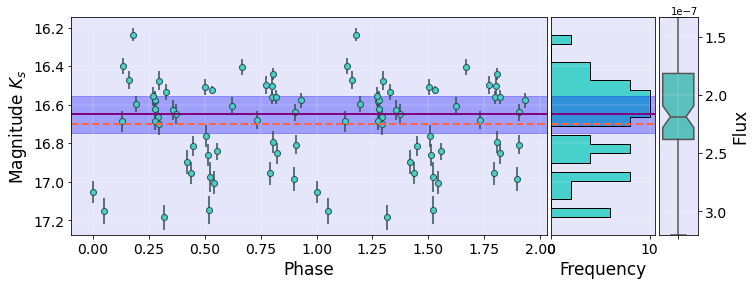

id_vvv 515881824954.0 Period_LS*2 0.5139178
0.5139178 515881824954.0


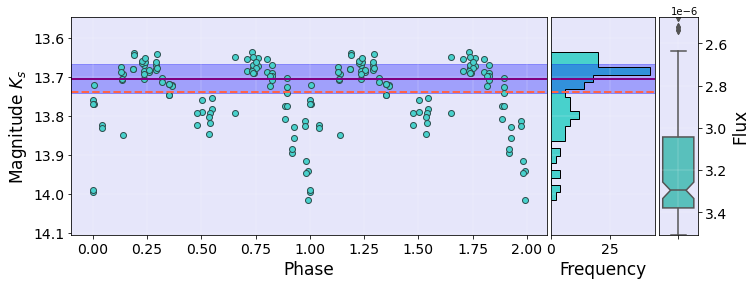

id_vvv 515881829441.0 Period_LS*2 1.00552714
1.00552714 515881829441.0


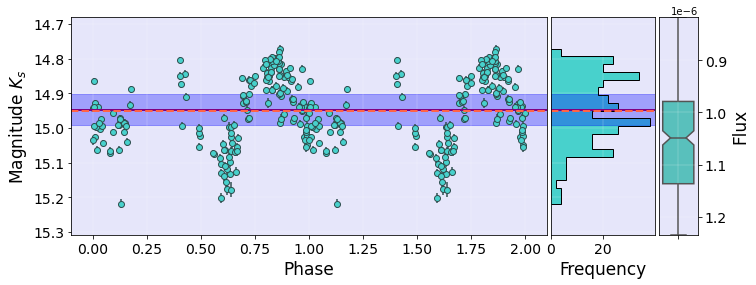

id_vvv 515881833126.0 Period_LS*2 1.6708224
1.6708224 515881833126.0


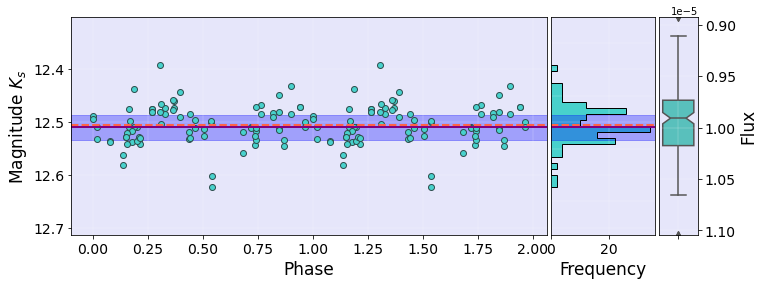

id_vvv 515881833225.0 Period_LS*2 0.63017726
0.63017726 515881833225.0


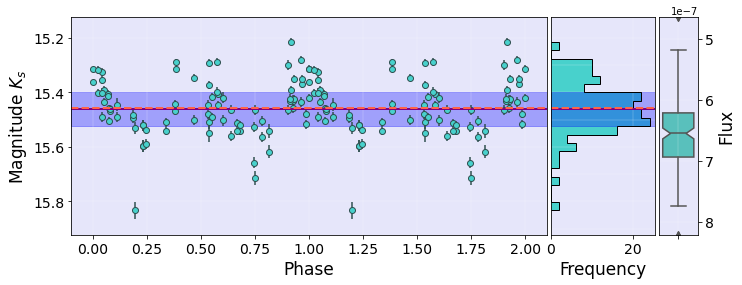

id_vvv 515881833511.0 Period_LS*2 0.69142532
0.69142532 515881833511.0


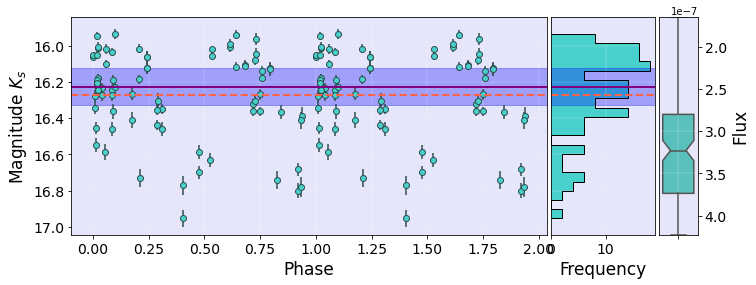

id_vvv 515881835868.0 Period_LS*2 0.75734466
0.75734466 515881835868.0


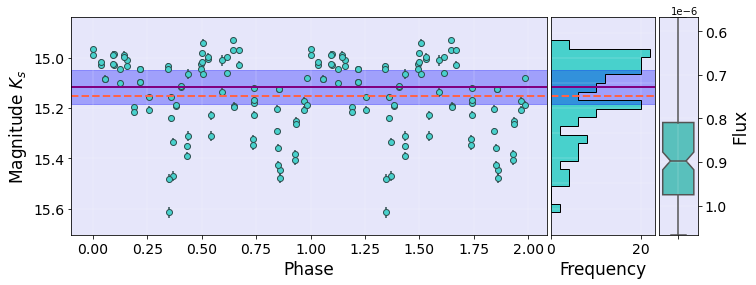

id_vvv 515881837288.0 Period_LS*2 0.6149266
0.6149266 515881837288.0


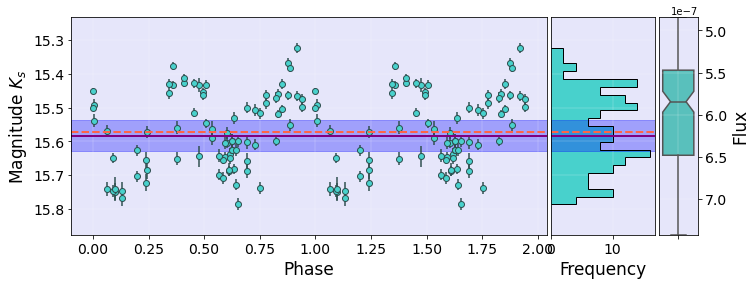

id_vvv 515881837772.0 Period_LS*2 0.93478728
0.93478728 515881837772.0


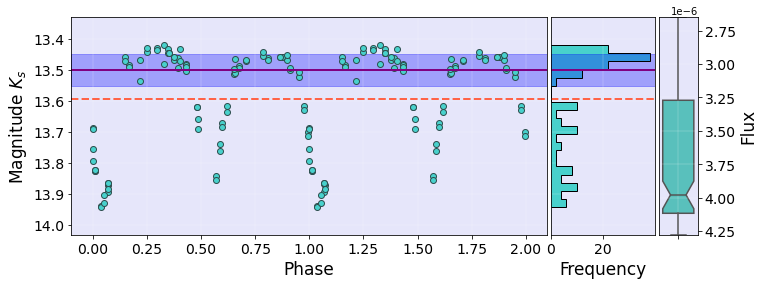

id_vvv 515881839645.0 Period_LS*2 1.71121728
1.71121728 515881839645.0


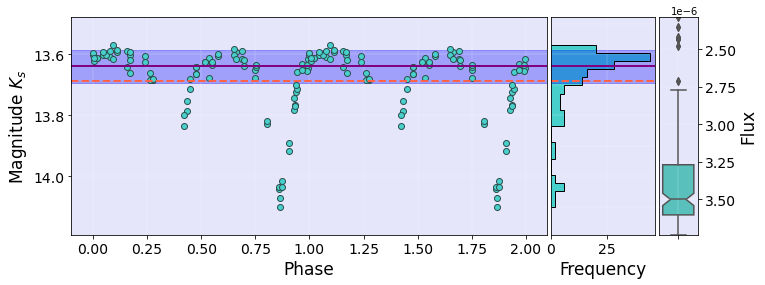

id_vvv 515881840259.0 Period_LS*2 11.5974846
11.5974846 515881840259.0


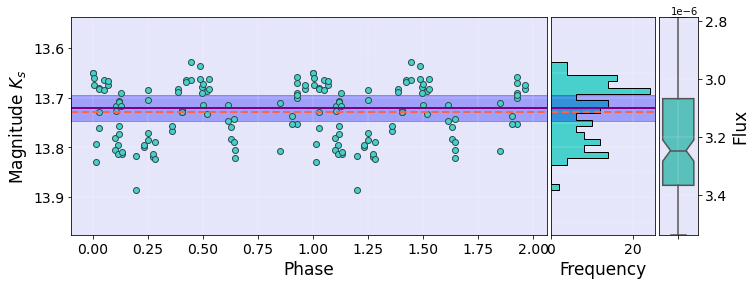

id_vvv 515881840406.0 Period_LS*2 5.6382576
5.6382576 515881840406.0


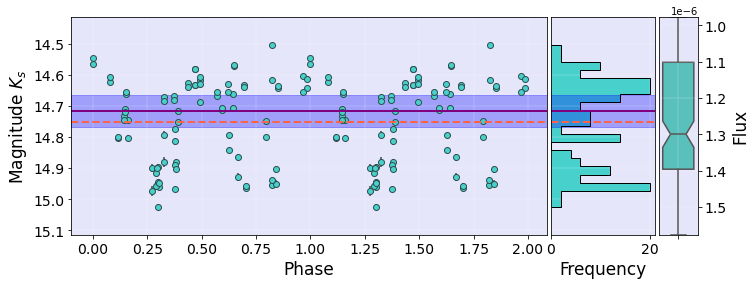

id_vvv 515881842329.0 Period_LS*2 1.10757792
1.10757792 515881842329.0


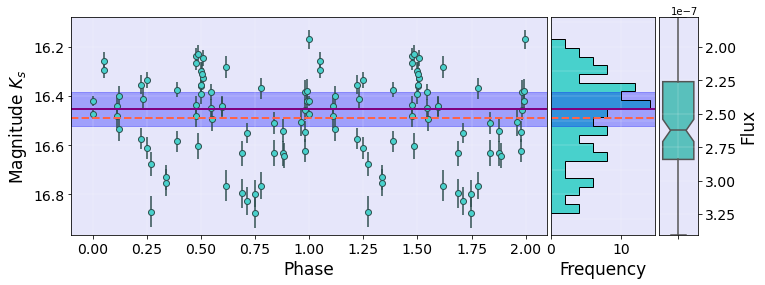

id_vvv 515881842736.0 Period_LS*2 1.4928348
1.4928348 515881842736.0


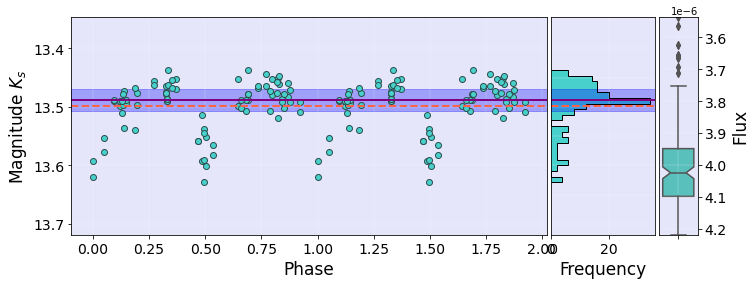

id_vvv 515881843411.0 Period_LS*2 0.9034577
0.9034577 515881843411.0


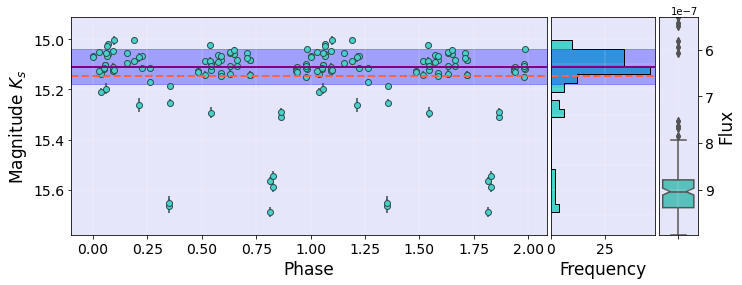

id_vvv 515881843751.0 Period_LS*2 0.70278126
0.70278126 515881843751.0


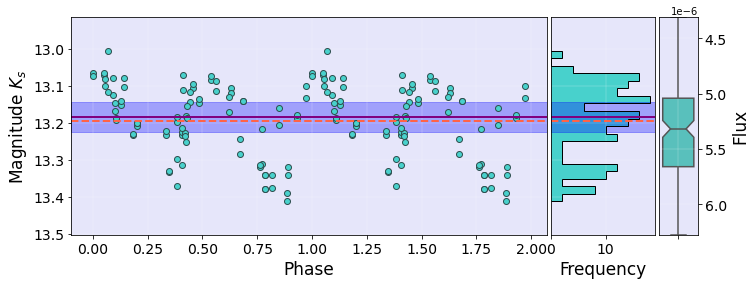

id_vvv 515881843930.0 Period_LS*2 0.6799884
0.6799884 515881843930.0


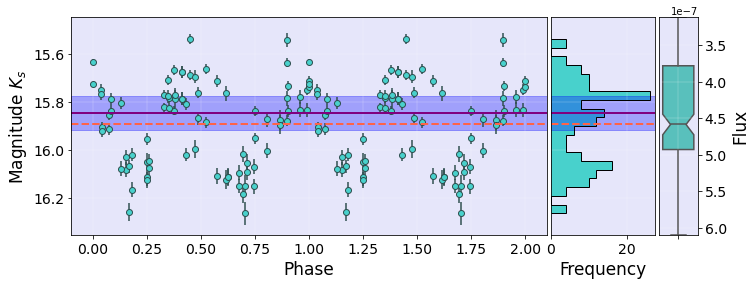

id_vvv 515881845393.0 Period_LS*2 9.644326
9.644326 515881845393.0


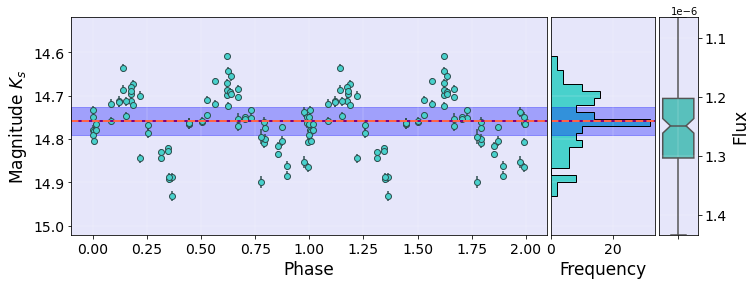

id_vvv 515881845843.0 Period_LS*2 5.1306266
5.1306266 515881845843.0


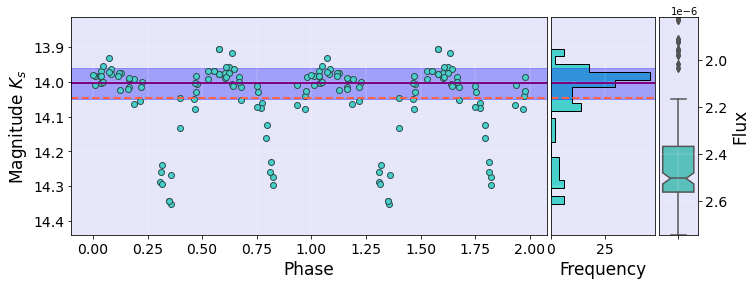

id_vvv 515881849371.0 Period_LS*2 1.94188154
1.94188154 515881849371.0


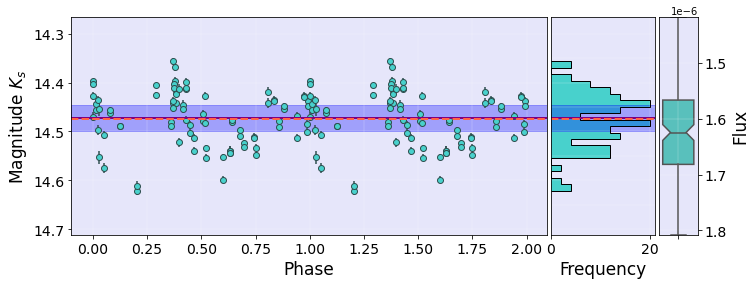

id_vvv 515881849640.0 Period_LS*2 0.5762022
0.5762022 515881849640.0


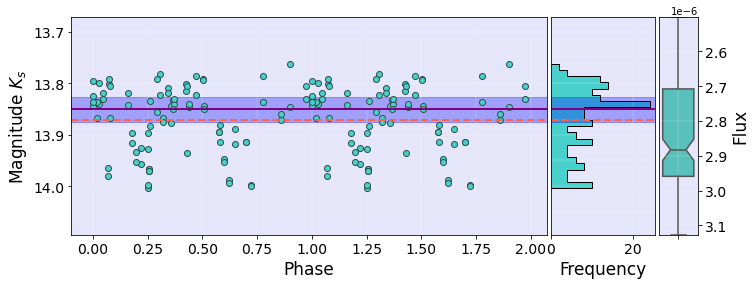

id_vvv 515881850275.0 Period_LS*2 3.3849442
3.3849442 515881850275.0


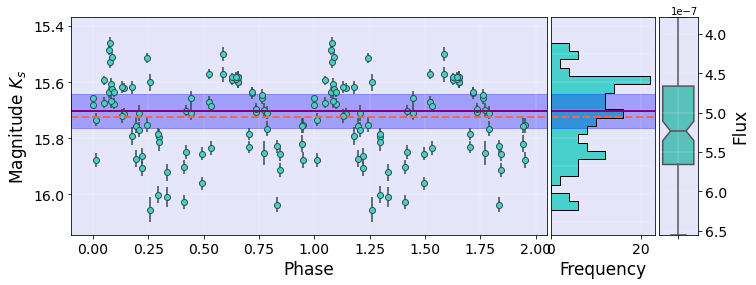

id_vvv 515881852495.0 Period_LS*2 2.5753446
2.5753446 515881852495.0


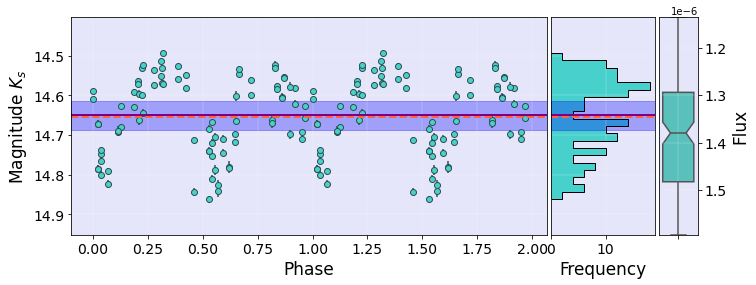

id_vvv 515881852961.0 Period_LS*2 0.97658366
0.97658366 515881852961.0


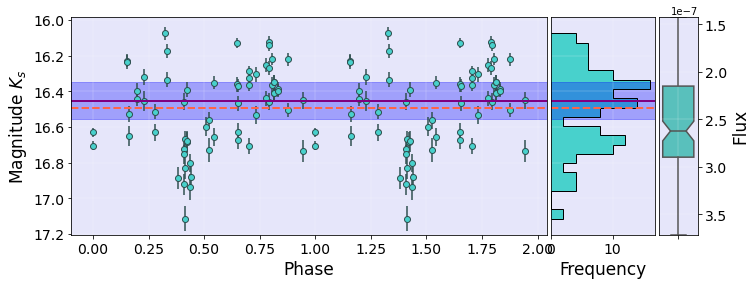

id_vvv 515881854173.0 Period_LS*2 0.602187
0.602187 515881854173.0


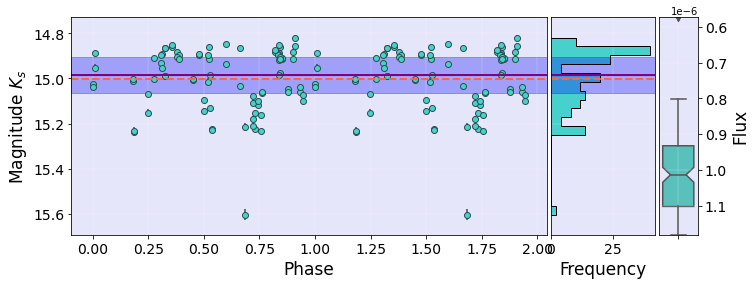

id_vvv 515881854713.0 Period_LS*2 0.56210488
0.56210488 515881854713.0


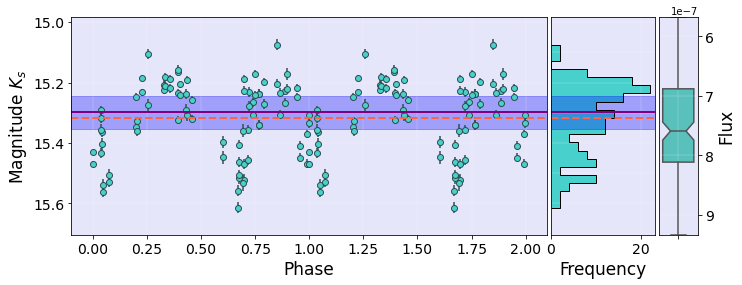

id_vvv 515881854744.0 Period_LS*2 0.8650936
0.8650936 515881854744.0


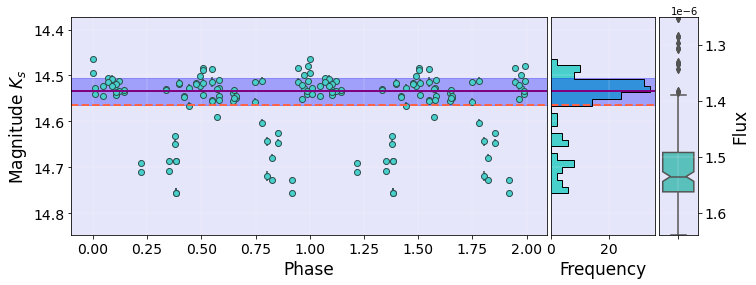

id_vvv 515881855508.0 Period_LS*2 1.7830627
1.7830627 515881855508.0


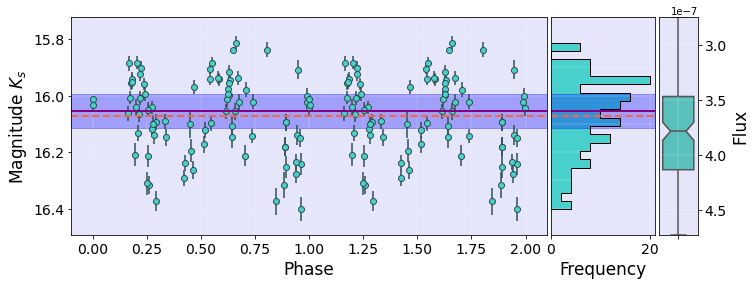

id_vvv 515881856149.0 Period_LS*2 1.0334908
1.0334908 515881856149.0


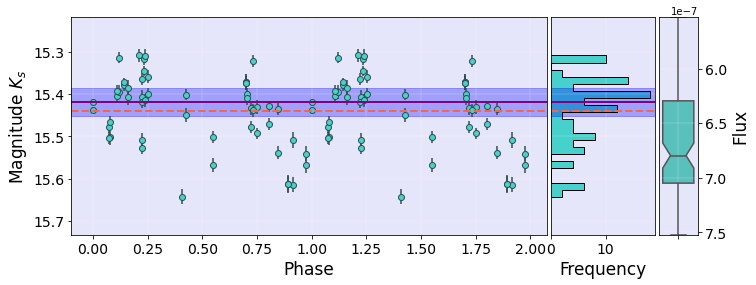

id_vvv 515881856884.0 Period_LS*2 11.2462168
11.2462168 515881856884.0


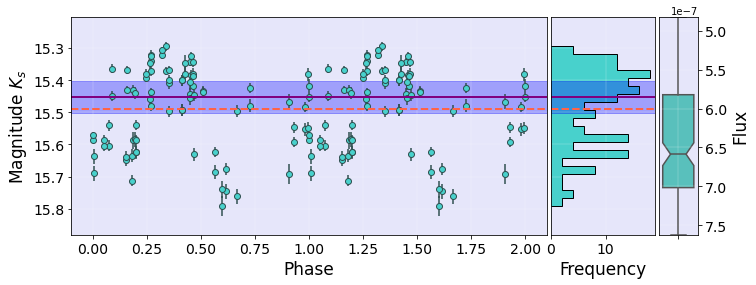

id_vvv 515881859349.0 Period_LS*2 0.71019608
0.71019608 515881859349.0


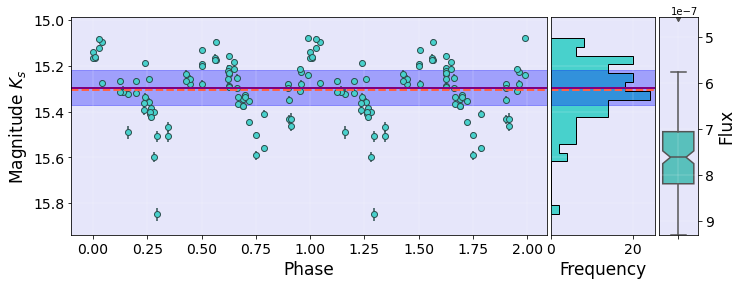

id_vvv 515881859431.0 Period_LS*2 5.112371
5.112371 515881859431.0


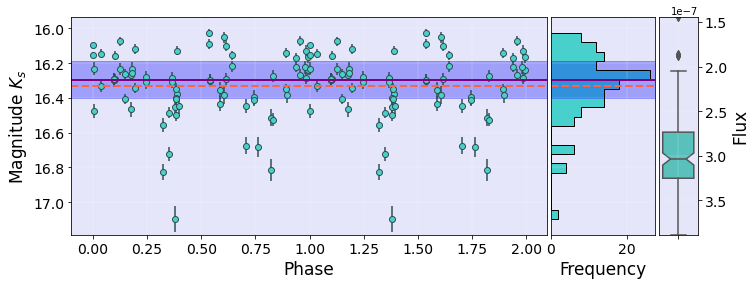

id_vvv 515881859950.0 Period_LS*2 0.77311366
0.77311366 515881859950.0


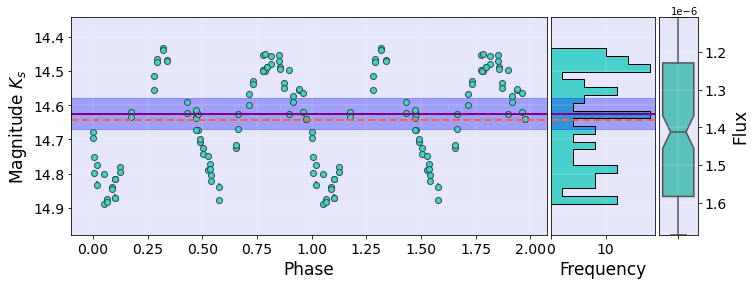

id_vvv 515881860701.0 Period_LS*2 1.336488
1.336488 515881860701.0


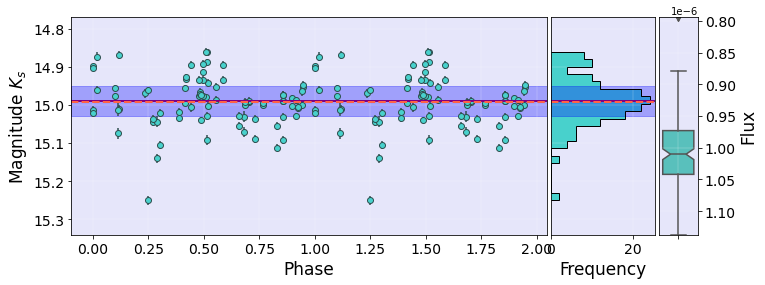

id_vvv 515881862225.0 Period_LS*2 1.95308446
1.95308446 515881862225.0


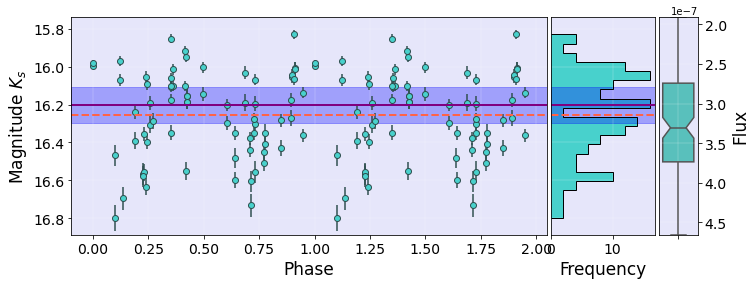

id_vvv 515881870829.0 Period_LS*2 10.478382
10.478382 515881870829.0


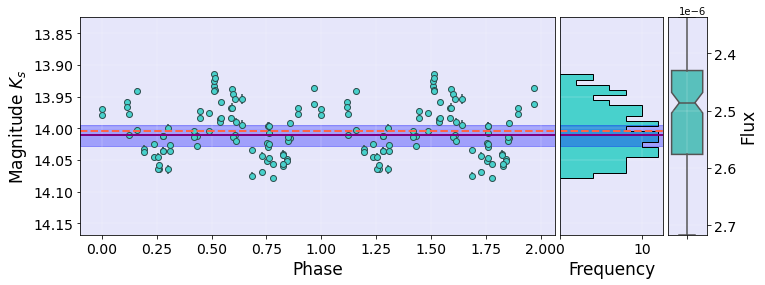

id_vvv 515881874127.0 Period_LS*2 1.4296098
1.4296098 515881874127.0


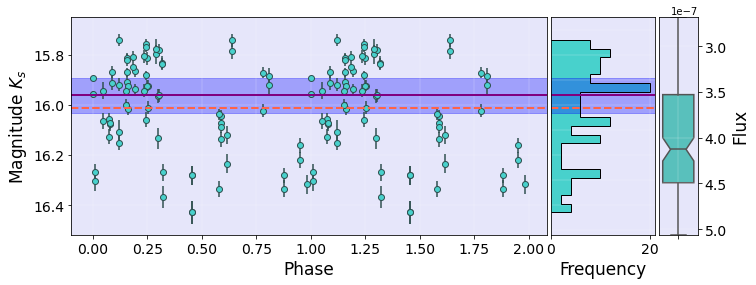

id_vvv 515881880004.0 Period_LS*2 3.4364838
3.4364838 515881880004.0


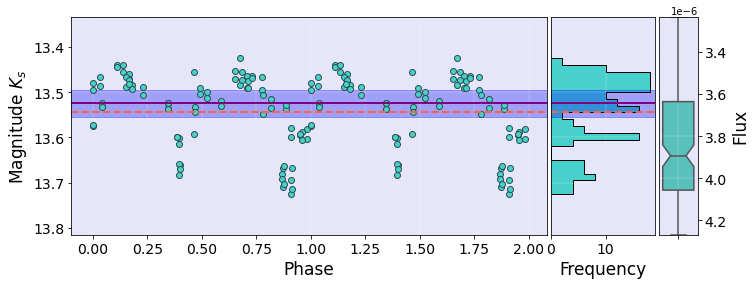

id_vvv 515881881286.0 Period_LS*2 1.0295211
1.0295211 515881881286.0


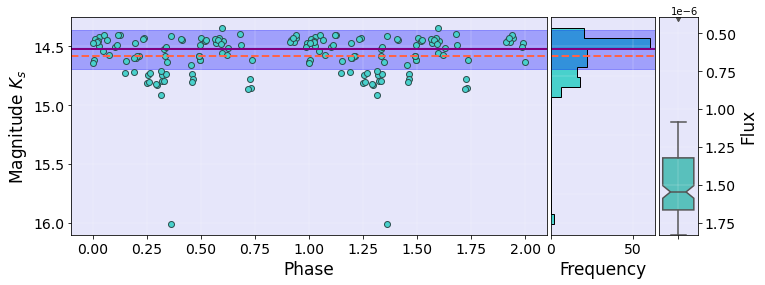

id_vvv 515881881932.0 Period_LS*2 2.202799
2.202799 515881881932.0


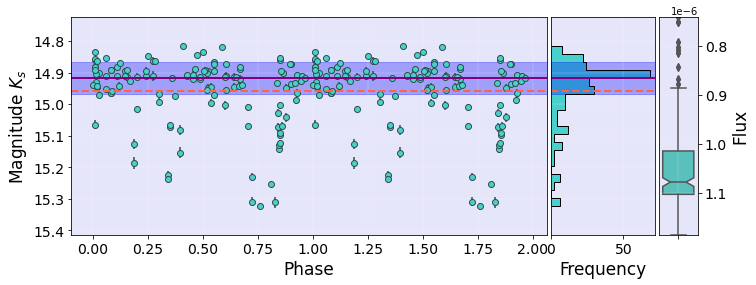

id_vvv 515881883697.0 Period_LS*2 0.6523934
0.6523934 515881883697.0


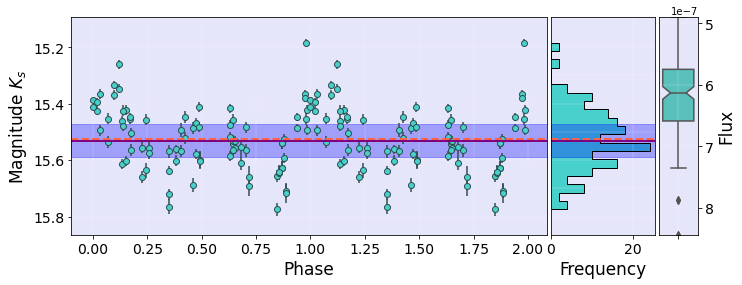

id_vvv 515881883836.0 Period_LS*2 6.6057406
6.6057406 515881883836.0


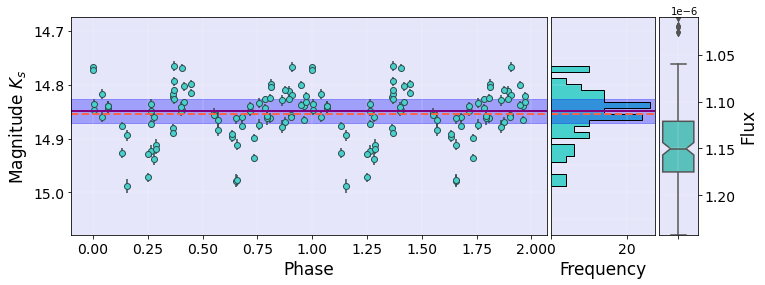

id_vvv 515881884624.0 Period_LS*2 0.7859413
0.7859413 515881884624.0


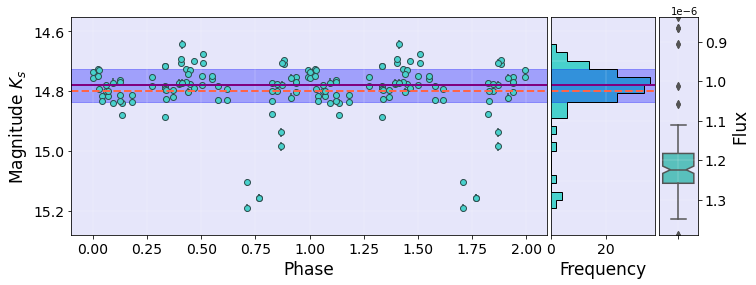

id_vvv 515881885756.0 Period_LS*2 0.68107468
0.68107468 515881885756.0


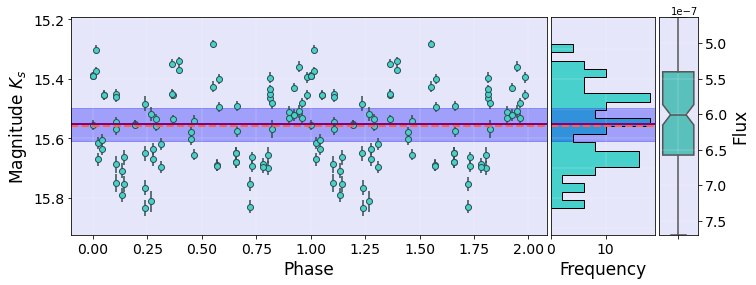

id_vvv 515881886017.0 Period_LS*2 0.57571226
0.57571226 515881886017.0


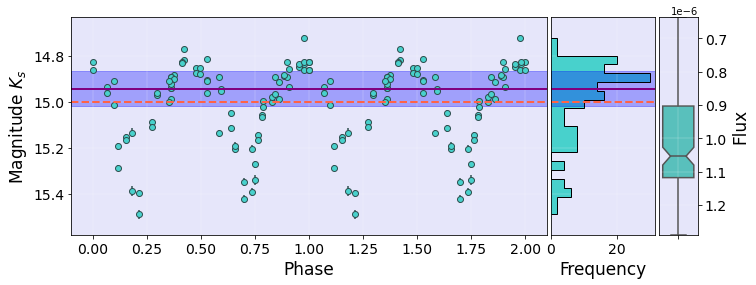

id_vvv 515881886366.0 Period_LS*2 0.6815586
0.6815586 515881886366.0


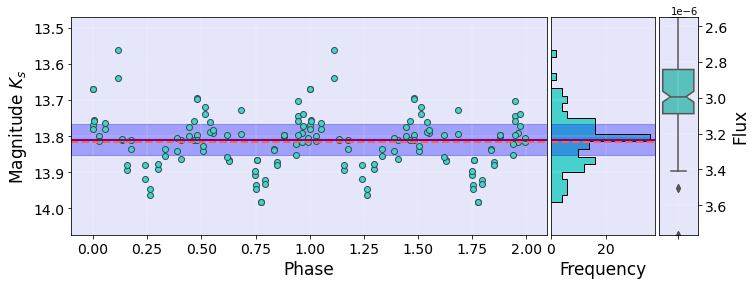

id_vvv 515881886484.0 Period_LS*2 0.5927291
0.5927291 515881886484.0


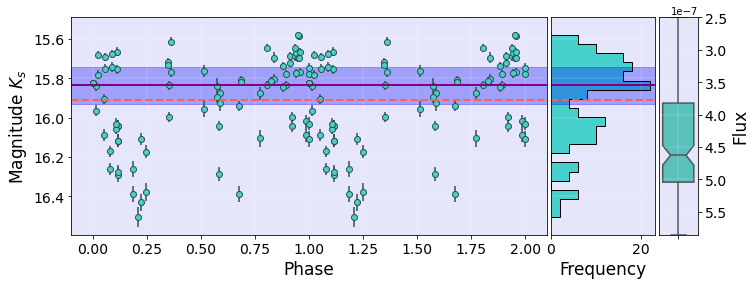

id_vvv 515881888648.0 Period_LS*2 1.2209496
1.2209496 515881888648.0


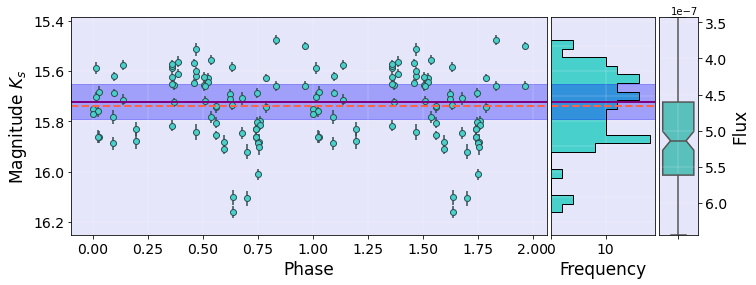

id_vvv 515881889981.0 Period_LS*2 0.6863951
0.6863951 515881889981.0


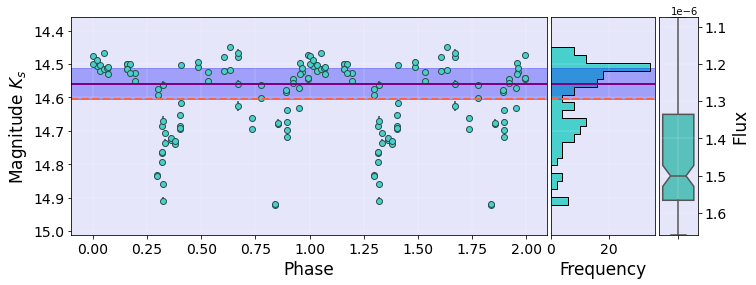

id_vvv 515881890357.0 Period_LS*2 0.87343044
0.87343044 515881890357.0


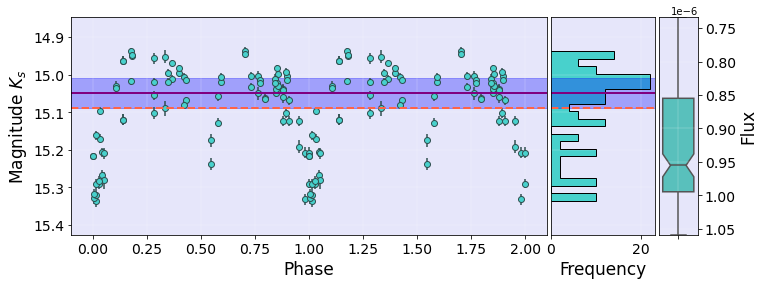

id_vvv 515881890413.0 Period_LS*2 1.9412266
1.9412266 515881890413.0


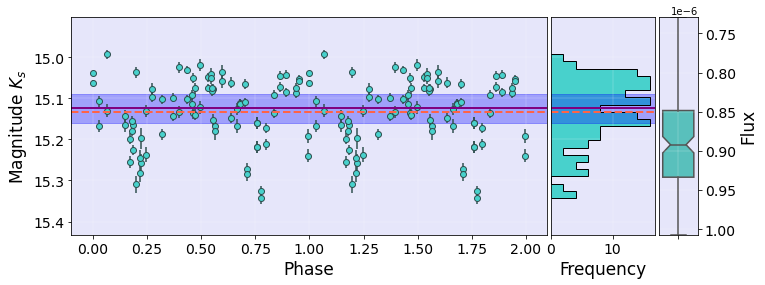

id_vvv 515881890549.0 Period_LS*2 0.7406778
0.7406778 515881890549.0


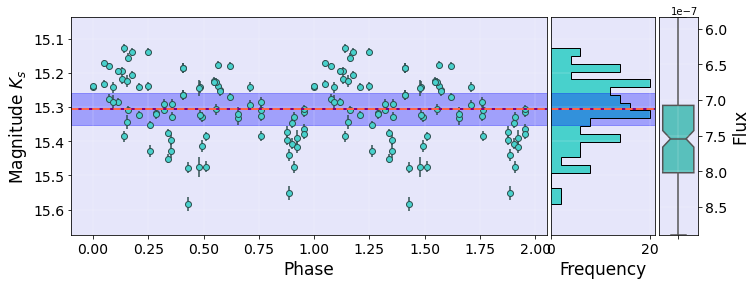

id_vvv 515881891782.0 Period_LS*2 0.61263556
0.61263556 515881891782.0


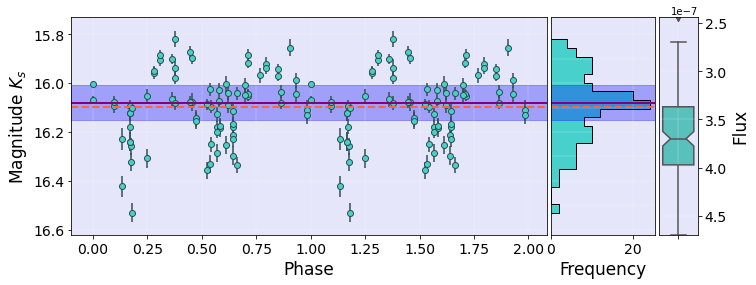

id_vvv 515881893410.0 Period_LS*2 3.427275
3.427275 515881893410.0


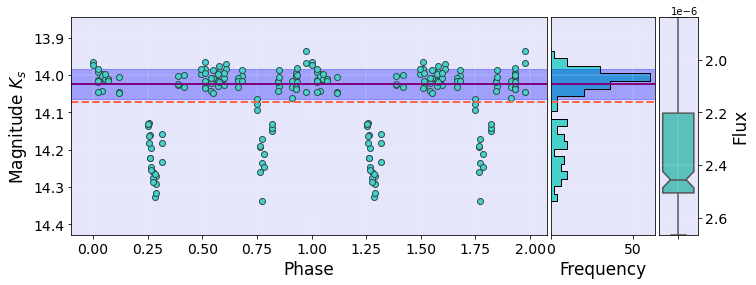

id_vvv 515881897403.0 Period_LS*2 0.76923872
0.76923872 515881897403.0


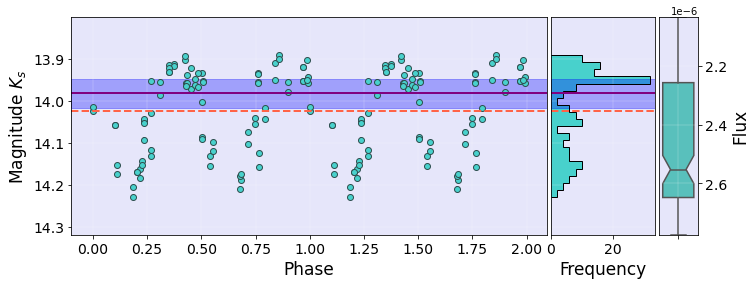

id_vvv 515881897490.0 Period_LS*2 2.9449926
2.9449926 515881897490.0


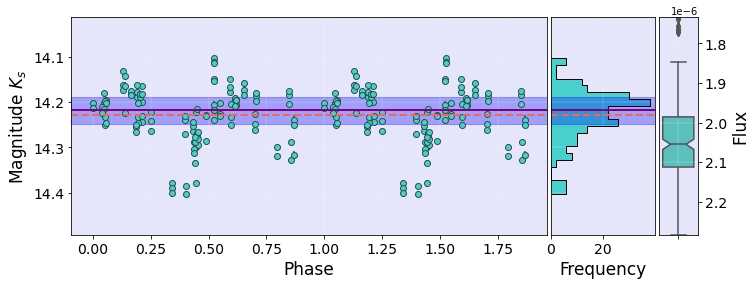

id_vvv 515881897587.0 Period_LS*2 0.9715554
0.9715554 515881897587.0


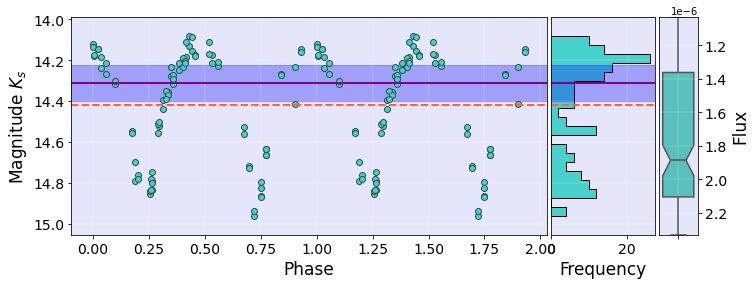

id_vvv 515881897998.0 Period_LS*2 0.5845714
0.5845714 515881897998.0


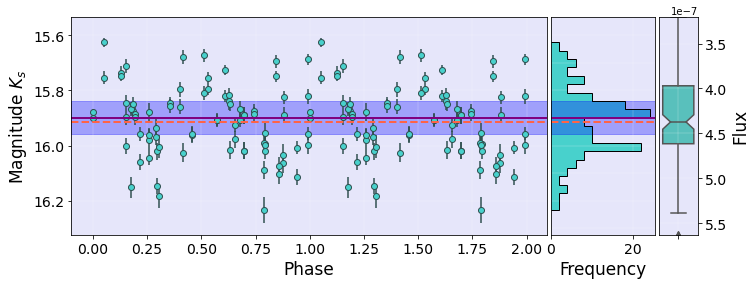

id_vvv 515881898444.0 Period_LS*2 2.0177934
2.0177934 515881898444.0


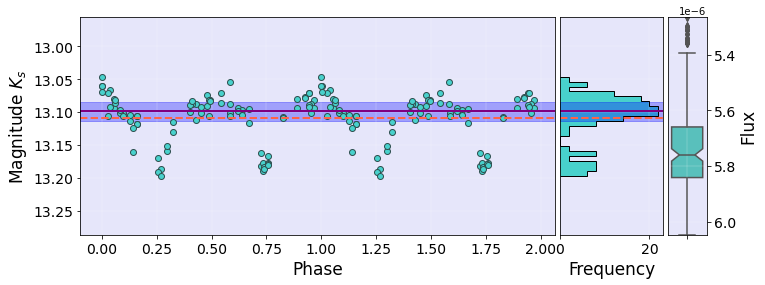

id_vvv 515881898620.0 Period_LS*2 0.77342534
0.77342534 515881898620.0


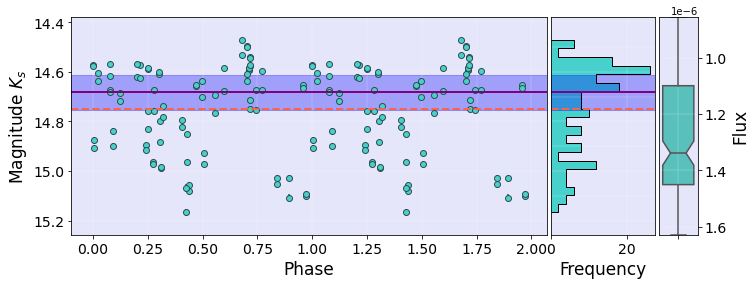

id_vvv 515881898976.0 Period_LS*2 0.5929734
0.5929734 515881898976.0


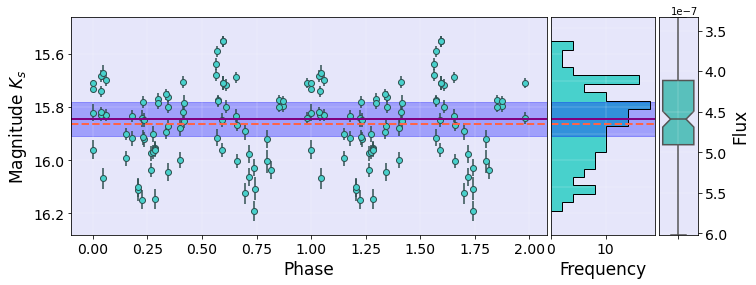

id_vvv 515881899453.0 Period_LS*2 1.29673886
1.29673886 515881899453.0


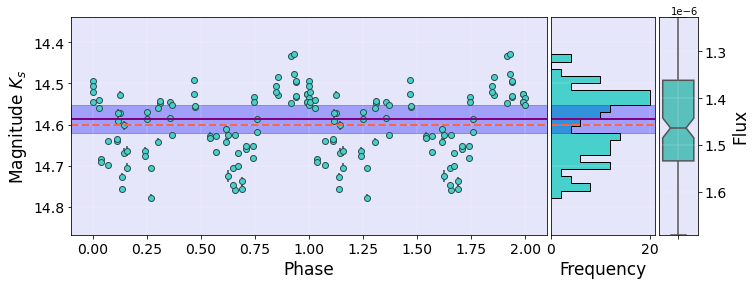

id_vvv 515881899744.0 Period_LS*2 21.02375
21.02375 515881899744.0


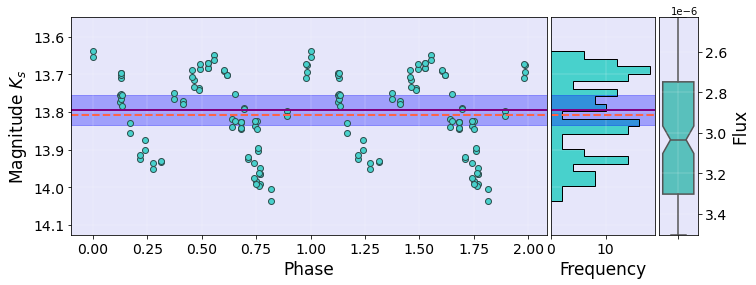

id_vvv 515881900308.0 Period_LS*2 0.6115614
0.6115614 515881900308.0


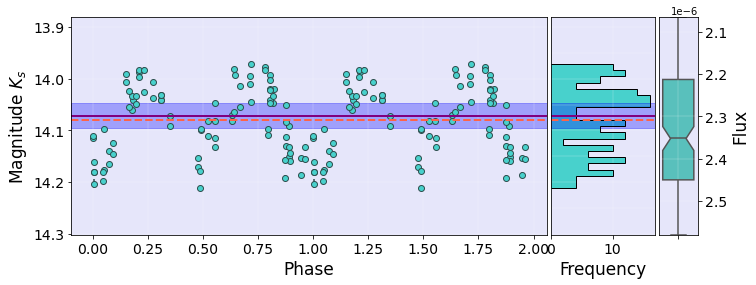

id_vvv 515881901015.0 Period_LS*2 0.7375927
0.7375927 515881901015.0


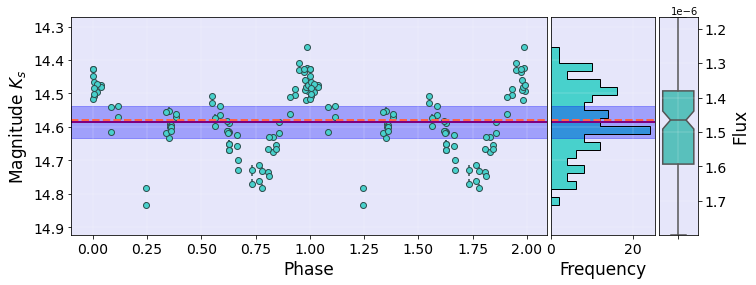

id_vvv 515881901120.0 Period_LS*2 0.92450124
0.92450124 515881901120.0


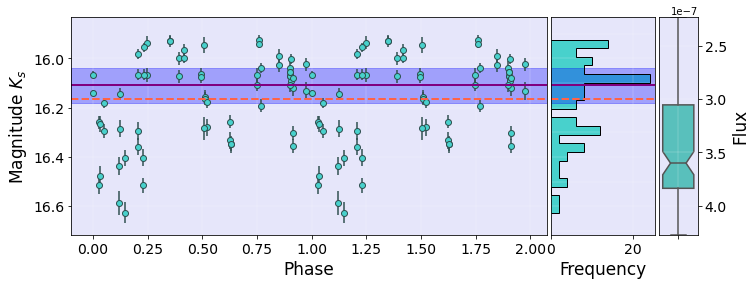

id_vvv 515881902356.0 Period_LS*2 3.1678992
3.1678992 515881902356.0


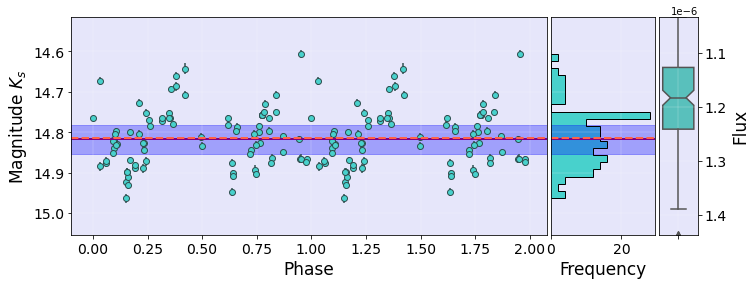

id_vvv 515881904506.0 Period_LS*2 0.7227718
0.7227718 515881904506.0


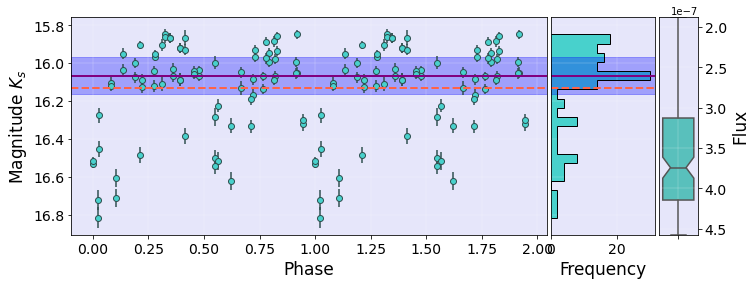

id_vvv 515881905745.0 Period_LS*2 1.8831088
1.8831088 515881905745.0


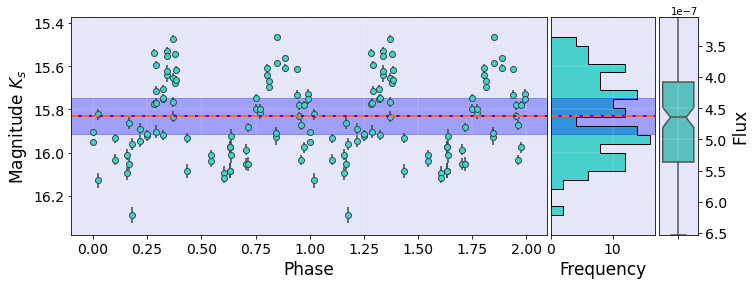

id_vvv 515881906291.0 Period_LS*2 4.364172
4.364172 515881906291.0


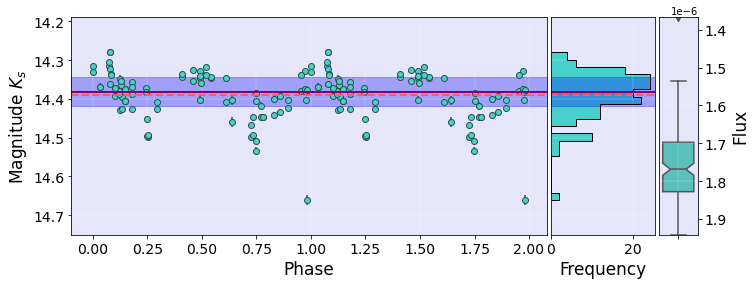

id_vvv 515881906562.0 Period_LS*2 3.9863214
3.9863214 515881906562.0


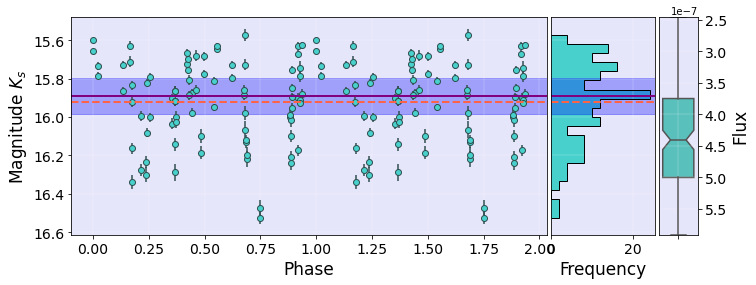

id_vvv 515881907342.0 Period_LS*2 1.04541146
1.04541146 515881907342.0


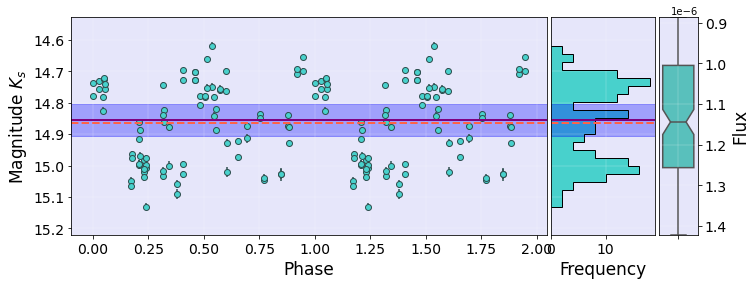

id_vvv 515881907619.0 Period_LS*2 0.8960728
0.8960728 515881907619.0


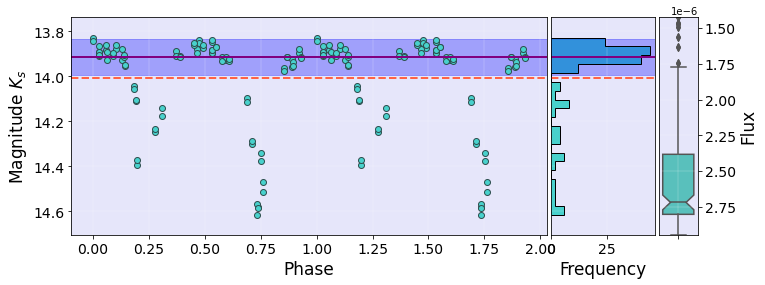

id_vvv 515881908576.0 Period_LS*2 1.0166044
1.0166044 515881908576.0


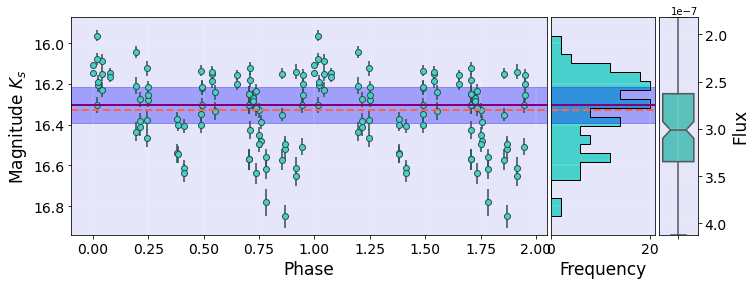

id_vvv 515881909288.0 Period_LS*2 0.72318054
0.72318054 515881909288.0


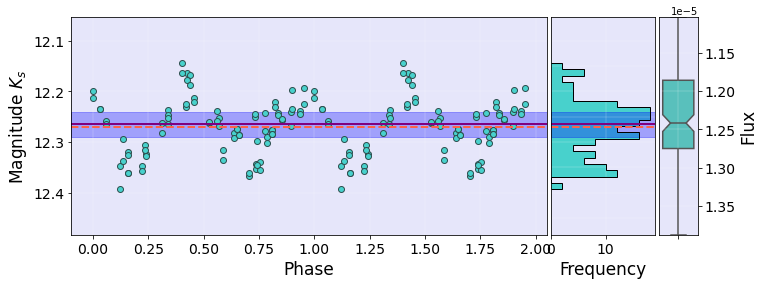

id_vvv 515881910328.0 Period_LS*2 7.6558052
7.6558052 515881910328.0


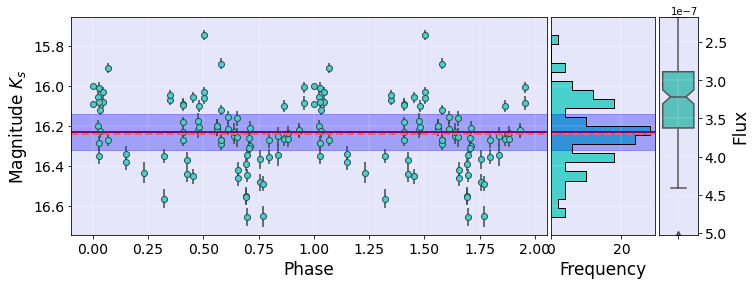

id_vvv 515881912836.0 Period_LS*2 0.69949276
0.69949276 515881912836.0


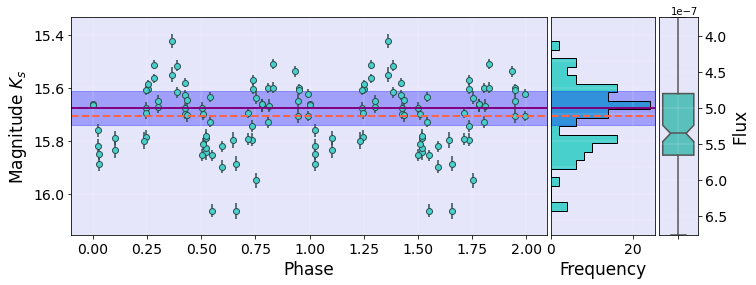

id_vvv 515881913747.0 Period_LS*2 1.2531166
1.2531166 515881913747.0


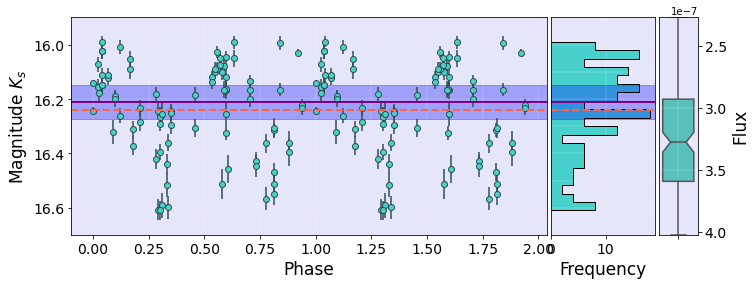

id_vvv 515881913933.0 Period_LS*2 0.5638948
0.5638948 515881913933.0


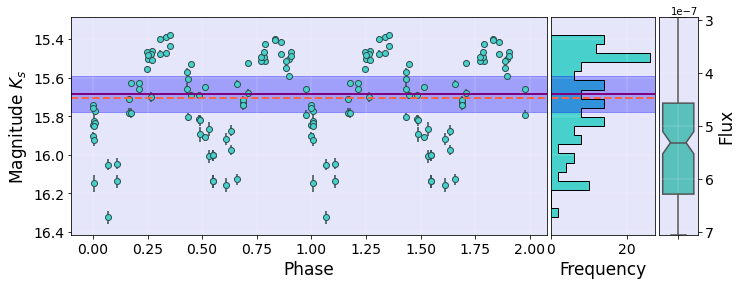

id_vvv 515881914190.0 Period_LS*2 1.15794588
1.15794588 515881914190.0


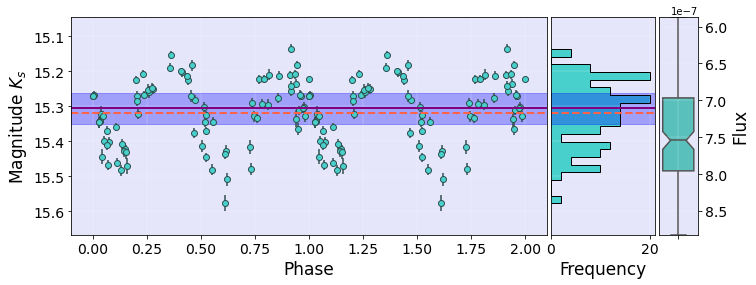

id_vvv 515881915674.0 Period_LS*2 0.44117602
0.44117602 515881915674.0


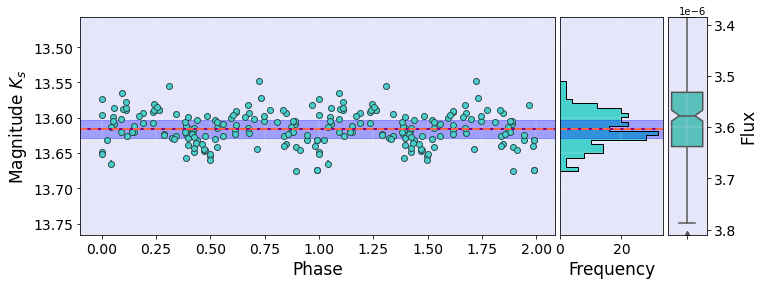

id_vvv 515881916676.0 Period_LS*2 4.9818234
4.9818234 515881916676.0


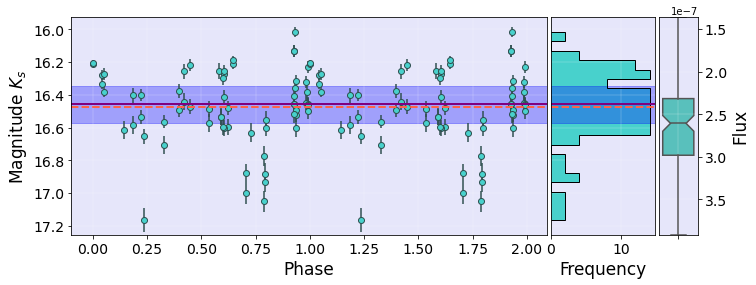

id_vvv 515881920551.0 Period_LS*2 0.4016436
0.4016436 515881920551.0


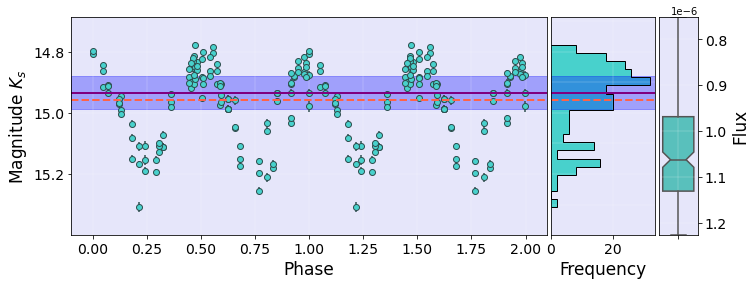

id_vvv 515881920753.0 Period_LS*2 0.65077048
0.65077048 515881920753.0


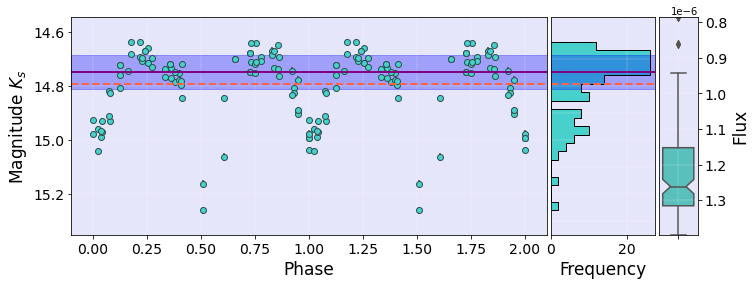

id_vvv 515881923434.0 Period_LS*2 2.8909966
2.8909966 515881923434.0


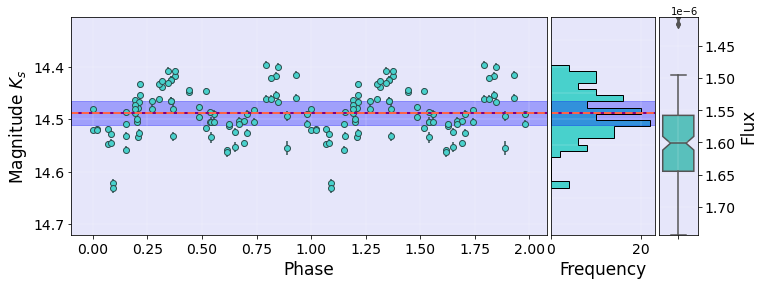

id_vvv 515881925013.0 Period_LS*2 0.7066644
0.7066644 515881925013.0


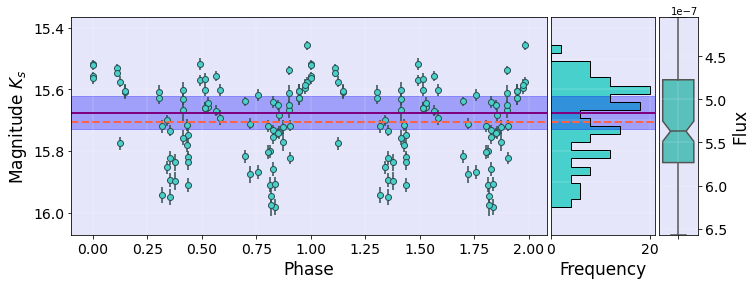

id_vvv 515881925107.0 Period_LS*2 2.0396038
2.0396038 515881925107.0


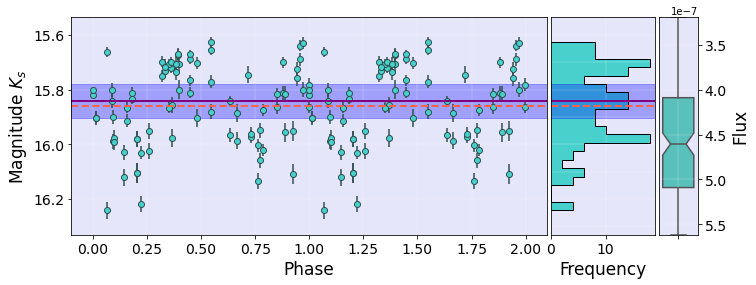

id_vvv 515881925330.0 Period_LS*2 3.2210888
3.2210888 515881925330.0


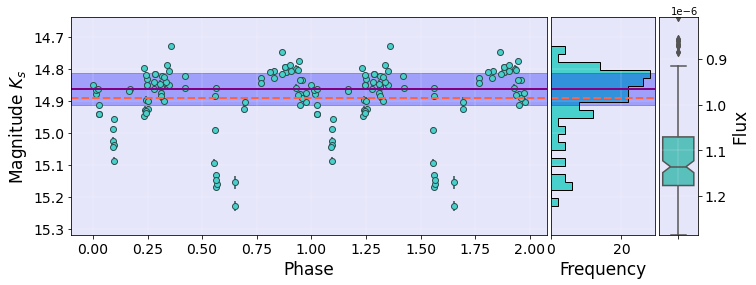

id_vvv 515881927154.0 Period_LS*2 1.6925966
1.6925966 515881927154.0


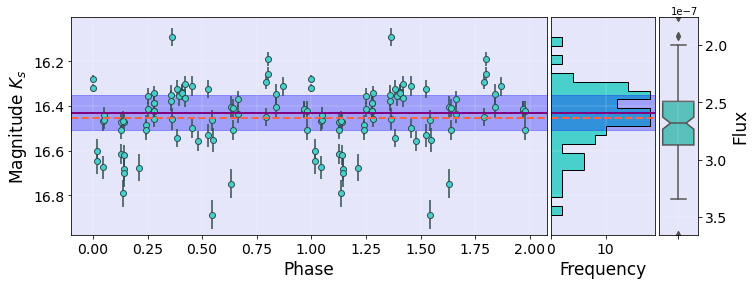

id_vvv 515881928468.0 Period_LS*2 0.67405516
0.67405516 515881928468.0


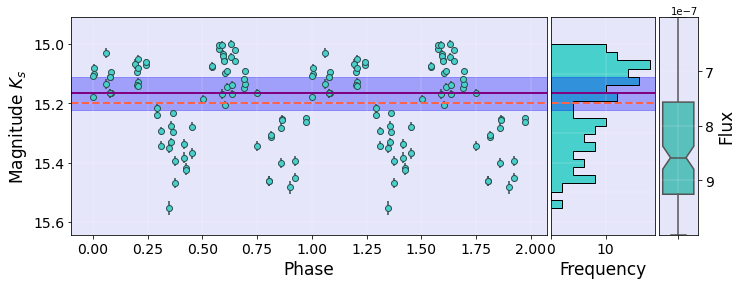

id_vvv 515881928749.0 Period_LS*2 2.730519
2.730519 515881928749.0


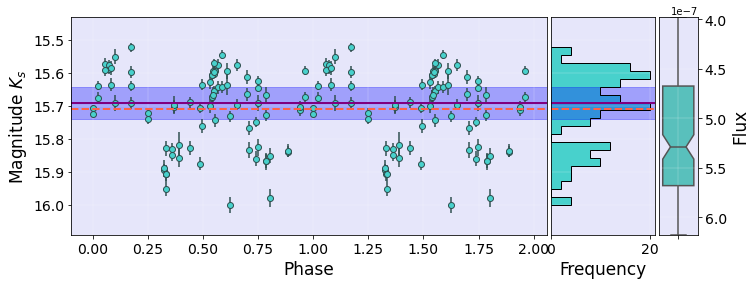

id_vvv 515881930345.0 Period_LS*2 0.65618694
0.65618694 515881930345.0


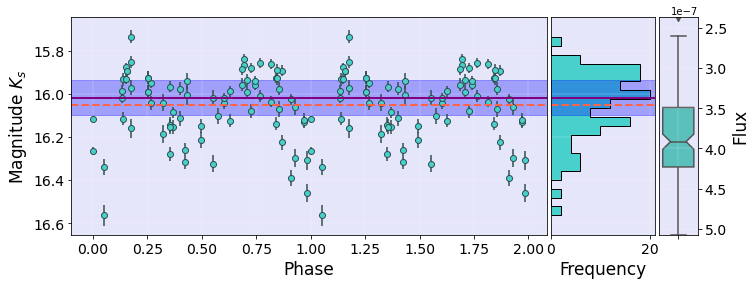

id_vvv 515881930848.0 Period_LS*2 1.1412922
1.1412922 515881930848.0


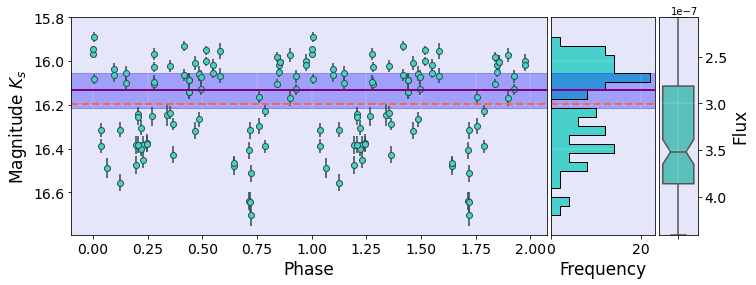

id_vvv 515881932204.0 Period_LS*2 21.616078
21.616078 515881932204.0


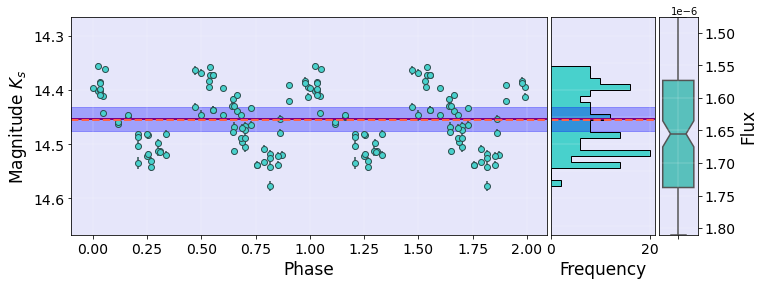

id_vvv 515881937225.0 Period_LS*2 0.57654852
0.57654852 515881937225.0


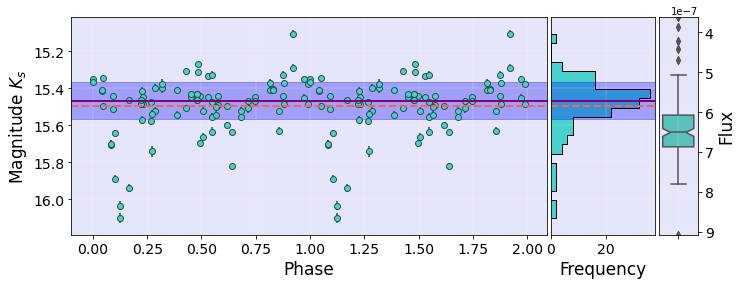

id_vvv 515881938648.0 Period_LS*2 1.214893
1.214893 515881938648.0


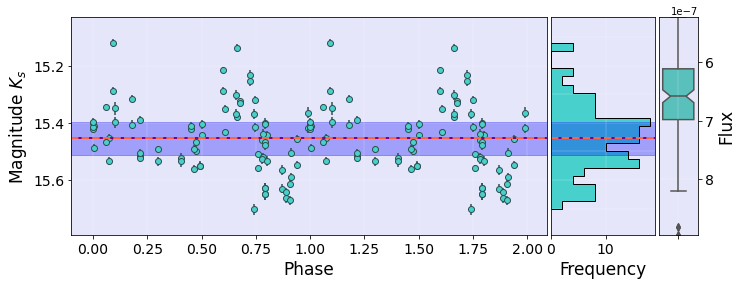

id_vvv 515881939289.0 Period_LS*2 0.81724614
0.81724614 515881939289.0


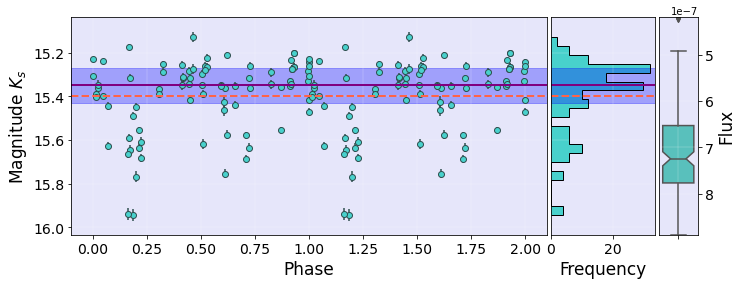

id_vvv 515881940517.0 Period_LS*2 4.271851
4.271851 515881940517.0


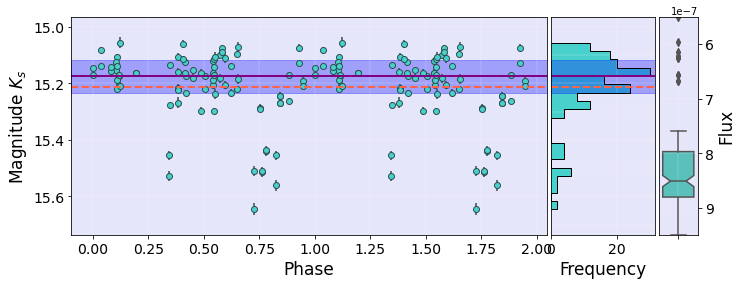

id_vvv 515881941464.0 Period_LS*2 0.6515072
0.6515072 515881941464.0


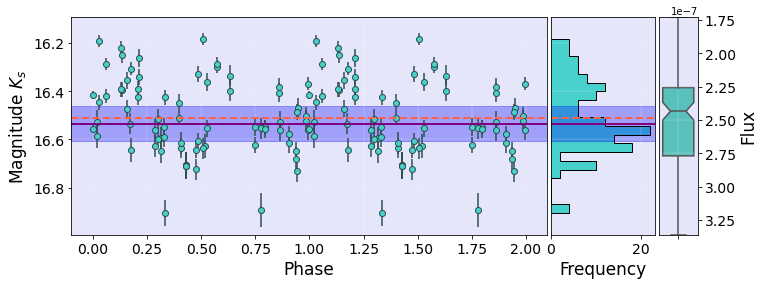

id_vvv 515881941877.0 Period_LS*2 0.6210312
0.6210312 515881941877.0


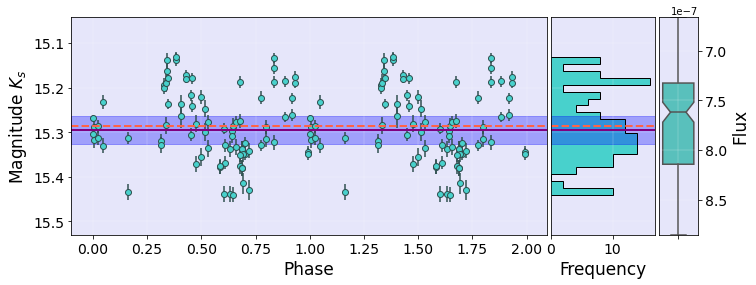

id_vvv 515881943318.0 Period_LS*2 5.3649512
5.3649512 515881943318.0


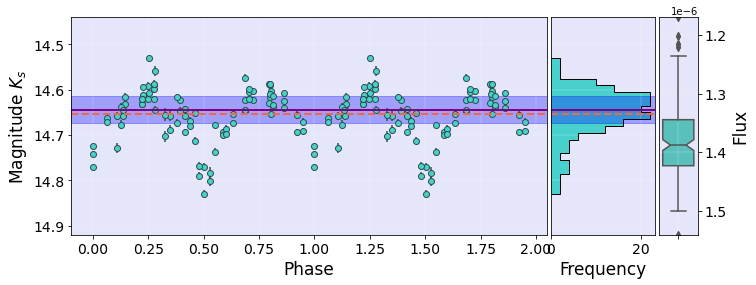

id_vvv 515881943783.0 Period_LS*2 1.6854093
1.6854093 515881943783.0


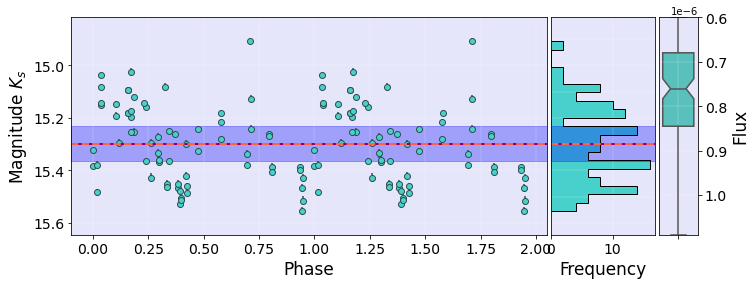

id_vvv 515881947606.0 Period_LS*2 2.8909966
2.8909966 515881947606.0


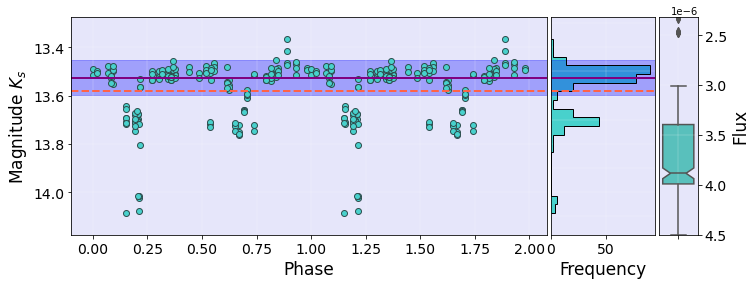

id_vvv 515881947844.0 Period_LS*2 0.3178775
0.3178775 515881947844.0


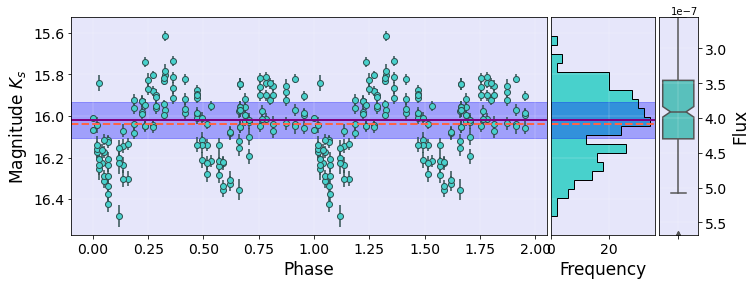

id_vvv 515881948068.0 Period_LS*2 0.35303416
0.35303416 515881948068.0


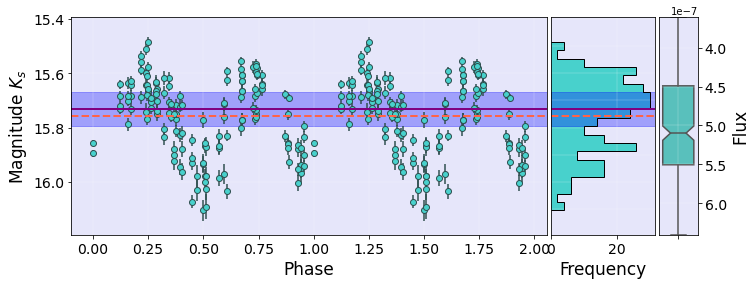

id_vvv 515881949254.0 Period_LS*2 0.7741536
0.7741536 515881949254.0


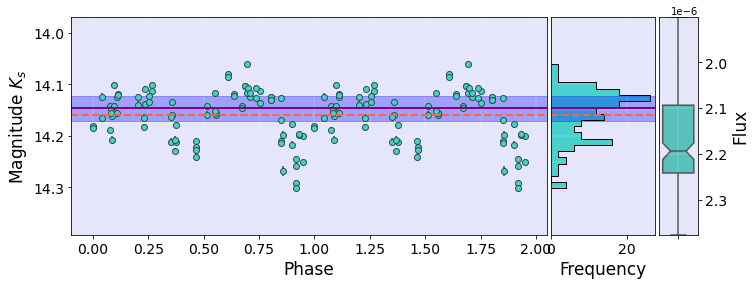

id_vvv 515881953028.0 Period_LS*2 1.65134872
1.65134872 515881953028.0


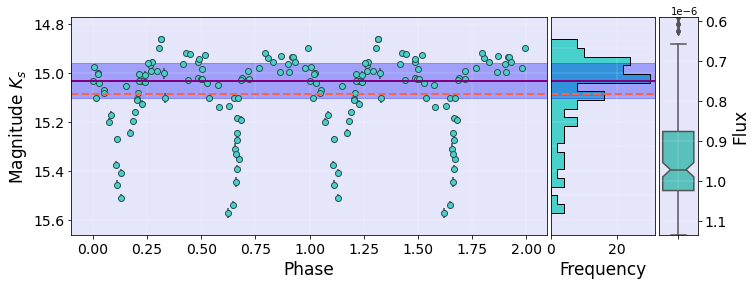

id_vvv 515881955844.0 Period_LS*2 1.00278806
1.00278806 515881955844.0


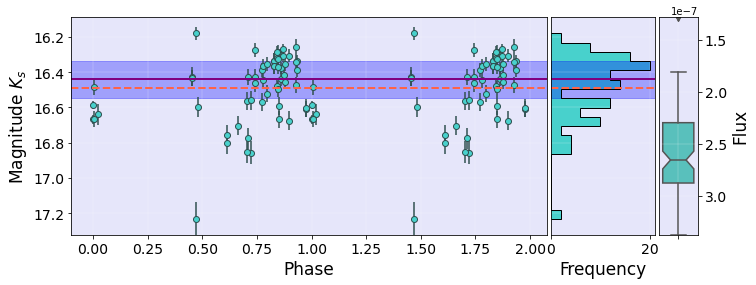

id_vvv 515881956078.0 Period_LS*2 0.9128437
0.9128437 515881956078.0


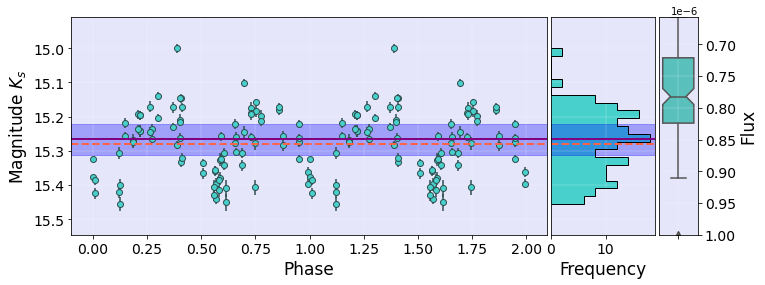

id_vvv 515881958030.0 Period_LS*2 1.6323482
1.6323482 515881958030.0


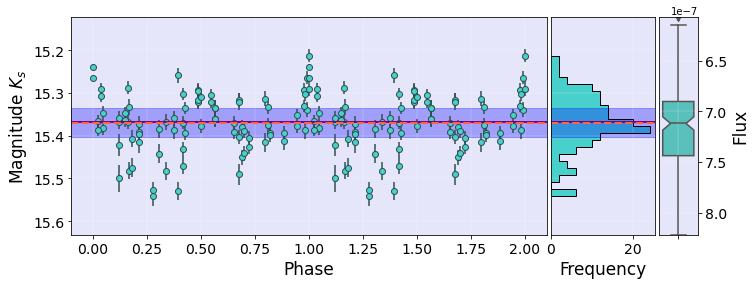

id_vvv 515881959772.0 Period_LS*2 0.5743732
0.5743732 515881959772.0


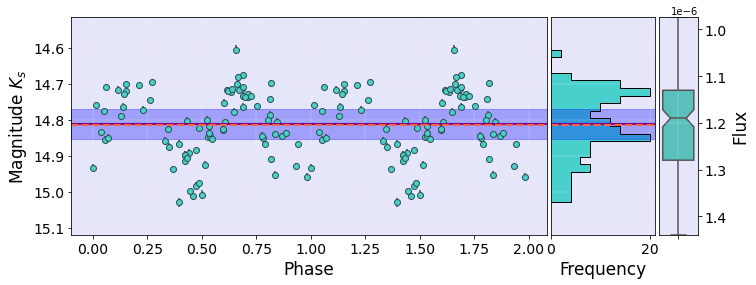

id_vvv 515881959780.0 Period_LS*2 0.563398
0.563398 515881959780.0


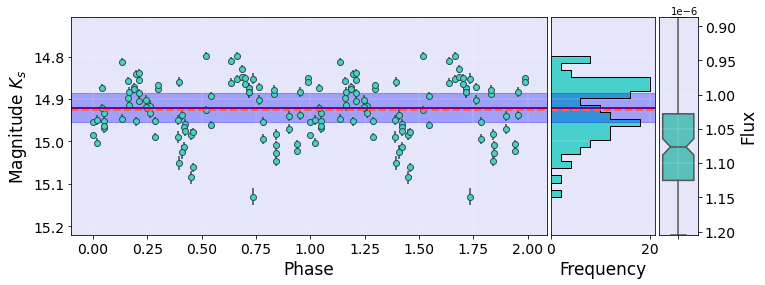

id_vvv 515881961718.0 Period_LS*2 1.9042936
1.9042936 515881961718.0


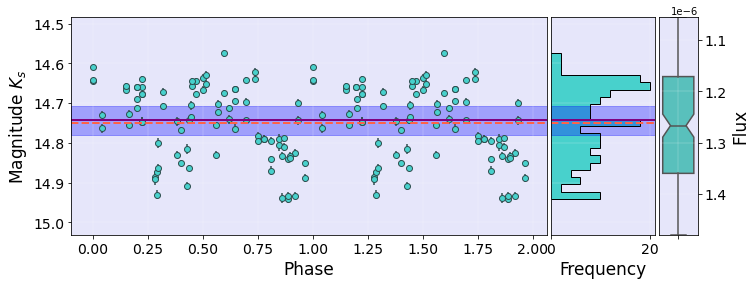

id_vvv 515881964917.0 Period_LS*2 1.23669112
1.23669112 515881964917.0


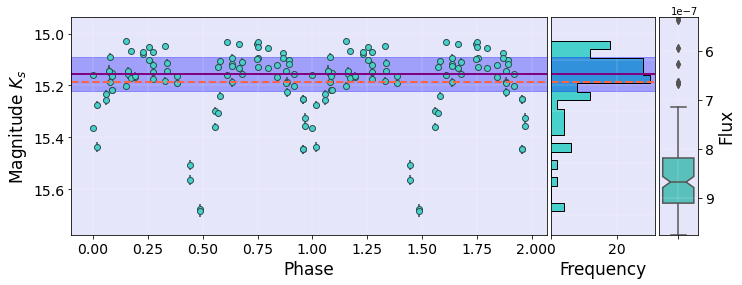

id_vvv 515881966348.0 Period_LS*2 0.8510853
0.8510853 515881966348.0


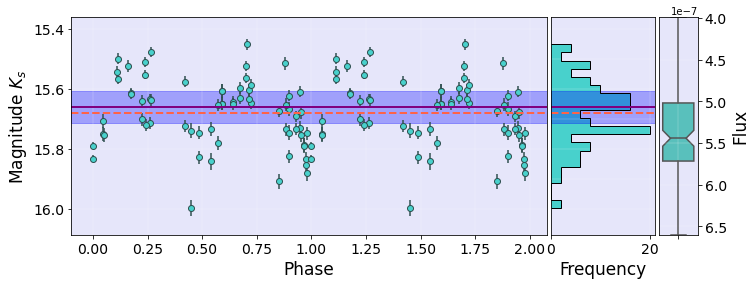

id_vvv 515881966365.0 Period_LS*2 1.020842
1.020842 515881966365.0


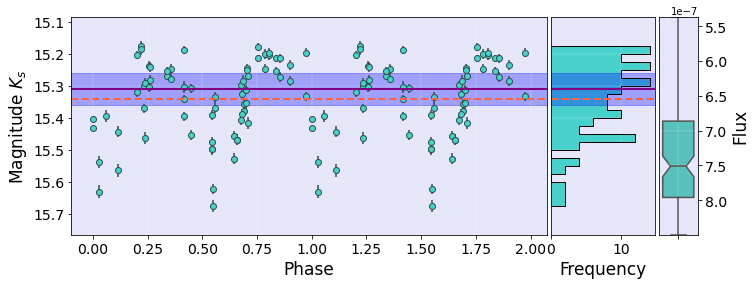

id_vvv 515881966646.0 Period_LS*2 0.70245176
0.70245176 515881966646.0


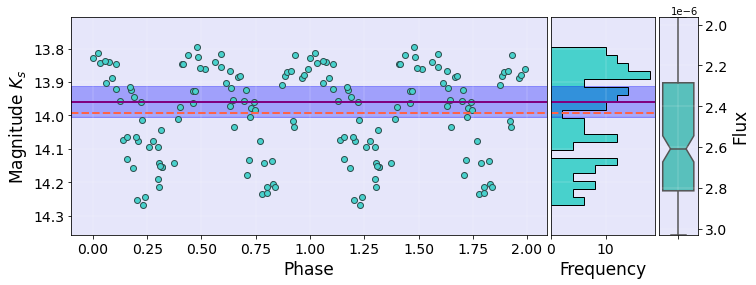

id_vvv 515881969612.0 Period_LS*2 0.5796552
0.5796552 515881969612.0


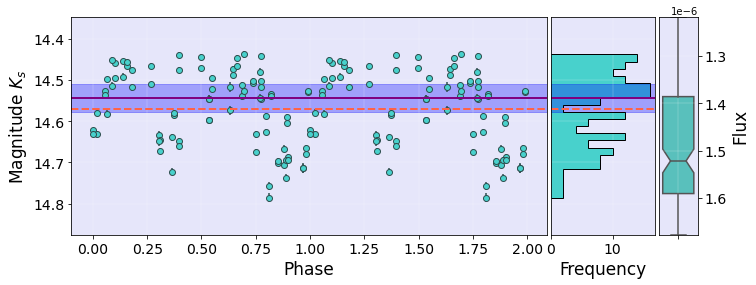

id_vvv 515881971112.0 Period_LS*2 1.07519532
1.07519532 515881971112.0


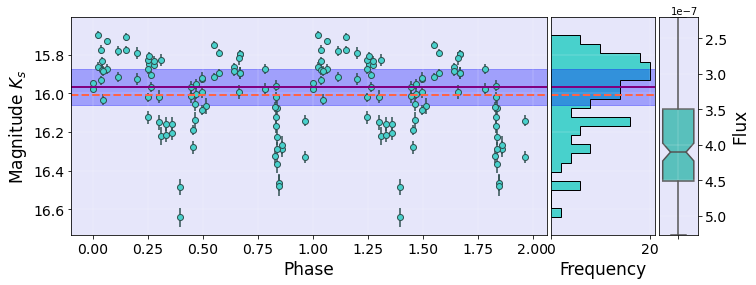

id_vvv 515881971265.0 Period_LS*2 1.35346032
1.35346032 515881971265.0


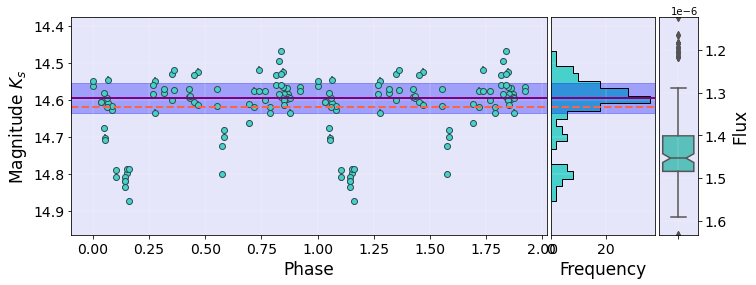

id_vvv 515881972438.0 Period_LS*2 1.3692385
1.3692385 515881972438.0


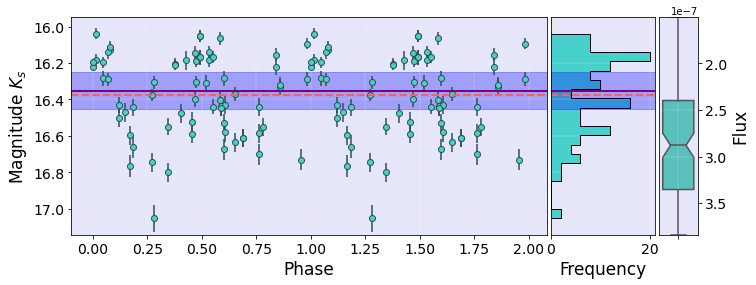

id_vvv 515881974444.0 Period_LS*2 8.02965
8.02965 515881974444.0


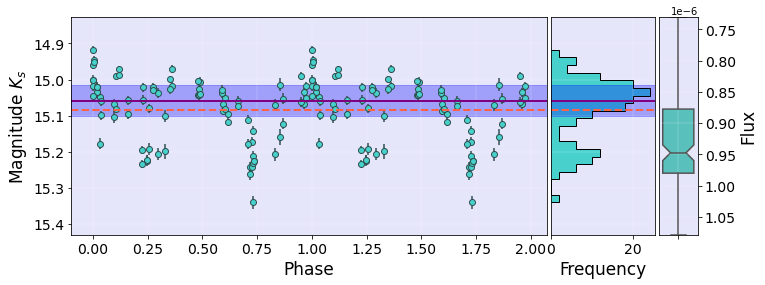

id_vvv 515881975040.0 Period_LS*2 2.285417
2.285417 515881975040.0


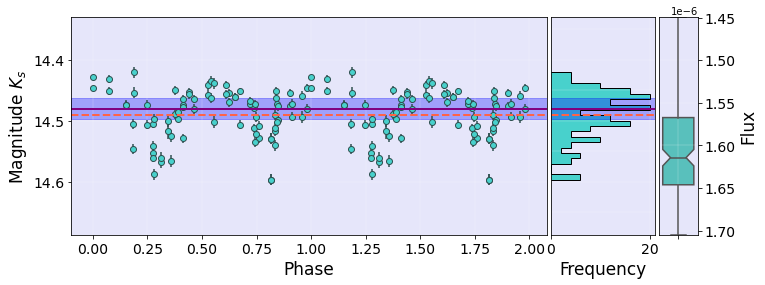

id_vvv 515881977669.0 Period_LS*2 0.8323754
0.8323754 515881977669.0


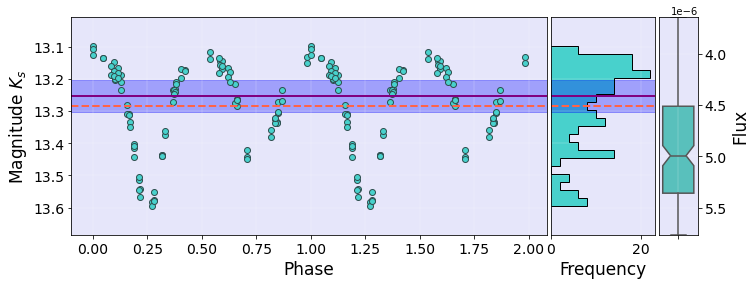

id_vvv 515881979343.0 Period_LS*2 1.0238582
1.0238582 515881979343.0


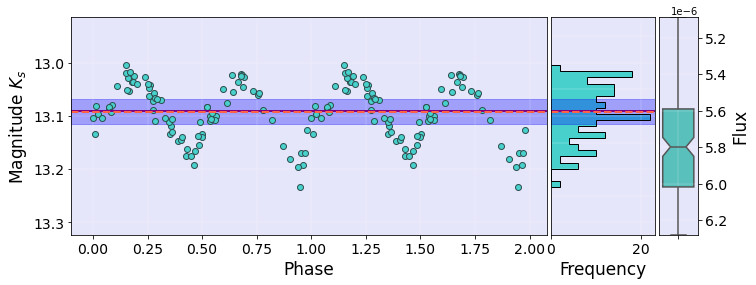

id_vvv 515881981366.0 Period_LS*2 0.90608912
0.90608912 515881981366.0


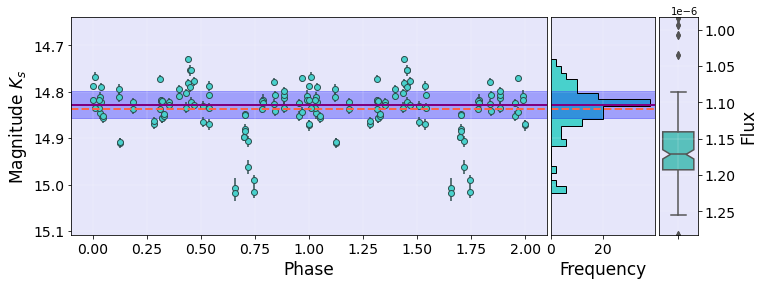

id_vvv 515881982702.0 Period_LS*2 2.090728
2.090728 515881982702.0


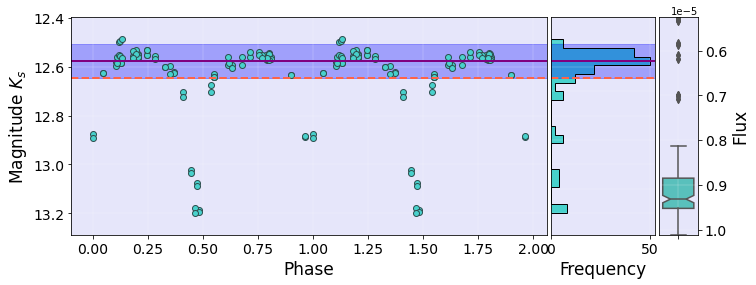

id_vvv 515881982781.0 Period_LS*2 0.85729736
0.85729736 515881982781.0


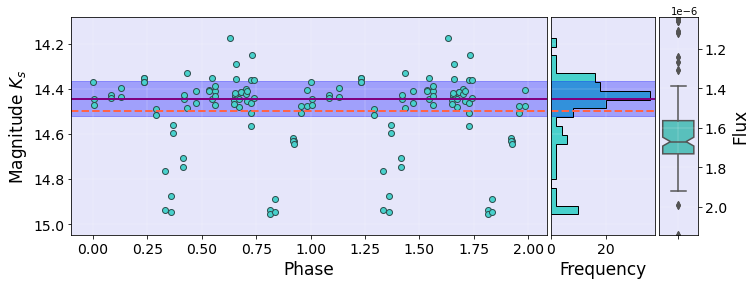

id_vvv 515881982859.0 Period_LS*2 0.80020184
0.80020184 515881982859.0


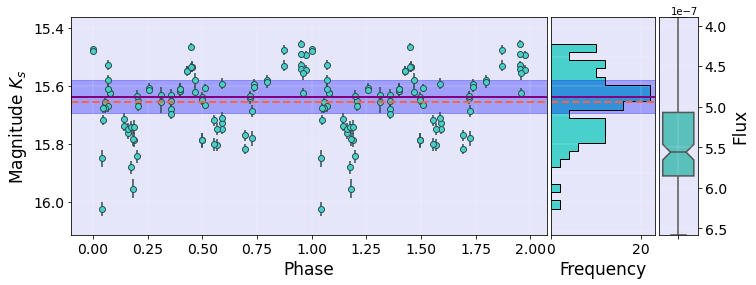

id_vvv 515881986273.0 Period_LS*2 1.9074494
1.9074494 515881986273.0


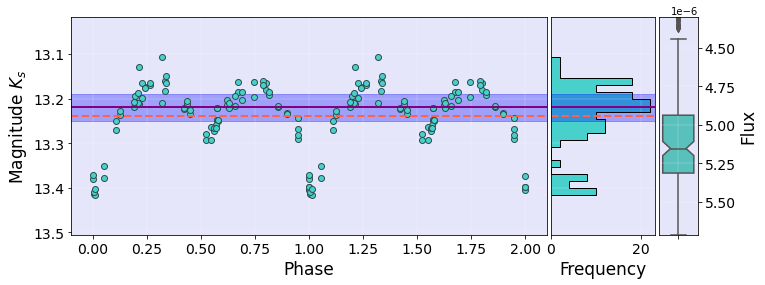

id_vvv 515881986483.0 Period_LS*2 1.442871
1.442871 515881986483.0


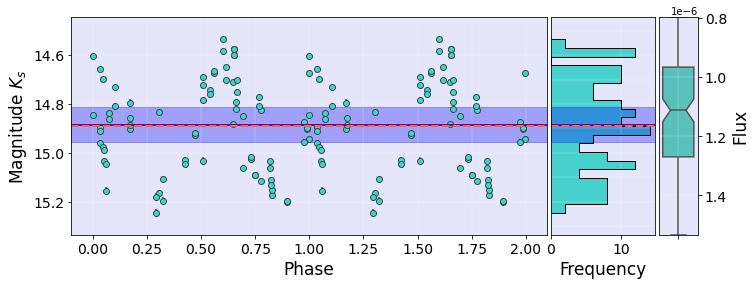

id_vvv 515881987508.0 Period_LS*2 2.1079576
2.1079576 515881987508.0


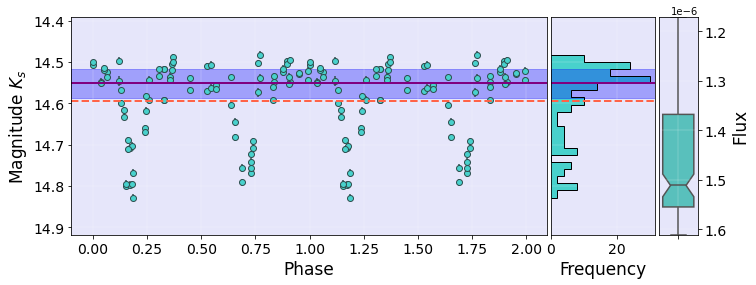

id_vvv 515881987771.0 Period_LS*2 0.91175914
0.91175914 515881987771.0


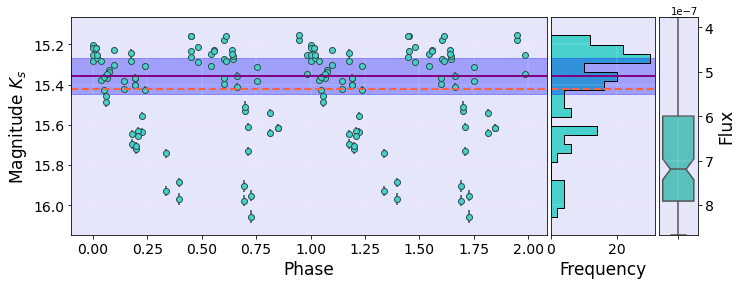

id_vvv 515881987850.0 Period_LS*2 0.5703603
0.5703603 515881987850.0


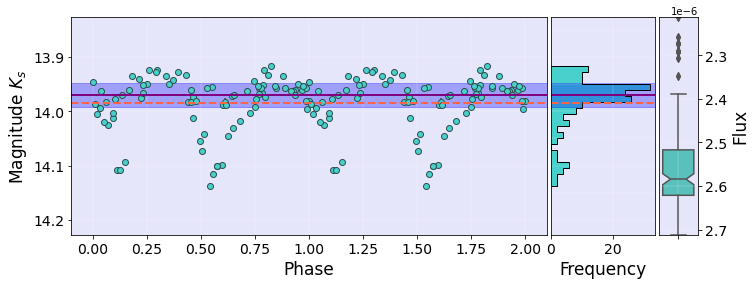

id_vvv 515881990487.0 Period_LS*2 2.4998378
2.4998378 515881990487.0


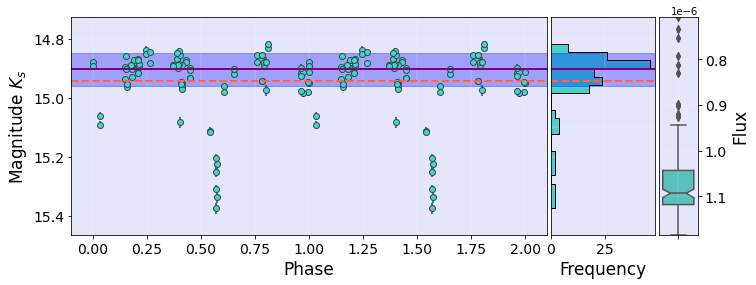

id_vvv 515881990616.0 Period_LS*2 1.312438
1.312438 515881990616.0


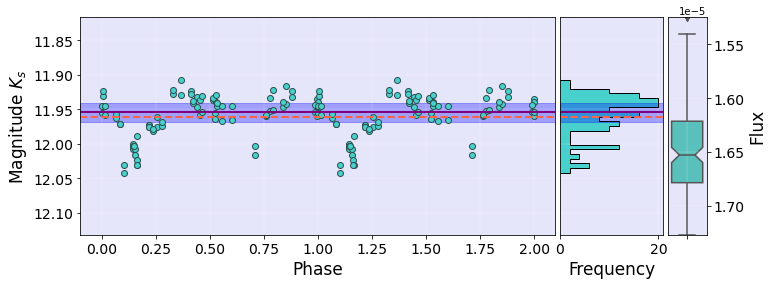

id_vvv 515881990830.0 Period_LS*2 0.790041
0.790041 515881990830.0


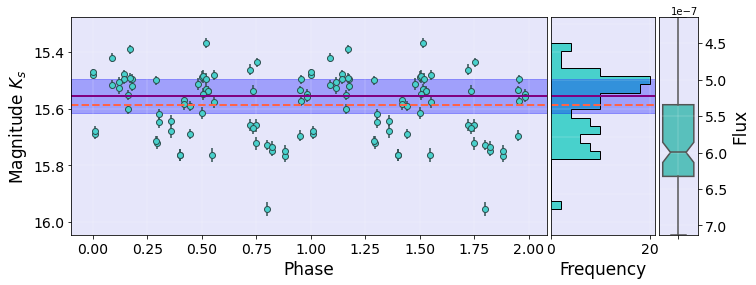

id_vvv 515881995506.0 Period_LS*2 5.8384494
5.8384494 515881995506.0


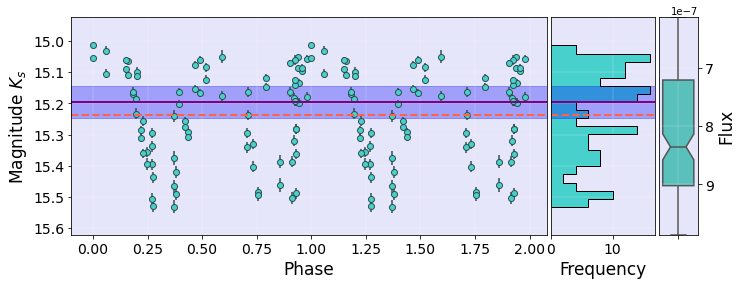

id_vvv 515881998125.0 Period_LS*2 1.00814568
1.00814568 515881998125.0


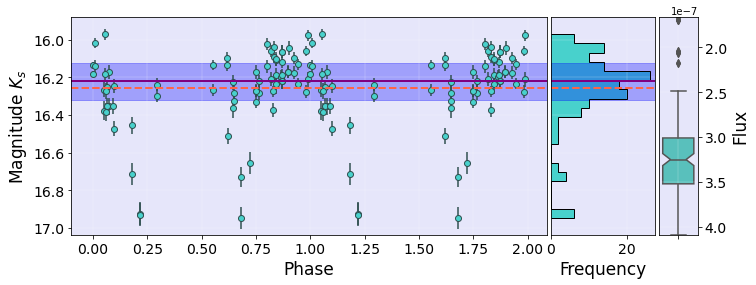

id_vvv 515882001928.0 Period_LS*2 0.58716572
0.58716572 515882001928.0


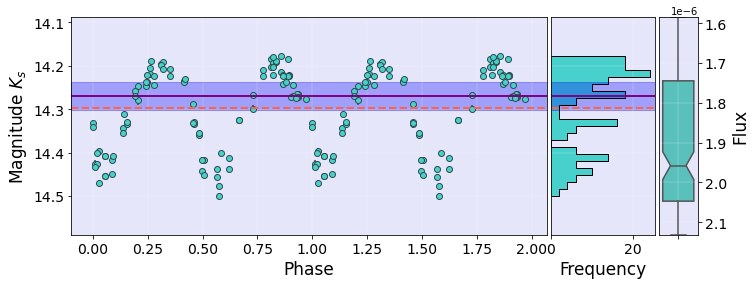

id_vvv 515882002252.0 Period_LS*2 1.63304294
1.63304294 515882002252.0


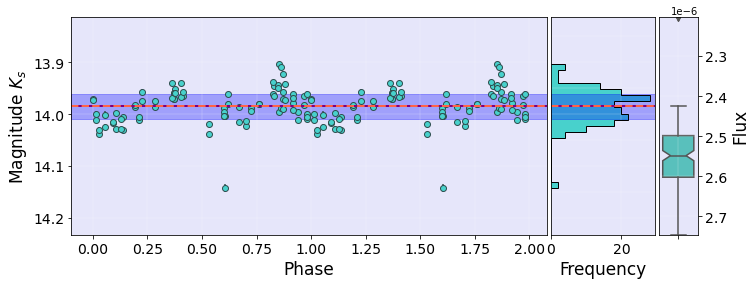

id_vvv 515882003336.0 Period_LS*2 0.7082733
0.7082733 515882003336.0


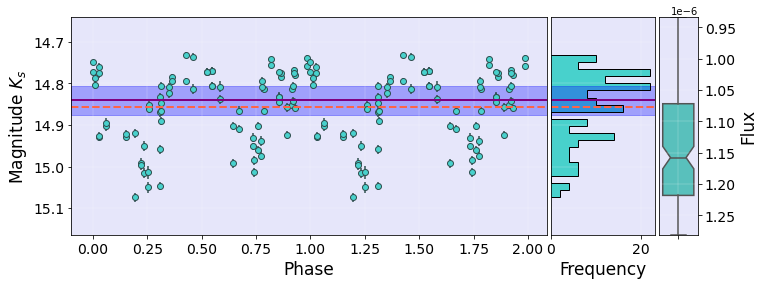

id_vvv 515882003671.0 Period_LS*2 0.65413594
0.65413594 515882003671.0


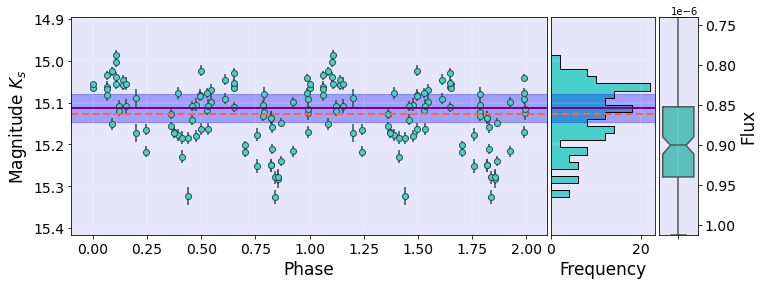

id_vvv 515882003707.0 Period_LS*2 1.0336322
1.0336322 515882003707.0


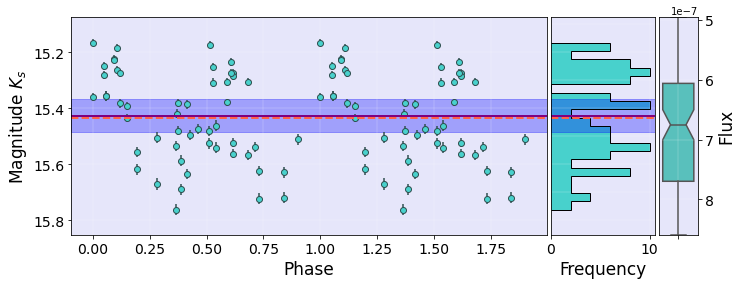

id_vvv 515882005618.0 Period_LS*2 0.86185492
0.86185492 515882005618.0


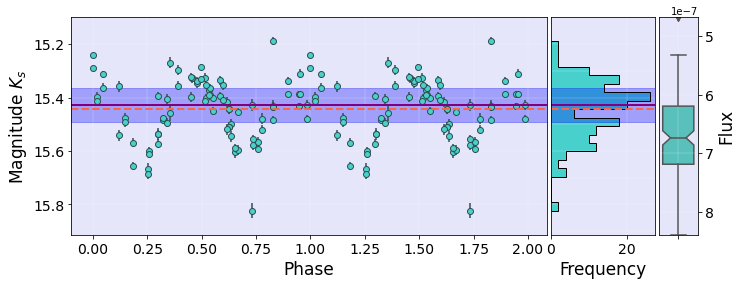

id_vvv 515882006766.0 Period_LS*2 0.7020954
0.7020954 515882006766.0


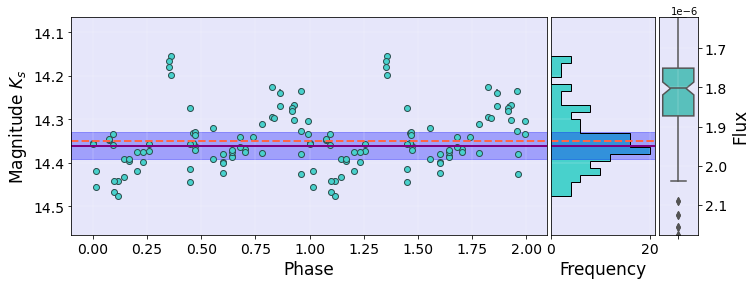

id_vvv 515882006856.0 Period_LS*2 19.96618
19.96618 515882006856.0


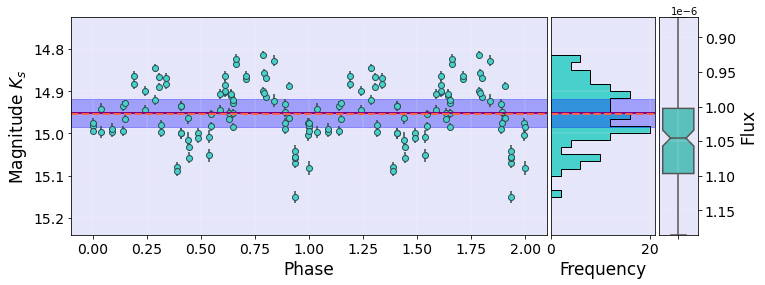

id_vvv 515882007366.0 Period_LS*2 1.07469332
1.07469332 515882007366.0


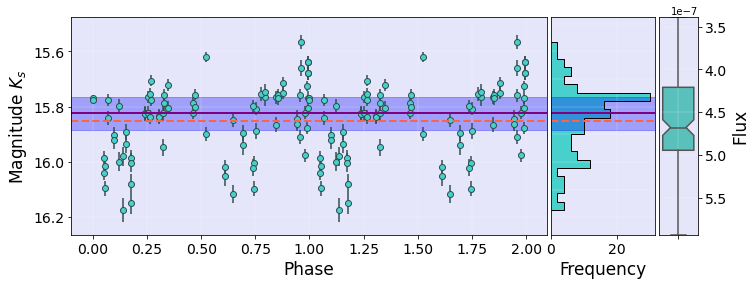

id_vvv 515882007836.0 Period_LS*2 0.83667112
0.83667112 515882007836.0


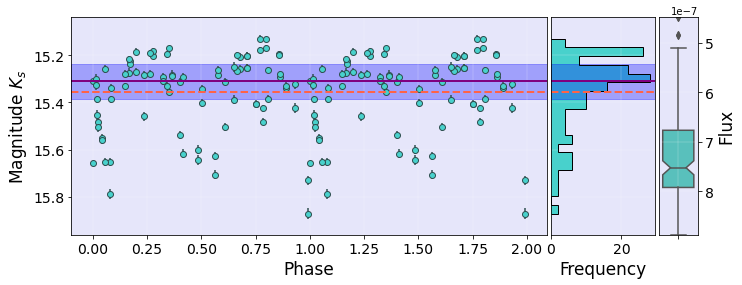

id_vvv 515882008976.0 Period_LS*2 3.2863676
3.2863676 515882008976.0


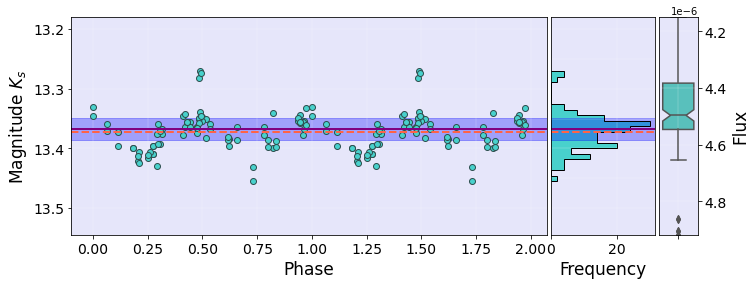

id_vvv 515882009836.0 Period_LS*2 5.771122
5.771122 515882009836.0


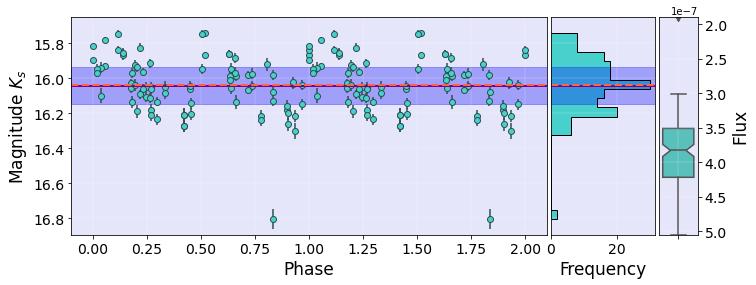

id_vvv 515882011052.0 Period_LS*2 0.6623416
0.6623416 515882011052.0


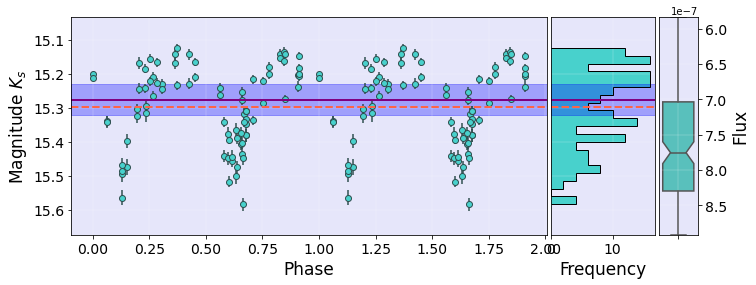

id_vvv 515882012110.0 Period_LS*2 0.46635172
0.46635172 515882012110.0


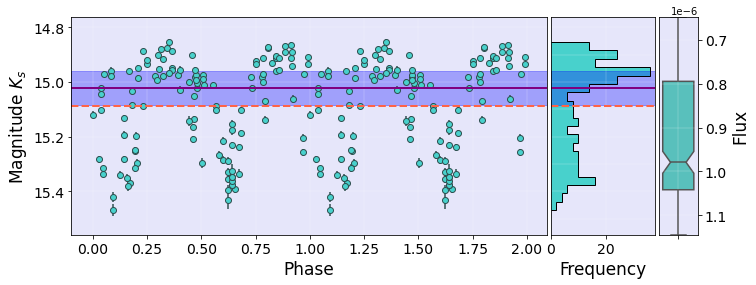

id_vvv 515882014454.0 Period_LS*2 1.3015778
1.3015778 515882014454.0


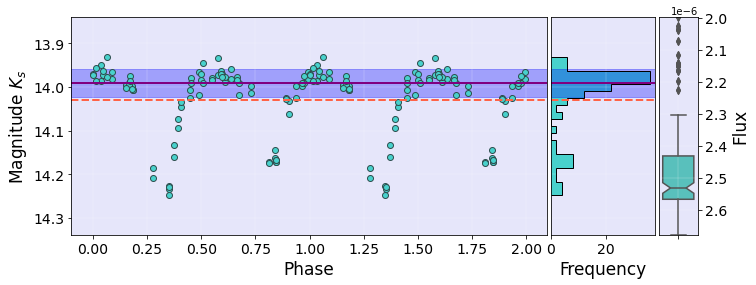

id_vvv 515882014740.0 Period_LS*2 0.5949964
0.5949964 515882014740.0


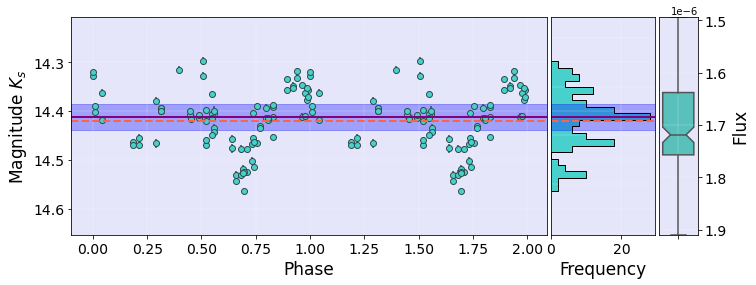

id_vvv 515882015617.0 Period_LS*2 0.6610483
0.6610483 515882015617.0


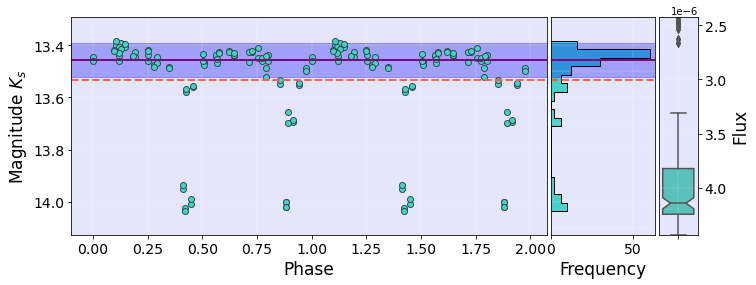

id_vvv 515882020609.0 Period_LS*2 2.085425
2.085425 515882020609.0


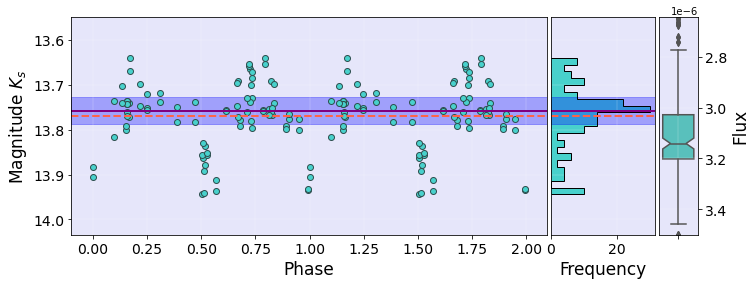

id_vvv 515882021078.0 Period_LS*2 1.1649717
1.1649717 515882021078.0


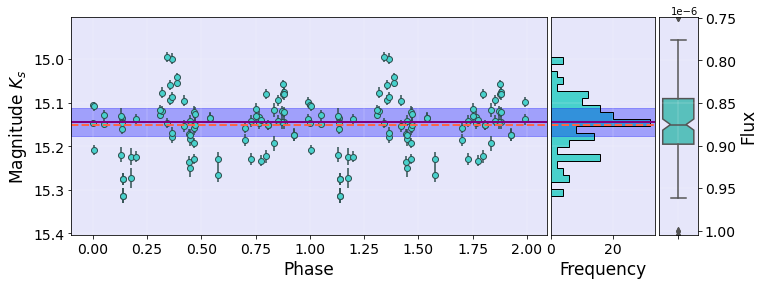

id_vvv 515882021467.0 Period_LS*2 0.5830612
0.5830612 515882021467.0


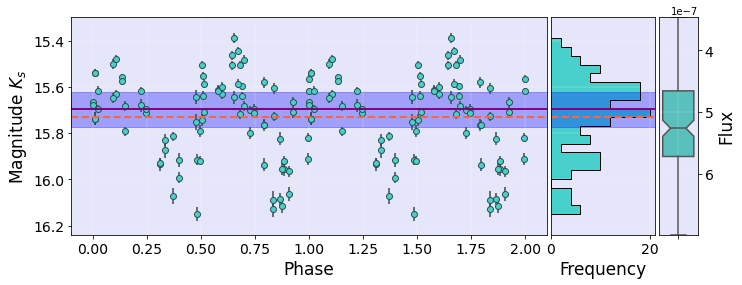

id_vvv 515882022343.0 Period_LS*2 1.8663158
1.8663158 515882022343.0


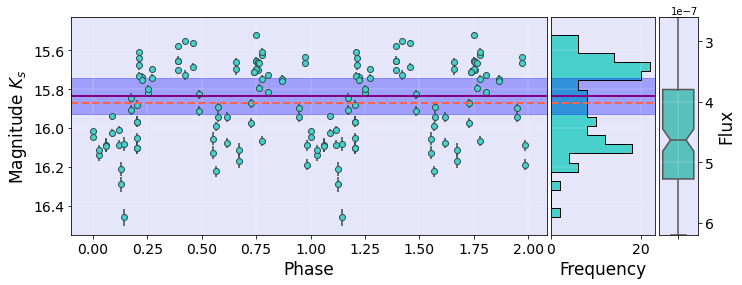

id_vvv 515882023444.0 Period_LS*2 0.7886337
0.7886337 515882023444.0


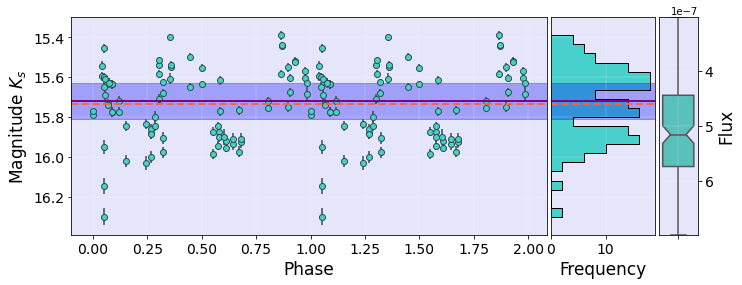

id_vvv 515882024782.0 Period_LS*2 0.690223
0.690223 515882024782.0


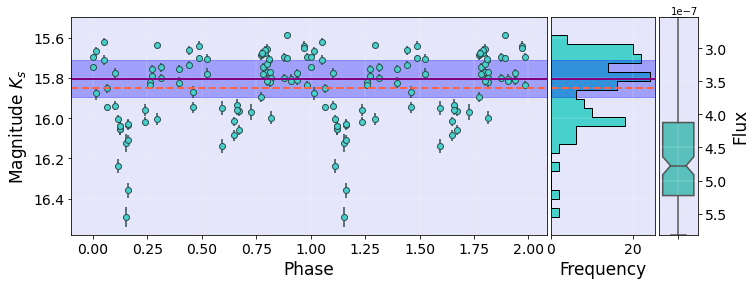

id_vvv 515882025121.0 Period_LS*2 0.67508304
0.67508304 515882025121.0


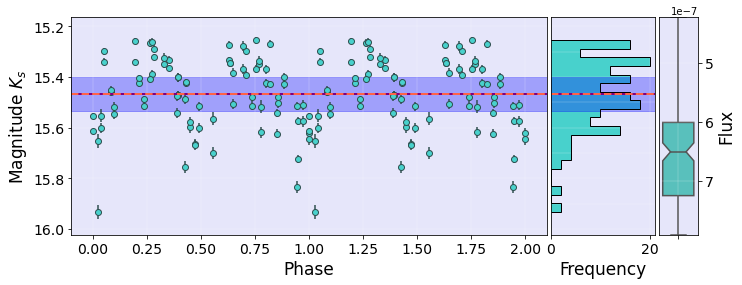

id_vvv 515882025745.0 Period_LS*2 0.87072152
0.87072152 515882025745.0


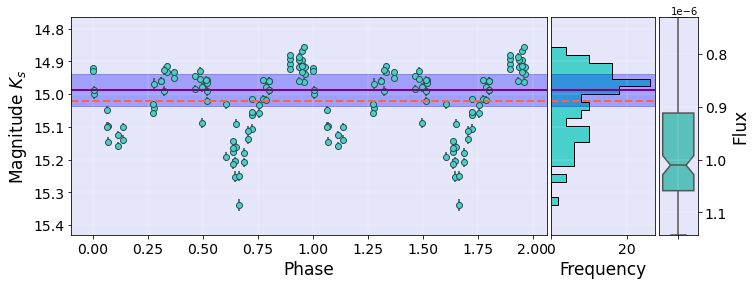

id_vvv 515882025877.0 Period_LS*2 0.61783112
0.61783112 515882025877.0


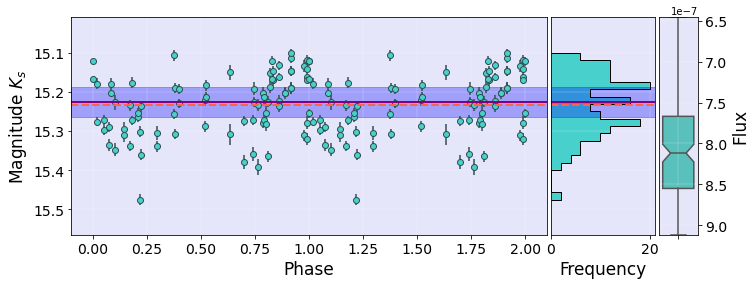

id_vvv 515882027625.0 Period_LS*2 8.0803814
8.0803814 515882027625.0


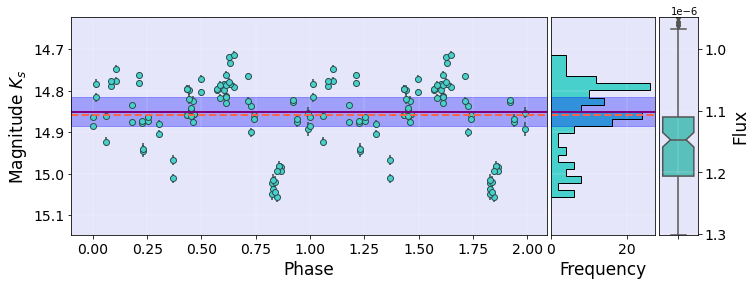

id_vvv 515882029245.0 Period_LS*2 0.85961884
0.85961884 515882029245.0


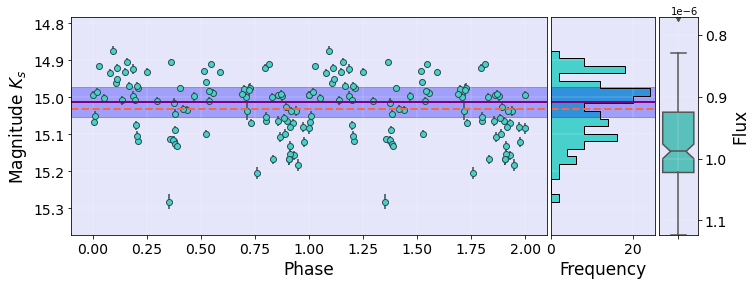

id_vvv 515882031104.0 Period_LS*2 223.50492
223.50492 515882031104.0


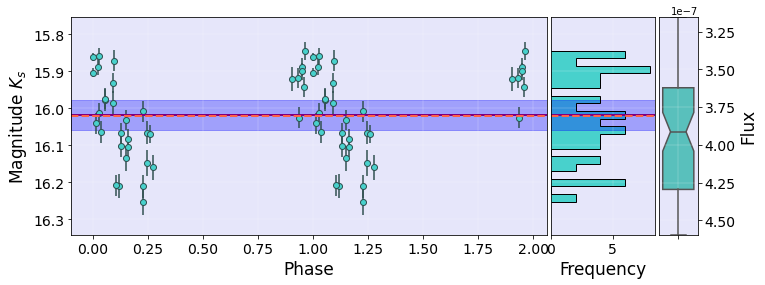

id_vvv 515882031757.0 Period_LS*2 3.4416216
3.4416216 515882031757.0


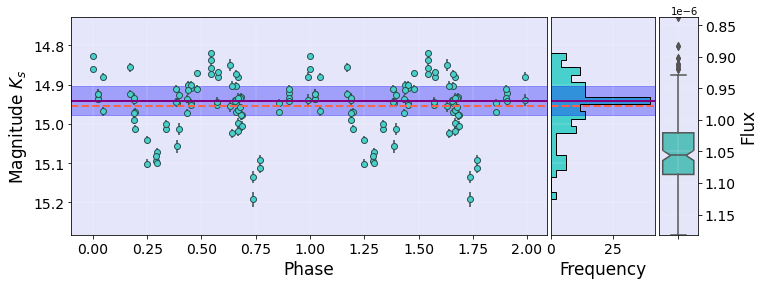

id_vvv 515882032440.0 Period_LS*2 1.800908
1.800908 515882032440.0


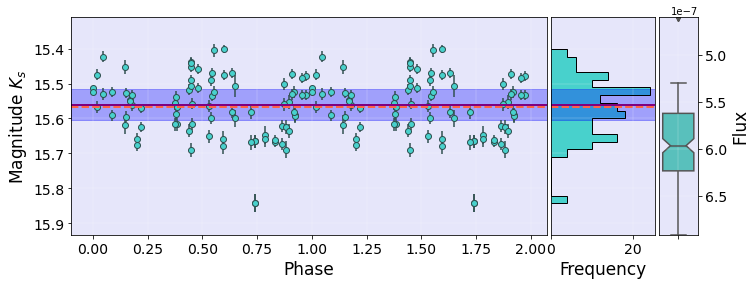

id_vvv 515882033318.0 Period_LS*2 2.2124946
2.2124946 515882033318.0


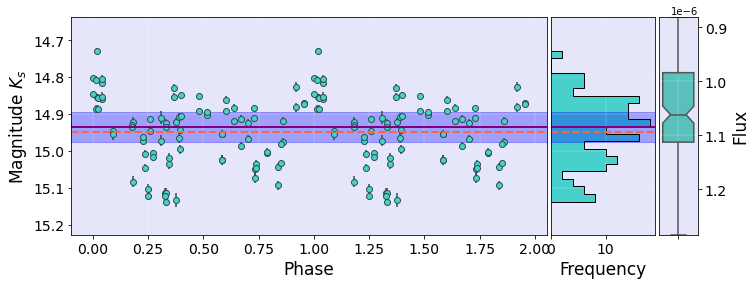

id_vvv 515882038432.0 Period_LS*2 1.24741292
1.24741292 515882038432.0


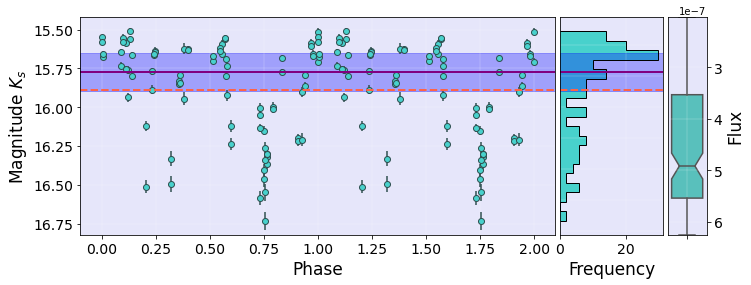

id_vvv 515882038456.0 Period_LS*2 1.1800426
1.1800426 515882038456.0


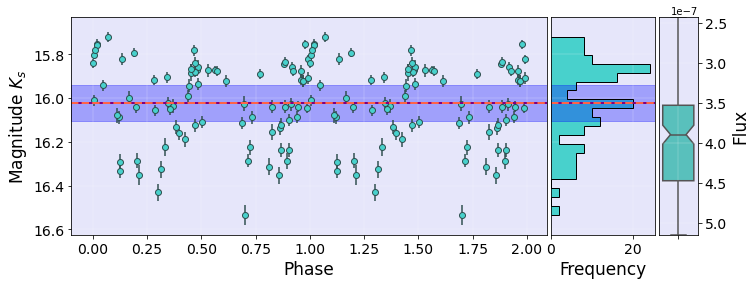

id_vvv 515882040038.0 Period_LS*2 2.4123446
2.4123446 515882040038.0


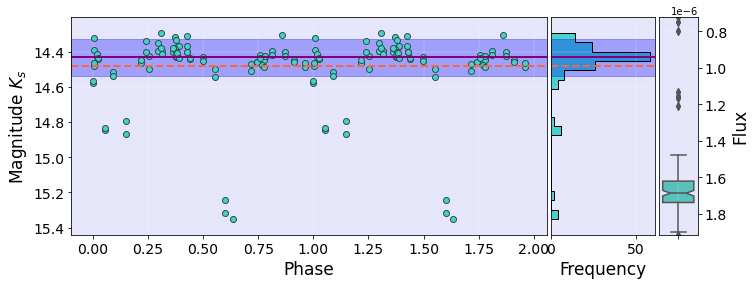

id_vvv 515882040484.0 Period_LS*2 1.52285552
1.52285552 515882040484.0


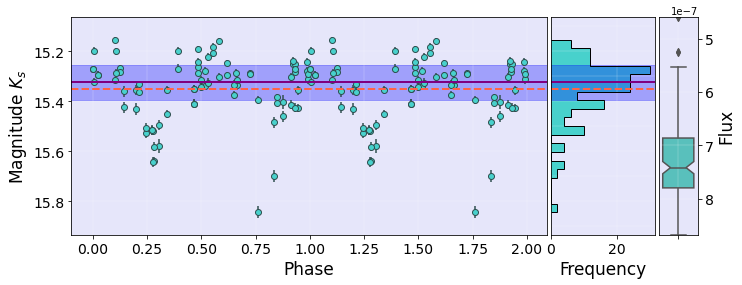

id_vvv 515882049432.0 Period_LS*2 2.2090976
2.2090976 515882049432.0


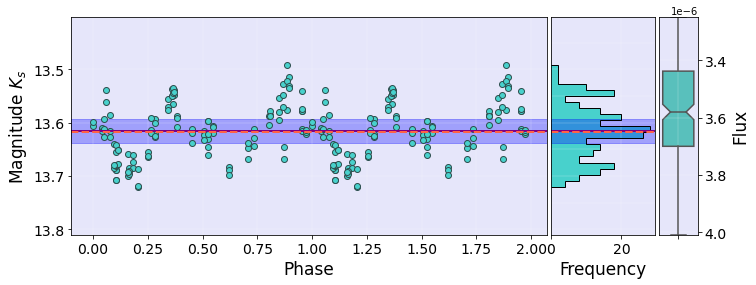

id_vvv 515882050205.0 Period_LS*2 2.320432
2.320432 515882050205.0


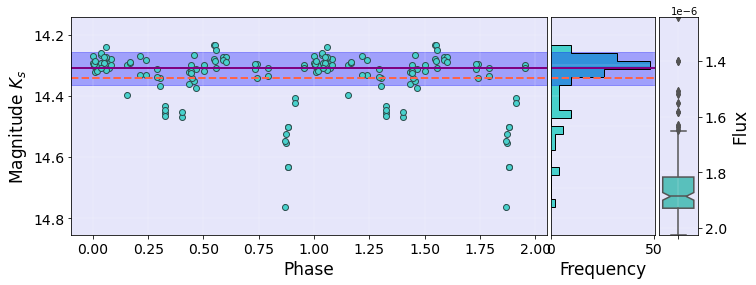

id_vvv 515882052115.0 Period_LS*2 0.72904348
0.72904348 515882052115.0


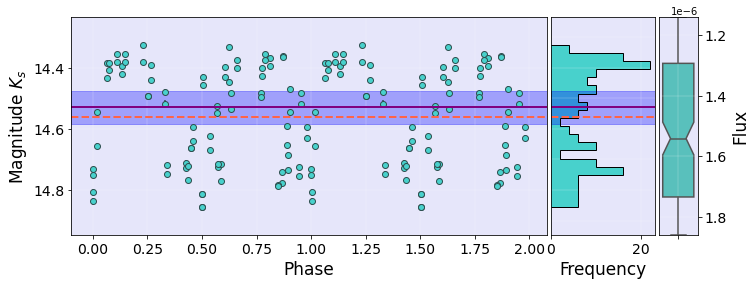

id_vvv 515882053812.0 Period_LS*2 15.07597
15.07597 515882053812.0


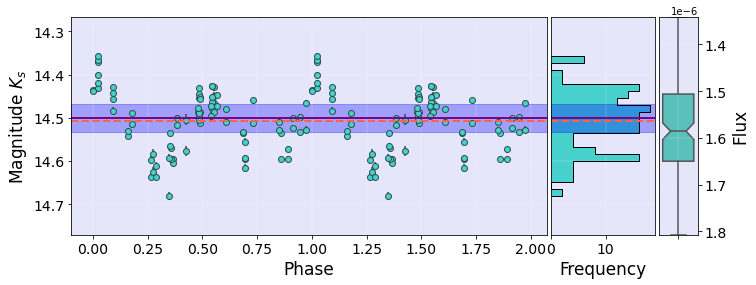

id_vvv 515882054428.0 Period_LS*2 0.59081244
0.59081244 515882054428.0


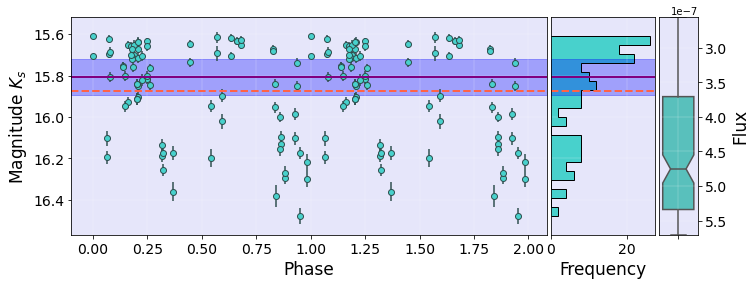

id_vvv 515882054588.0 Period_LS*2 0.8317138
0.8317138 515882054588.0


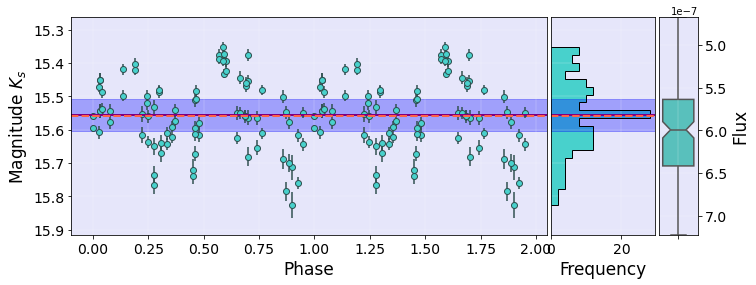

id_vvv 515882054611.0 Period_LS*2 0.81788486
0.81788486 515882054611.0


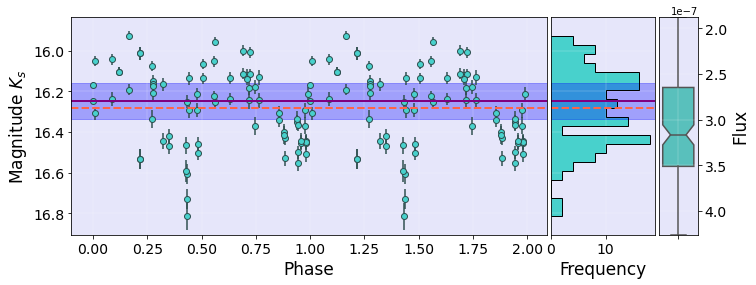

id_vvv 515882054625.0 Period_LS*2 1.358893
1.358893 515882054625.0


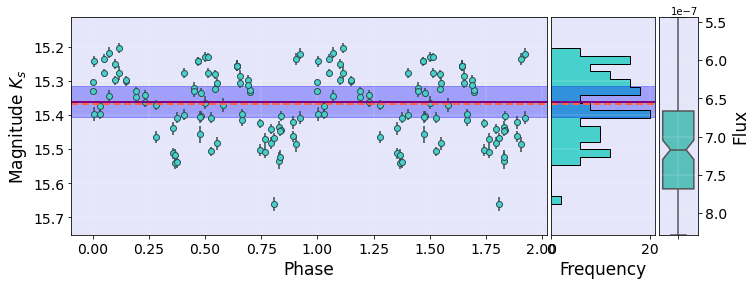

id_vvv 515882055342.0 Period_LS*2 0.84397132
0.84397132 515882055342.0


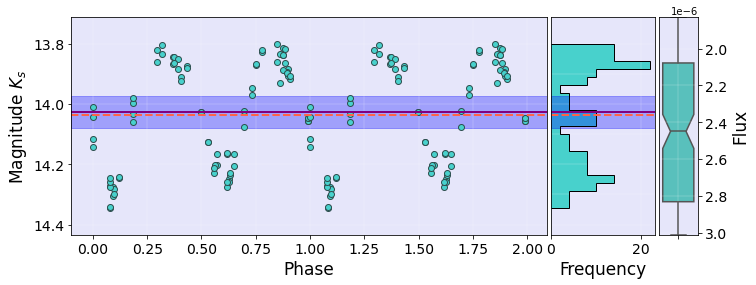

id_vvv 515882056016.0 Period_LS*2 0.7473625
0.7473625 515882056016.0


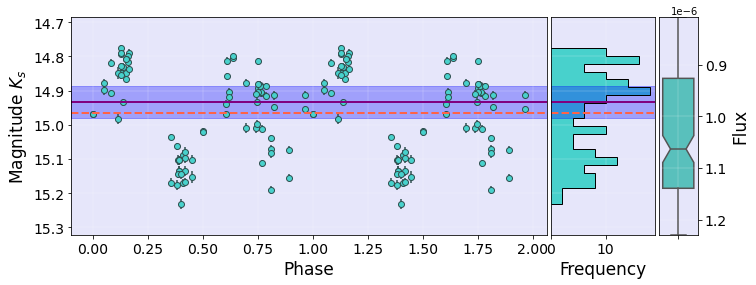

id_vvv 515882056202.0 Period_LS*2 0.626439
0.626439 515882056202.0


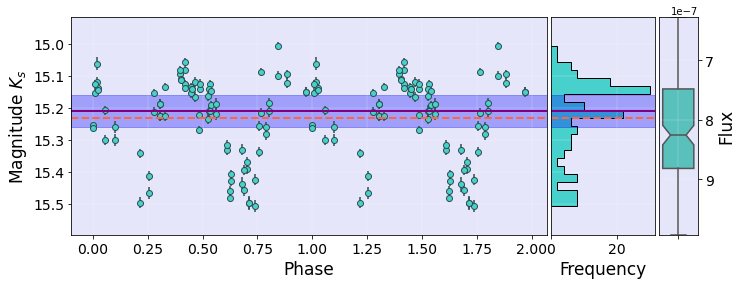

id_vvv 515882056274.0 Period_LS*2 0.80795306
0.80795306 515882056274.0


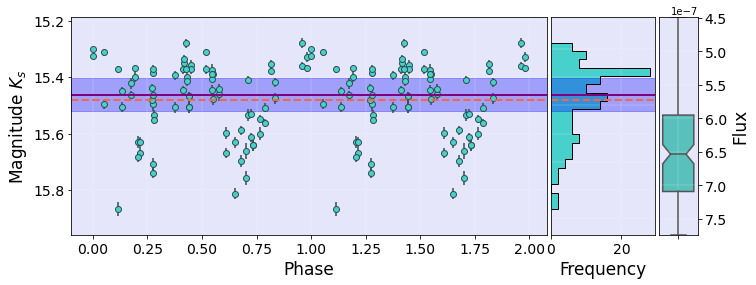

id_vvv 515882057091.0 Period_LS*2 0.7009837
0.7009837 515882057091.0


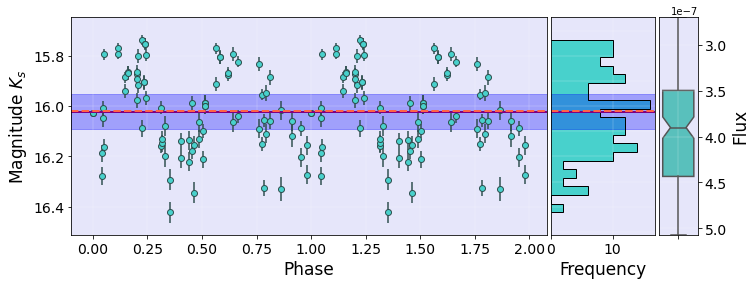

id_vvv 515882062304.0 Period_LS*2 0.598088
0.598088 515882062304.0


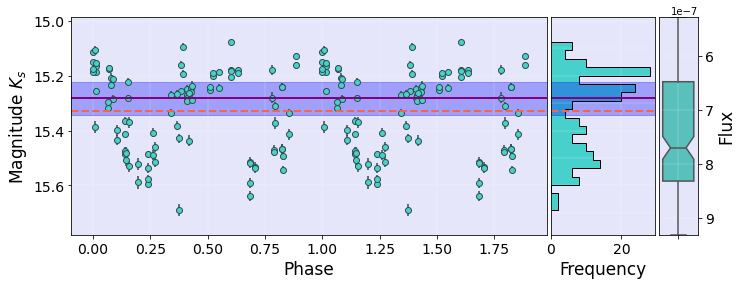

id_vvv 515882062766.0 Period_LS*2 0.7171122
0.7171122 515882062766.0


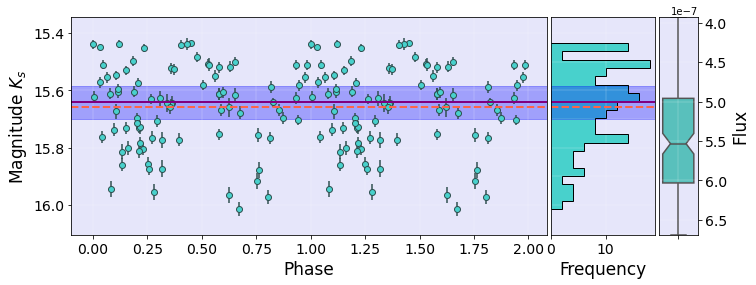

id_vvv 515882063198.0 Period_LS*2 0.64414244
0.64414244 515882063198.0


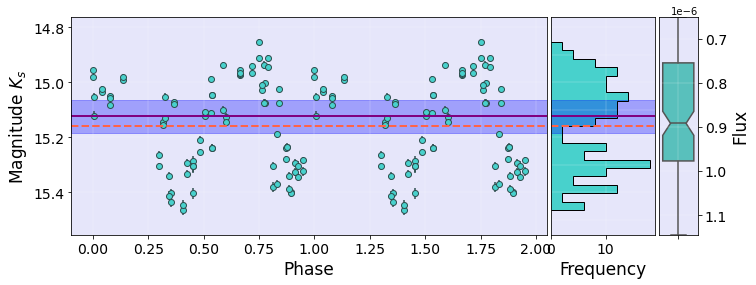

id_vvv 515882065227.0 Period_LS*2 0.3410368
0.3410368 515882065227.0


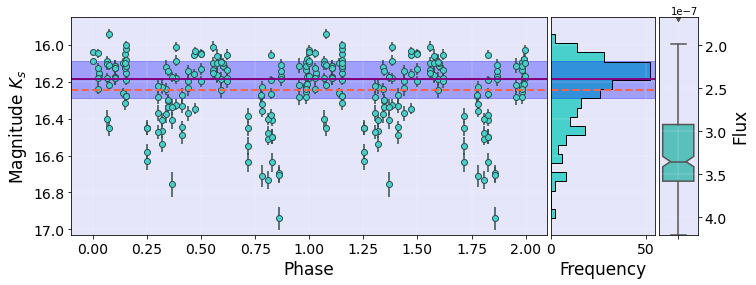

id_vvv 515882065265.0 Period_LS*2 0.51647872
0.51647872 515882065265.0


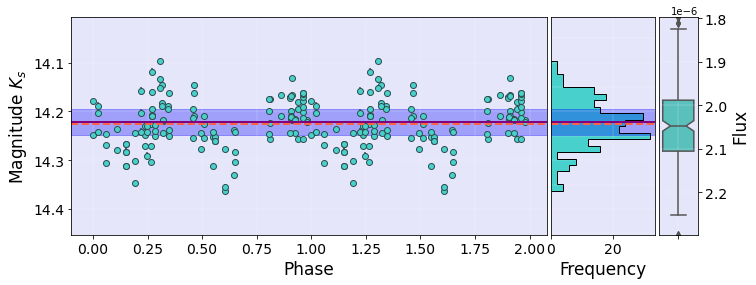

id_vvv 515882068121.0 Period_LS*2 1.9224222
1.9224222 515882068121.0


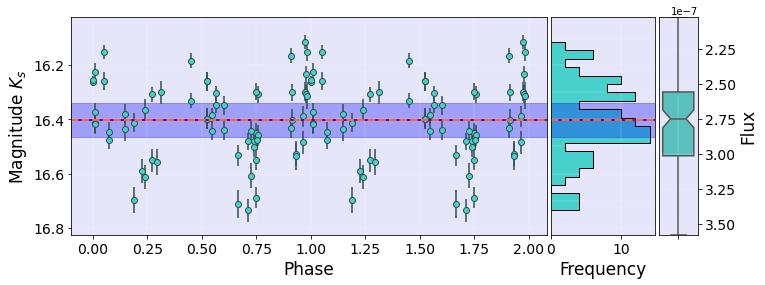

id_vvv 515882068205.0 Period_LS*2 3.209397
3.209397 515882068205.0


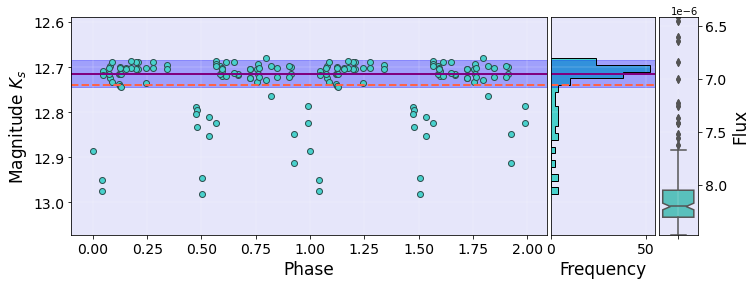

id_vvv 515882069527.0 Period_LS*2 1.34728194
1.34728194 515882069527.0


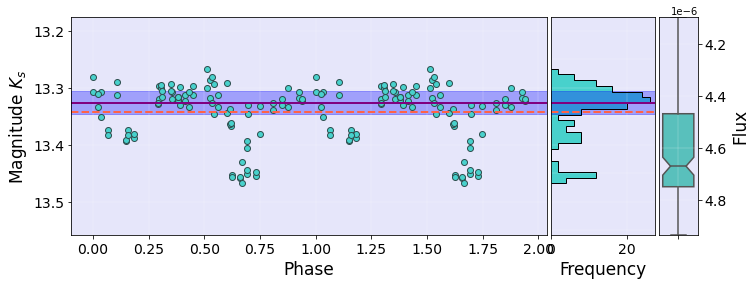

id_vvv 515882069584.0 Period_LS*2 1.3733226
1.3733226 515882069584.0


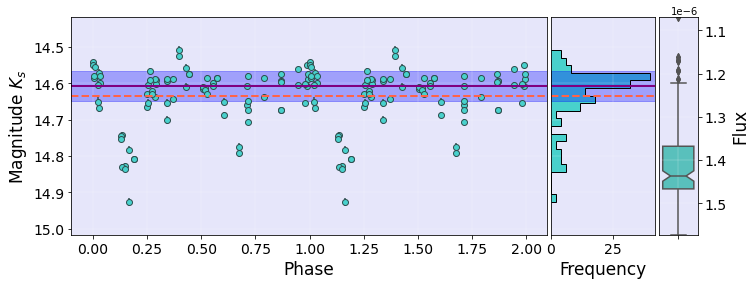

id_vvv 515882070759.0 Period_LS*2 1.97148288
1.97148288 515882070759.0


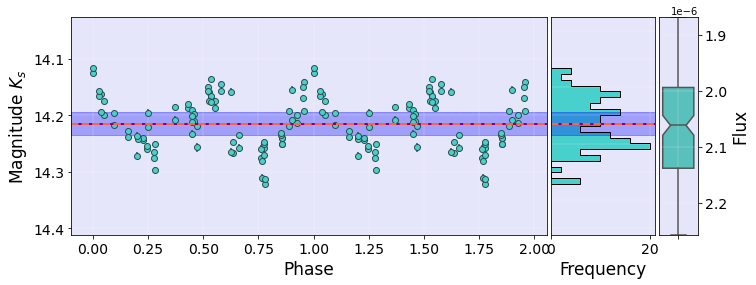

id_vvv 515882072065.0 Period_LS*2 0.8058601
0.8058601 515882072065.0


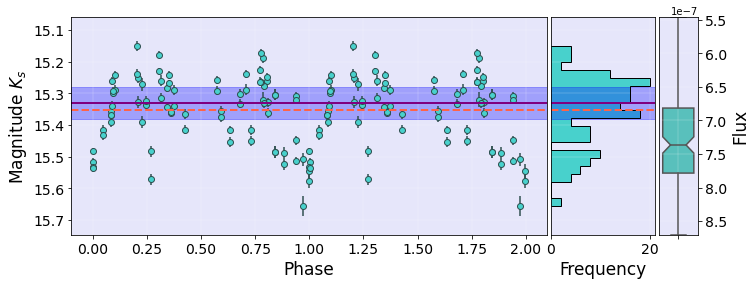

id_vvv 515882073523.0 Period_LS*2 3.1138924
3.1138924 515882073523.0


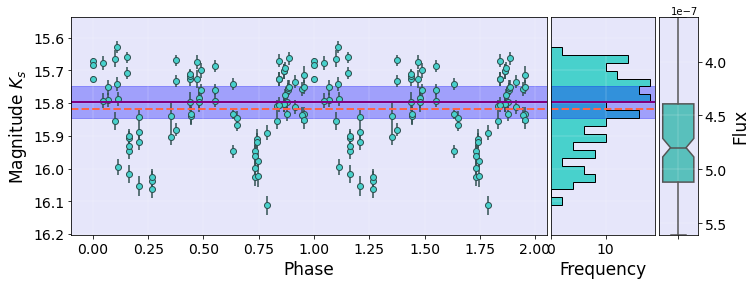

id_vvv 515882073869.0 Period_LS*2 0.57625992
0.57625992 515882073869.0


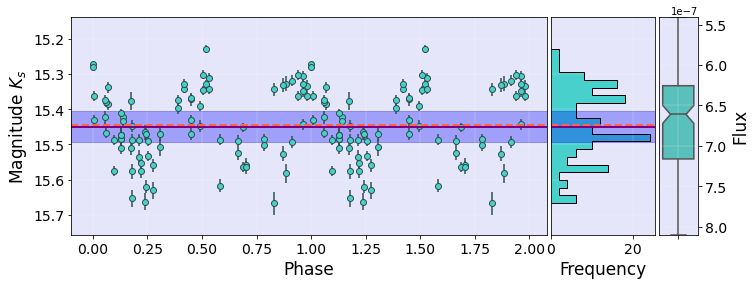

id_vvv 515882074532.0 Period_LS*2 1.4847473
1.4847473 515882074532.0


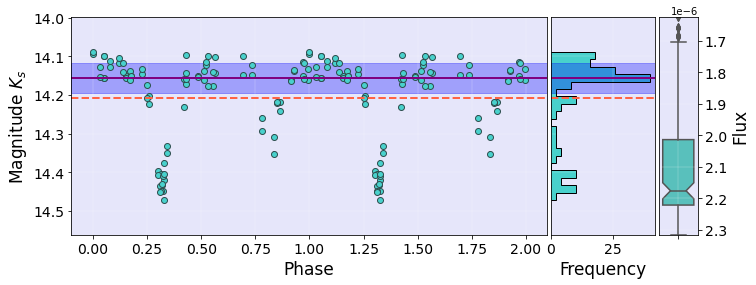

id_vvv 515882074651.0 Period_LS*2 6.8576126
6.8576126 515882074651.0


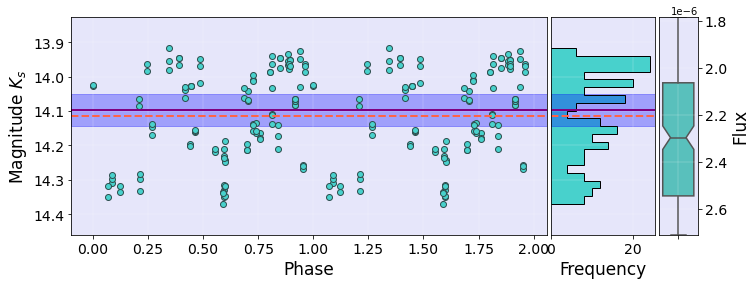

id_vvv 515882075673.0 Period_LS*2 1.68689132
1.68689132 515882075673.0


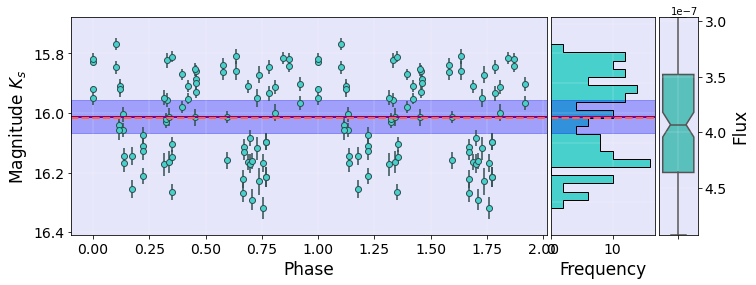

id_vvv 515882075819.0 Period_LS*2 1.0520041
1.0520041 515882075819.0


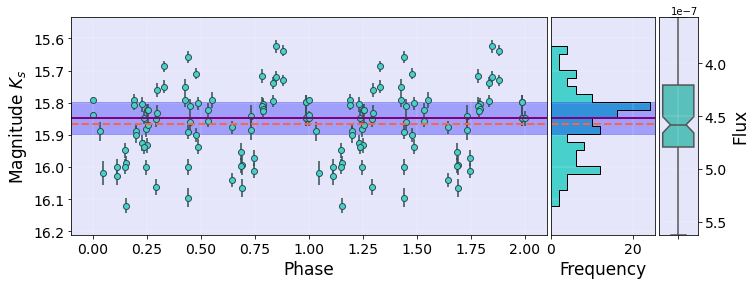

id_vvv 515882079501.0 Period_LS*2 2.059348
2.059348 515882079501.0


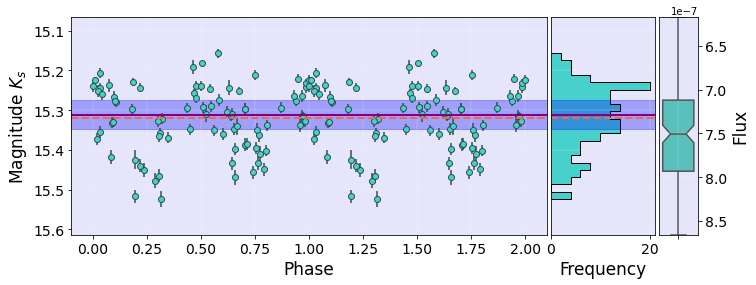

id_vvv 515882081129.0 Period_LS*2 13.809842
13.809842 515882081129.0


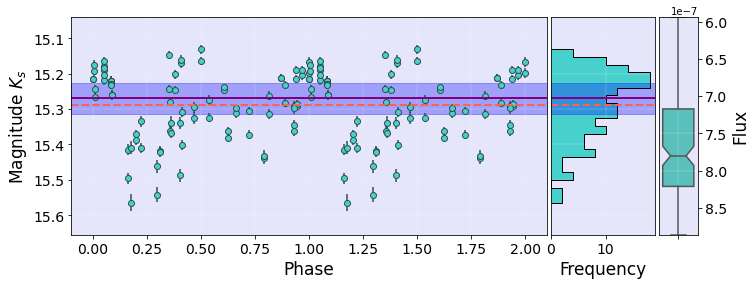

id_vvv 515882082428.0 Period_LS*2 18.05569
18.05569 515882082428.0


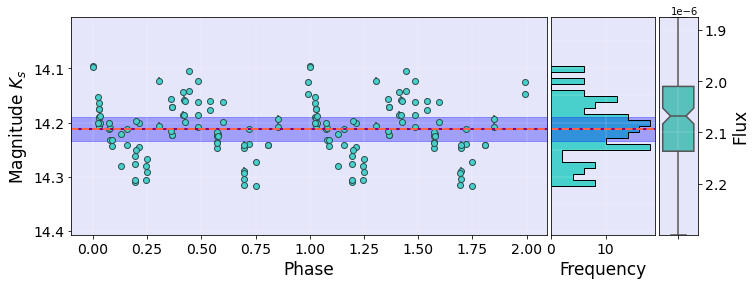

id_vvv 515882082498.0 Period_LS*2 1.22706712
1.22706712 515882082498.0


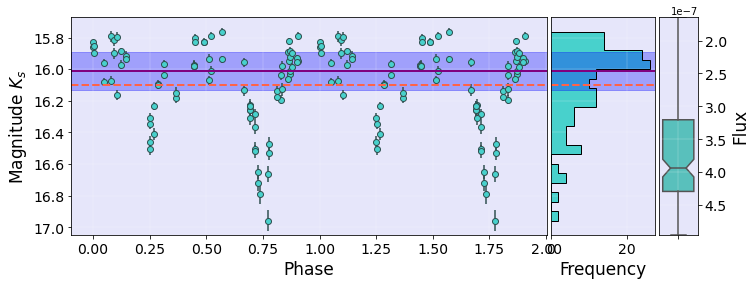

id_vvv 515882084294.0 Period_LS*2 1.50769568
1.50769568 515882084294.0


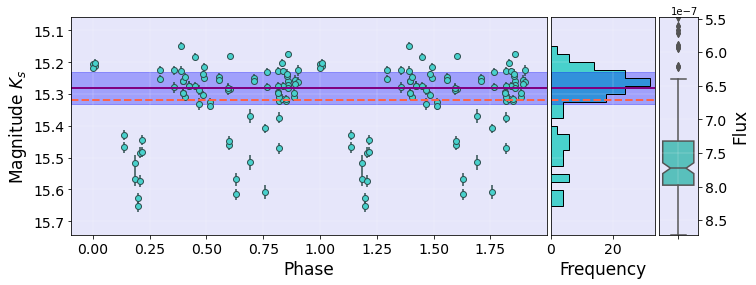

id_vvv 515882087322.0 Period_LS*2 2.252765
2.252765 515882087322.0


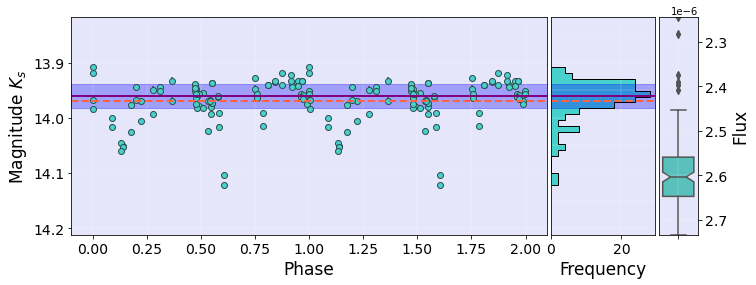

id_vvv 515882088248.0 Period_LS*2 2.3764846
2.3764846 515882088248.0


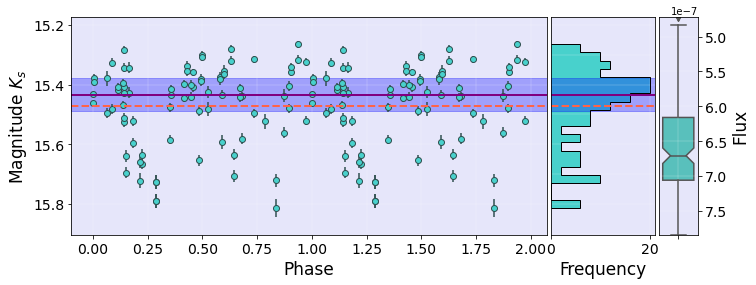

id_vvv 515882090542.0 Period_LS*2 0.7390134
0.7390134 515882090542.0


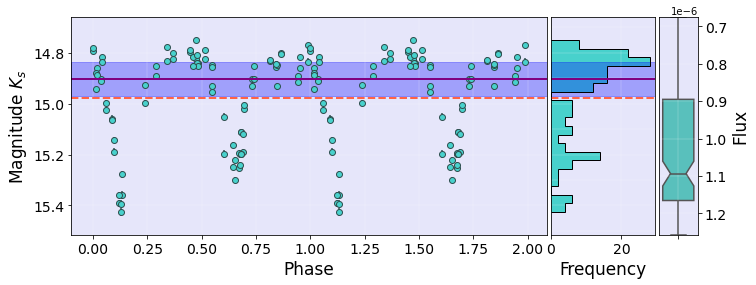

id_vvv 515882090912.0 Period_LS*2 0.5849576
0.5849576 515882090912.0


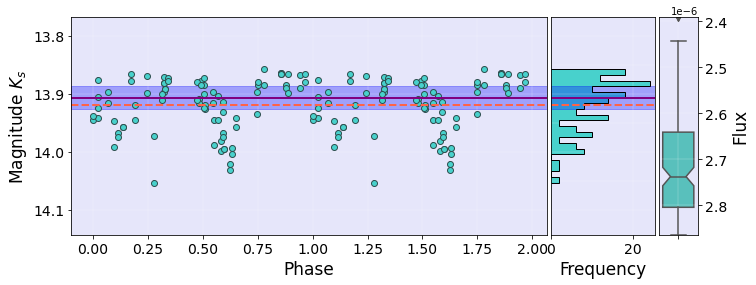

id_vvv 515882091227.0 Period_LS*2 2.9885766
2.9885766 515882091227.0


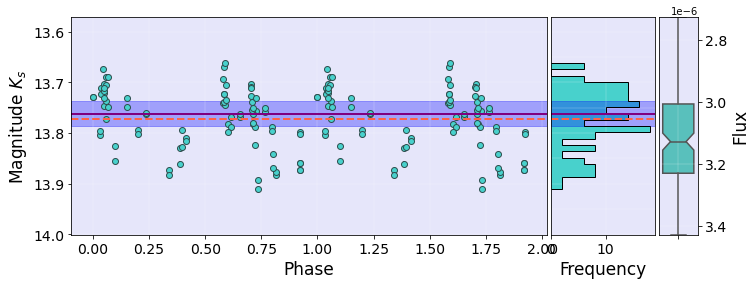

id_vvv 515882094626.0 Period_LS*2 0.75496036
0.75496036 515882094626.0


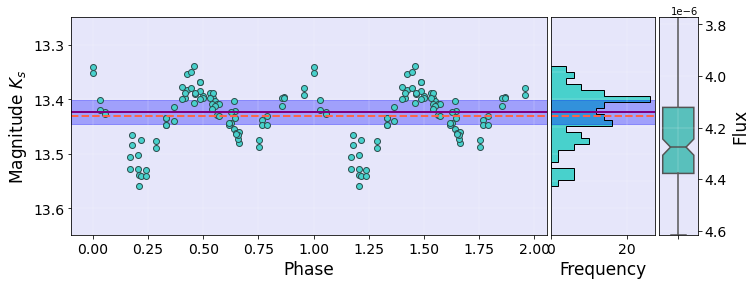

id_vvv 515882095334.0 Period_LS*2 1.1100346
1.1100346 515882095334.0


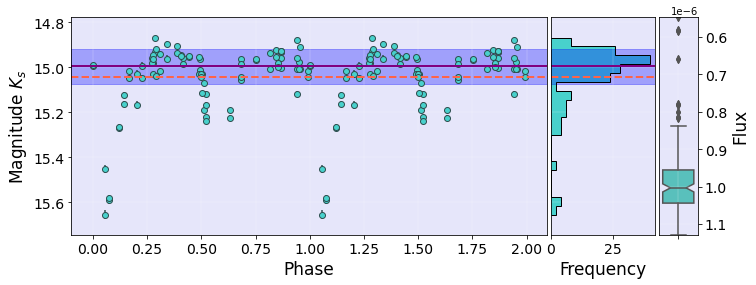

id_vvv 515882097437.0 Period_LS*2 0.65443348
0.65443348 515882097437.0


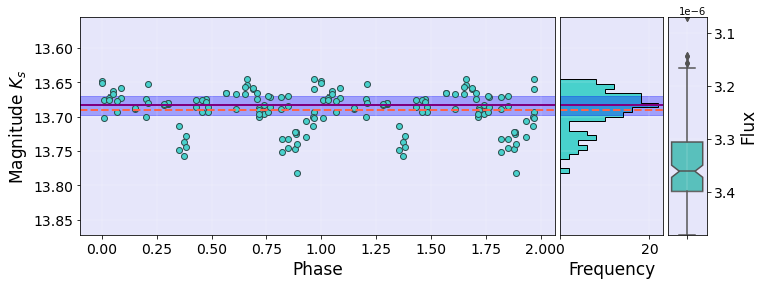

id_vvv 515882100039.0 Period_LS*2 0.847451
0.847451 515882100039.0


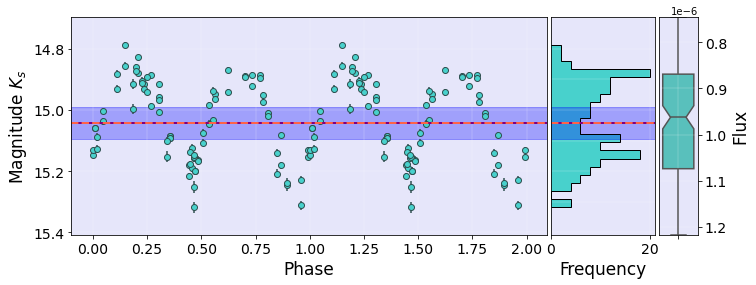

id_vvv 515882100356.0 Period_LS*2 1.3797426
1.3797426 515882100356.0


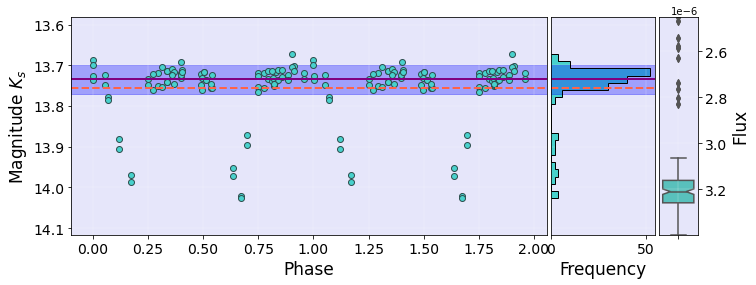

id_vvv 515882100456.0 Period_LS*2 6.508625
6.508625 515882100456.0


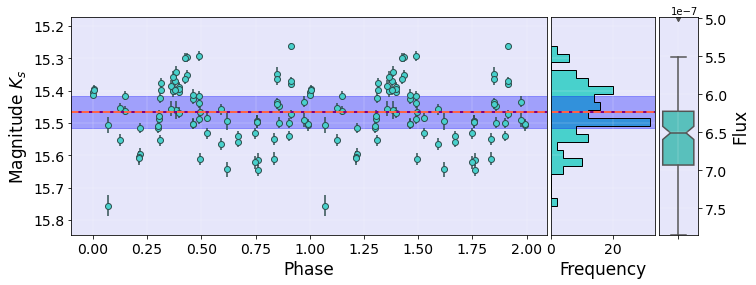

id_vvv 515882102952.0 Period_LS*2 0.61673874
0.61673874 515882102952.0


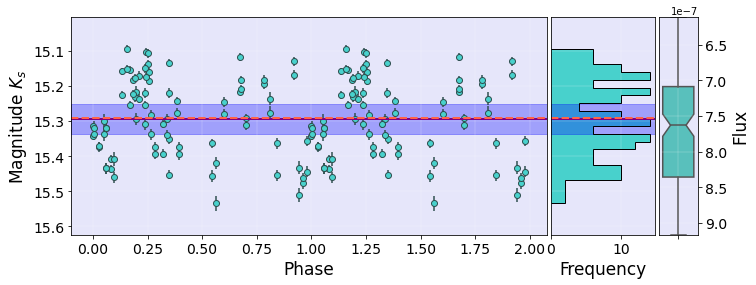

id_vvv 515882104884.0 Period_LS*2 0.5896321
0.5896321 515882104884.0


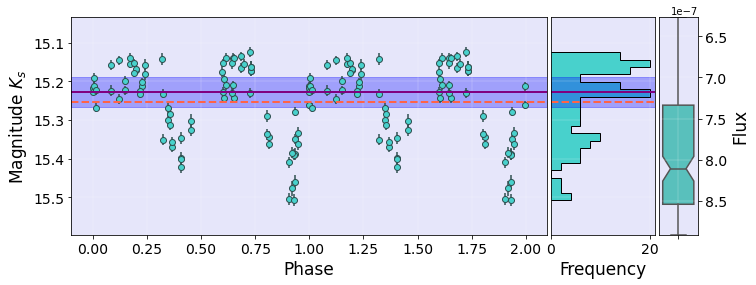

id_vvv 515882104957.0 Period_LS*2 0.65213466
0.65213466 515882104957.0


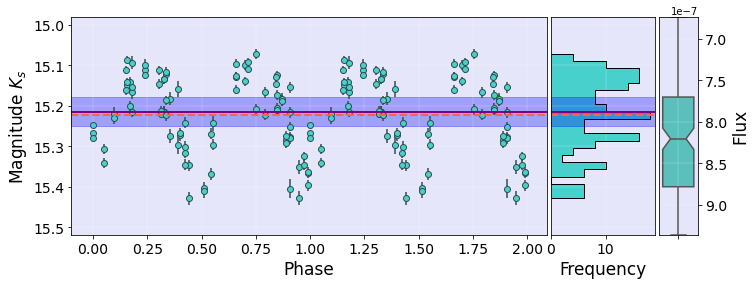

id_vvv 515882106279.0 Period_LS*2 1.45215452
1.45215452 515882106279.0


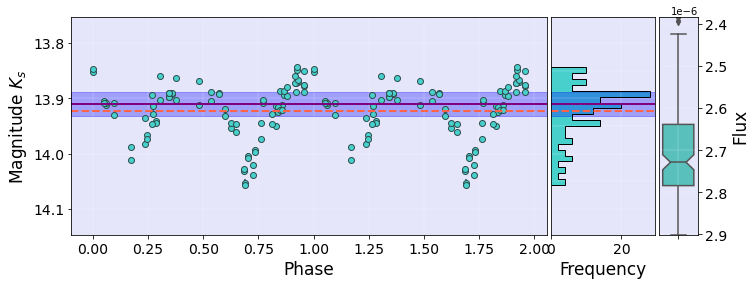

id_vvv 515882106327.0 Period_LS*2 1.0400274
1.0400274 515882106327.0


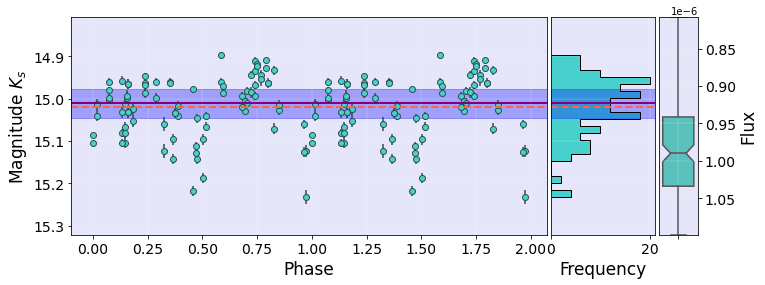

id_vvv 515882108055.0 Period_LS*2 1.465466
1.465466 515882108055.0


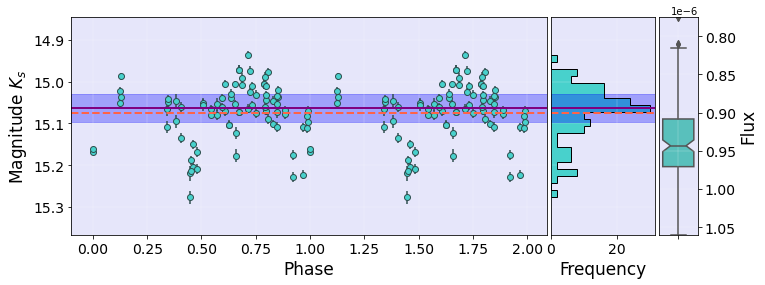

id_vvv 515882109838.0 Period_LS*2 1.8450848
1.8450848 515882109838.0


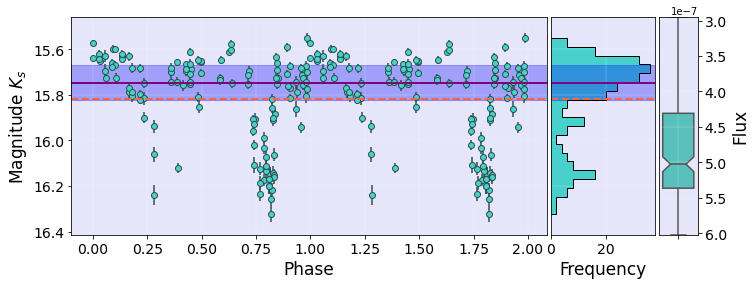

id_vvv 515882112254.0 Period_LS*2 0.59524256
0.59524256 515882112254.0


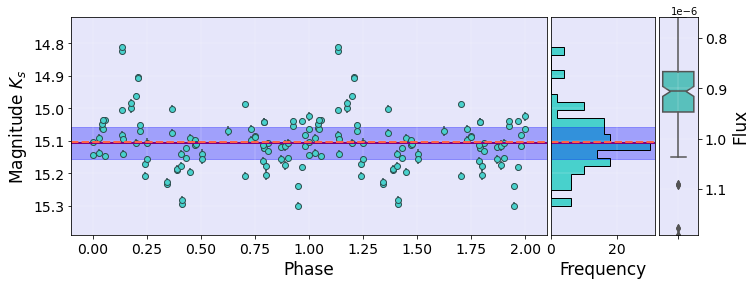

id_vvv 515882112323.0 Period_LS*2 2.8299264
2.8299264 515882112323.0


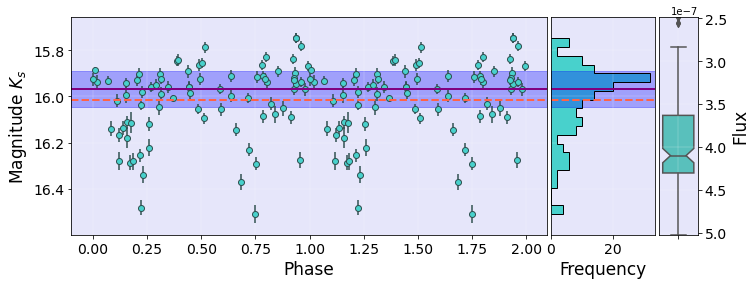

id_vvv 515882113541.0 Period_LS*2 0.72318054
0.72318054 515882113541.0


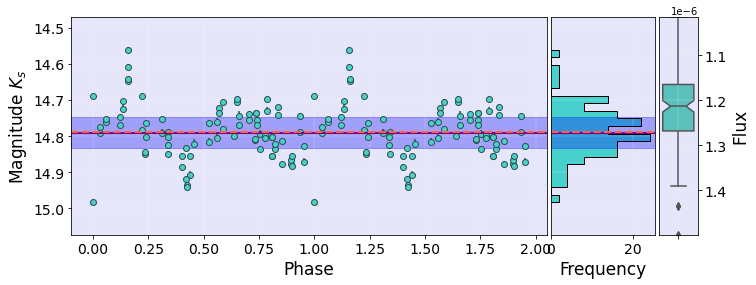

id_vvv 515882113968.0 Period_LS*2 0.93387718
0.93387718 515882113968.0


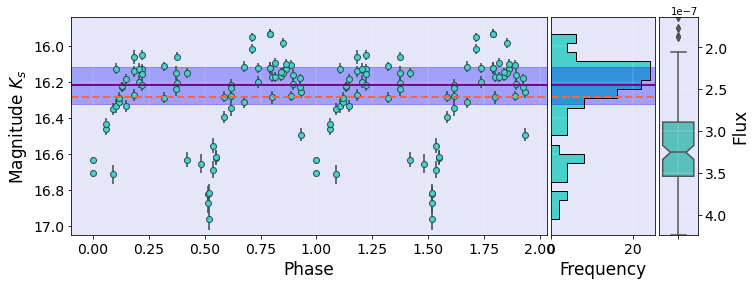

id_vvv 515882114557.0 Period_LS*2 1.7791952
1.7791952 515882114557.0


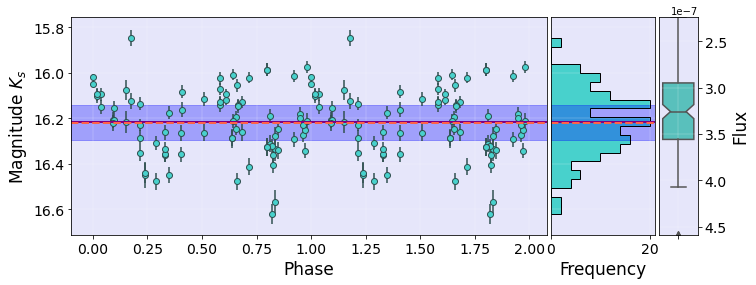

id_vvv 515882115572.0 Period_LS*2 0.59349316
0.59349316 515882115572.0


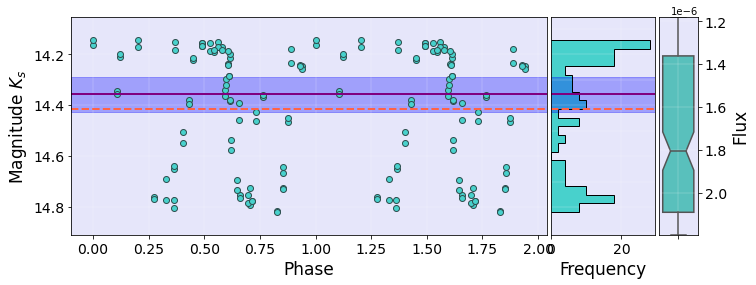

id_vvv 515882115760.0 Period_LS*2 2.50344
2.50344 515882115760.0


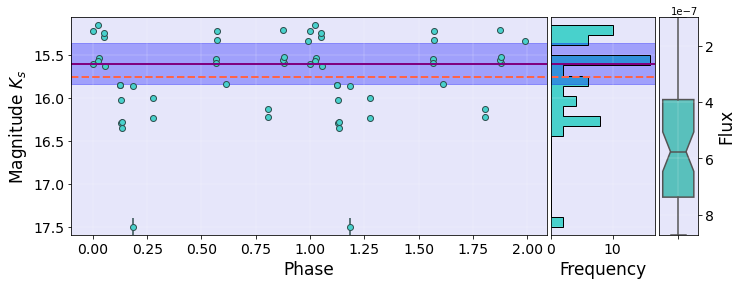

id_vvv 515882118088.0 Period_LS*2 1.7523793
1.7523793 515882118088.0


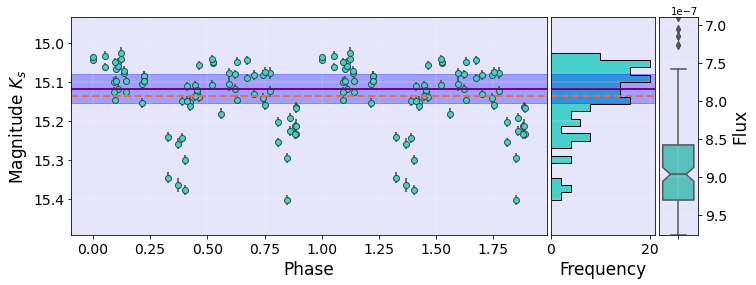

id_vvv 515882119524.0 Period_LS*2 0.69860124
0.69860124 515882119524.0


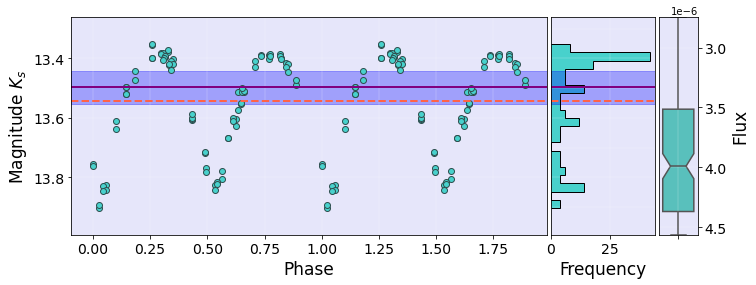

id_vvv 515882119573.0 Period_LS*2 1.60458672
1.60458672 515882119573.0


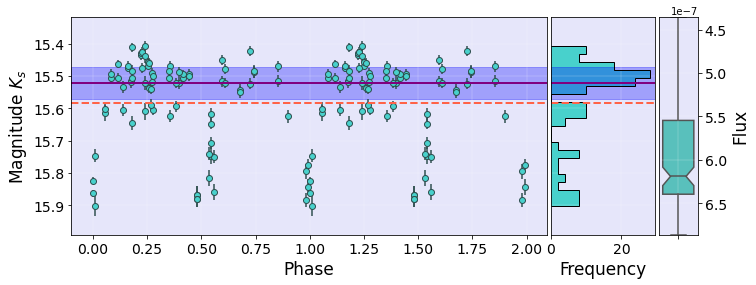

id_vvv 515882120987.0 Period_LS*2 0.68091356
0.68091356 515882120987.0


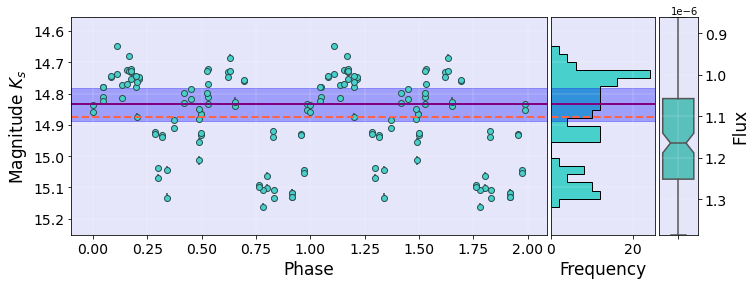

id_vvv 515882122585.0 Period_LS*2 6.1177268
6.1177268 515882122585.0


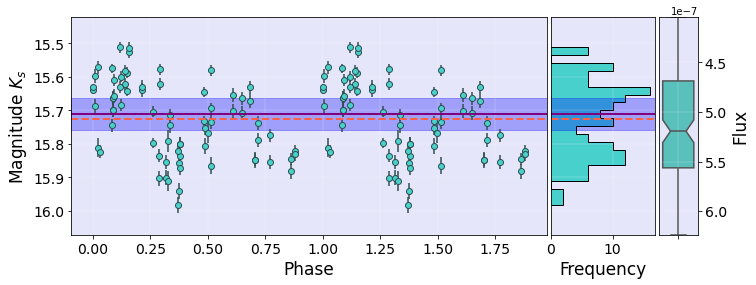

id_vvv 515882126236.0 Period_LS*2 1.41311192
1.41311192 515882126236.0


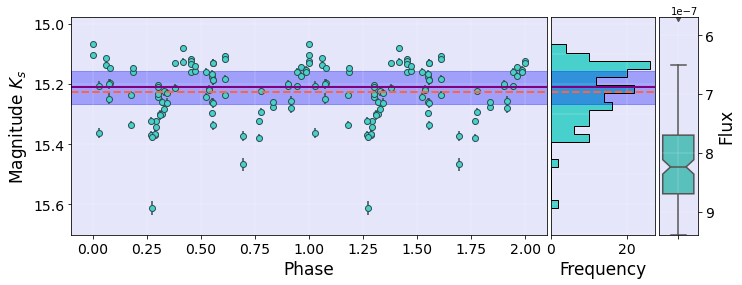

id_vvv 515882126613.0 Period_LS*2 0.7556046
0.7556046 515882126613.0


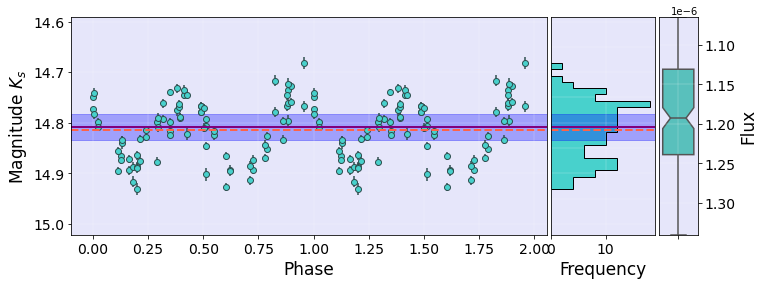

id_vvv 515882128446.0 Period_LS*2 0.5935544
0.5935544 515882128446.0


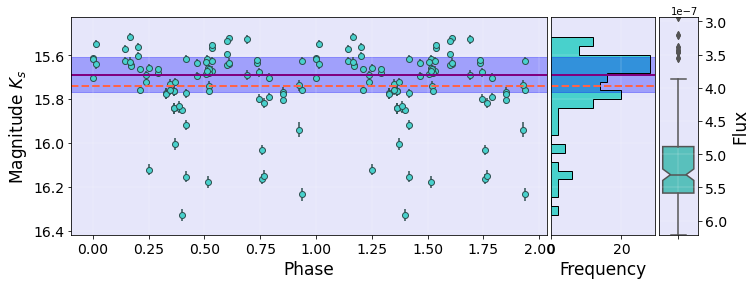

id_vvv 515882129265.0 Period_LS*2 0.5629571
0.5629571 515882129265.0


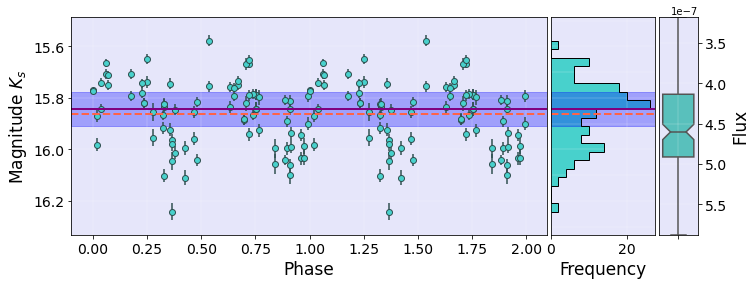

id_vvv 515882130713.0 Period_LS*2 56.01218
56.01218 515882130713.0


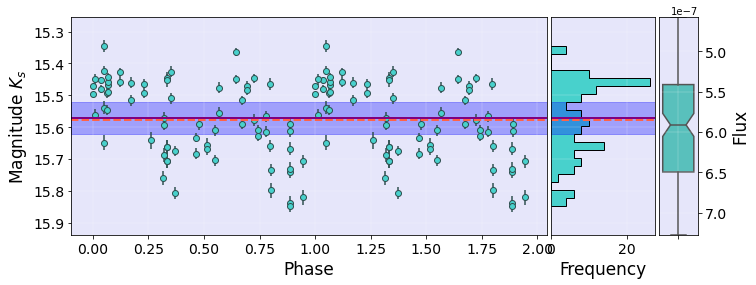

id_vvv 515882133400.0 Period_LS*2 1.60727548
1.60727548 515882133400.0


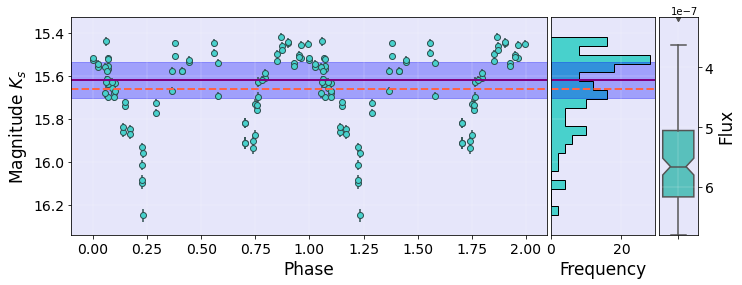

id_vvv 515882133934.0 Period_LS*2 1.5600058
1.5600058 515882133934.0


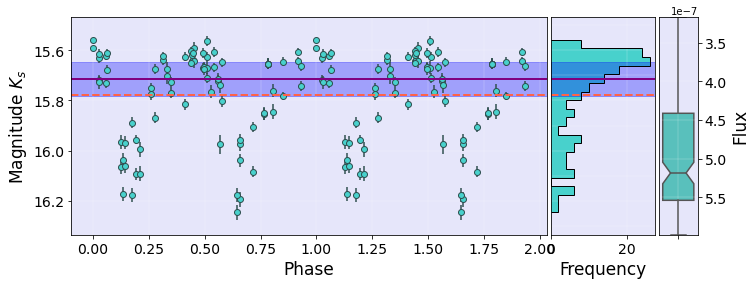

id_vvv 515882134851.0 Period_LS*2 1.46977
1.46977 515882134851.0


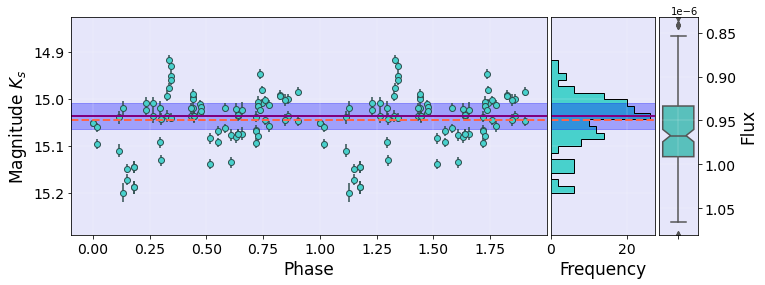

id_vvv 515882135995.0 Period_LS*2 0.7784994
0.7784994 515882135995.0


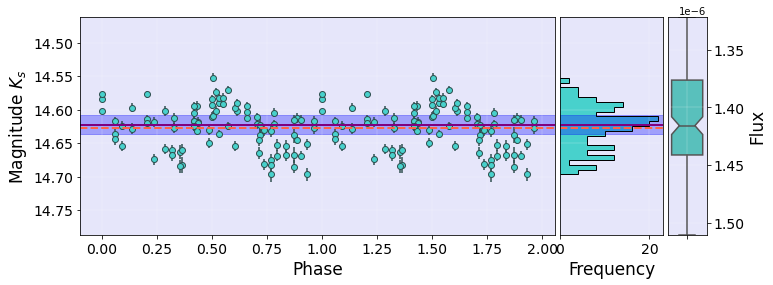

id_vvv 515882136045.0 Period_LS*2 0.6932159
0.6932159 515882136045.0


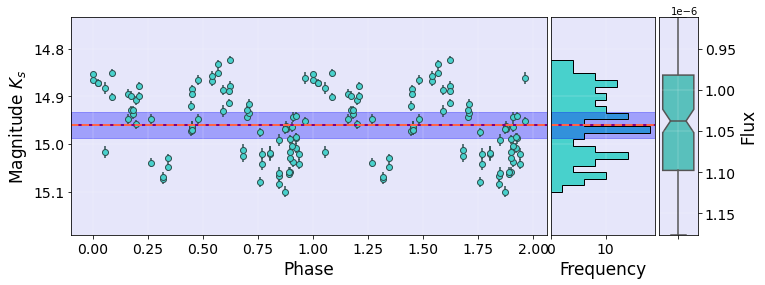

id_vvv 515882137945.0 Period_LS*2 3.8814712
3.8814712 515882137945.0


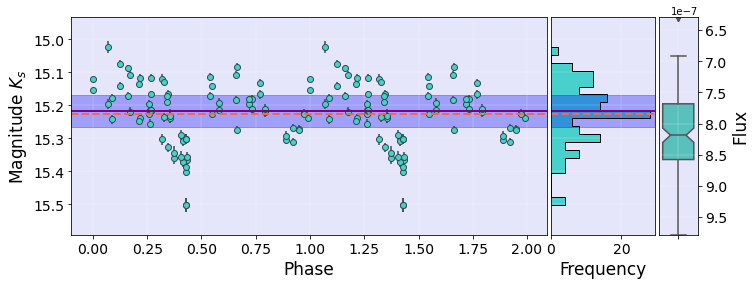

id_vvv 515882139519.0 Period_LS*2 1.08635772
1.08635772 515882139519.0


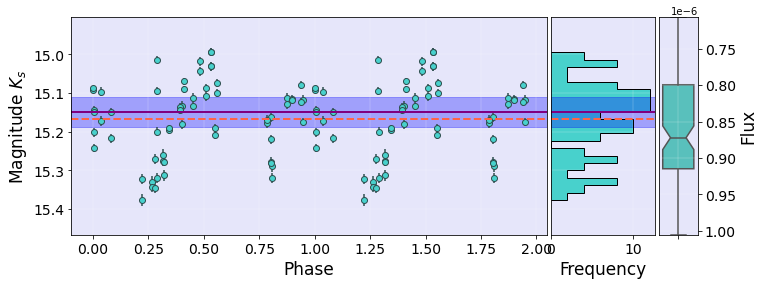

id_vvv 515882141396.0 Period_LS*2 1.3385084
1.3385084 515882141396.0


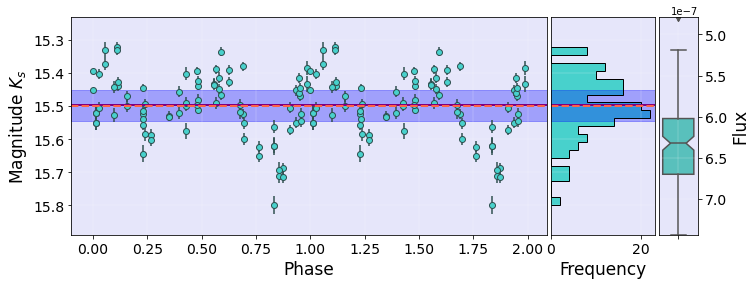

id_vvv 515882142175.0 Period_LS*2 0.66203684
0.66203684 515882142175.0


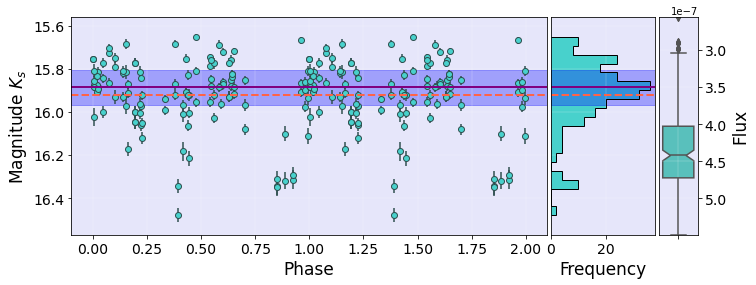

id_vvv 515882143082.0 Period_LS*2 73.08256
73.08256 515882143082.0


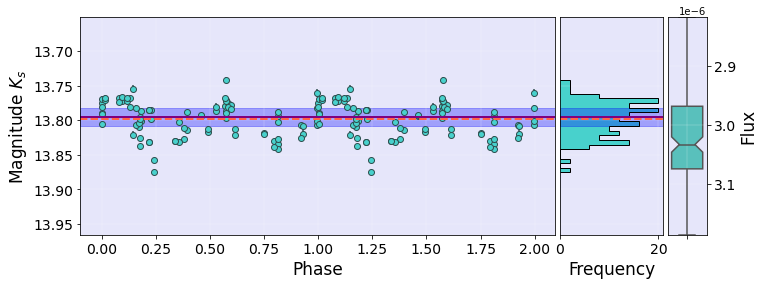

id_vvv 515882143274.0 Period_LS*2 1.1565438
1.1565438 515882143274.0


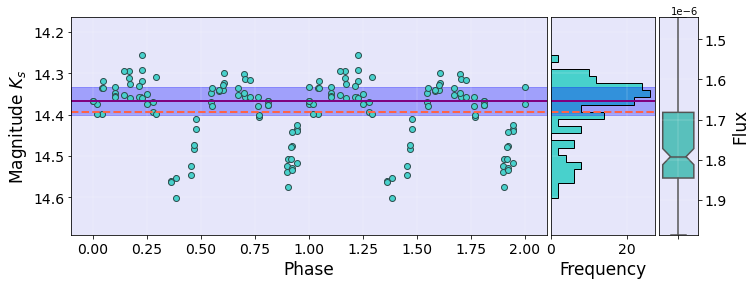

id_vvv 515882146106.0 Period_LS*2 0.61627644
0.61627644 515882146106.0


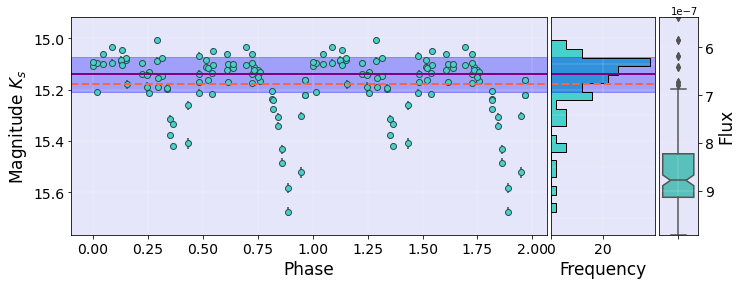

id_vvv 515882147172.0 Period_LS*2 0.9356231
0.9356231 515882147172.0


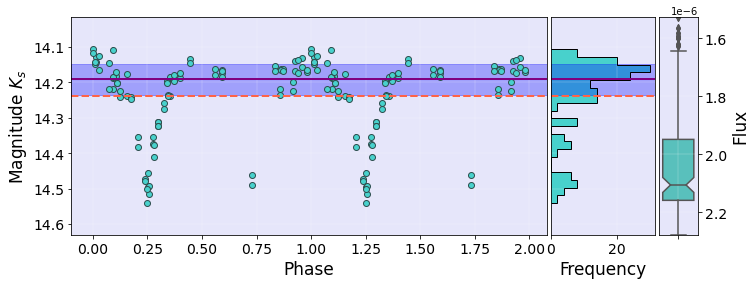

id_vvv 515882151383.0 Period_LS*2 2.0338376
2.0338376 515882151383.0


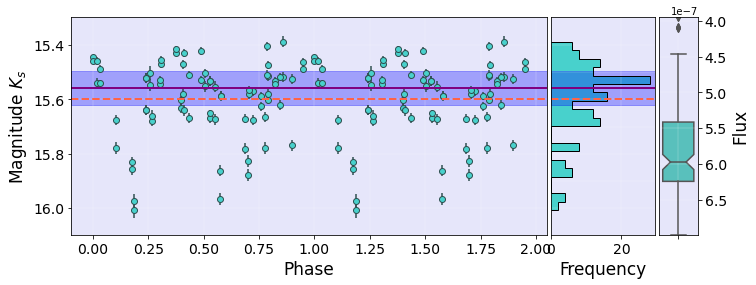

id_vvv 515882152291.0 Period_LS*2 0.6913838
0.6913838 515882152291.0


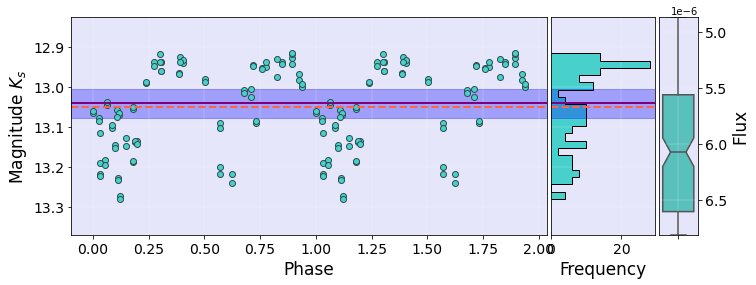

id_vvv 515882153112.0 Period_LS*2 22.725574
22.725574 515882153112.0


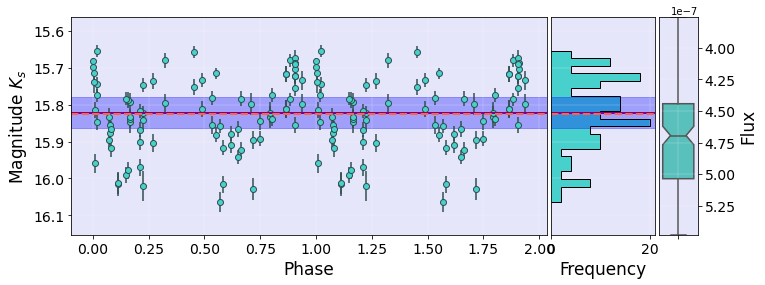

id_vvv 515882153919.0 Period_LS*2 3.297666
3.297666 515882153919.0


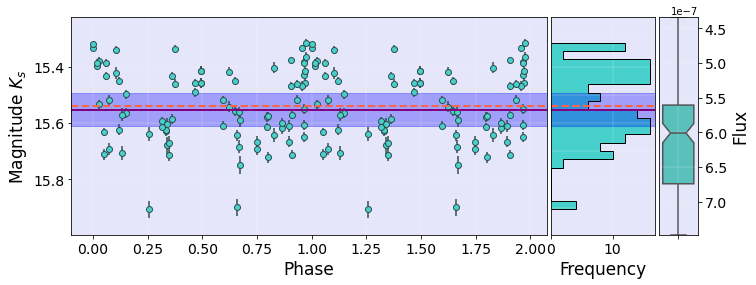

id_vvv 515882158866.0 Period_LS*2 2.744844
2.744844 515882158866.0


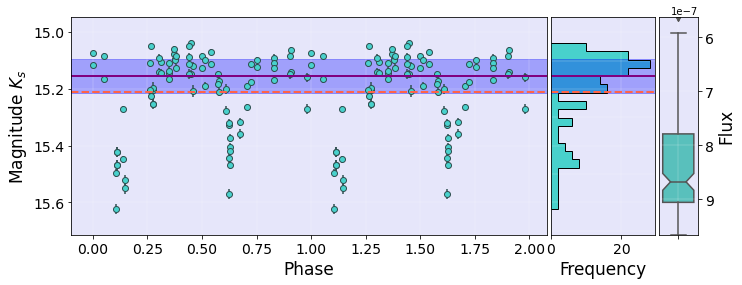

id_vvv 515882159079.0 Period_LS*2 365.41278
365.41278 515882159079.0


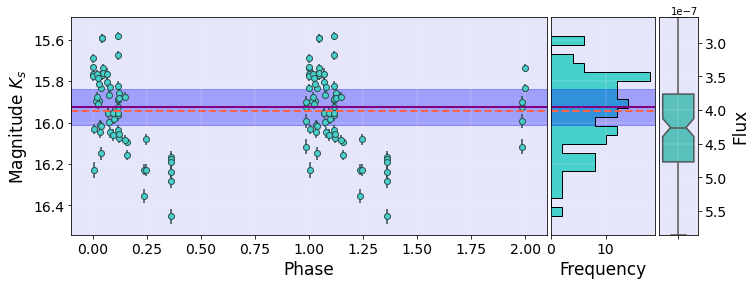

id_vvv 515882159621.0 Period_LS*2 2.2137712
2.2137712 515882159621.0


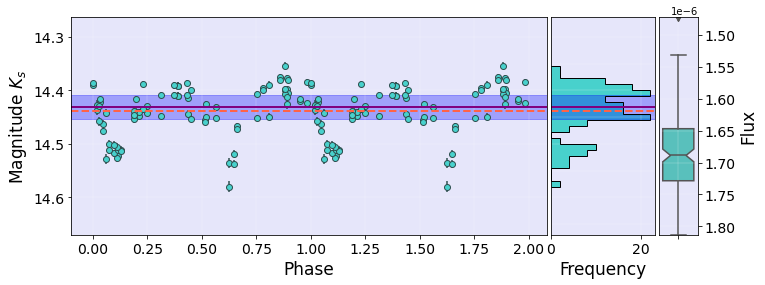

id_vvv 515882160024.0 Period_LS*2 0.7020526
0.7020526 515882160024.0


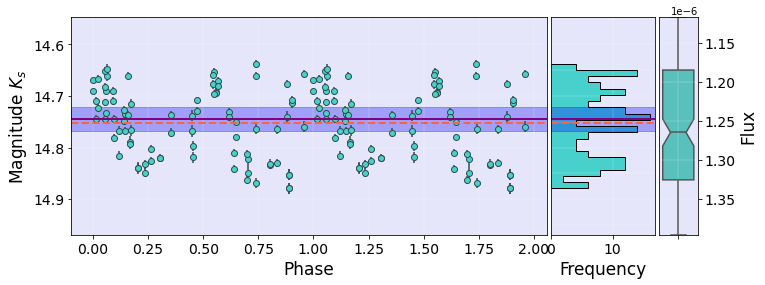

id_vvv 515882161423.0 Period_LS*2 1.060827
1.060827 515882161423.0


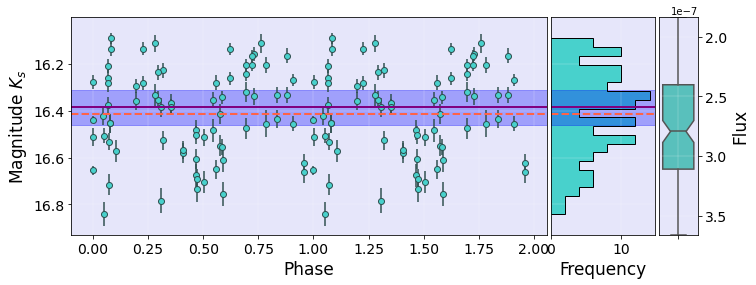

id_vvv 515882163249.0 Period_LS*2 0.666252
0.666252 515882163249.0


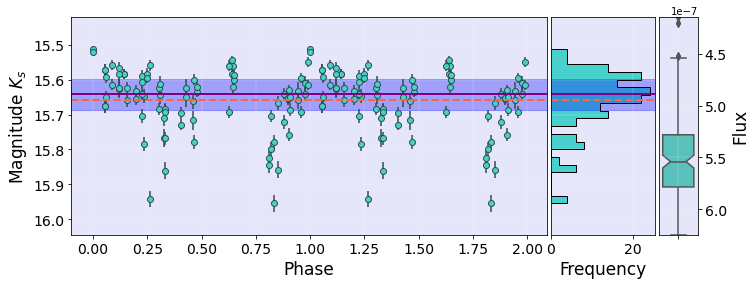

id_vvv 515882170929.0 Period_LS*2 0.63878036
0.63878036 515882170929.0


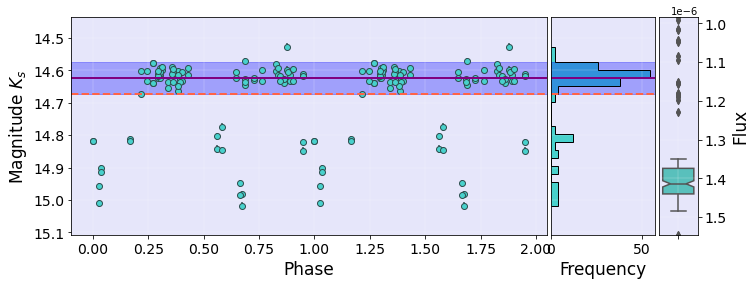

id_vvv 515882171172.0 Period_LS*2 12.6977416
12.6977416 515882171172.0


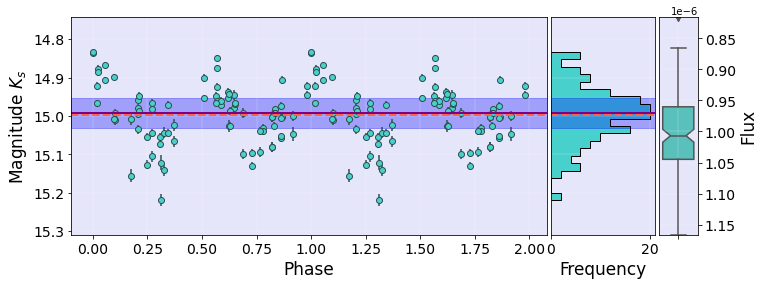

id_vvv 515882171933.0 Period_LS*2 0.59558136
0.59558136 515882171933.0


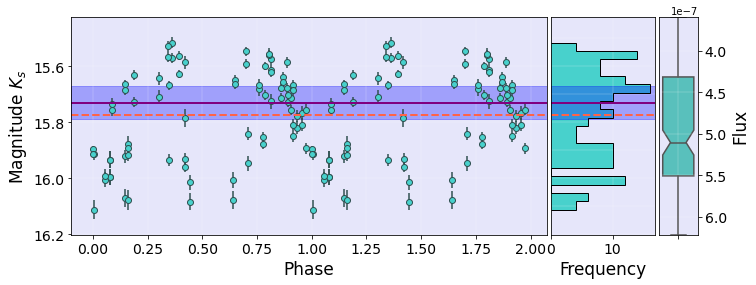

id_vvv 515882173039.0 Period_LS*2 0.92050886
0.92050886 515882173039.0


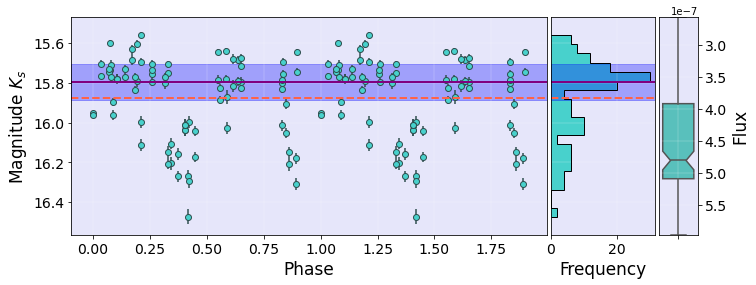

id_vvv 515882173250.0 Period_LS*2 29.40103
29.40103 515882173250.0


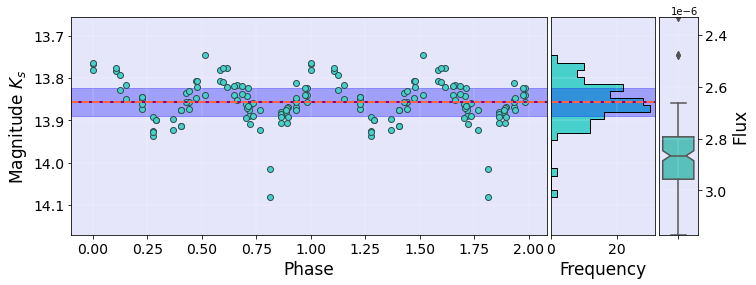

id_vvv 515882173306.0 Period_LS*2 1.2479539
1.2479539 515882173306.0


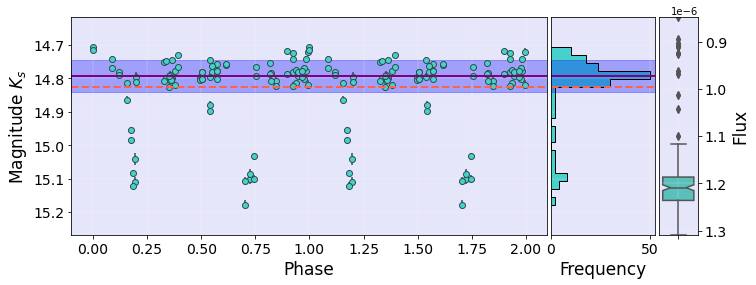

id_vvv 515882175440.0 Period_LS*2 0.49451176
0.49451176 515882175440.0


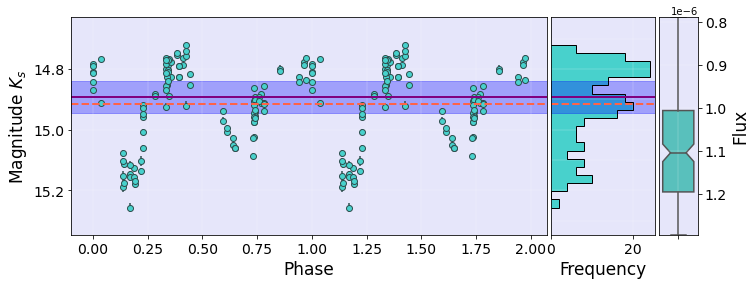

id_vvv 515882176358.0 Period_LS*2 1.09233714
1.09233714 515882176358.0


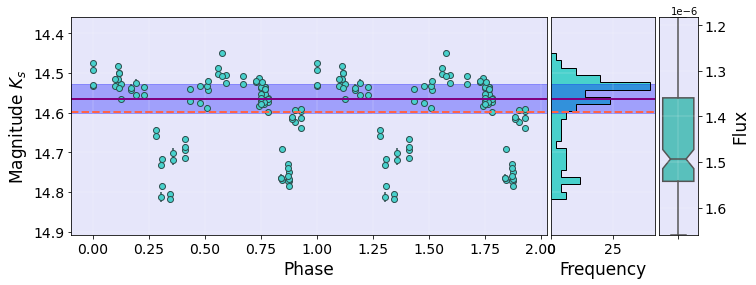

id_vvv 515882177081.0 Period_LS*2 1.0298844
1.0298844 515882177081.0


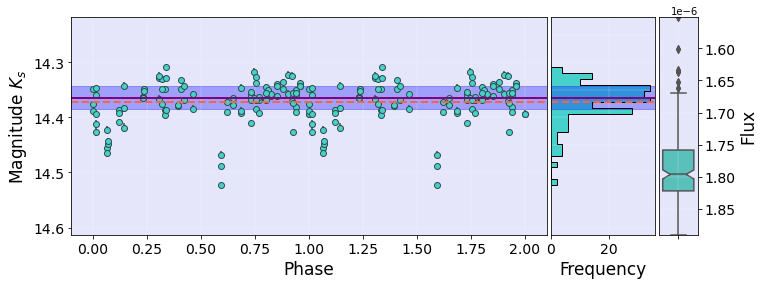

id_vvv 515882177465.0 Period_LS*2 0.34080454
0.34080454 515882177465.0


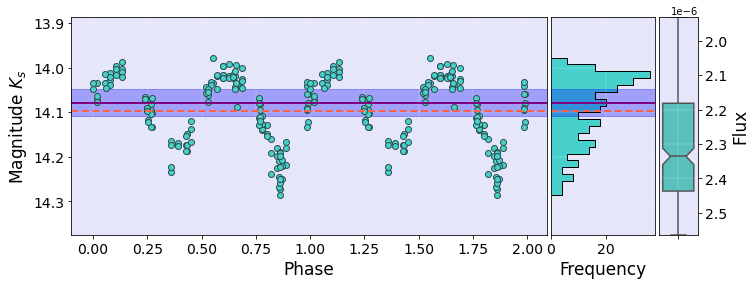

id_vvv 515882178264.0 Period_LS*2 0.61767734
0.61767734 515882178264.0


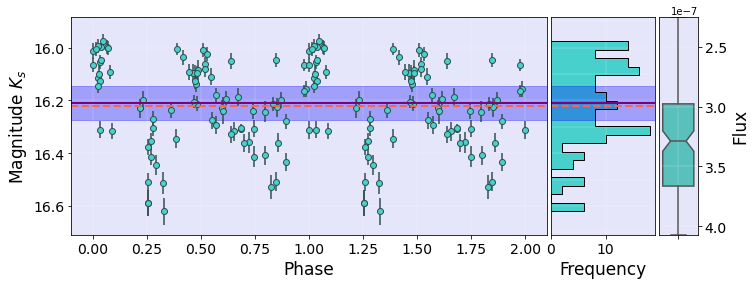

id_vvv 515882178459.0 Period_LS*2 0.96722854
0.96722854 515882178459.0


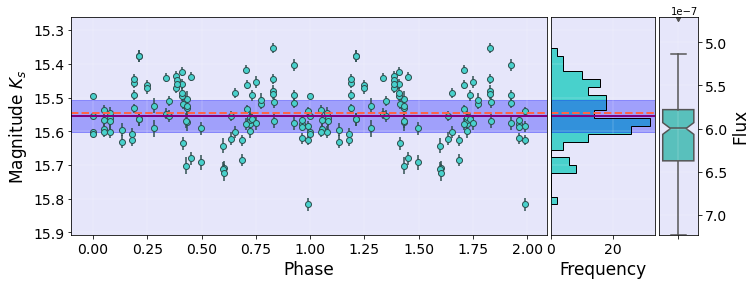

id_vvv 515882179082.0 Period_LS*2 0.39428308
0.39428308 515882179082.0


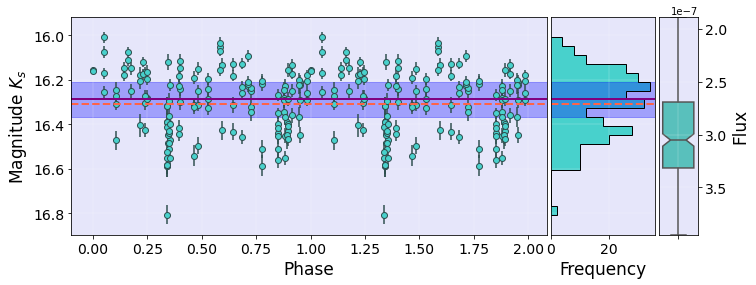

id_vvv 515882179161.0 Period_LS*2 0.9175737
0.9175737 515882179161.0


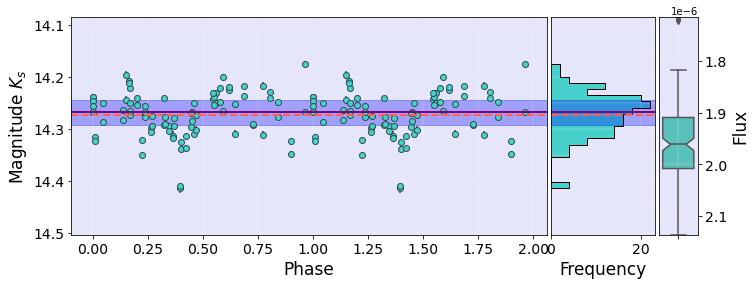

id_vvv 515882181505.0 Period_LS*2 1.11562908
1.11562908 515882181505.0


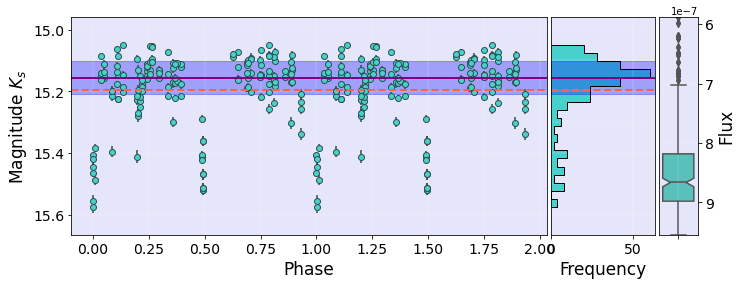

id_vvv 515882182259.0 Period_LS*2 0.75392192
0.75392192 515882182259.0


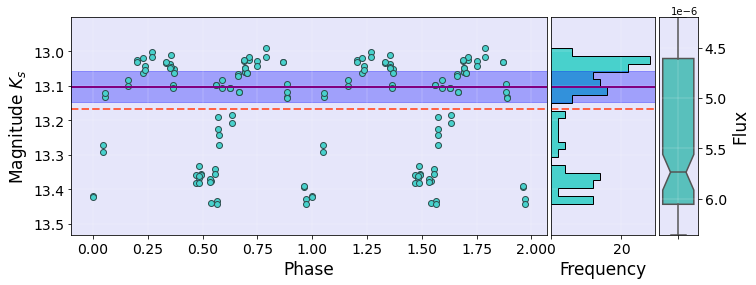

id_vvv 515882182672.0 Period_LS*2 0.5857315
0.5857315 515882182672.0


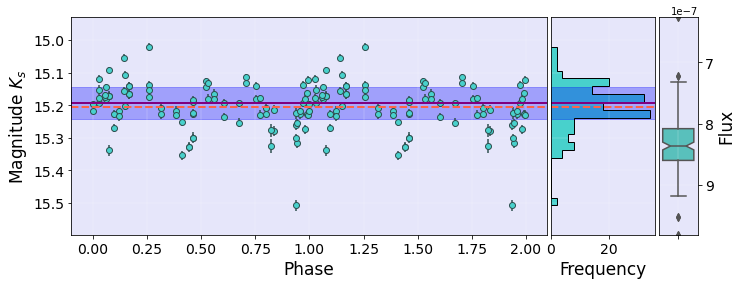

id_vvv 515882183409.0 Period_LS*2 1.0220202
1.0220202 515882183409.0


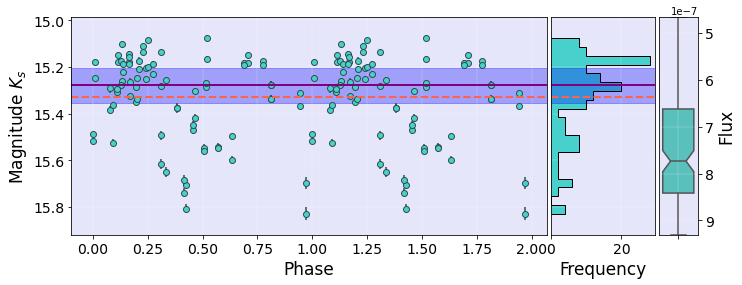

id_vvv 515882185196.0 Period_LS*2 1.1869226
1.1869226 515882185196.0


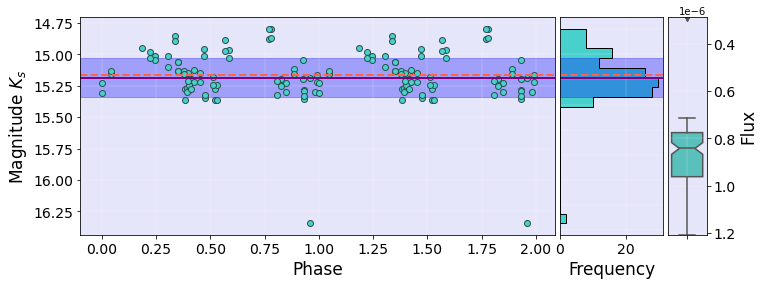

id_vvv 515882185779.0 Period_LS*2 1.1888176
1.1888176 515882185779.0


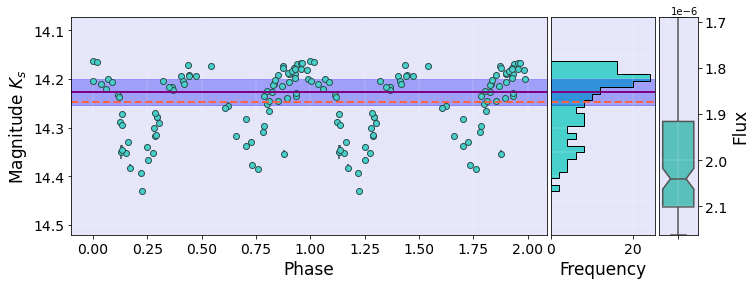

id_vvv 515882187098.0 Period_LS*2 2.023864
2.023864 515882187098.0


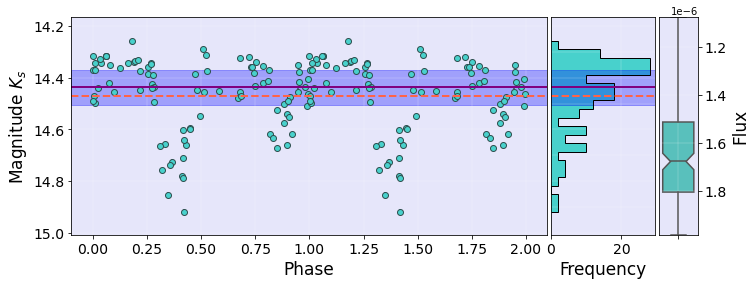

id_vvv 515882188136.0 Period_LS*2 1000.91334
1000.91334 515882188136.0


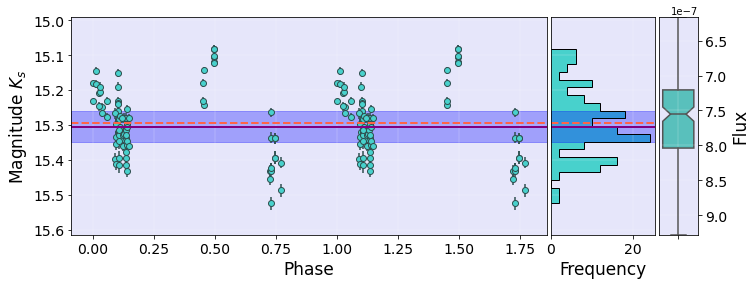

id_vvv 515882188879.0 Period_LS*2 0.7127026
0.7127026 515882188879.0


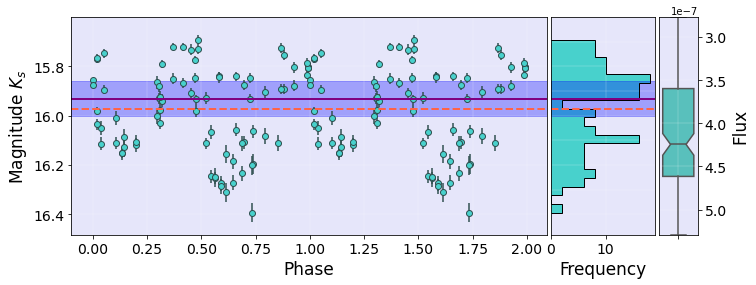

id_vvv 515882190054.0 Period_LS*2 1.7547836
1.7547836 515882190054.0


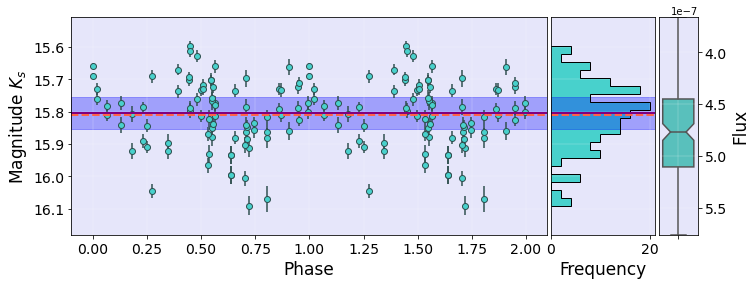

id_vvv 515882194975.0 Period_LS*2 2.4296576
2.4296576 515882194975.0


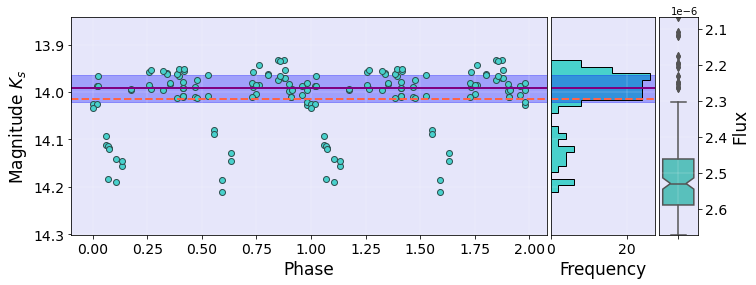

id_vvv 515882198116.0 Period_LS*2 0.57305784
0.57305784 515882198116.0


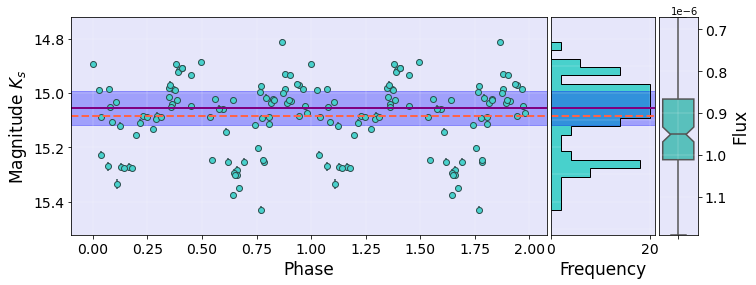

id_vvv 515882199237.0 Period_LS*2 258.663
258.663 515882199237.0


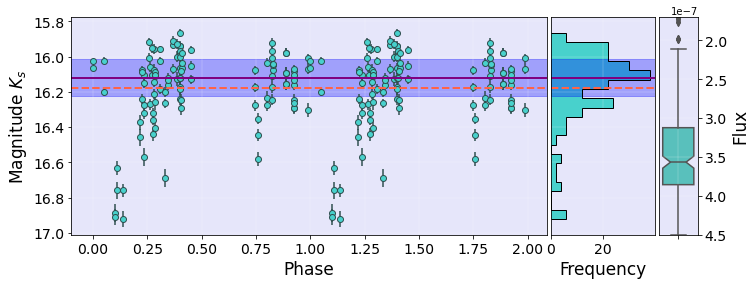

id_vvv 515882199507.0 Period_LS*2 0.75141192
0.75141192 515882199507.0


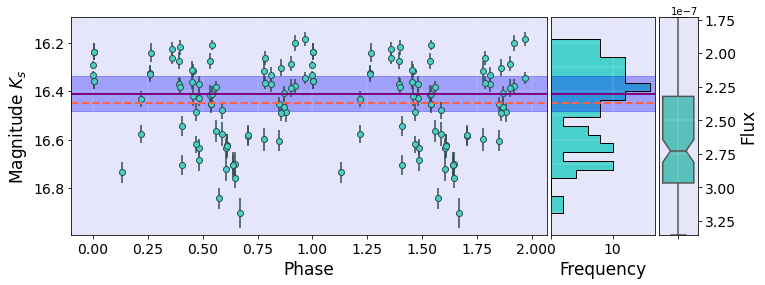

id_vvv 515882200284.0 Period_LS*2 0.9252312
0.9252312 515882200284.0


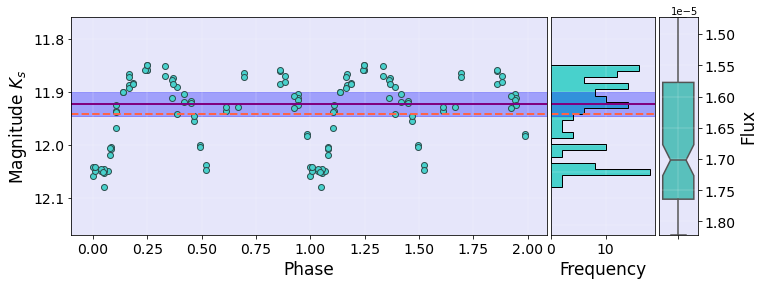

id_vvv 515882201815.0 Period_LS*2 0.55565768
0.55565768 515882201815.0


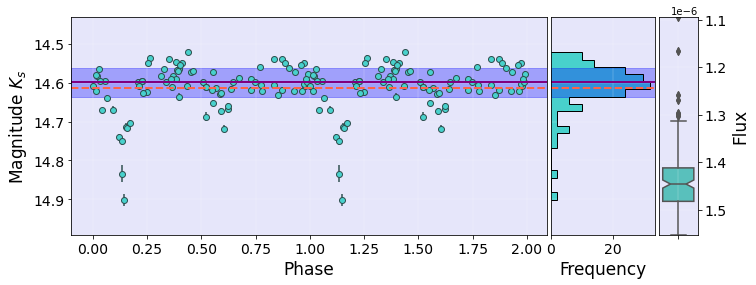

id_vvv 515882202245.0 Period_LS*2 0.70480376
0.70480376 515882202245.0


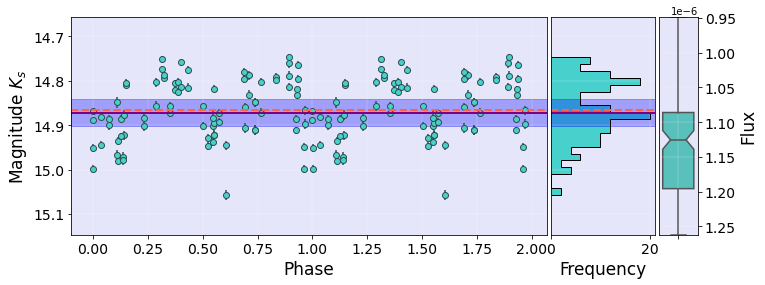

id_vvv 515882203307.0 Period_LS*2 0.65231944
0.65231944 515882203307.0


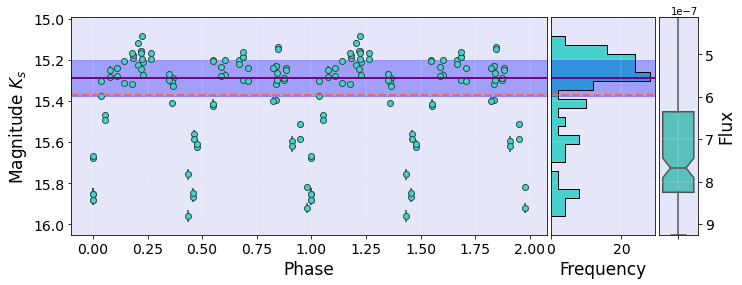

id_vvv 515882203836.0 Period_LS*2 1.2035868
1.2035868 515882203836.0


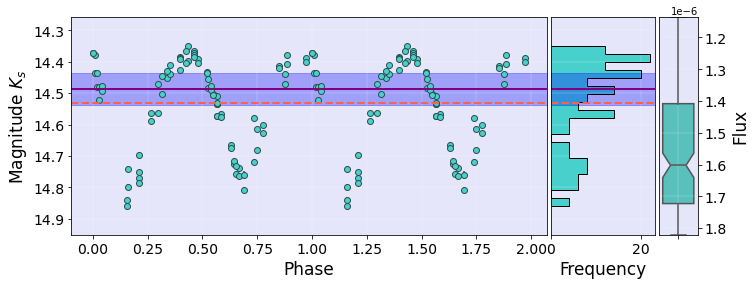

id_vvv 515882204773.0 Period_LS*2 697.60626
697.60626 515882204773.0


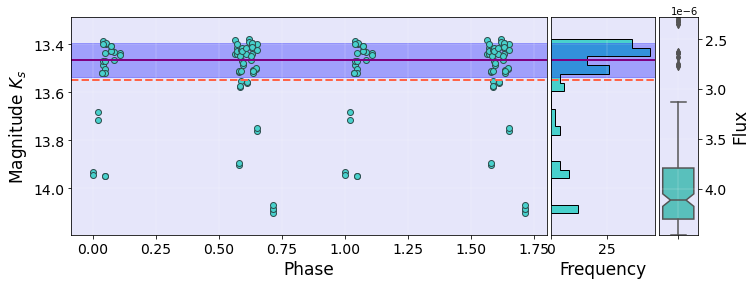

id_vvv 515882206523.0 Period_LS*2 4.332958
4.332958 515882206523.0


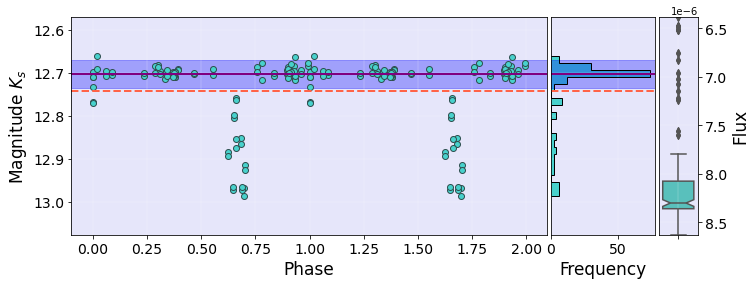

id_vvv 515882207071.0 Period_LS*2 1.9005206
1.9005206 515882207071.0


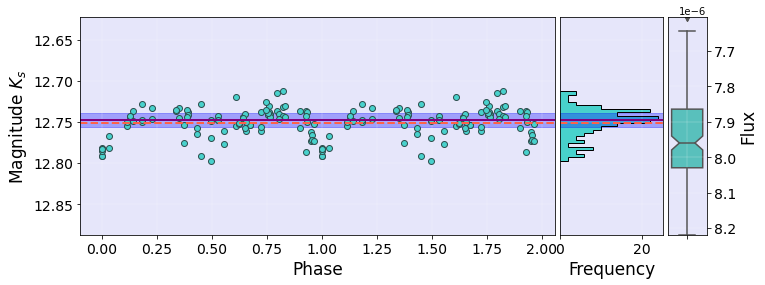

id_vvv 515882207778.0 Period_LS*2 0.64450312
0.64450312 515882207778.0


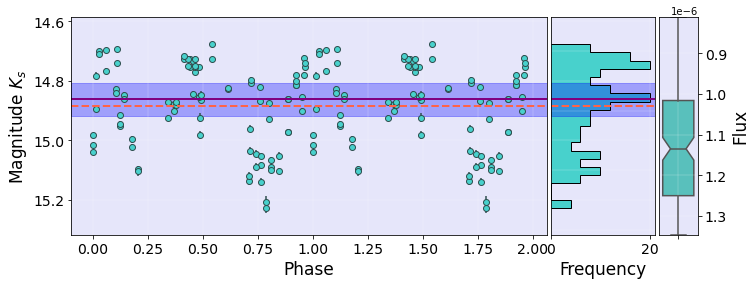

id_vvv 515882210038.0 Period_LS*2 4.6781154
4.6781154 515882210038.0


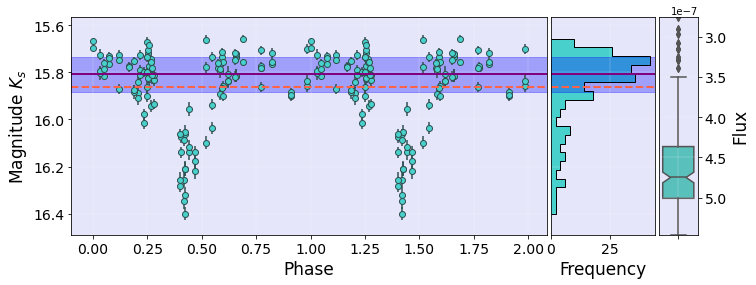

id_vvv 515882211670.0 Period_LS*2 0.81724614
0.81724614 515882211670.0


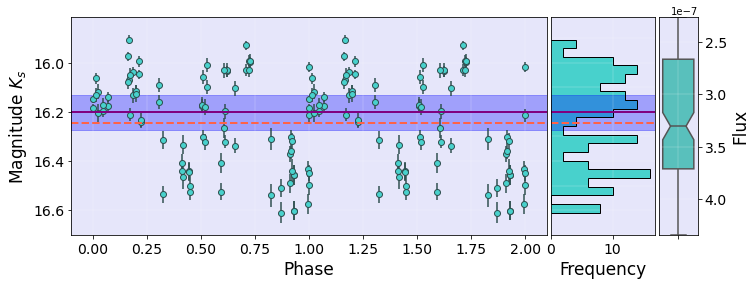

id_vvv 515882213753.0 Period_LS*2 0.7485776
0.7485776 515882213753.0


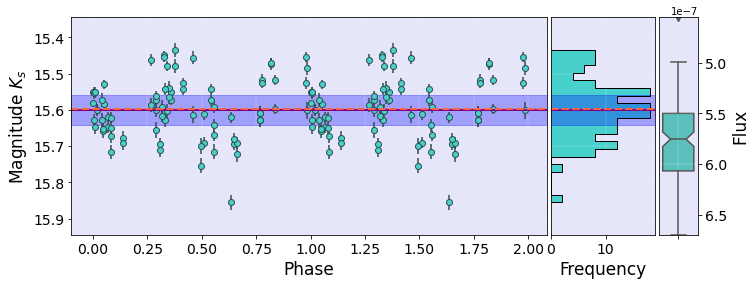

id_vvv 515882215372.0 Period_LS*2 1.0200278
1.0200278 515882215372.0


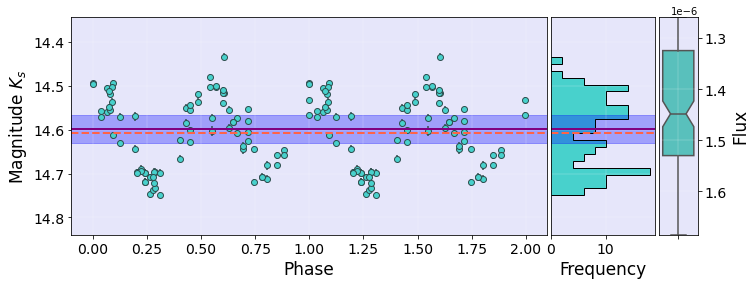

id_vvv 515882215582.0 Period_LS*2 0.7530834
0.7530834 515882215582.0


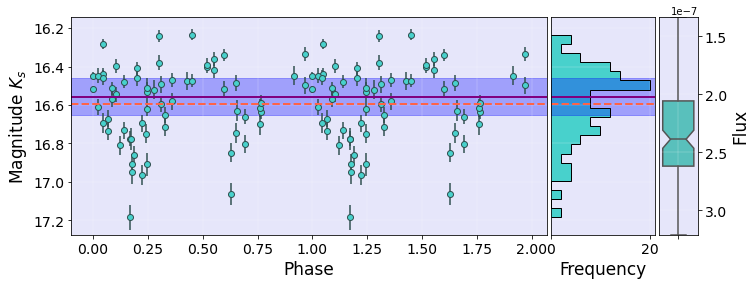

id_vvv 515882215892.0 Period_LS*2 1.0284946
1.0284946 515882215892.0


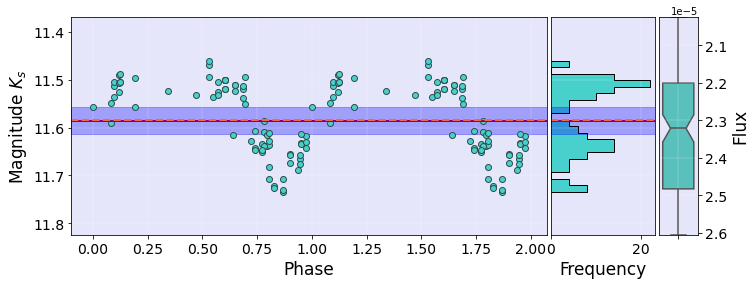

id_vvv 515882220880.0 Period_LS*2 1.524671
1.524671 515882220880.0


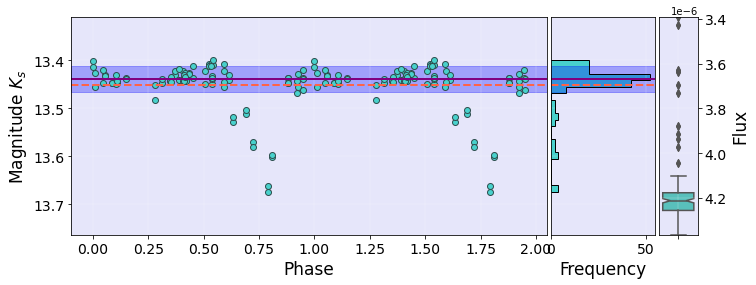

id_vvv 515882221197.0 Period_LS*2 1.00322508
1.00322508 515882221197.0


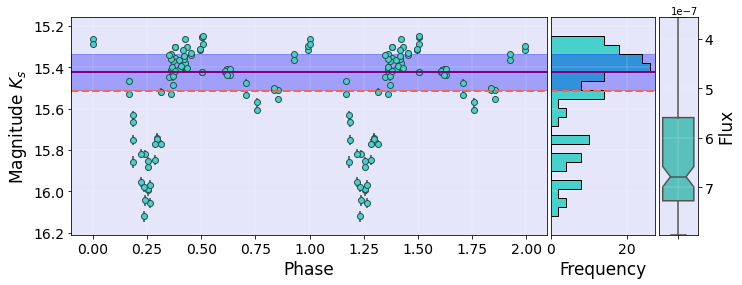

id_vvv 515882222417.0 Period_LS*2 37.925876
37.925876 515882222417.0


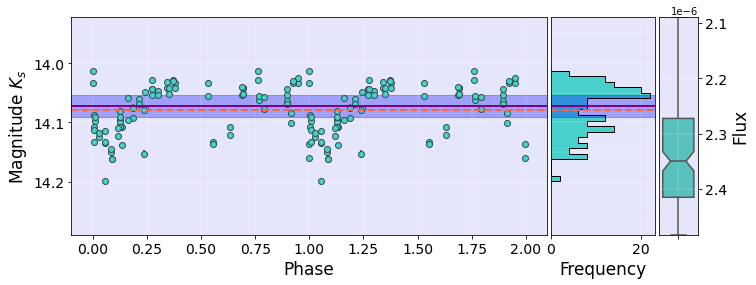

id_vvv 515882222869.0 Period_LS*2 0.6803903
0.6803903 515882222869.0


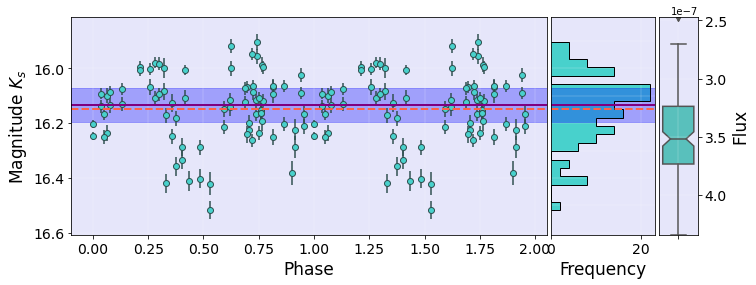

id_vvv 515882223012.0 Period_LS*2 1.6709822
1.6709822 515882223012.0


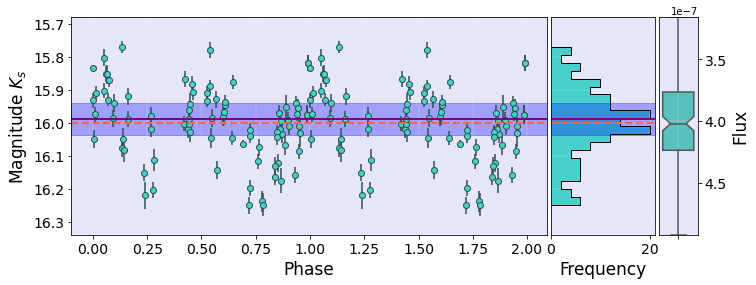

id_vvv 515882223456.0 Period_LS*2 1.70918452
1.70918452 515882223456.0


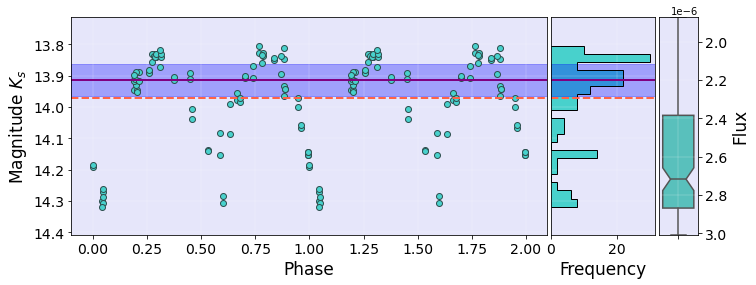

id_vvv 515882227307.0 Period_LS*2 0.68047076
0.68047076 515882227307.0


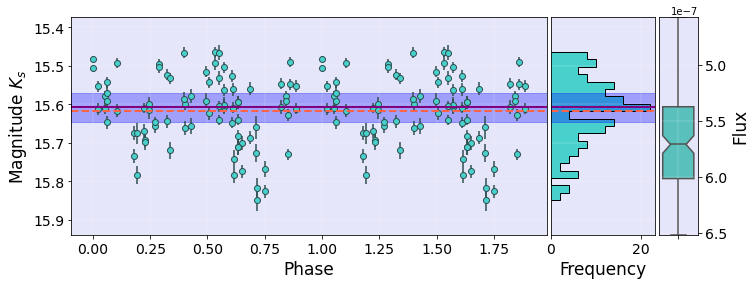

id_vvv 515882227564.0 Period_LS*2 0.65135968
0.65135968 515882227564.0


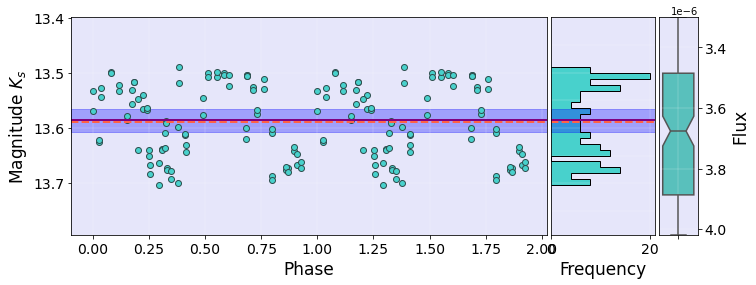

id_vvv 515882229337.0 Period_LS*2 1.218365
1.218365 515882229337.0


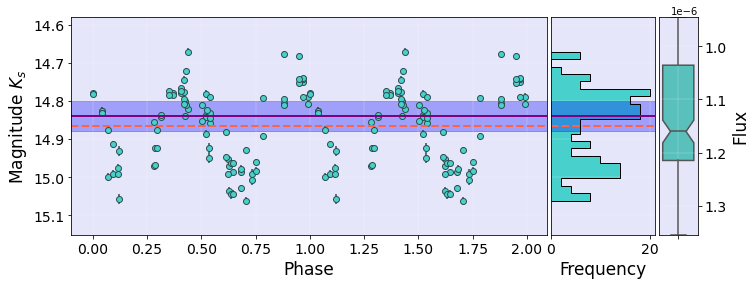

id_vvv 515882229379.0 Period_LS*2 0.59790164
0.59790164 515882229379.0


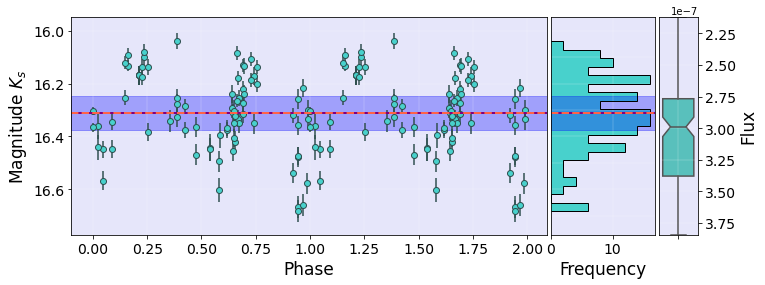

id_vvv 515882232374.0 Period_LS*2 5.3799968
5.3799968 515882232374.0


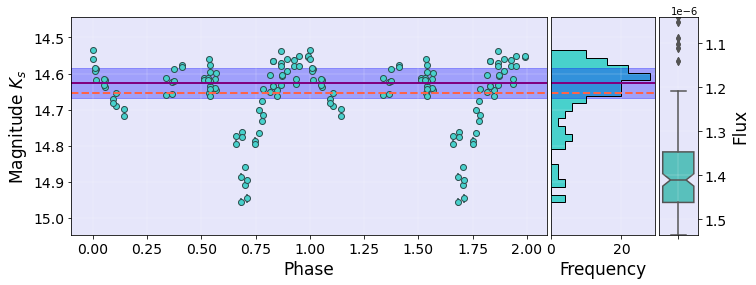

id_vvv 515882235401.0 Period_LS*2 0.94795168
0.94795168 515882235401.0


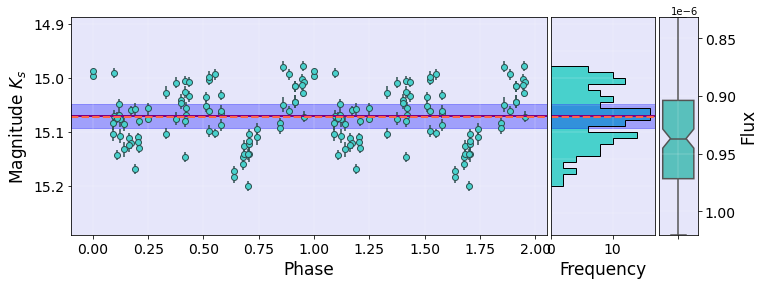

id_vvv 515882235462.0 Period_LS*2 5.728043
5.728043 515882235462.0


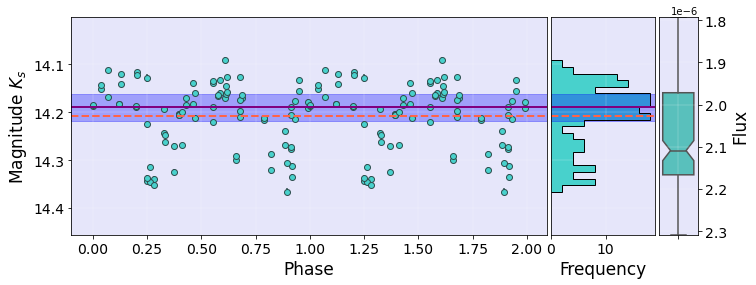

id_vvv 515882235951.0 Period_LS*2 1.2544824
1.2544824 515882235951.0


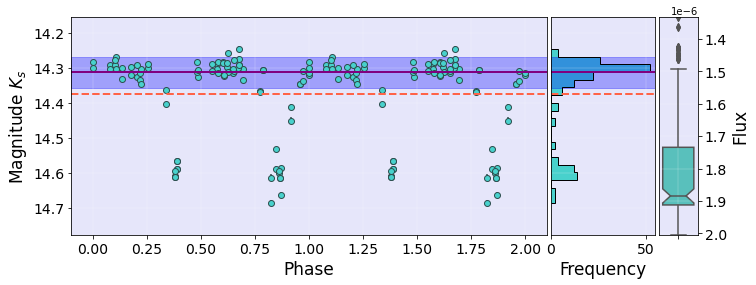

id_vvv 515882236842.0 Period_LS*2 0.57628876
0.57628876 515882236842.0


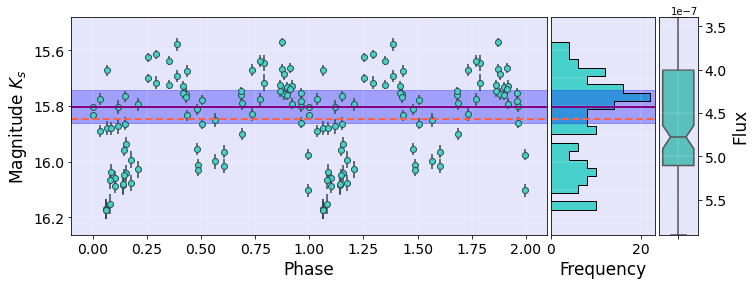

id_vvv 515882237688.0 Period_LS*2 0.54239816
0.54239816 515882237688.0


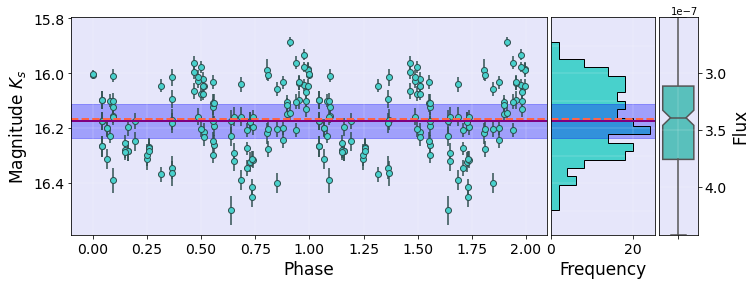

id_vvv 515882239612.0 Period_LS*2 0.7758756
0.7758756 515882239612.0


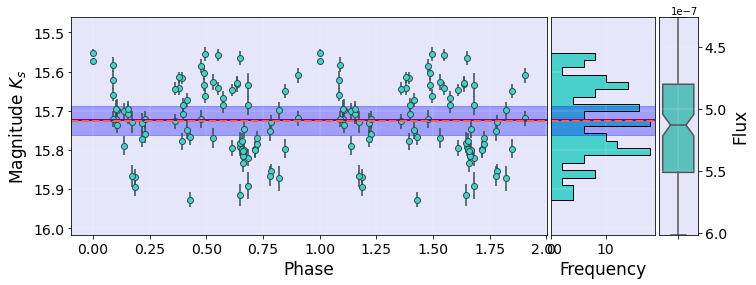

id_vvv 515882243681.0 Period_LS*2 1.8441886
1.8441886 515882243681.0


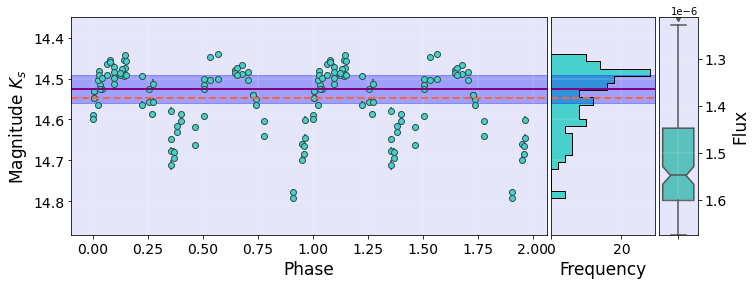

id_vvv 515882249580.0 Period_LS*2 2.1444812
2.1444812 515882249580.0


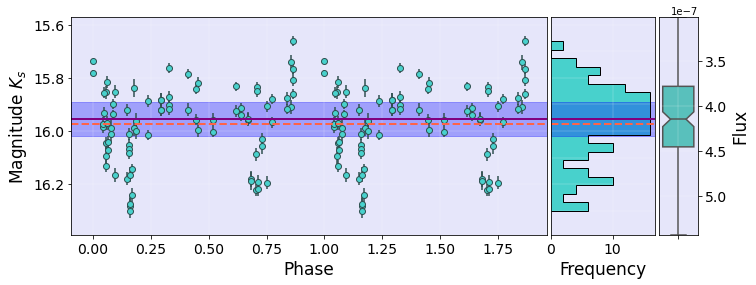

id_vvv 515882250749.0 Period_LS*2 1.057902
1.057902 515882250749.0


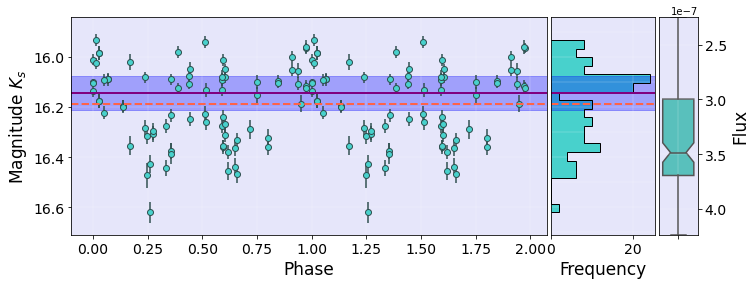

id_vvv 515882250963.0 Period_LS*2 0.6811956
0.6811956 515882250963.0


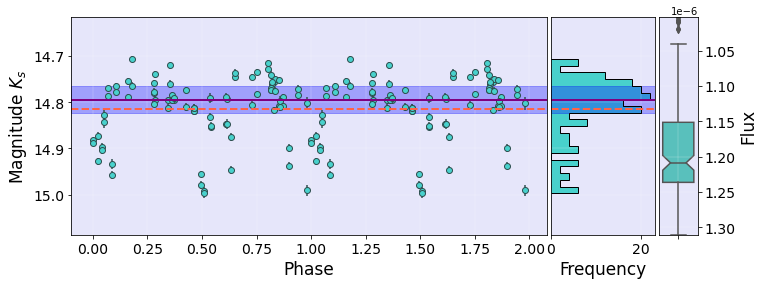

id_vvv 515882254367.0 Period_LS*2 0.7130558
0.7130558 515882254367.0


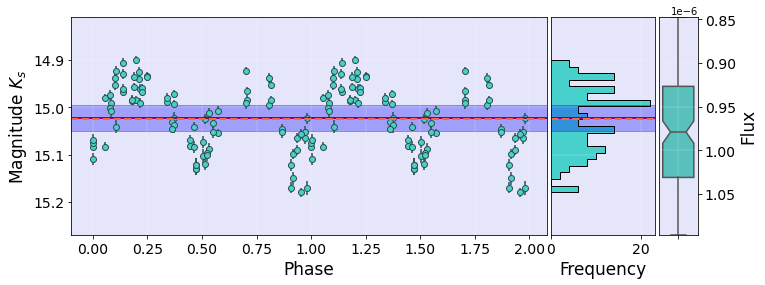

id_vvv 515882254386.0 Period_LS*2 1.3439784
1.3439784 515882254386.0


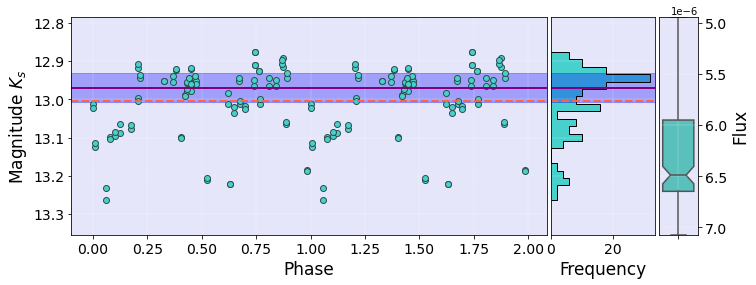

id_vvv 515882256251.0 Period_LS*2 0.62555384
0.62555384 515882256251.0


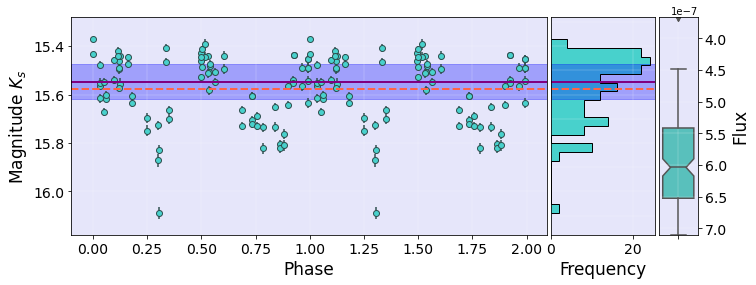

id_vvv 515882257904.0 Period_LS*2 0.50457
0.50457 515882257904.0


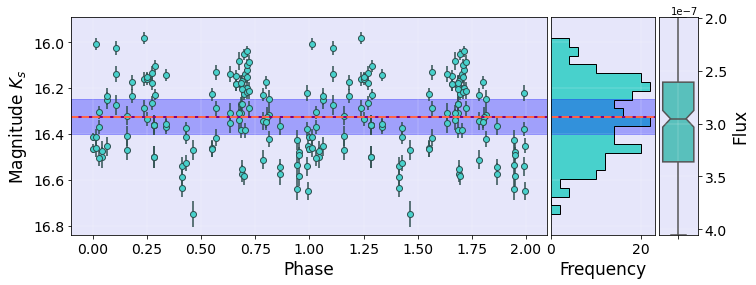

id_vvv 515882258656.0 Period_LS*2 1.01186788
1.01186788 515882258656.0


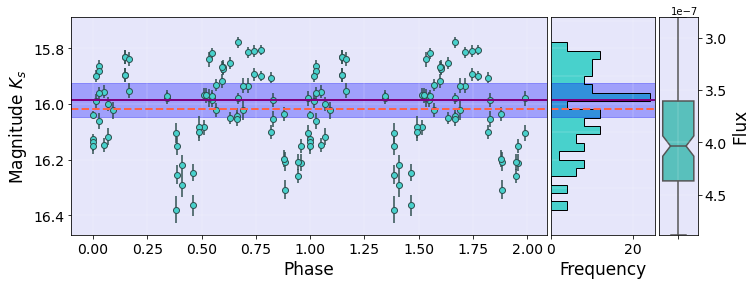

id_vvv 515882259135.0 Period_LS*2 4.2592054
4.2592054 515882259135.0


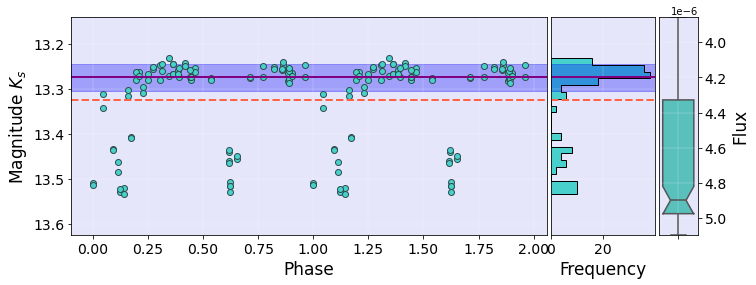

id_vvv 515882259754.0 Period_LS*2 0.44870884
0.44870884 515882259754.0


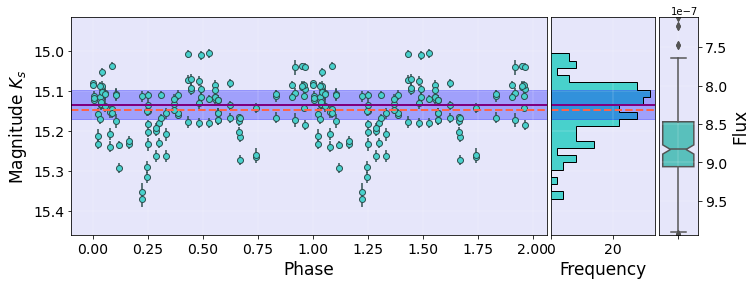

id_vvv 515882260804.0 Period_LS*2 0.787878
0.787878 515882260804.0


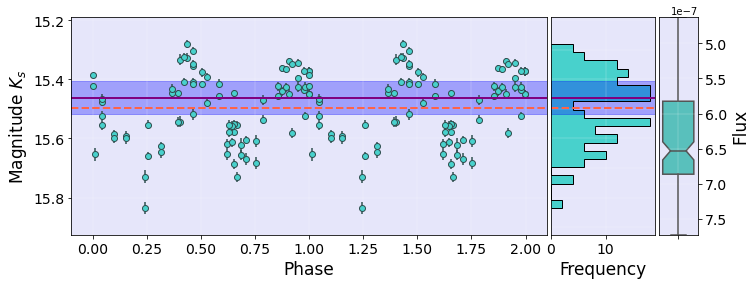

id_vvv 515882261200.0 Period_LS*2 3.5964704
3.5964704 515882261200.0


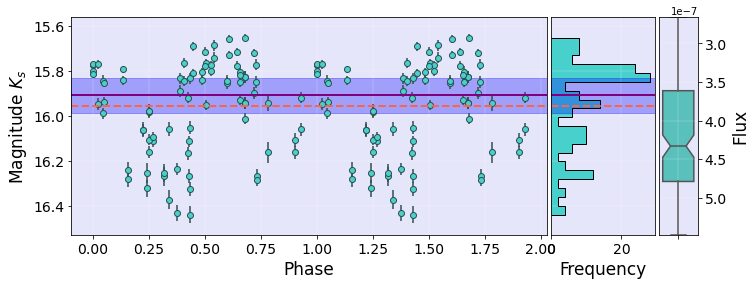

id_vvv 515882266654.0 Period_LS*2 1.958068
1.958068 515882266654.0


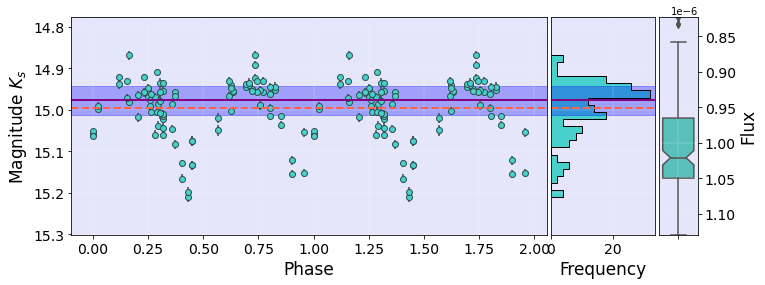

id_vvv 515882268032.0 Period_LS*2 2.0245366
2.0245366 515882268032.0


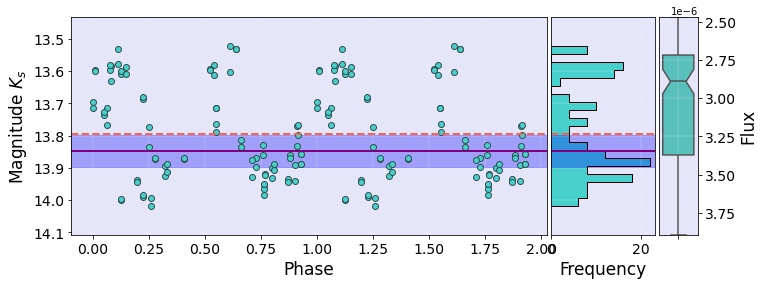

id_vvv 515882271409.0 Period_LS*2 0.5791594
0.5791594 515882271409.0


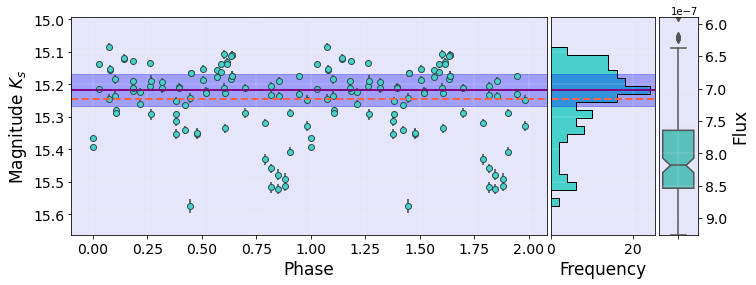

id_vvv 515882271965.0 Period_LS*2 2.4545266
2.4545266 515882271965.0


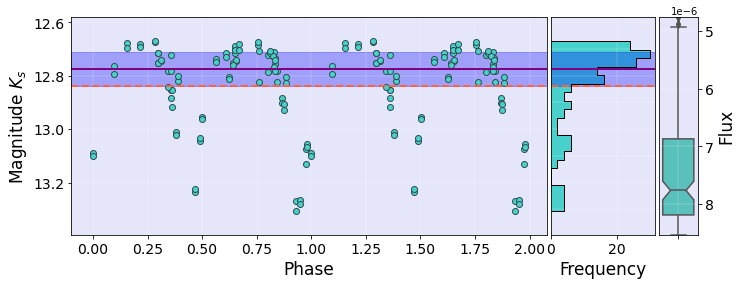

id_vvv 515882272530.0 Period_LS*2 1.10428392
1.10428392 515882272530.0


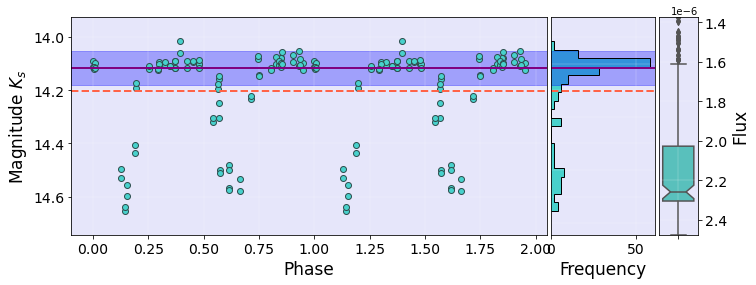

id_vvv 515882275718.0 Period_LS*2 0.87105096
0.87105096 515882275718.0


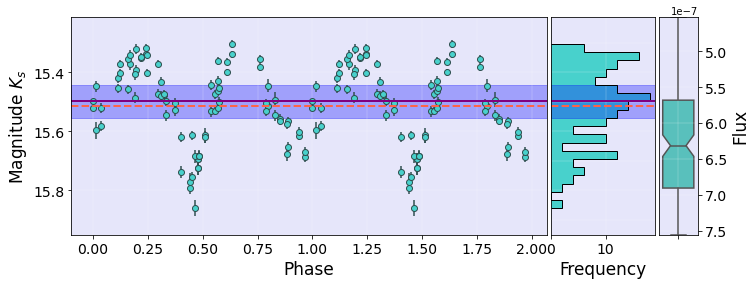

id_vvv 515882277445.0 Period_LS*2 0.9335742
0.9335742 515882277445.0


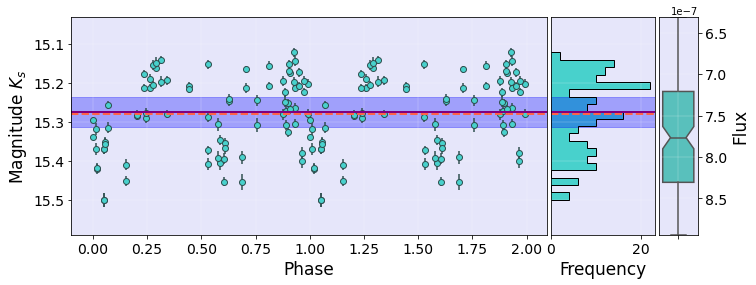

id_vvv 515882279901.0 Period_LS*2 0.40607866
0.40607866 515882279901.0


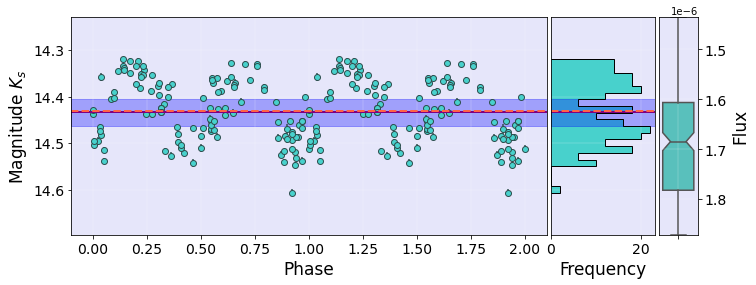

id_vvv 515882280317.0 Period_LS*2 0.6400947
0.6400947 515882280317.0


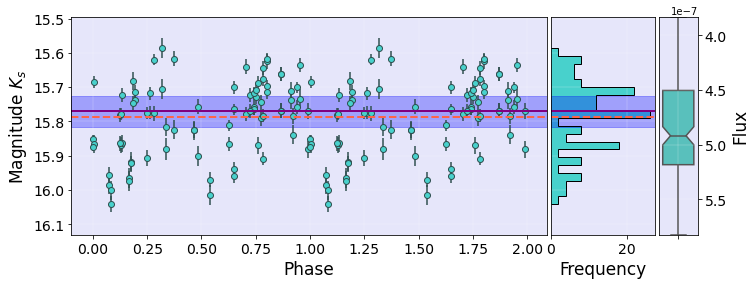

id_vvv 515882283605.0 Period_LS*2 0.9916436
0.9916436 515882283605.0


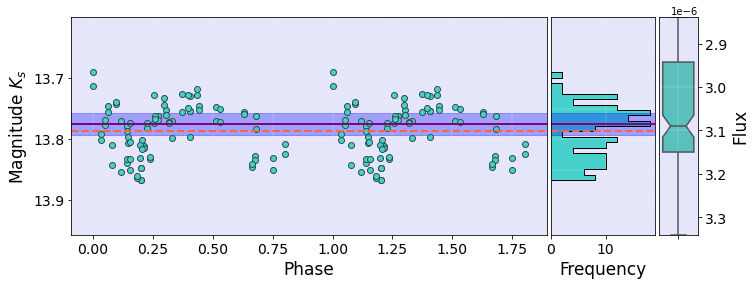

id_vvv 515882284313.0 Period_LS*2 0.6408431
0.6408431 515882284313.0


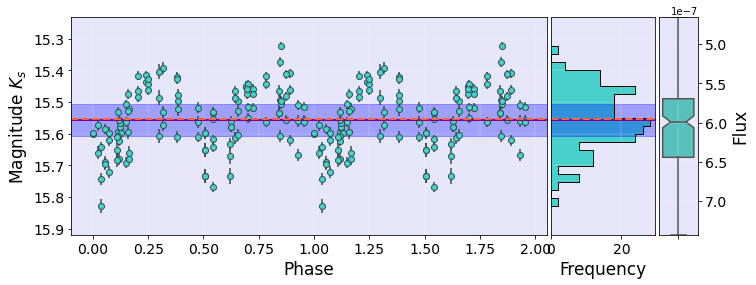

id_vvv 515882285352.0 Period_LS*2 1.1780874
1.1780874 515882285352.0


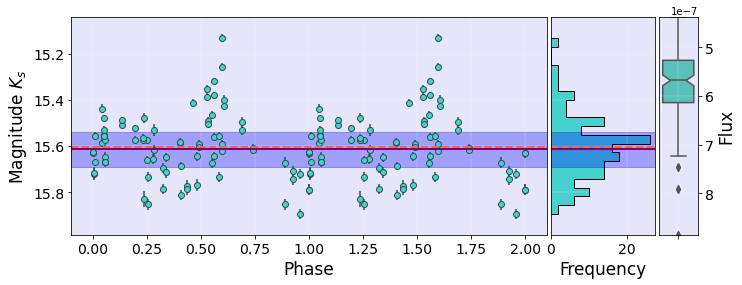

id_vvv 515882285710.0 Period_LS*2 0.83843852
0.83843852 515882285710.0


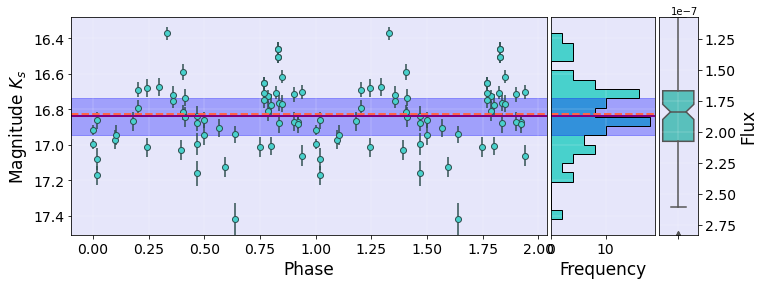

id_vvv 515882287485.0 Period_LS*2 0.64751232
0.64751232 515882287485.0


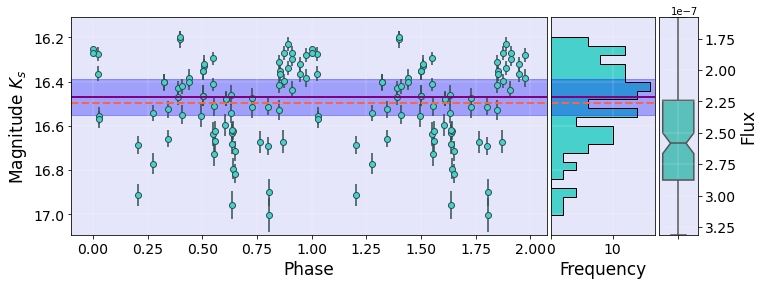

id_vvv 515882288464.0 Period_LS*2 6.3053976
6.3053976 515882288464.0


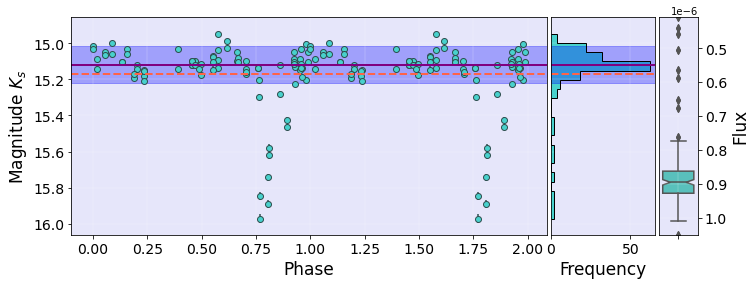

id_vvv 515882288619.0 Period_LS*2 1.7894292
1.7894292 515882288619.0


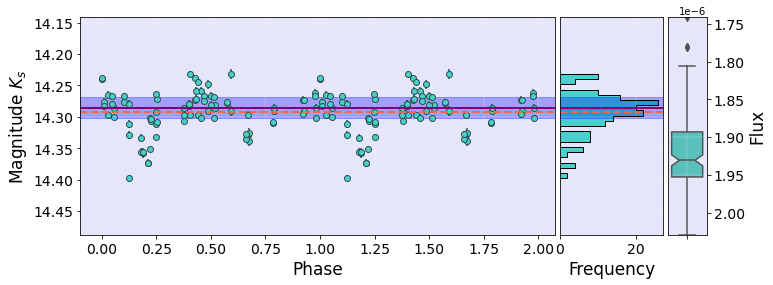

id_vvv 515882289137.0 Period_LS*2 0.8730992
0.8730992 515882289137.0


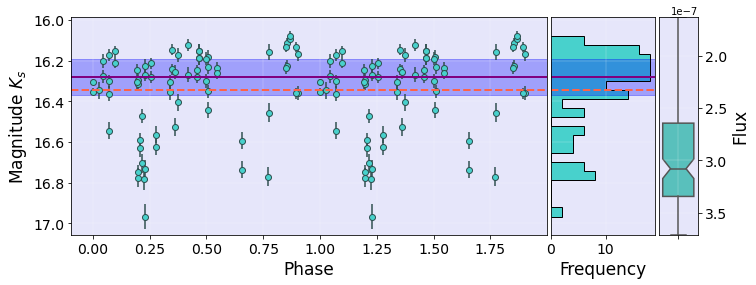

id_vvv 515882289172.0 Period_LS*2 1.87543834
1.87543834 515882289172.0


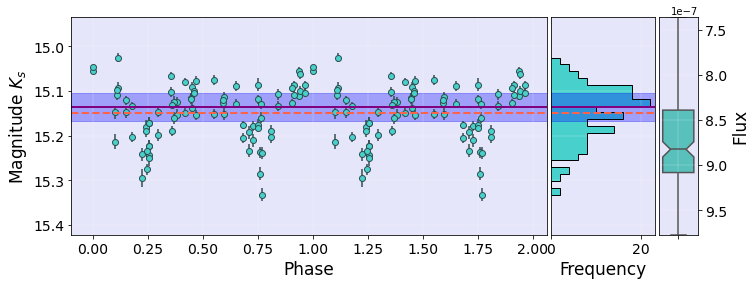

id_vvv 515882292939.0 Period_LS*2 657.74304
657.74304 515882292939.0


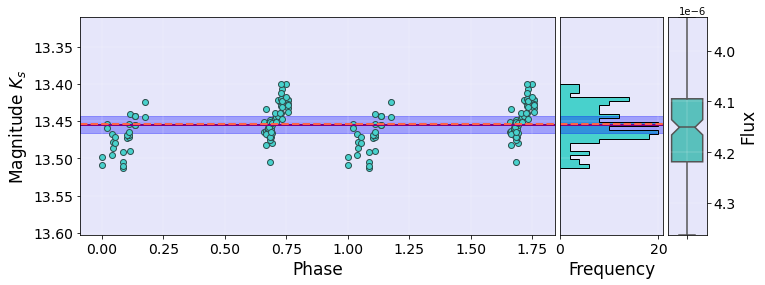

id_vvv 515882293073.0 Period_LS*2 734.2456
734.2456 515882293073.0


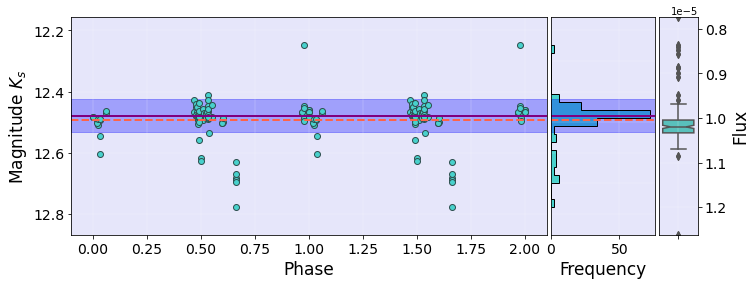

id_vvv 515882293221.0 Period_LS*2 0.7483342
0.7483342 515882293221.0


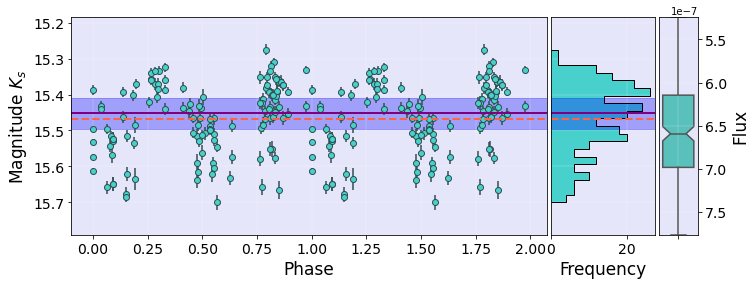

id_vvv 515882294388.0 Period_LS*2 0.62456948
0.62456948 515882294388.0


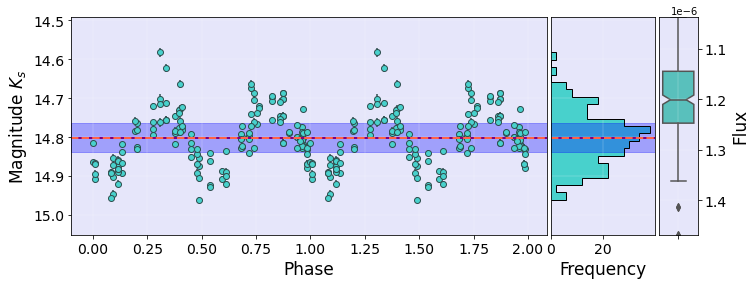

id_vvv 515882294426.0 Period_LS*2 0.44288206
0.44288206 515882294426.0


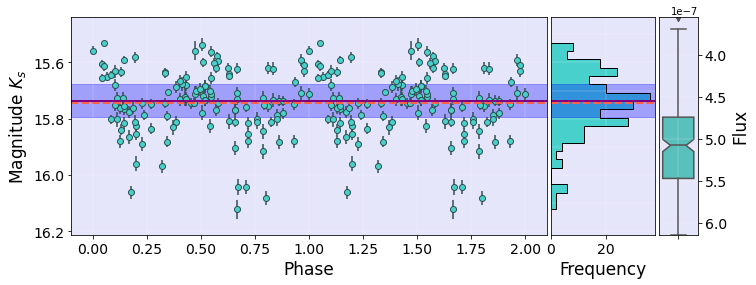

id_vvv 515882297461.0 Period_LS*2 148.52338
148.52338 515882297461.0


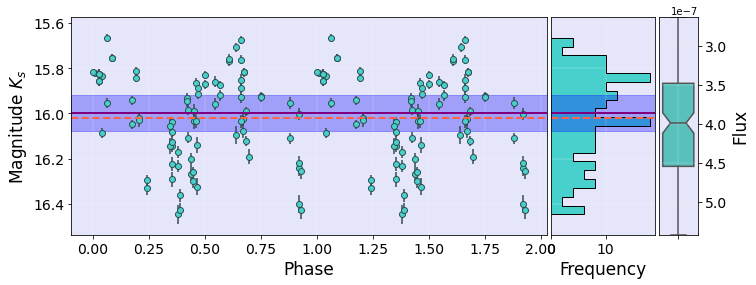

id_vvv 515882301344.0 Period_LS*2 6.0280194
6.0280194 515882301344.0


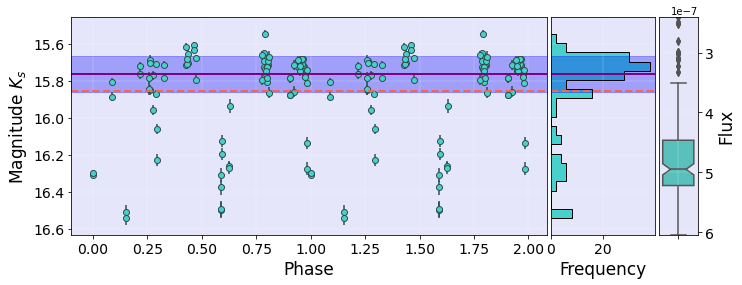

id_vvv 515882301975.0 Period_LS*2 0.63173366
0.63173366 515882301975.0


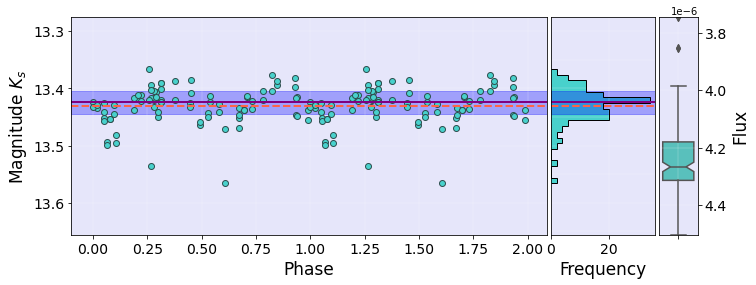

id_vvv 515882302208.0 Period_LS*2 0.67918592
0.67918592 515882302208.0


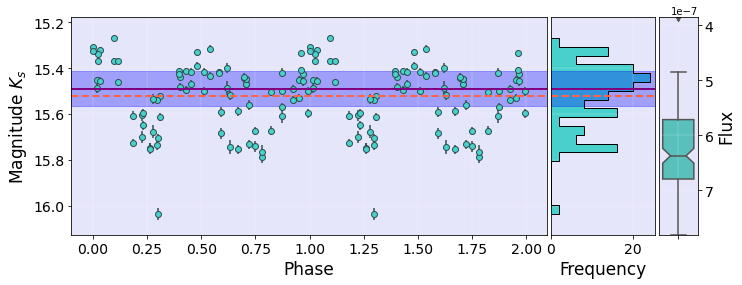

id_vvv 515882303396.0 Period_LS*2 0.95749306
0.95749306 515882303396.0


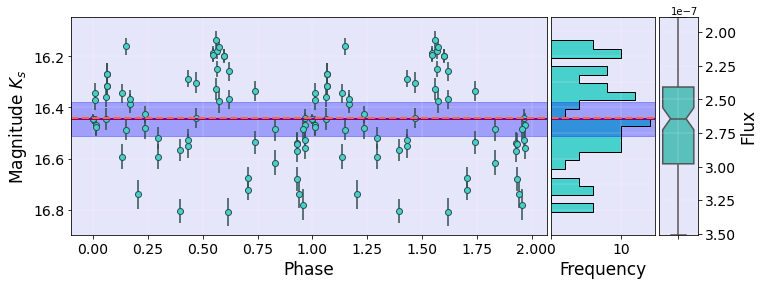

id_vvv 515882306205.0 Period_LS*2 1.1828088
1.1828088 515882306205.0


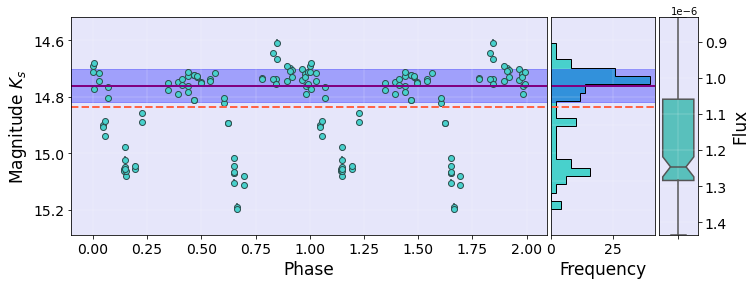

id_vvv 515882307266.0 Period_LS*2 0.5689988
0.5689988 515882307266.0


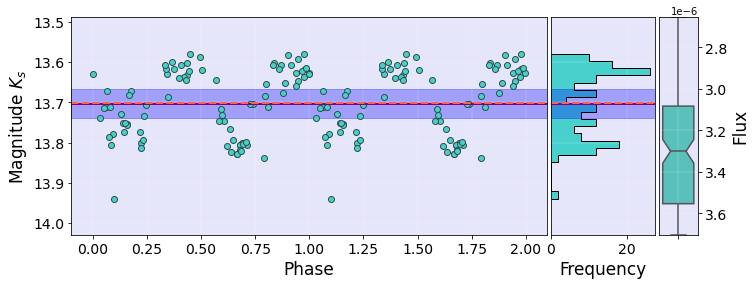

id_vvv 515882307542.0 Period_LS*2 0.728029
0.728029 515882307542.0


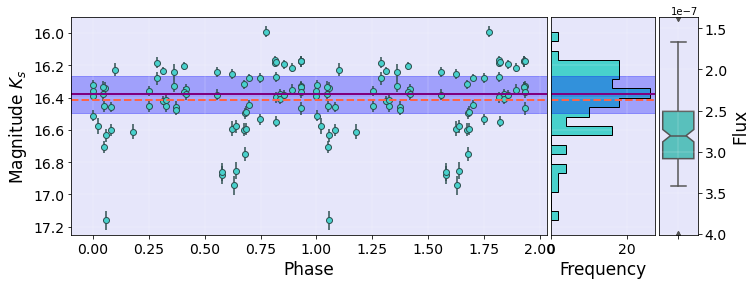

id_vvv 515882310894.0 Period_LS*2 3.4498734
3.4498734 515882310894.0


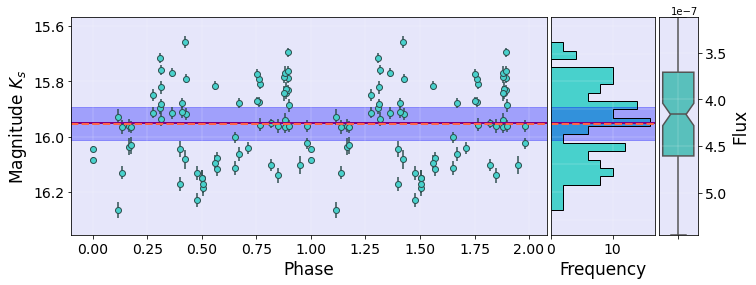

id_vvv 515882312118.0 Period_LS*2 0.90141434
0.90141434 515882312118.0


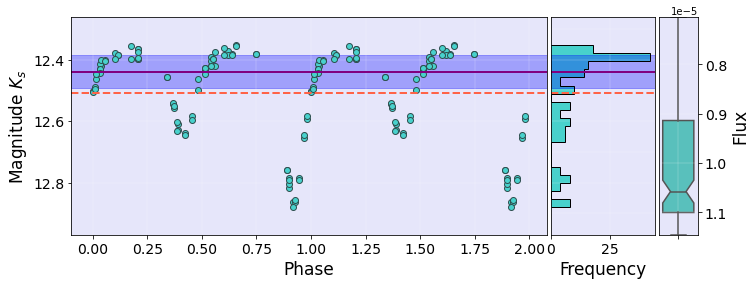

id_vvv 515882312465.0 Period_LS*2 0.97394436
0.97394436 515882312465.0


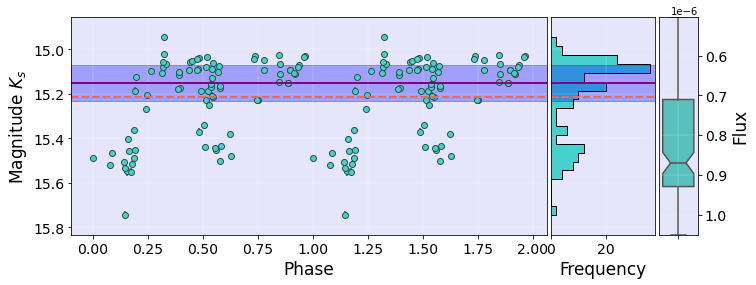

id_vvv 515882313037.0 Period_LS*2 0.6826095
0.6826095 515882313037.0


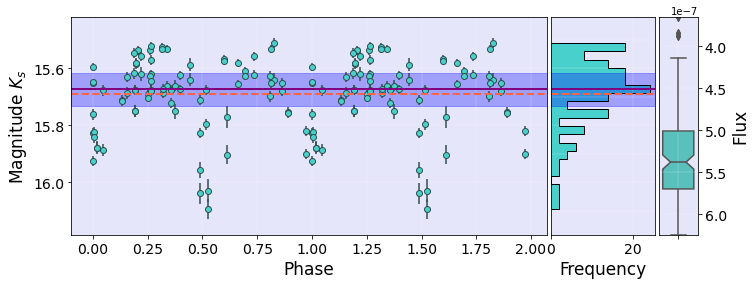

id_vvv 515882313488.0 Period_LS*2 0.59833676
0.59833676 515882313488.0


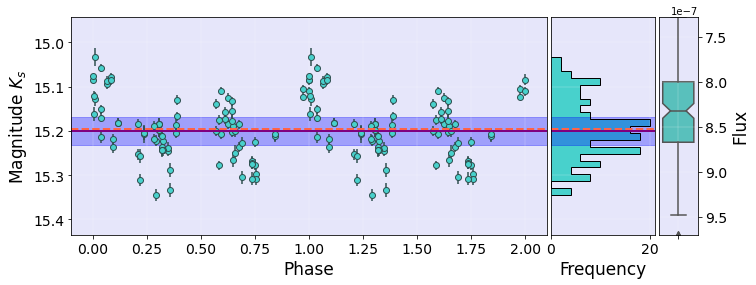

id_vvv 515882314544.0 Period_LS*2 1.09316706
1.09316706 515882314544.0


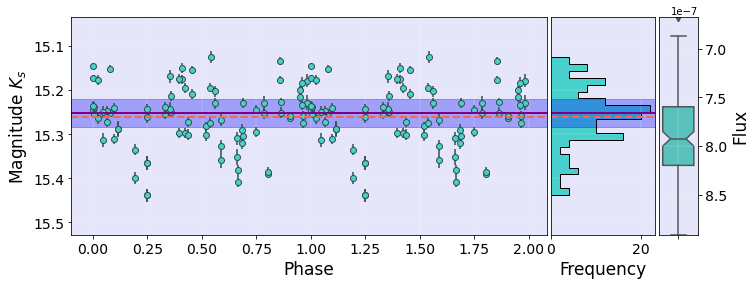

id_vvv 515882317898.0 Period_LS*2 0.62729246
0.62729246 515882317898.0


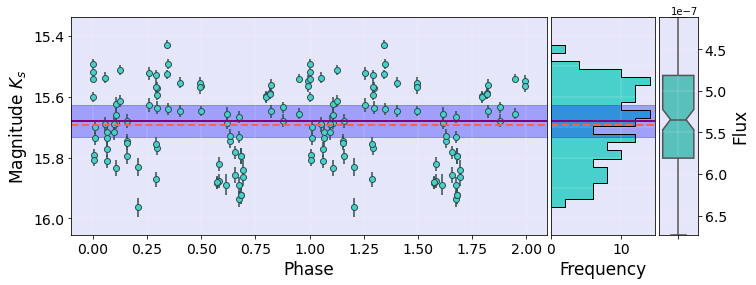

id_vvv 515882318627.0 Period_LS*2 2.1496878
2.1496878 515882318627.0


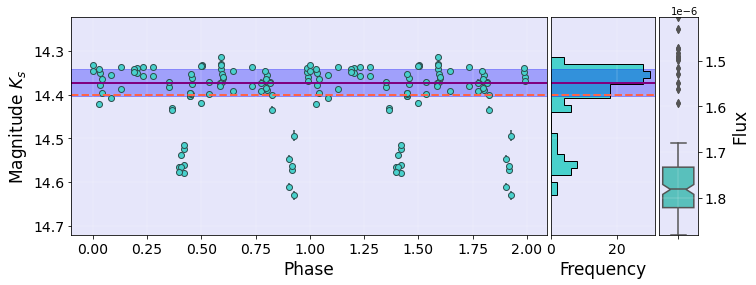

id_vvv 515882318740.0 Period_LS*2 4.0366482
4.0366482 515882318740.0


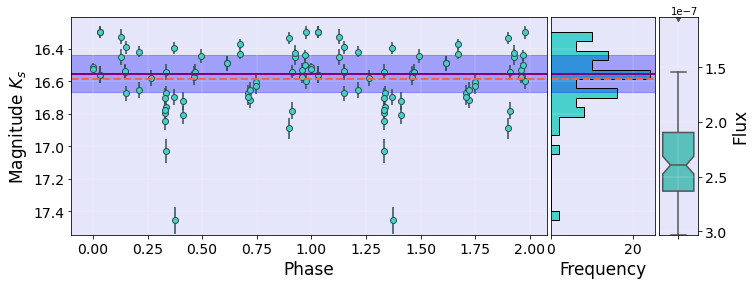

id_vvv 515882319425.0 Period_LS*2 0.69371724
0.69371724 515882319425.0


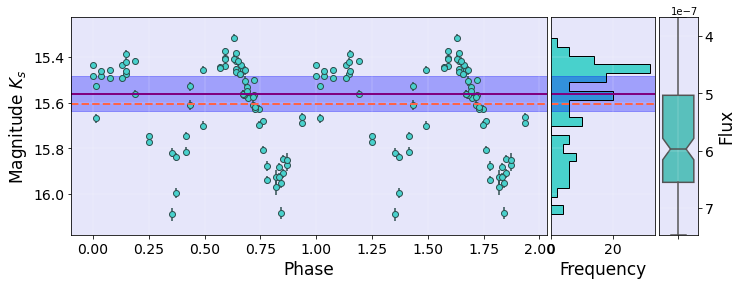

id_vvv 515882320402.0 Period_LS*2 0.7588926
0.7588926 515882320402.0


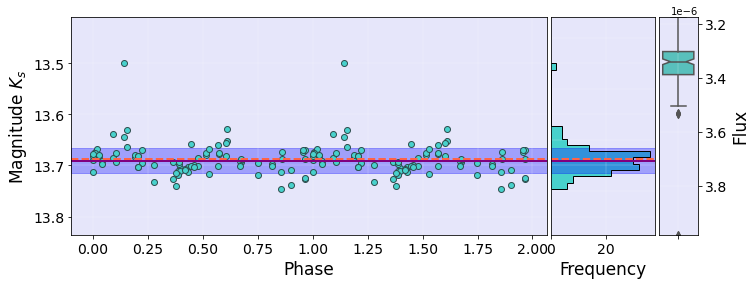

id_vvv 515882321929.0 Period_LS*2 2.4012732
2.4012732 515882321929.0


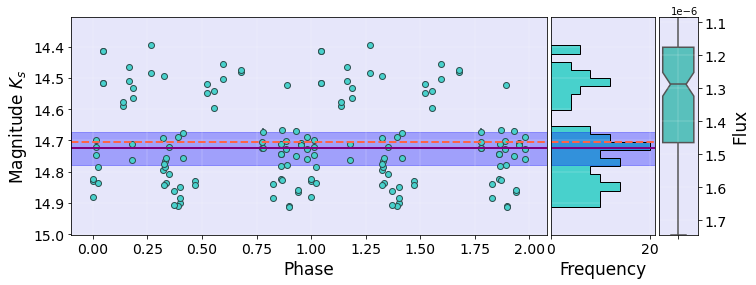

id_vvv 515882322550.0 Period_LS*2 0.73735648
0.73735648 515882322550.0


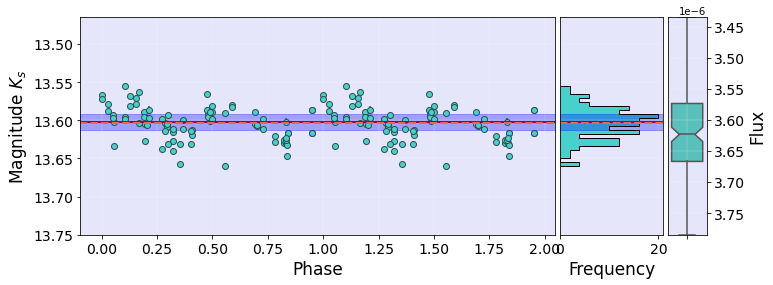

id_vvv 515882324911.0 Period_LS*2 26.374986
26.374986 515882324911.0


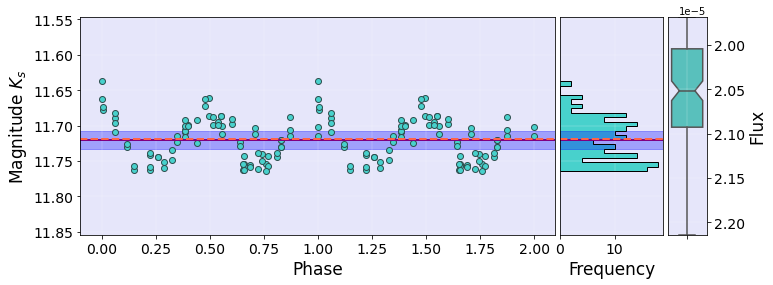

id_vvv 515882327250.0 Period_LS*2 1.9150658
1.9150658 515882327250.0


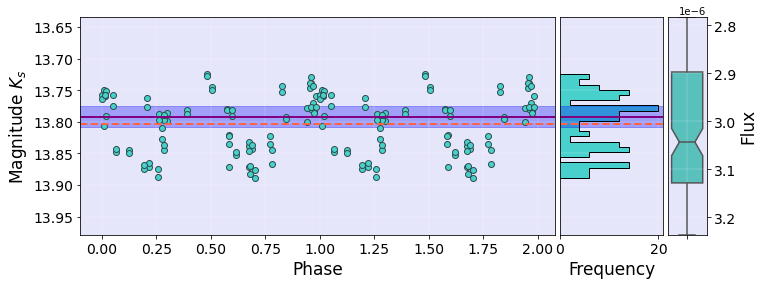

id_vvv 515882330350.0 Period_LS*2 0.61283124
0.61283124 515882330350.0


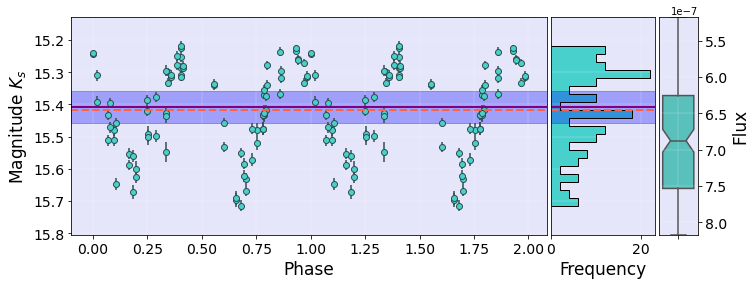

id_vvv 515882332014.0 Period_LS*2 2.289053
2.289053 515882332014.0


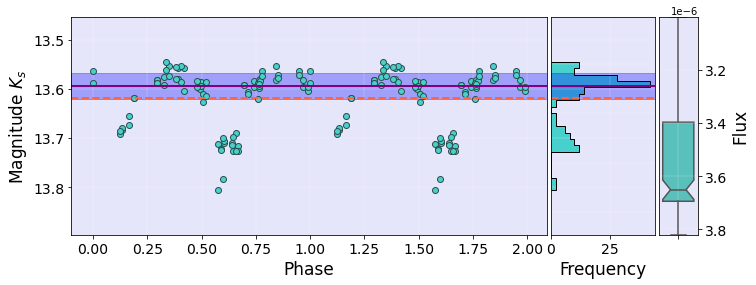

id_vvv 515882332645.0 Period_LS*2 0.58371168
0.58371168 515882332645.0


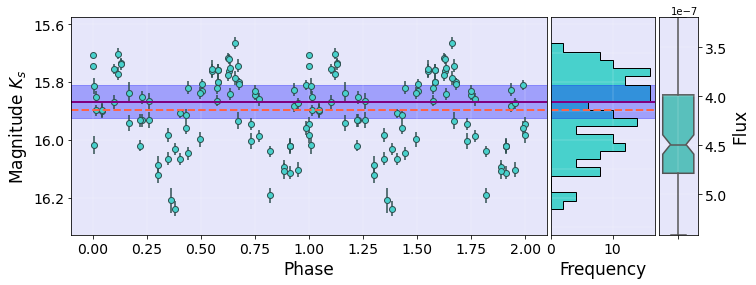

id_vvv 515882335699.0 Period_LS*2 0.7570956
0.7570956 515882335699.0


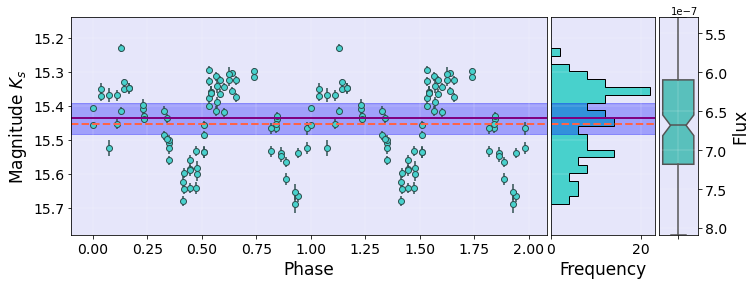

id_vvv 515882337394.0 Period_LS*2 0.81487406
0.81487406 515882337394.0


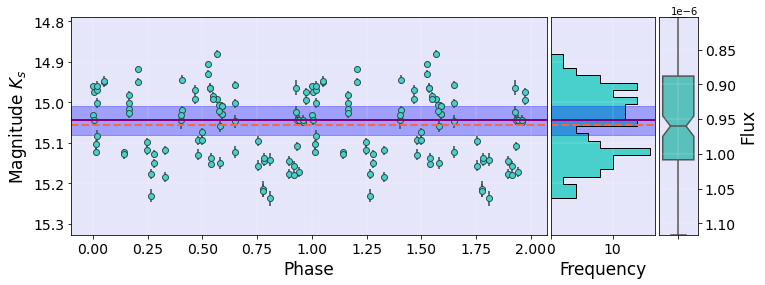

id_vvv 515882337573.0 Period_LS*2 6.7688932
6.7688932 515882337573.0


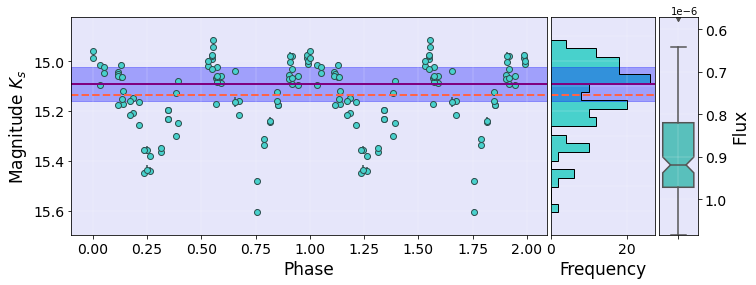

id_vvv 515882337596.0 Period_LS*2 0.99232752
0.99232752 515882337596.0


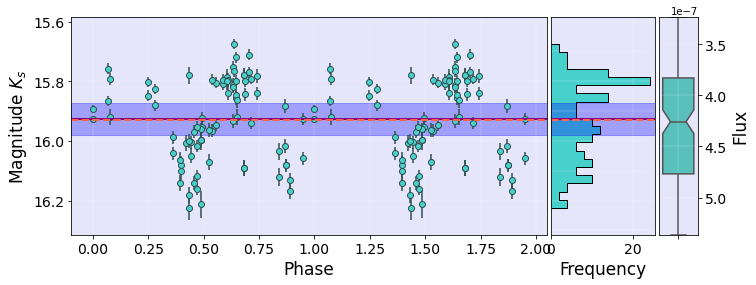

id_vvv 515882339152.0 Period_LS*2 1.6213118
1.6213118 515882339152.0


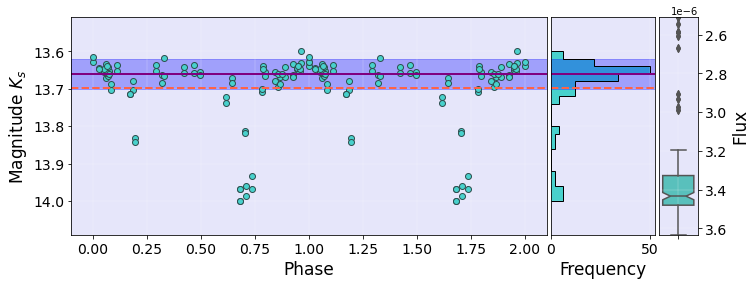

id_vvv 515882339335.0 Period_LS*2 1.0437052
1.0437052 515882339335.0


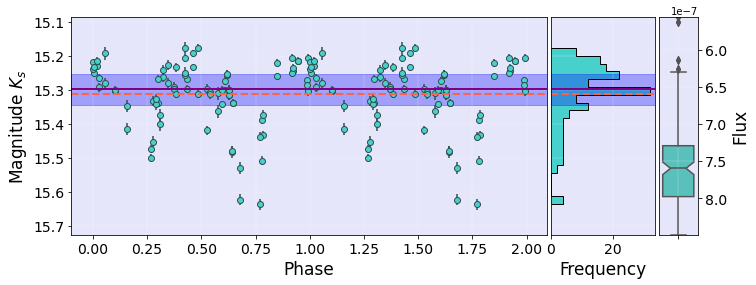

id_vvv 515882343401.0 Period_LS*2 2.6790938
2.6790938 515882343401.0


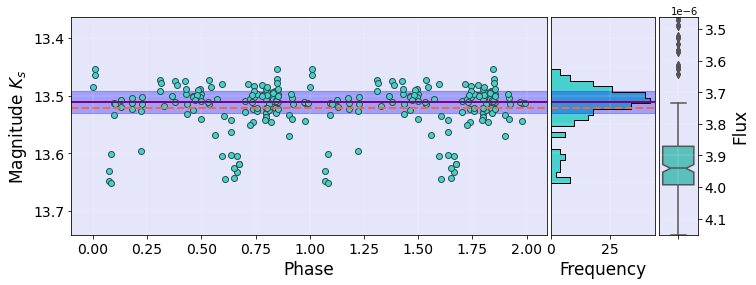

id_vvv 515882343529.0 Period_LS*2 3.6827716
3.6827716 515882343529.0


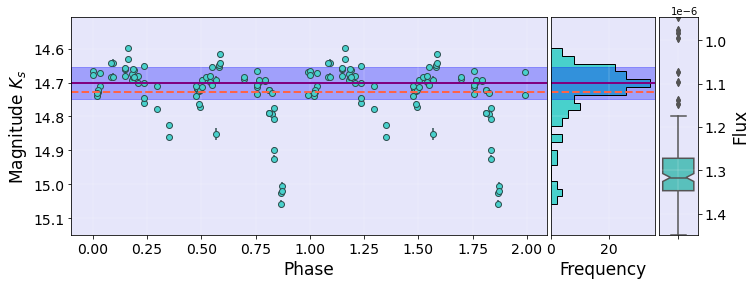

id_vvv 515882343760.0 Period_LS*2 3.347536
3.347536 515882343760.0


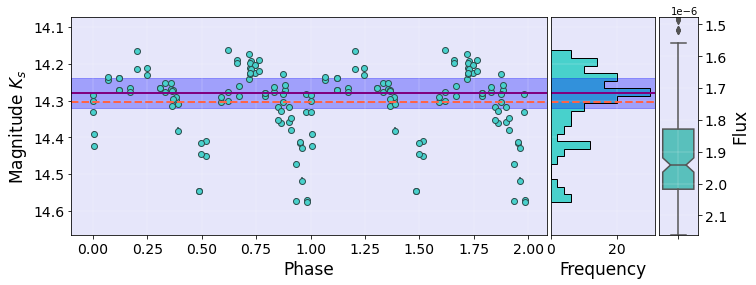

id_vvv 515882345867.0 Period_LS*2 0.81928206
0.81928206 515882345867.0


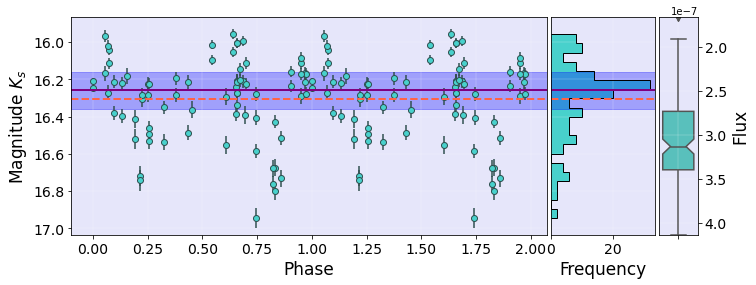

id_vvv 515882346326.0 Period_LS*2 88.884194
88.884194 515882346326.0


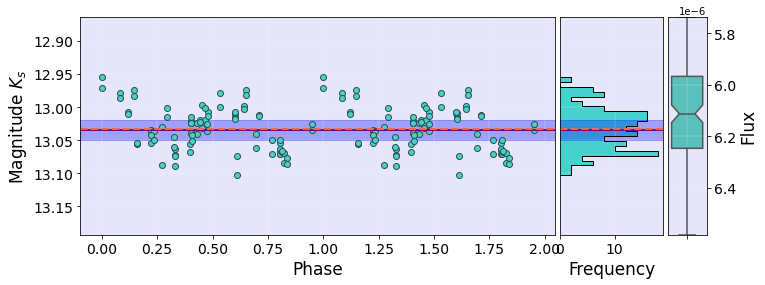

id_vvv 515882347242.0 Period_LS*2 1.48359906
1.48359906 515882347242.0


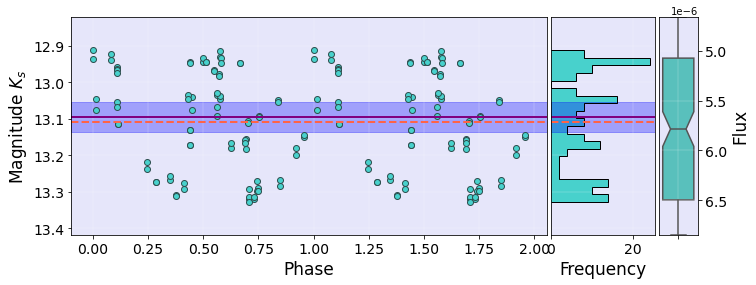

id_vvv 515882350389.0 Period_LS*2 1.44558906
1.44558906 515882350389.0


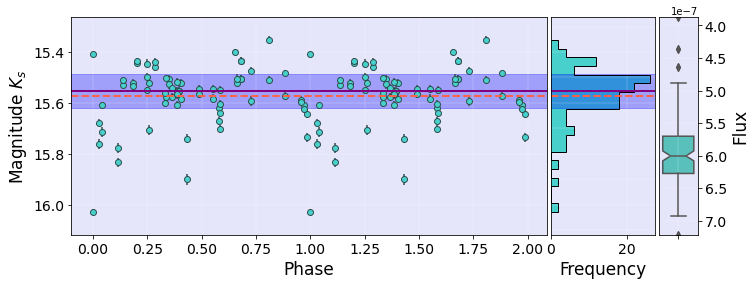

id_vvv 515882350475.0 Period_LS*2 33.80488
33.80488 515882350475.0


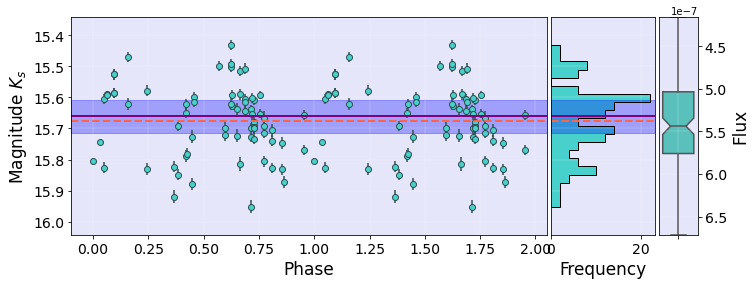

id_vvv 515882351317.0 Period_LS*2 4.20475
4.20475 515882351317.0


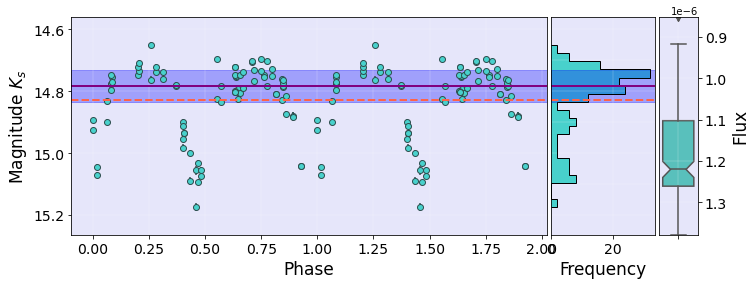

id_vvv 515882354349.0 Period_LS*2 39.218068
39.218068 515882354349.0


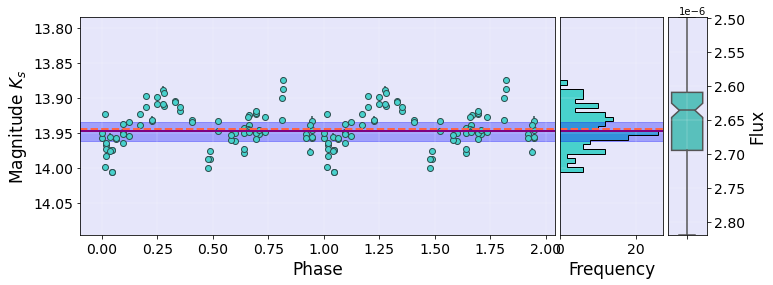

id_vvv 515882355098.0 Period_LS*2 0.8445906
0.8445906 515882355098.0


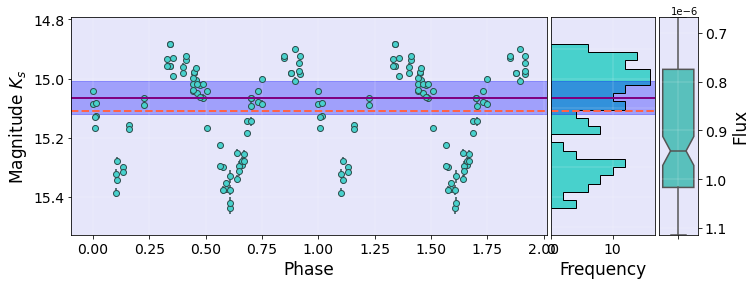

id_vvv 515882355894.0 Period_LS*2 1.01561772
1.01561772 515882355894.0


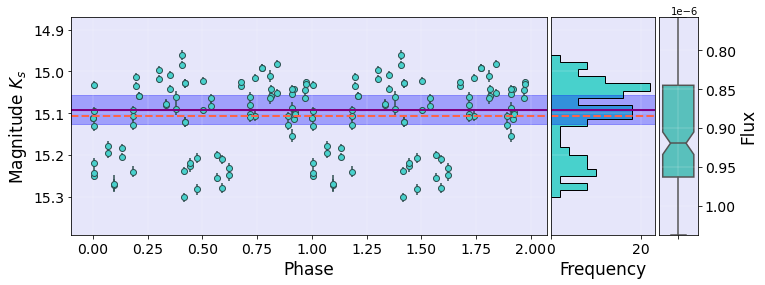

id_vvv 515882356902.0 Period_LS*2 1.0962906
1.0962906 515882356902.0


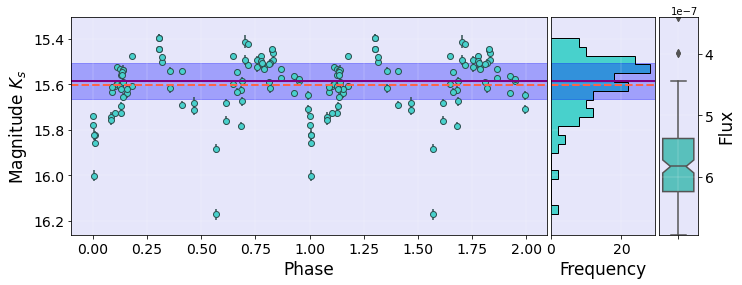

id_vvv 515882356912.0 Period_LS*2 0.98418224
0.98418224 515882356912.0


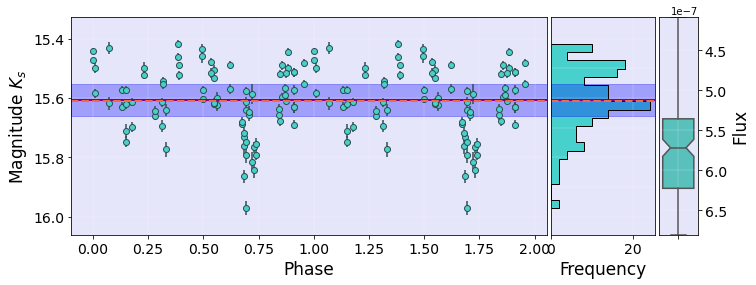

id_vvv 515882357444.0 Period_LS*2 1.26121772
1.26121772 515882357444.0


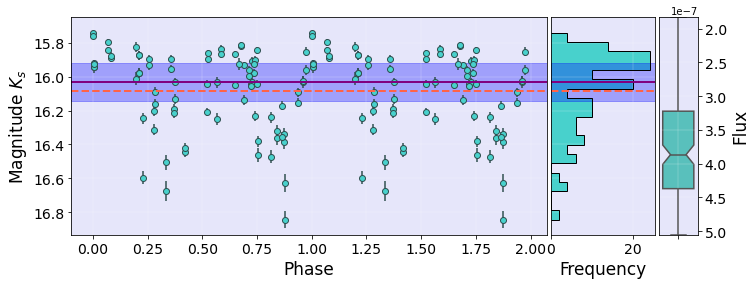

id_vvv 515882358091.0 Period_LS*2 2.0034868
2.0034868 515882358091.0


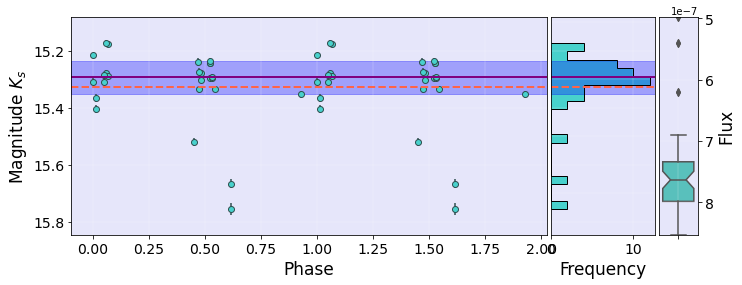

id_vvv 515882358319.0 Period_LS*2 1.16591572
1.16591572 515882358319.0


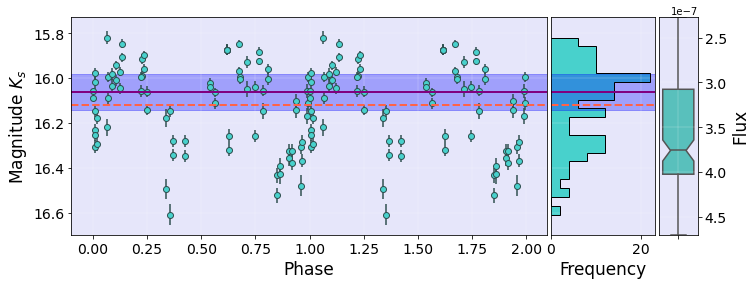

id_vvv 515882358506.0 Period_LS*2 0.7283976
0.7283976 515882358506.0


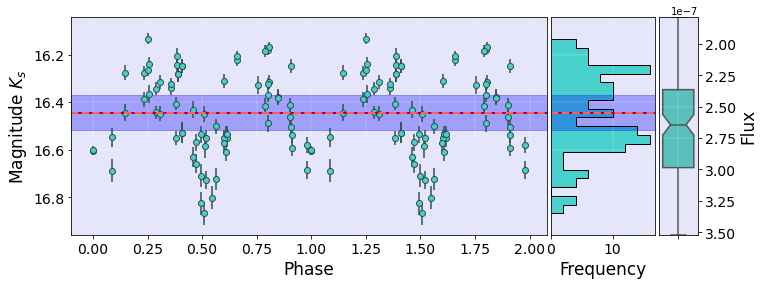

id_vvv 515882360108.0 Period_LS*2 0.5841264
0.5841264 515882360108.0


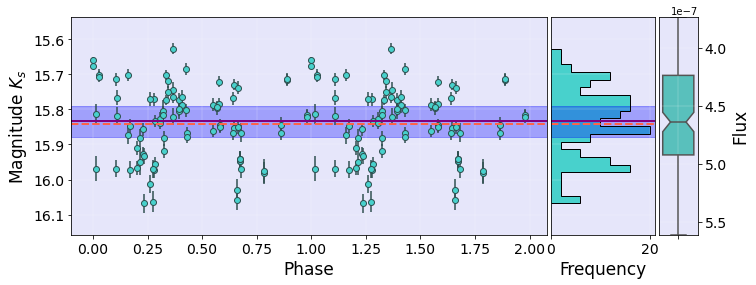

id_vvv 515882360111.0 Period_LS*2 12.984211
12.984211 515882360111.0


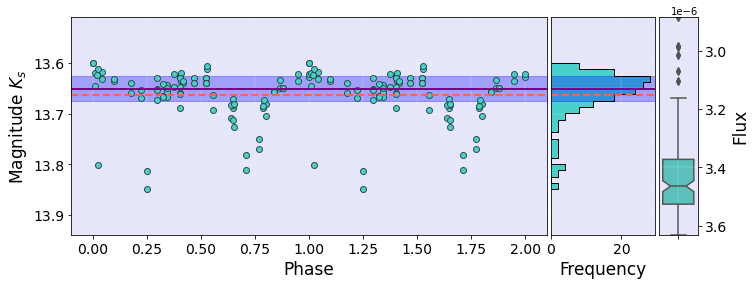

id_vvv 515882362537.0 Period_LS*2 2.1294058
2.1294058 515882362537.0


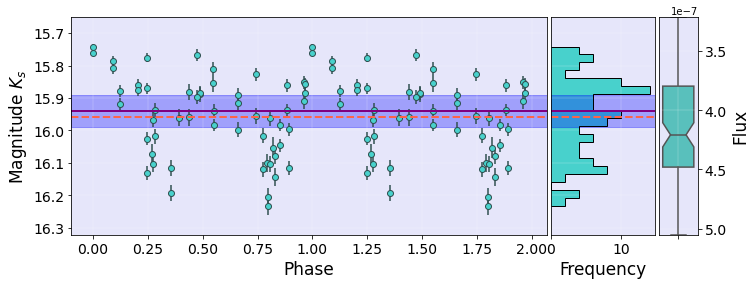

id_vvv 515882363382.0 Period_LS*2 0.6720088
0.6720088 515882363382.0


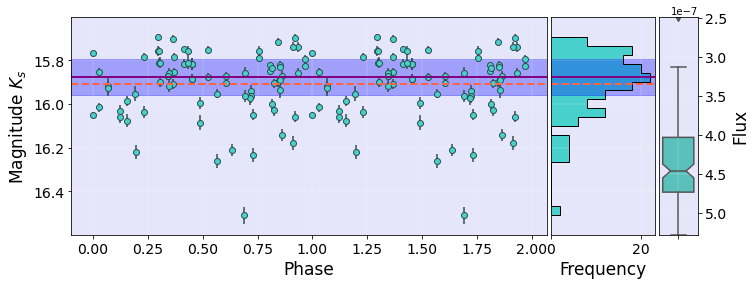

id_vvv 515882366593.0 Period_LS*2 2.0132056
2.0132056 515882366593.0


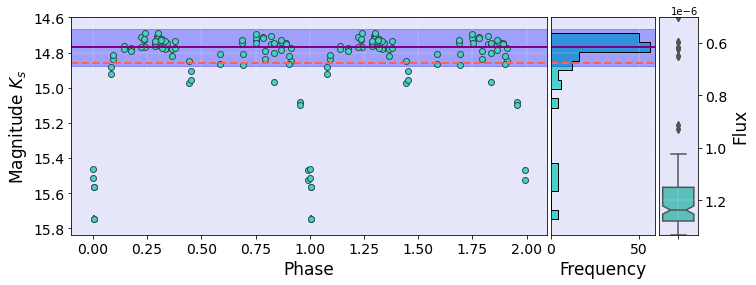

id_vvv 515882367259.0 Period_LS*2 6.0154186
6.0154186 515882367259.0


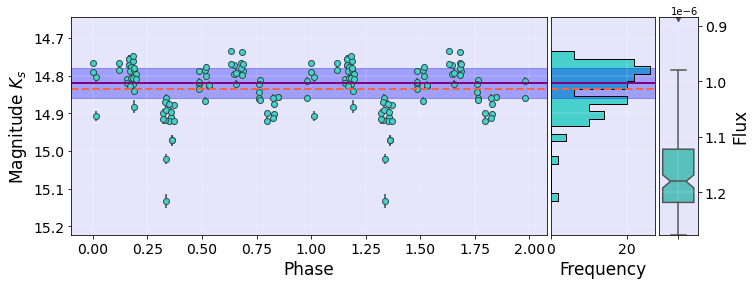

id_vvv 515882367670.0 Period_LS*2 0.84945226
0.84945226 515882367670.0


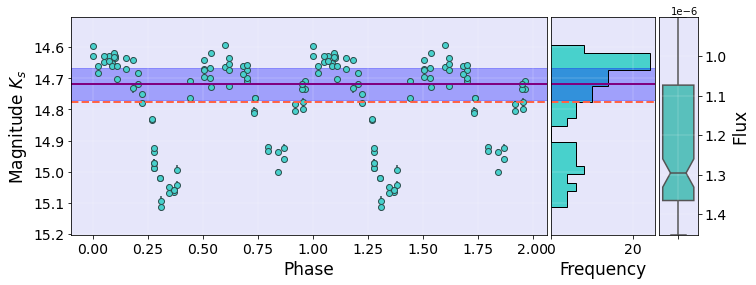

id_vvv 515882369768.0 Period_LS*2 0.7363696
0.7363696 515882369768.0


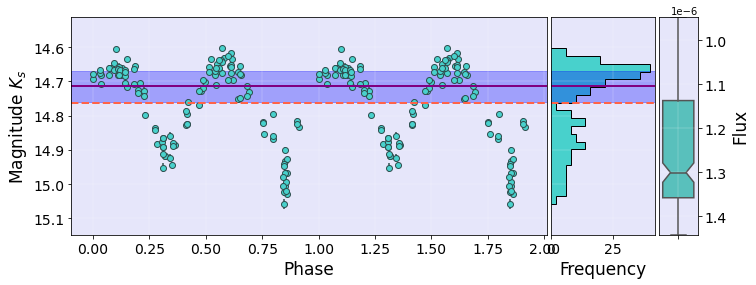

id_vvv 515882370568.0 Period_LS*2 65.586914
65.586914 515882370568.0


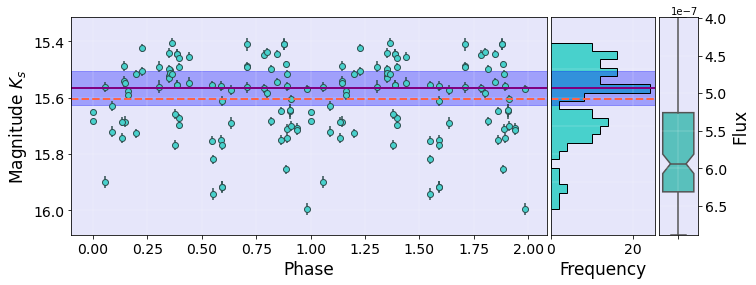

id_vvv 515882372039.0 Period_LS*2 33.0287
33.0287 515882372039.0


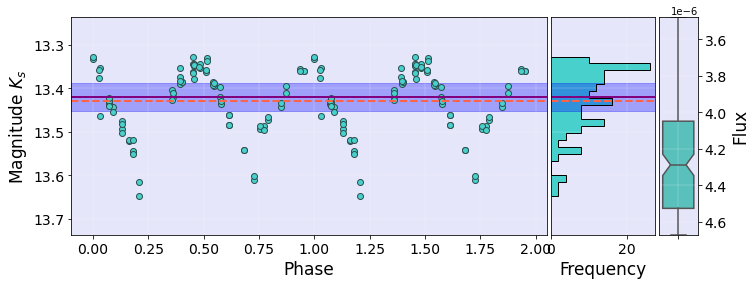

id_vvv 515882373138.0 Period_LS*2 14.433306
14.433306 515882373138.0


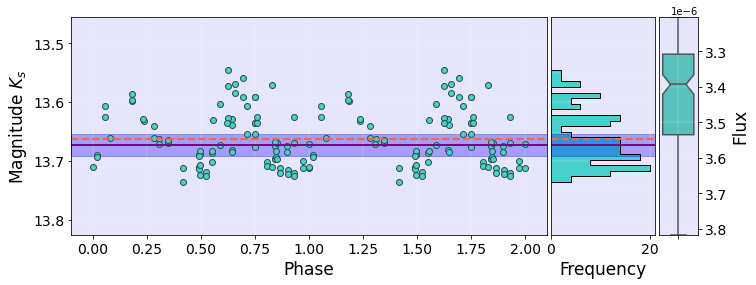

id_vvv 515882373204.0 Period_LS*2 0.6540616
0.6540616 515882373204.0


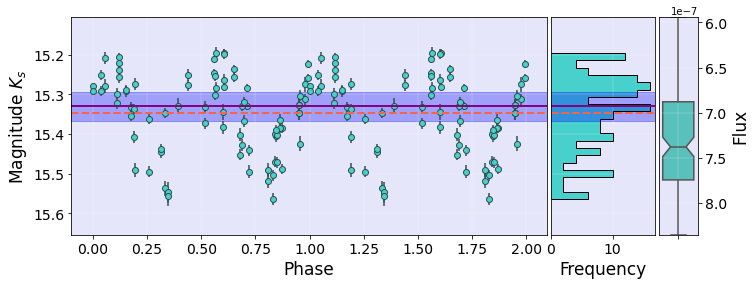

id_vvv 515882374129.0 Period_LS*2 0.6345669
0.6345669 515882374129.0


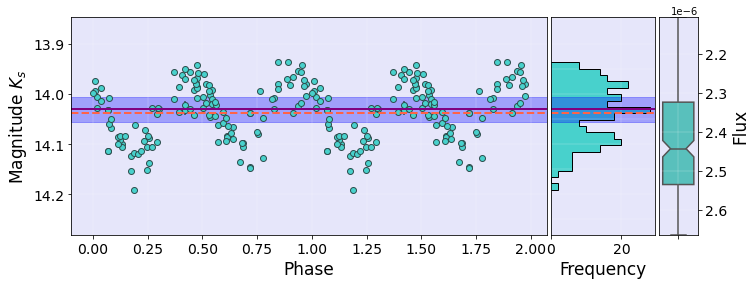

id_vvv 515882374287.0 Period_LS*2 0.56163866
0.56163866 515882374287.0


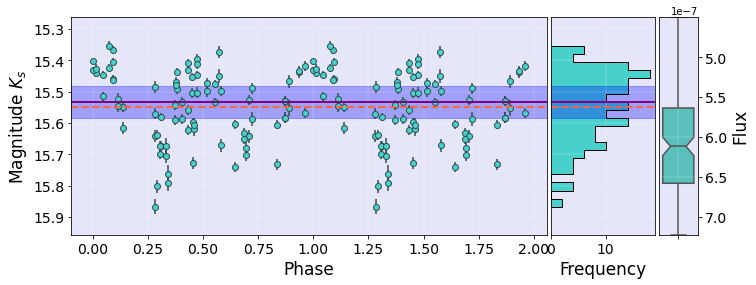

id_vvv 515882374325.0 Period_LS*2 5.58085
5.58085 515882374325.0


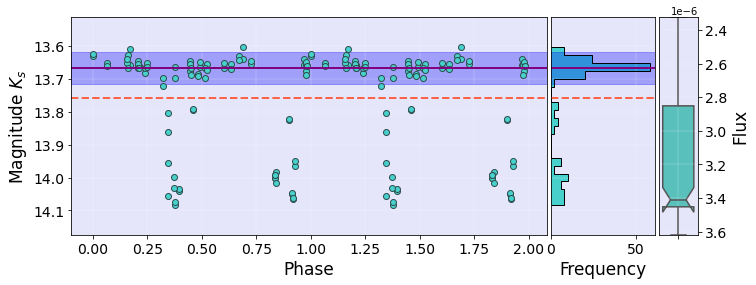

id_vvv 515882378292.0 Period_LS*2 0.77265054
0.77265054 515882378292.0


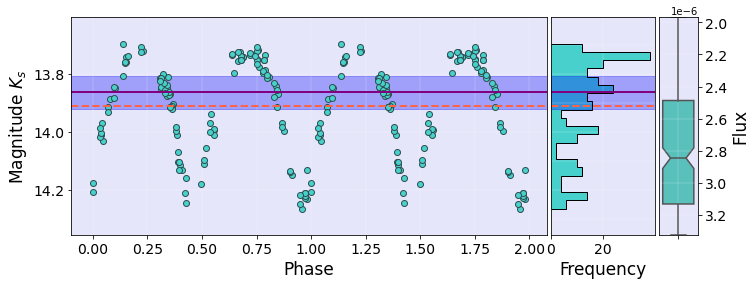

id_vvv 515882381178.0 Period_LS*2 2.1006484
2.1006484 515882381178.0


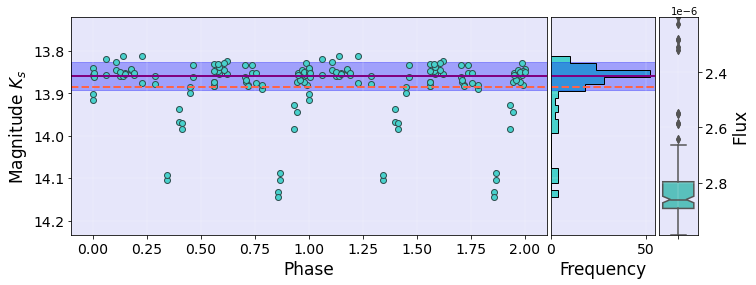

id_vvv 515882381396.0 Period_LS*2 18.05569
18.05569 515882381396.0


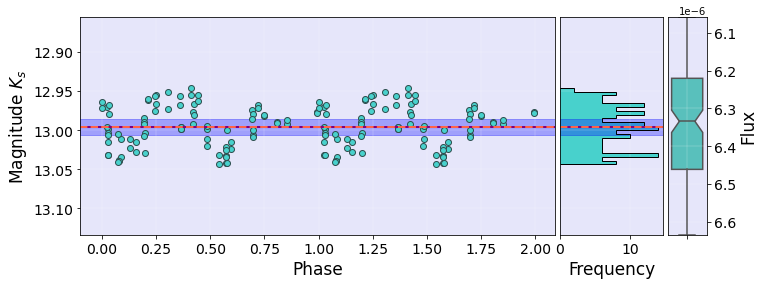

id_vvv 515882386014.0 Period_LS*2 1.4463156
1.4463156 515882386014.0


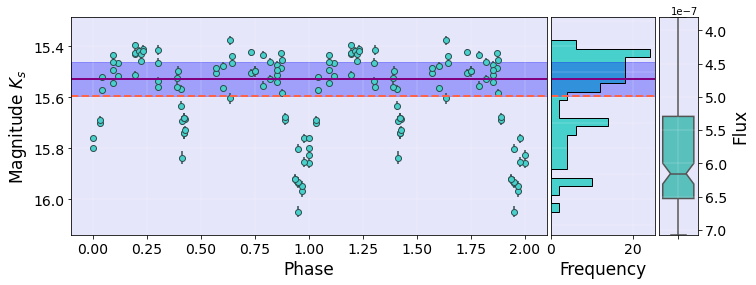

id_vvv 515882386446.0 Period_LS*2 0.5689678
0.5689678 515882386446.0


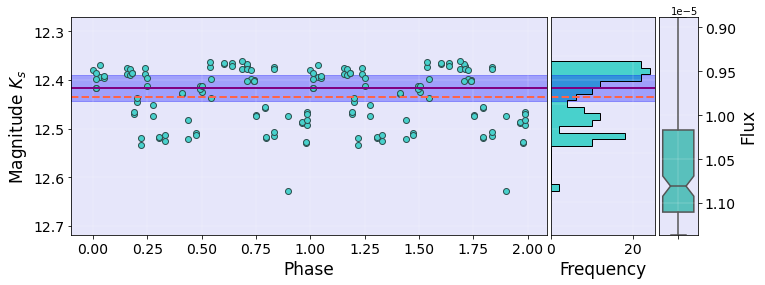

id_vvv 515882386687.0 Period_LS*2 0.80232536
0.80232536 515882386687.0


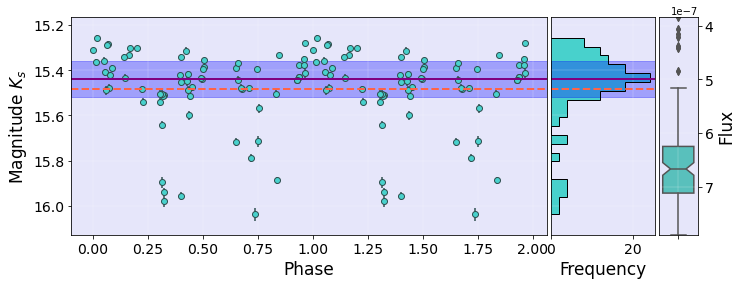

id_vvv 515882387215.0 Period_LS*2 0.80869096
0.80869096 515882387215.0


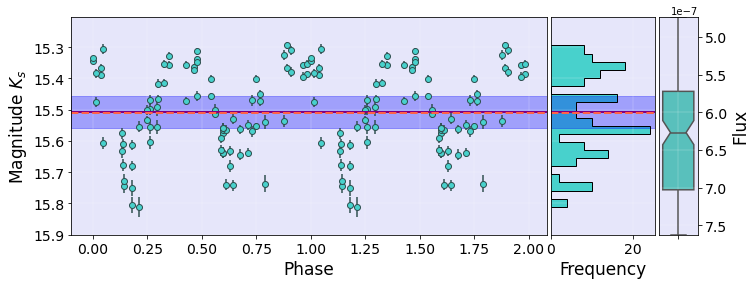

id_vvv 515882388357.0 Period_LS*2 0.68923104
0.68923104 515882388357.0


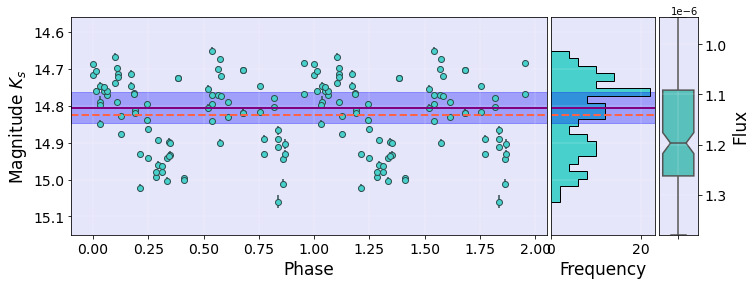

id_vvv 515882388873.0 Period_LS*2 0.6319764
0.6319764 515882388873.0


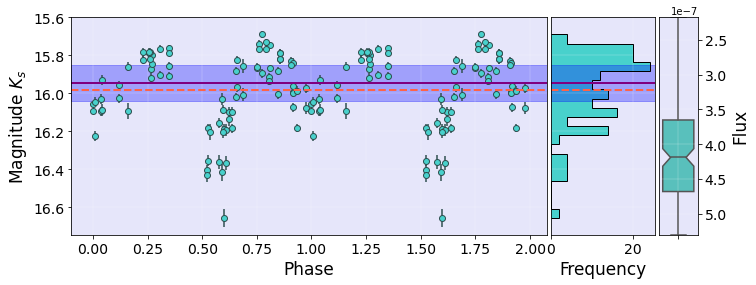

id_vvv 515882389142.0 Period_LS*2 1.7102003
1.7102003 515882389142.0


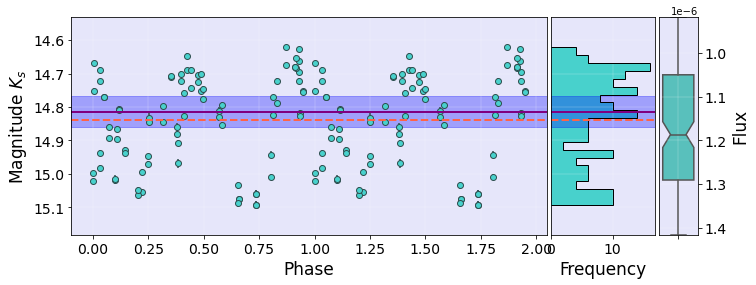

id_vvv 515882389357.0 Period_LS*2 0.66927708
0.66927708 515882389357.0


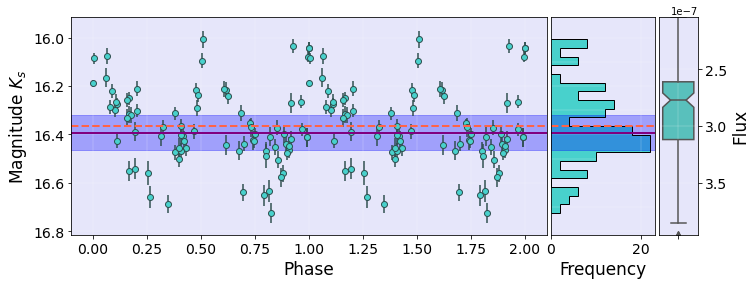

id_vvv 515882389653.0 Period_LS*2 0.62671184
0.62671184 515882389653.0


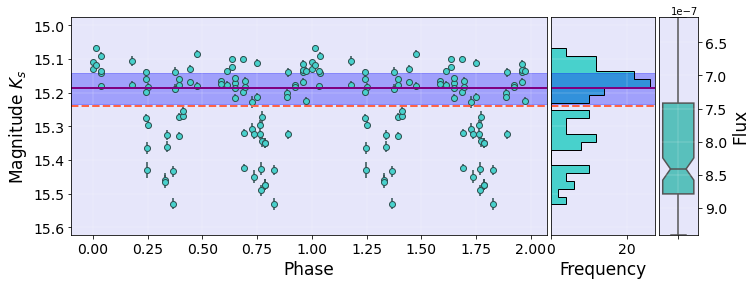

id_vvv 515882390241.0 Period_LS*2 1.02548028
1.02548028 515882390241.0


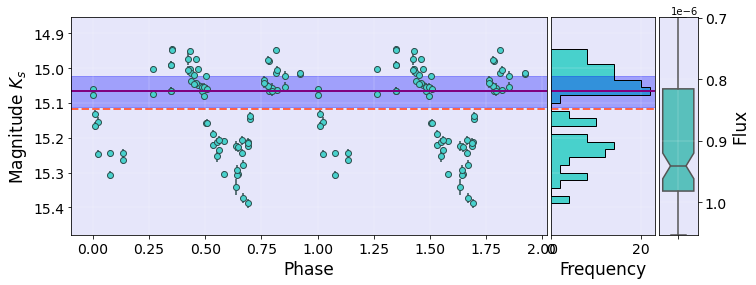

id_vvv 515882393652.0 Period_LS*2 2.446713
2.446713 515882393652.0


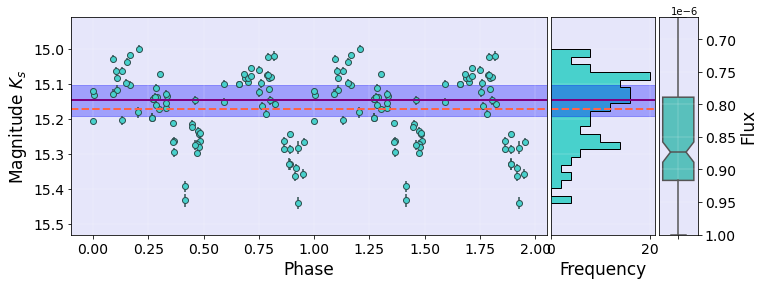

id_vvv 515882394223.0 Period_LS*2 1.5836146
1.5836146 515882394223.0


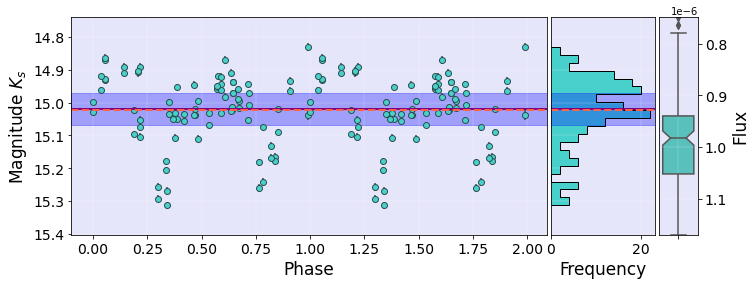

id_vvv 515882396702.0 Period_LS*2 1.21374608
1.21374608 515882396702.0


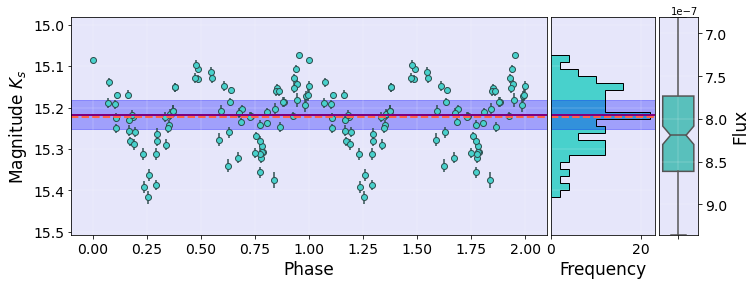

id_vvv 515882401469.0 Period_LS*2 0.65257836
0.65257836 515882401469.0


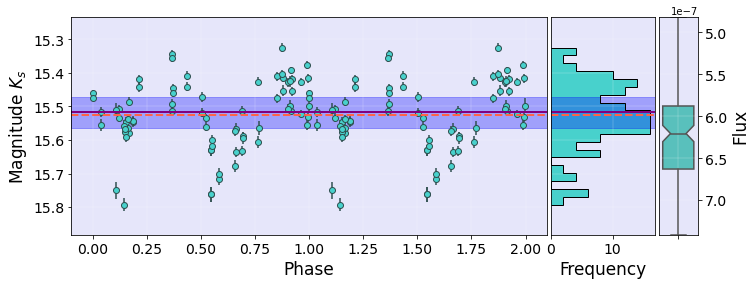

id_vvv 515882403286.0 Period_LS*2 0.64403432
0.64403432 515882403286.0


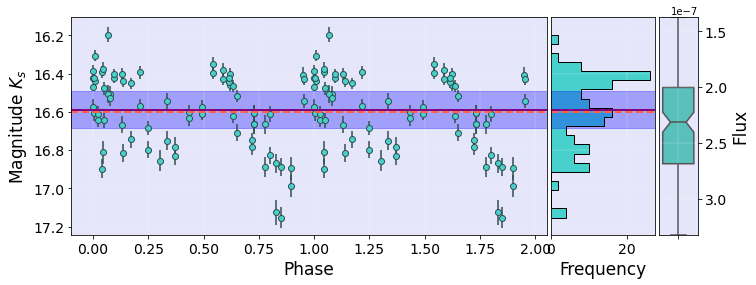

id_vvv 515882403343.0 Period_LS*2 0.64613116
0.64613116 515882403343.0


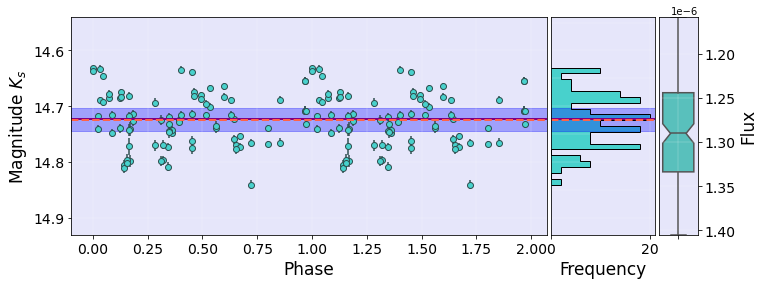

id_vvv 515882403930.0 Period_LS*2 2.708035
2.708035 515882403930.0


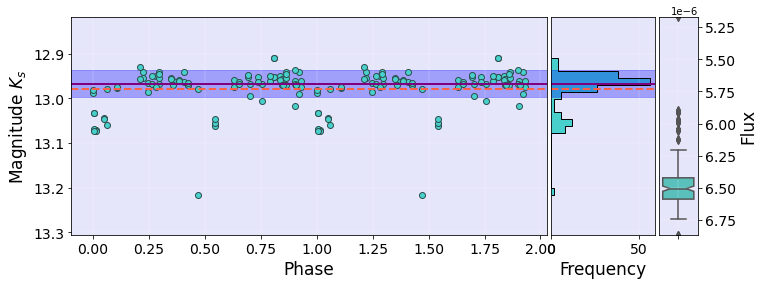

id_vvv 515882407121.0 Period_LS*2 2.1286182
2.1286182 515882407121.0


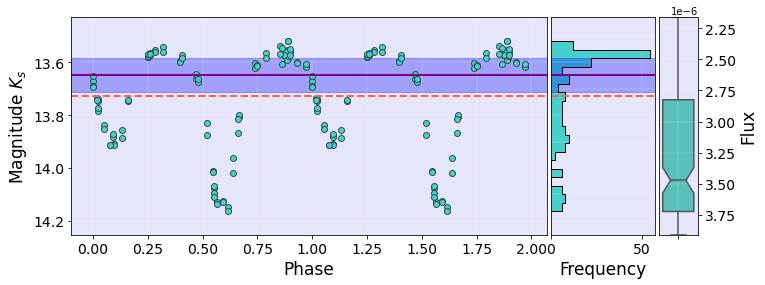

id_vvv 515882408000.0 Period_LS*2 9.5167446
9.5167446 515882408000.0


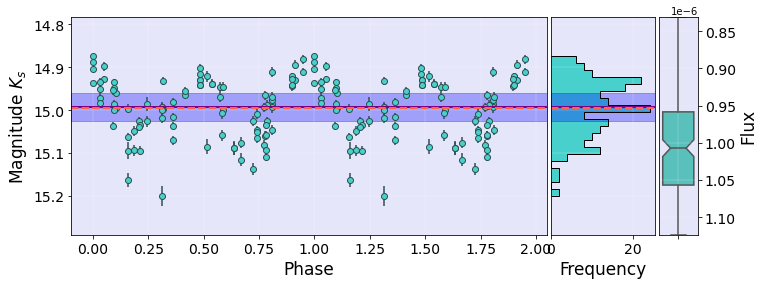

id_vvv 515882408898.0 Period_LS*2 0.45159594
0.45159594 515882408898.0


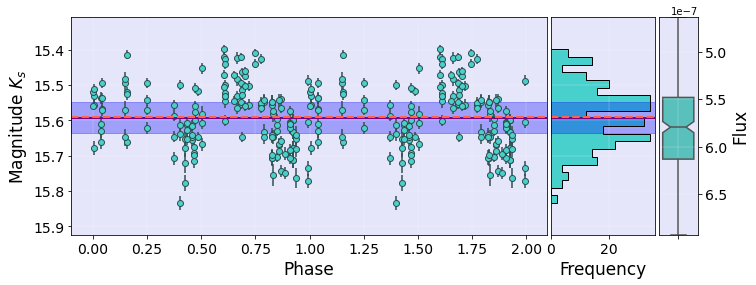

id_vvv 515882410893.0 Period_LS*2 0.3879182
0.3879182 515882410893.0


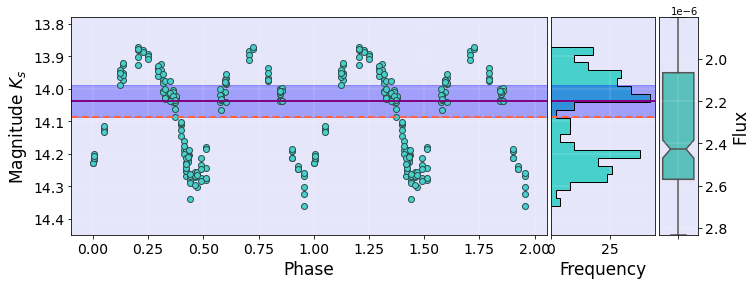

id_vvv 515882412003.0 Period_LS*2 0.41280904
0.41280904 515882412003.0


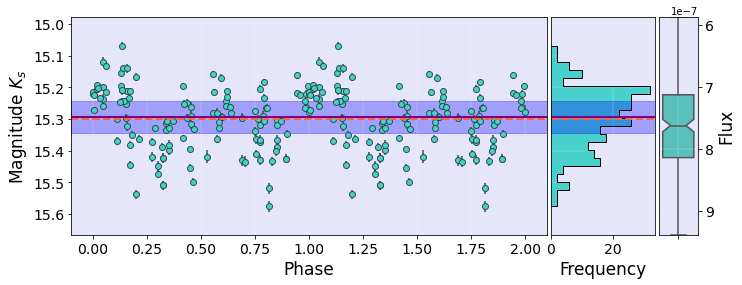

id_vvv 515882412055.0 Period_LS*2 0.61637544
0.61637544 515882412055.0


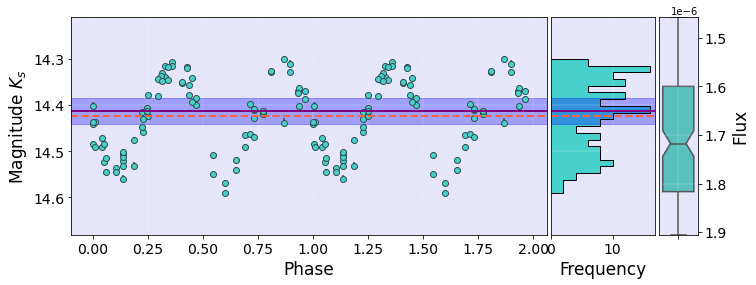

id_vvv 515882412445.0 Period_LS*2 0.9885776
0.9885776 515882412445.0


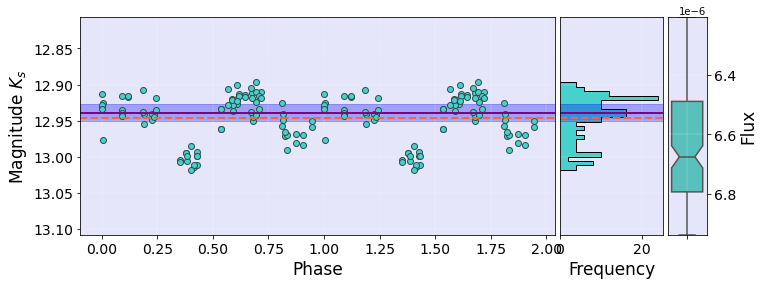

id_vvv 515882412843.0 Period_LS*2 0.57187944
0.57187944 515882412843.0


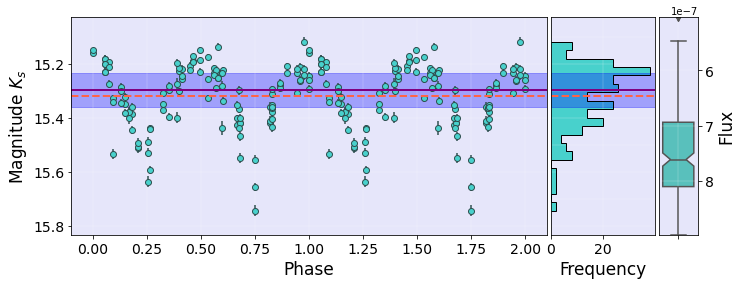

id_vvv 515882412927.0 Period_LS*2 0.68935836
0.68935836 515882412927.0


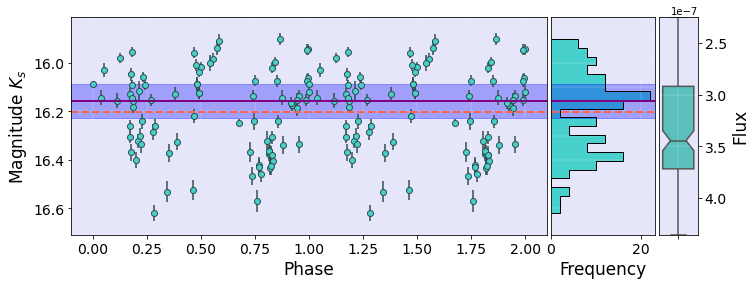

id_vvv 515882413217.0 Period_LS*2 0.74048716
0.74048716 515882413217.0


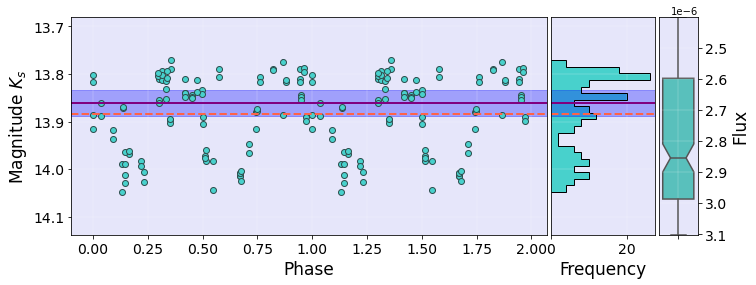

id_vvv 515882413965.0 Period_LS*2 27.404916
27.404916 515882413965.0


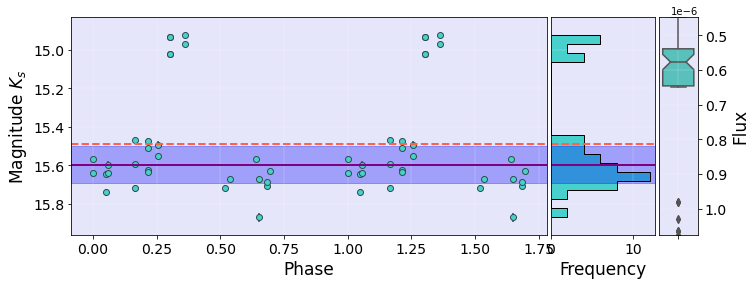

id_vvv 515882414548.0 Period_LS*2 0.7695472
0.7695472 515882414548.0


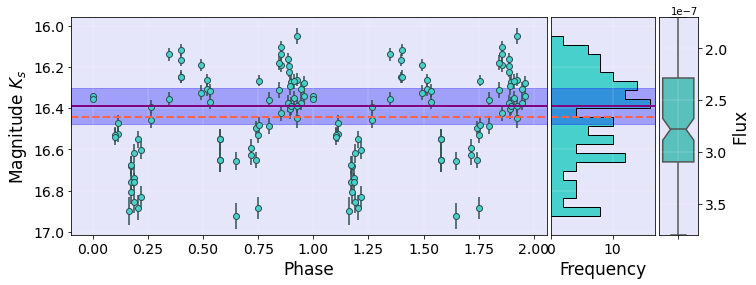

id_vvv 515882416149.0 Period_LS*2 5.540555
5.540555 515882416149.0


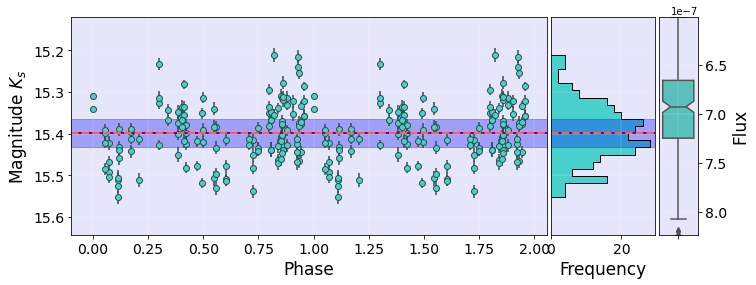

id_vvv 515882416474.0 Period_LS*2 2.3157638
2.3157638 515882416474.0


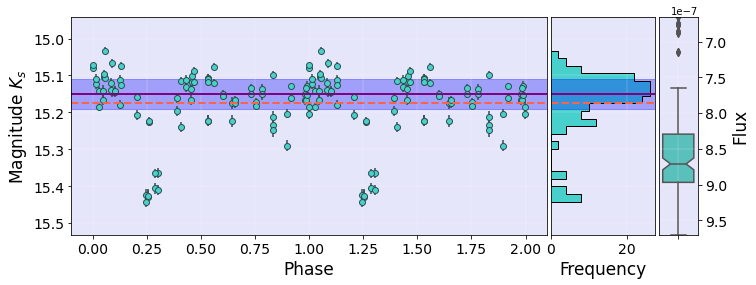

id_vvv 515882416590.0 Period_LS*2 1.3558516
1.3558516 515882416590.0


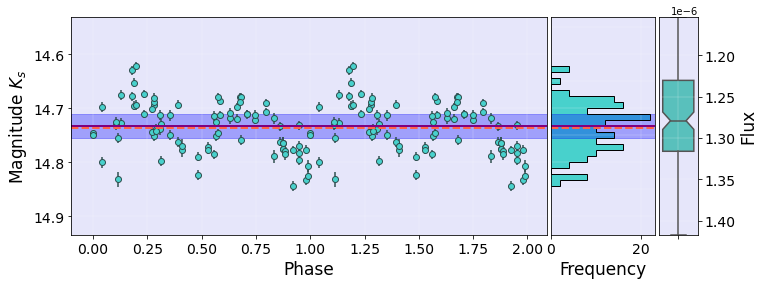

id_vvv 515882419129.0 Period_LS*2 1.3968209
1.3968209 515882419129.0


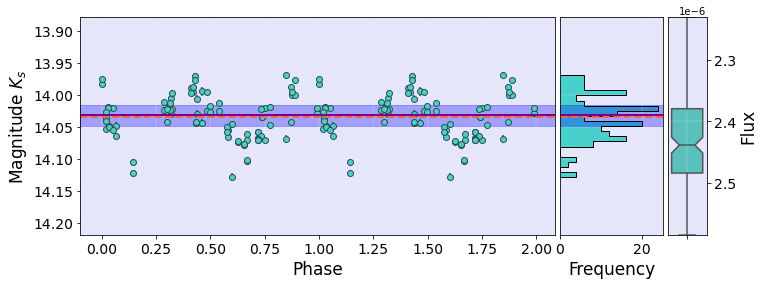

id_vvv 515882419550.0 Period_LS*2 2.099116
2.099116 515882419550.0


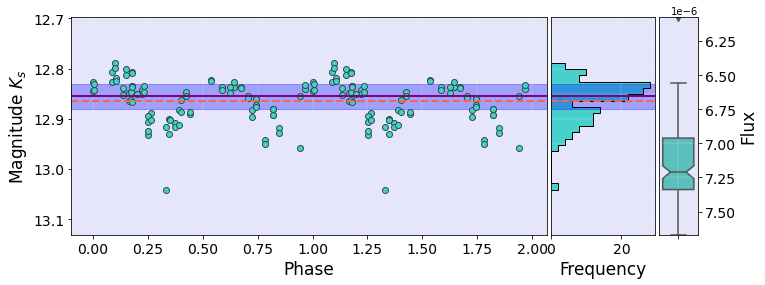

id_vvv 515882420446.0 Period_LS*2 0.88949448
0.88949448 515882420446.0


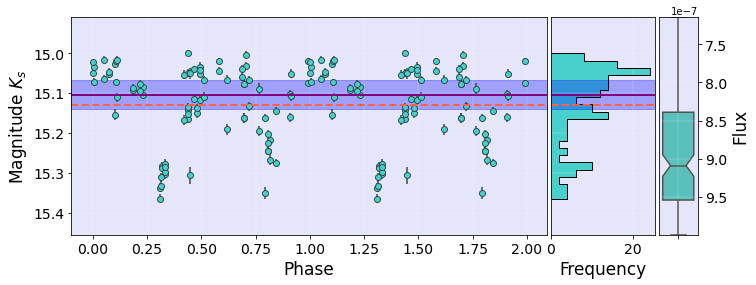

id_vvv 515882420604.0 Period_LS*2 0.57582748
0.57582748 515882420604.0


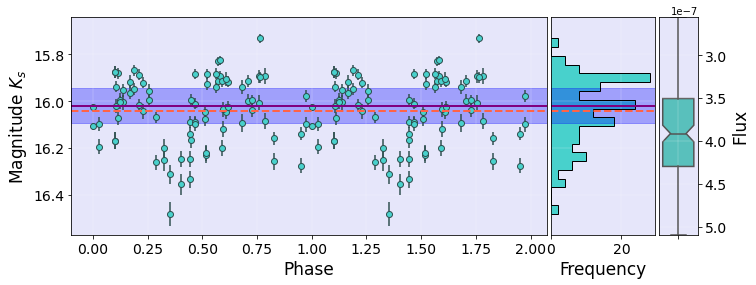

id_vvv 515882421268.0 Period_LS*2 1.1428788
1.1428788 515882421268.0


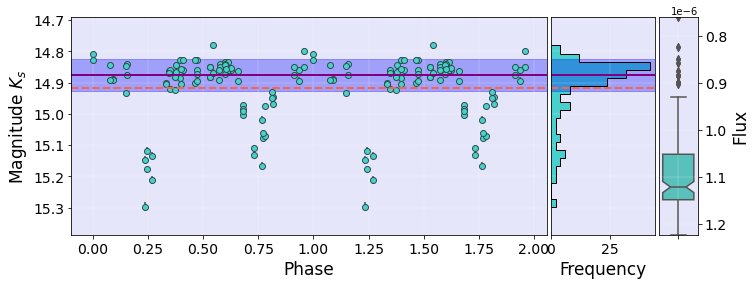

id_vvv 515882423626.0 Period_LS*2 1.0432322
1.0432322 515882423626.0


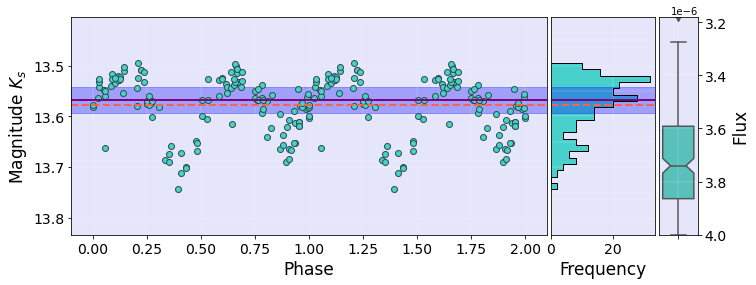

id_vvv 515882424666.0 Period_LS*2 0.5907821
0.5907821 515882424666.0


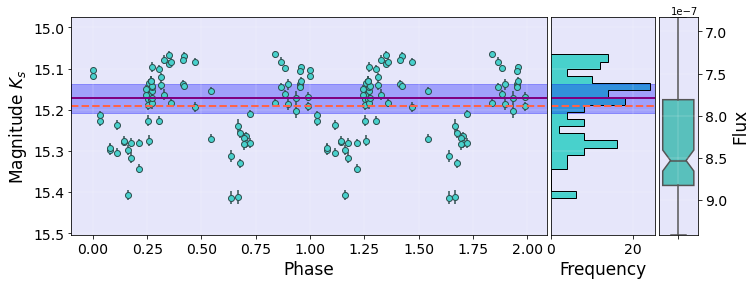

id_vvv 515882424775.0 Period_LS*2 0.65450788
0.65450788 515882424775.0


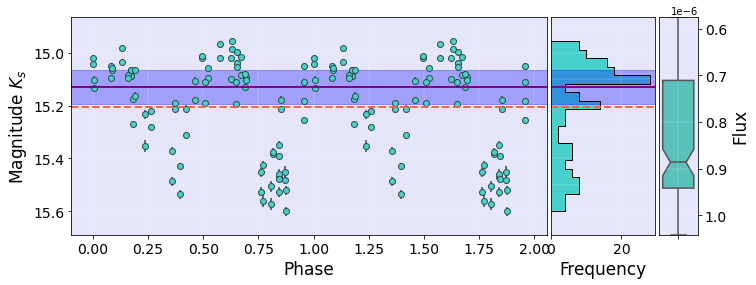

id_vvv 515882424844.0 Period_LS*2 1.2718085
1.2718085 515882424844.0


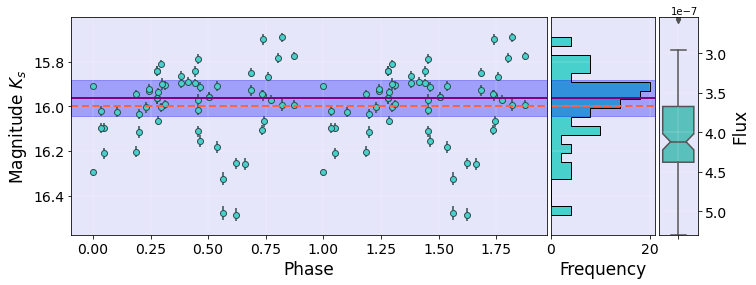

id_vvv 515882426040.0 Period_LS*2 1.88253486
1.88253486 515882426040.0


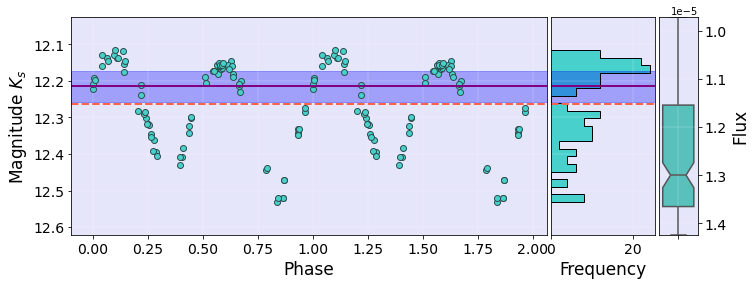

id_vvv 515882426245.0 Period_LS*2 1.0340478
1.0340478 515882426245.0


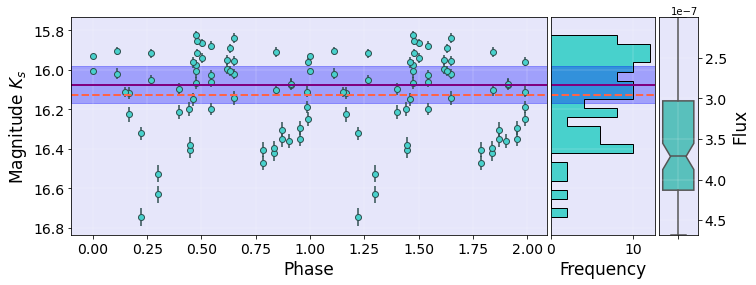

id_vvv 515882427997.0 Period_LS*2 1.1848786
1.1848786 515882427997.0


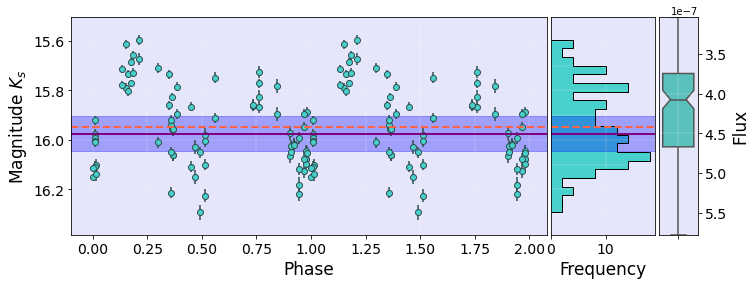

id_vvv 515882430207.0 Period_LS*2 0.58326804
0.58326804 515882430207.0


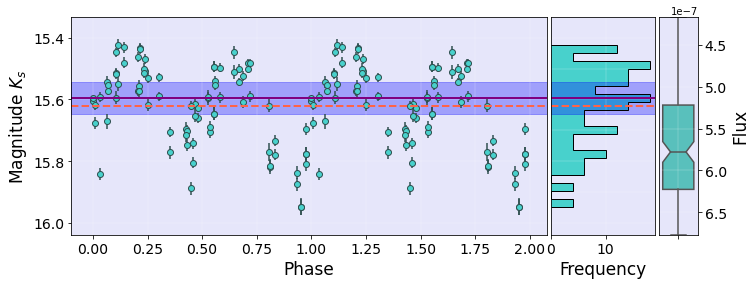

id_vvv 515882433004.0 Period_LS*2 0.5870459
0.5870459 515882433004.0


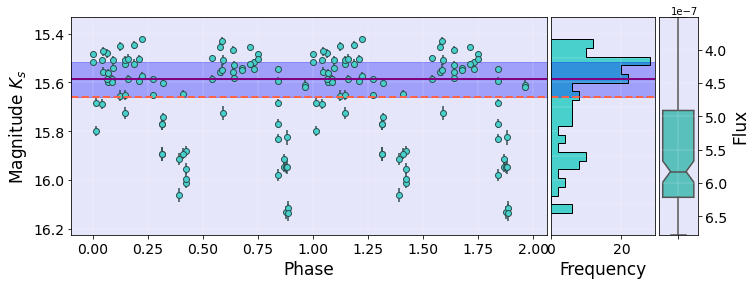

id_vvv 515882434941.0 Period_LS*2 1.8304052
1.8304052 515882434941.0


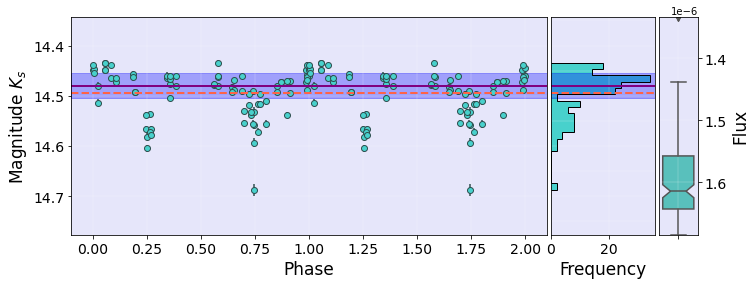

id_vvv 515882435801.0 Period_LS*2 0.87635636
0.87635636 515882435801.0


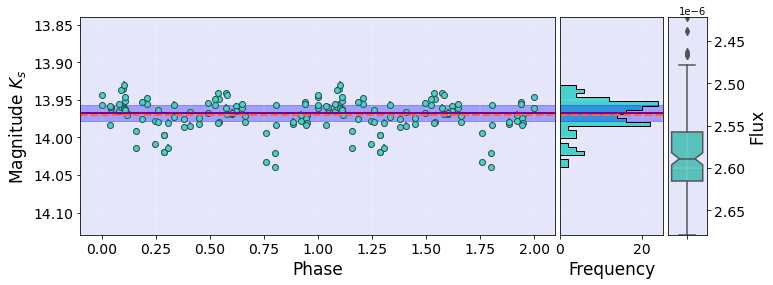

id_vvv 515882436460.0 Period_LS*2 24.207158
24.207158 515882436460.0


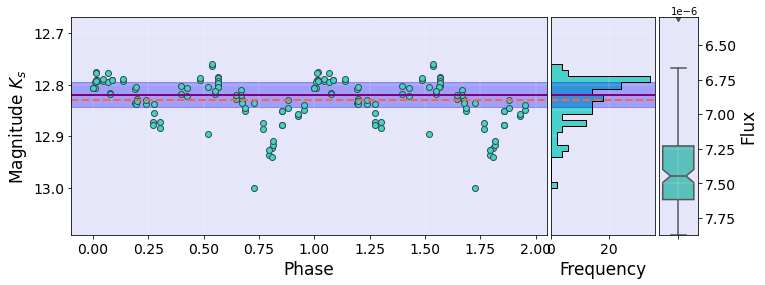

id_vvv 515882438082.0 Period_LS*2 734.2456
734.2456 515882438082.0


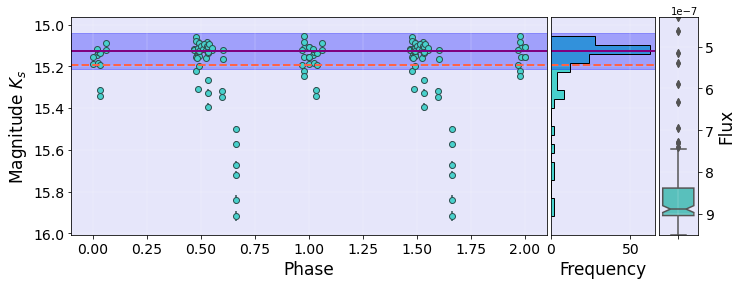

id_vvv 515882438283.0 Period_LS*2 2.9823818
2.9823818 515882438283.0


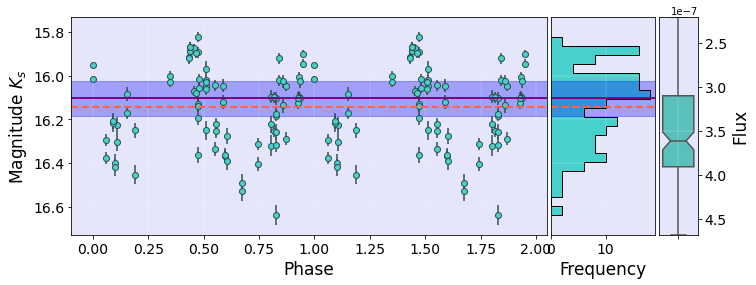

id_vvv 515882438535.0 Period_LS*2 0.9618135
0.9618135 515882438535.0


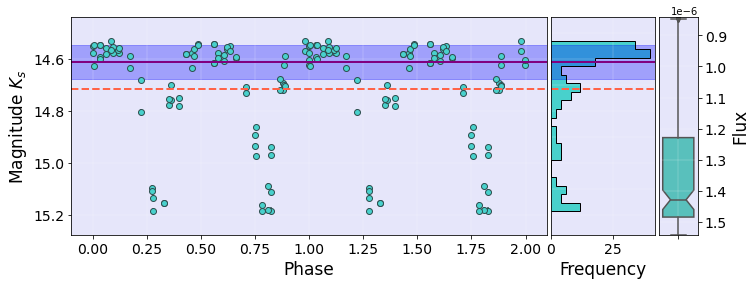

id_vvv 515882440793.0 Period_LS*2 0.88990706
0.88990706 515882440793.0


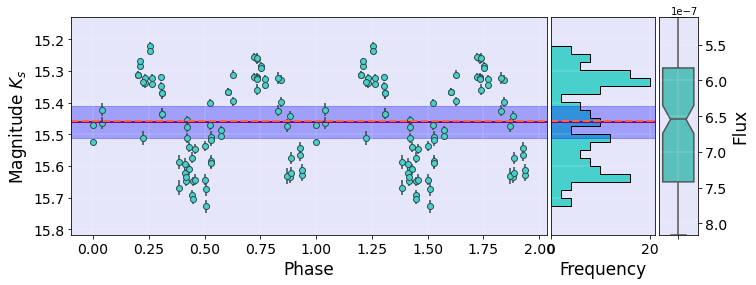

id_vvv 515882441107.0 Period_LS*2 2.0854654
2.0854654 515882441107.0


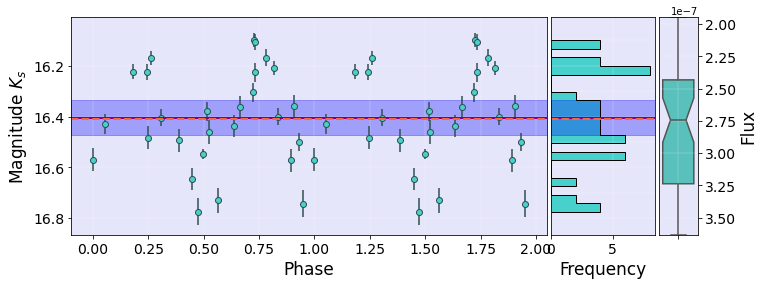

id_vvv 515882441555.0 Period_LS*2 0.64762164
0.64762164 515882441555.0


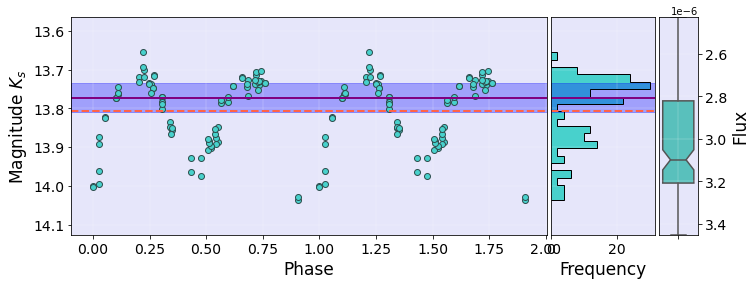

id_vvv 515882442235.0 Period_LS*2 0.94359988
0.94359988 515882442235.0


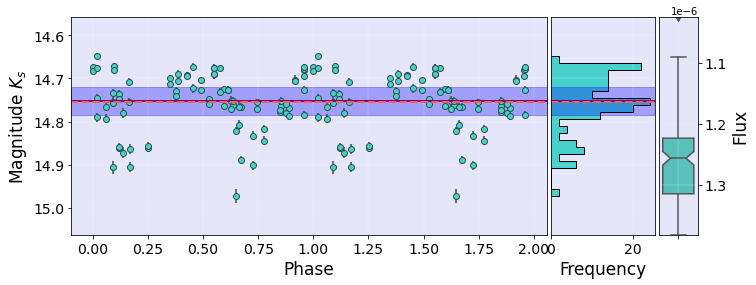

id_vvv 515882444173.0 Period_LS*2 8.0577554
8.0577554 515882444173.0


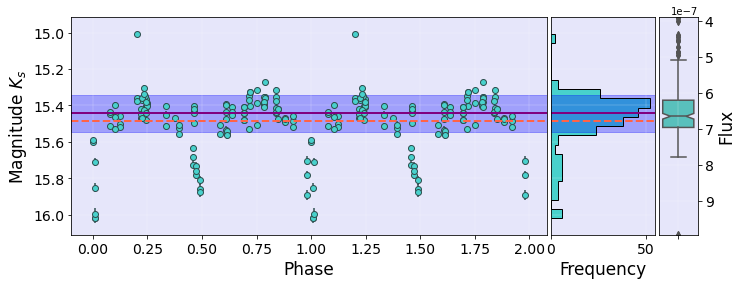

id_vvv 515882444245.0 Period_LS*2 1.05191326
1.05191326 515882444245.0


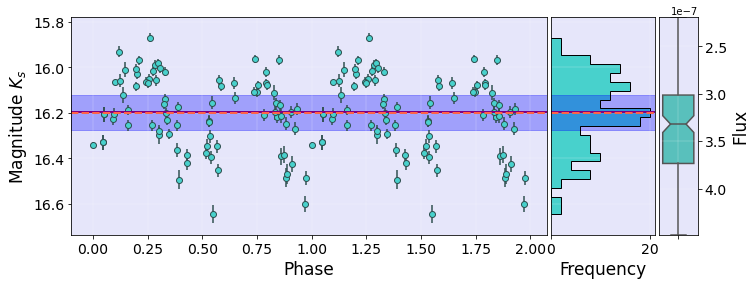

id_vvv 515882447862.0 Period_LS*2 0.57404696
0.57404696 515882447862.0


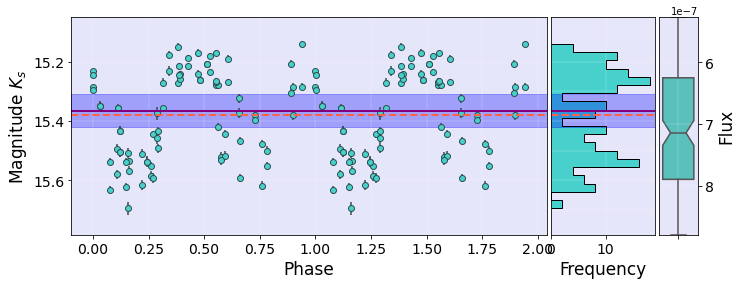

id_vvv 515882448031.0 Period_LS*2 1.40741
1.40741 515882448031.0


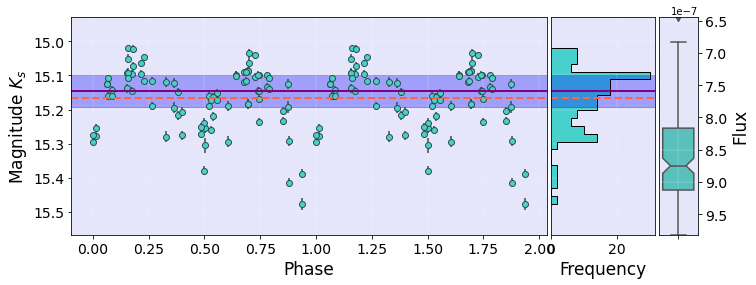

id_vvv 515882449306.0 Period_LS*2 0.82539194
0.82539194 515882449306.0


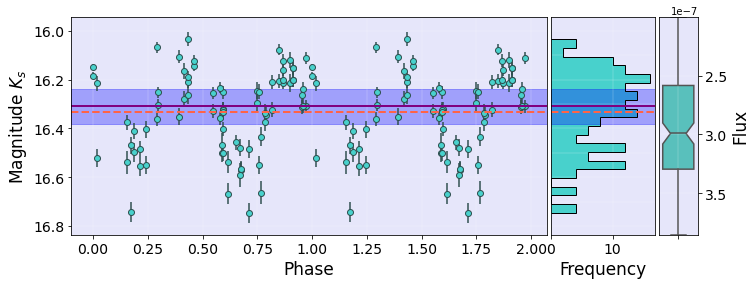

id_vvv 515882450335.0 Period_LS*2 1.73025226
1.73025226 515882450335.0


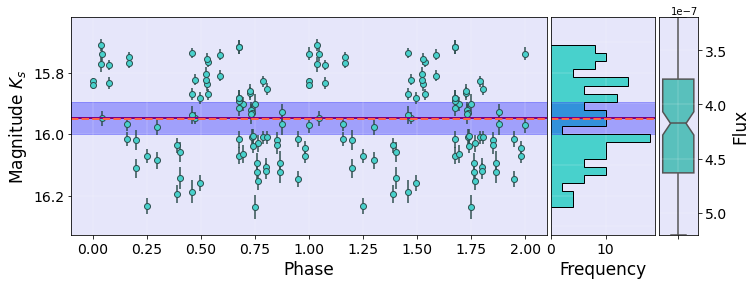

id_vvv 515882452256.0 Period_LS*2 0.60791164
0.60791164 515882452256.0


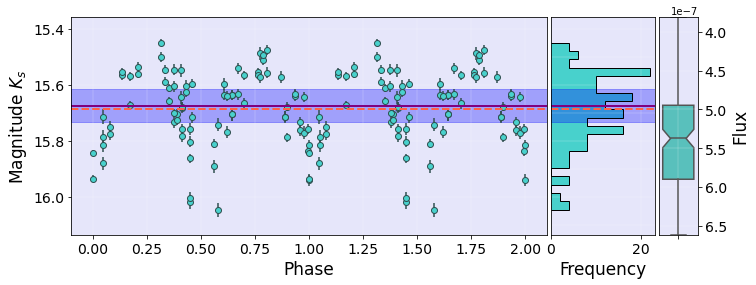

id_vvv 515882454353.0 Period_LS*2 0.8858662
0.8858662 515882454353.0


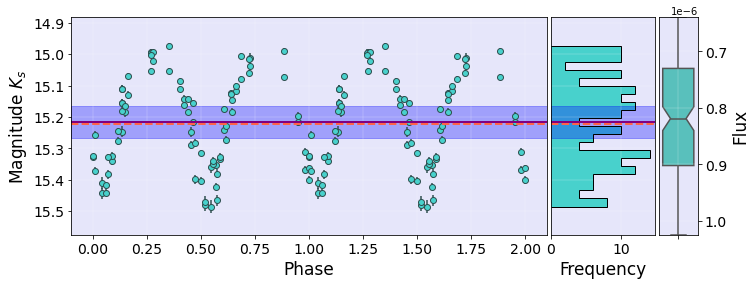

id_vvv 515882454928.0 Period_LS*2 2.3050974
2.3050974 515882454928.0


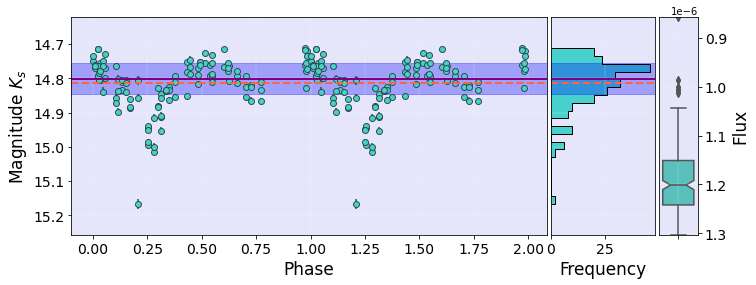

id_vvv 515882457000.0 Period_LS*2 0.92845828
0.92845828 515882457000.0


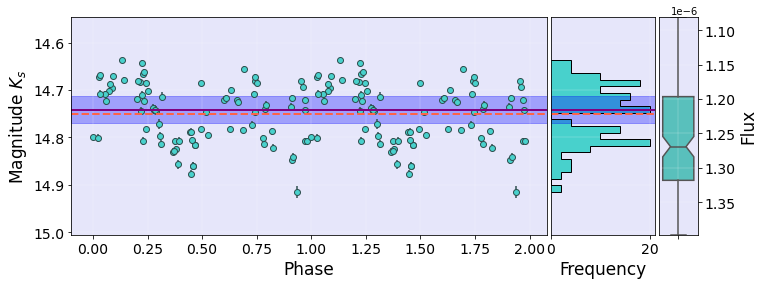

id_vvv 515882457029.0 Period_LS*2 2.9434862
2.9434862 515882457029.0


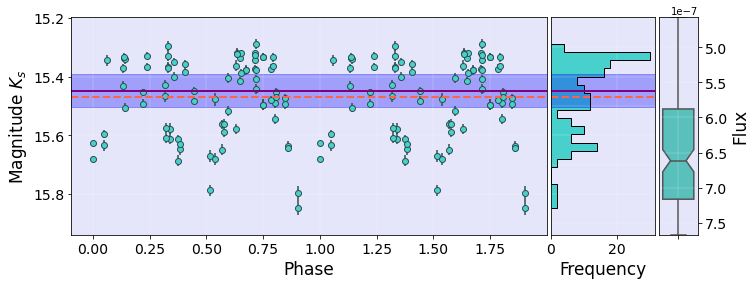

id_vvv 515882459920.0 Period_LS*2 1.61418426
1.61418426 515882459920.0


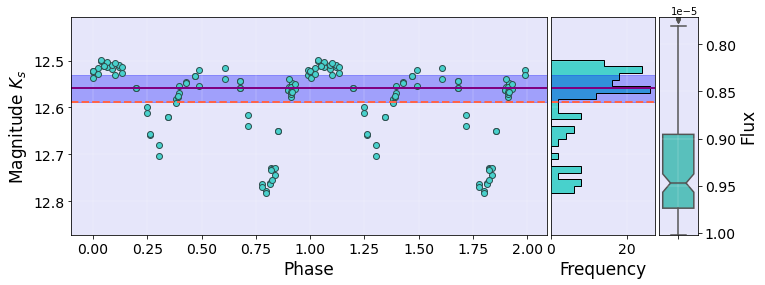

id_vvv 515882463097.0 Period_LS*2 0.65558892
0.65558892 515882463097.0


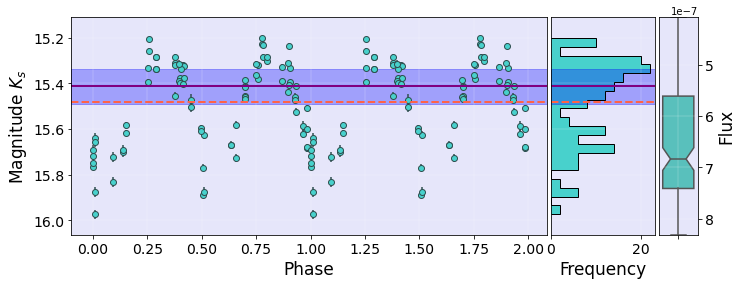

id_vvv 515882463704.0 Period_LS*2 1.07549668
1.07549668 515882463704.0


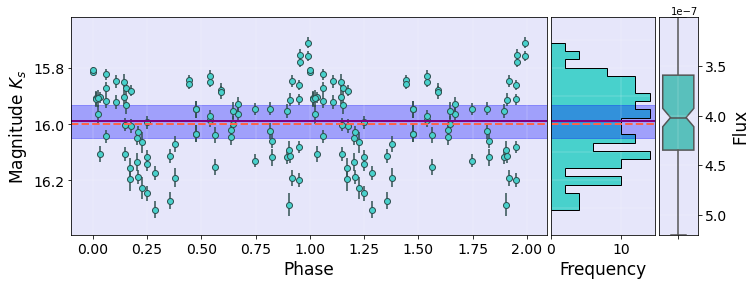

id_vvv 515882464768.0 Period_LS*2 0.7604468
0.7604468 515882464768.0


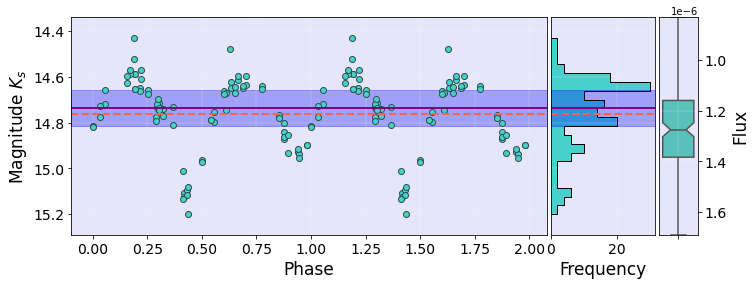

id_vvv 515882464875.0 Period_LS*2 7.282824
7.282824 515882464875.0


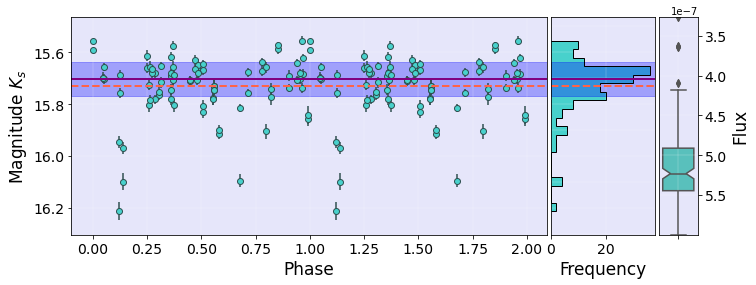

id_vvv 515882470485.0 Period_LS*2 2.7201946
2.7201946 515882470485.0


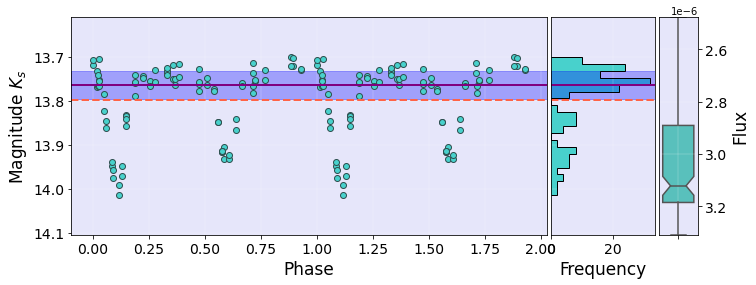

id_vvv 515882471145.0 Period_LS*2 0.56197054
0.56197054 515882471145.0


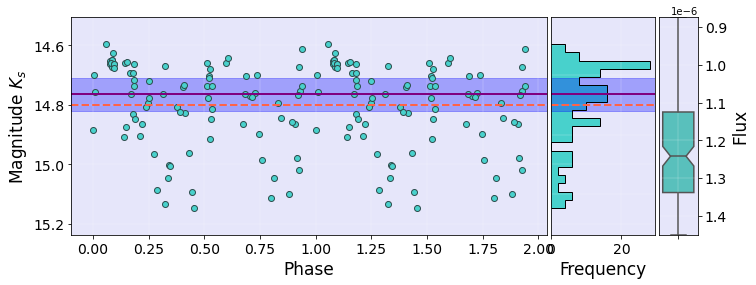

id_vvv 515882471887.0 Period_LS*2 0.97940892
0.97940892 515882471887.0


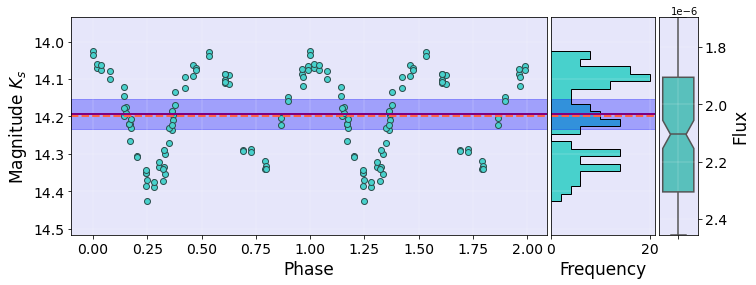

id_vvv 515882473314.0 Period_LS*2 49.50754
49.50754 515882473314.0


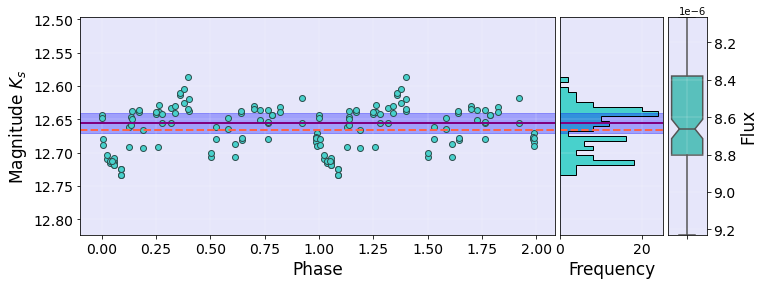

id_vvv 515882473574.0 Period_LS*2 0.65421026
0.65421026 515882473574.0


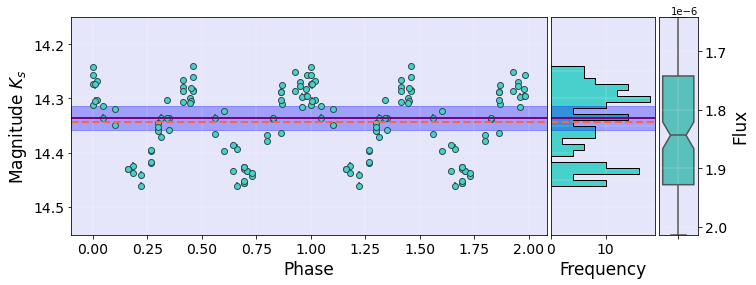

id_vvv 515882474159.0 Period_LS*2 0.9131334
0.9131334 515882474159.0


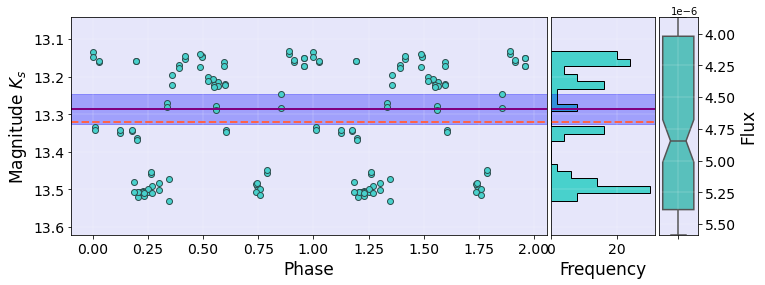

id_vvv 515882475817.0 Period_LS*2 0.68943744
0.68943744 515882475817.0


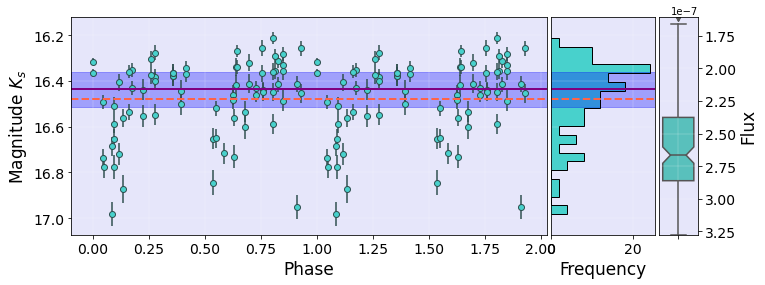

id_vvv 515882475846.0 Period_LS*2 0.6465699
0.6465699 515882475846.0


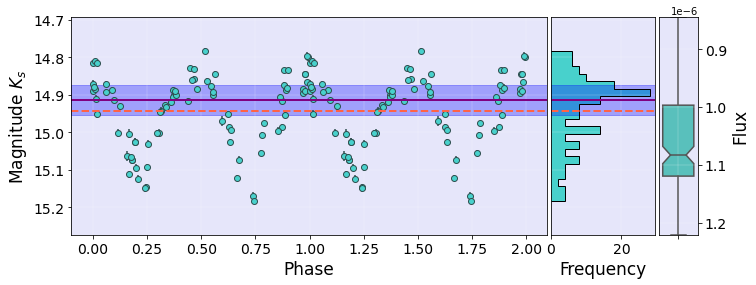

id_vvv 515882477694.0 Period_LS*2 1.409996
1.409996 515882477694.0


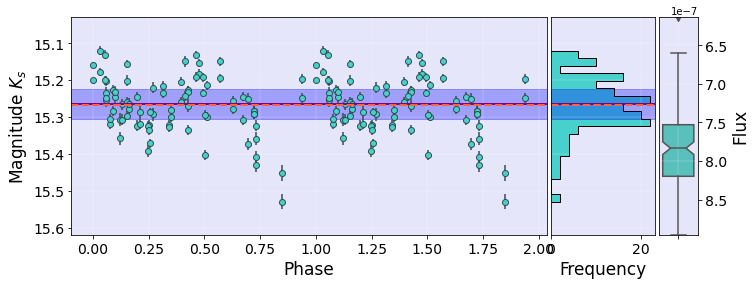

id_vvv 515882477802.0 Period_LS*2 1.89208568
1.89208568 515882477802.0


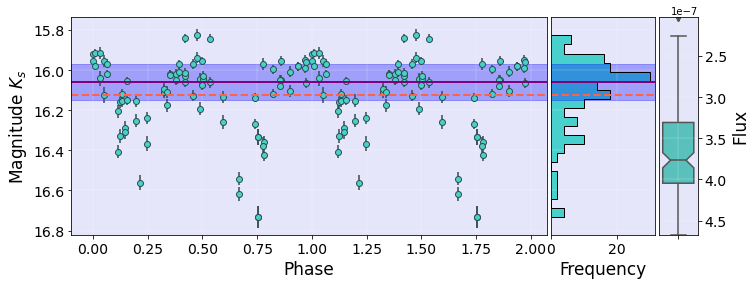

id_vvv 515882478435.0 Period_LS*2 2.396274
2.396274 515882478435.0


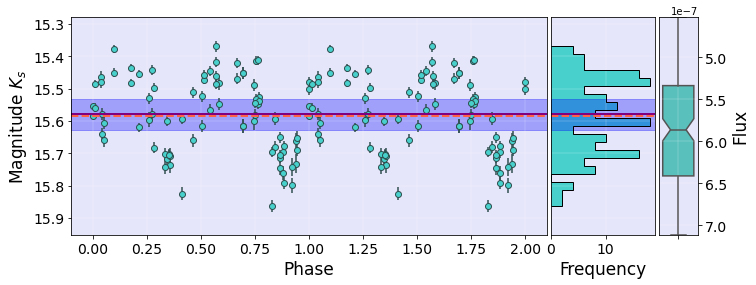

id_vvv 515882478852.0 Period_LS*2 3.9657202
3.9657202 515882478852.0


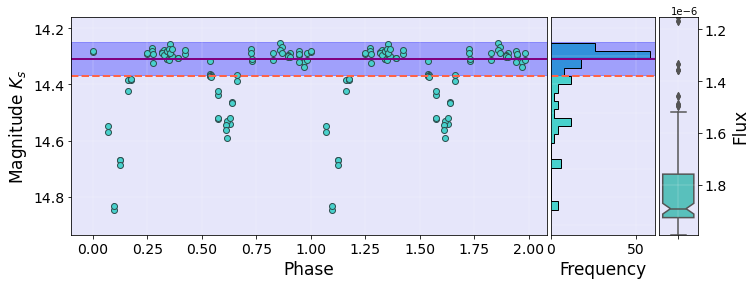

id_vvv 515882479244.0 Period_LS*2 0.9376046
0.9376046 515882479244.0


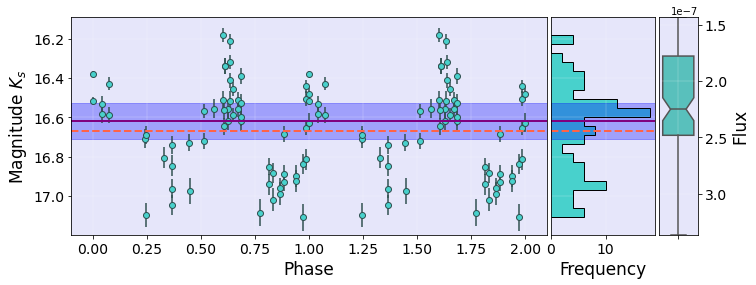

id_vvv 515882479993.0 Period_LS*2 1.70111012
1.70111012 515882479993.0


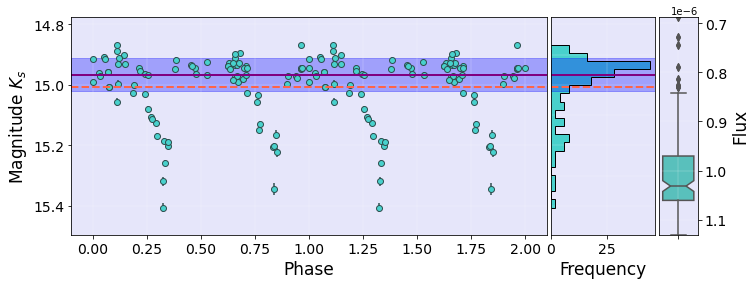

id_vvv 515882480216.0 Period_LS*2 1.09806848
1.09806848 515882480216.0


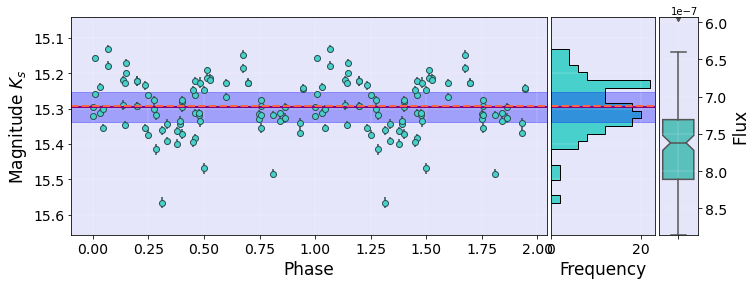

id_vvv 515882480905.0 Period_LS*2 0.6335069
0.6335069 515882480905.0


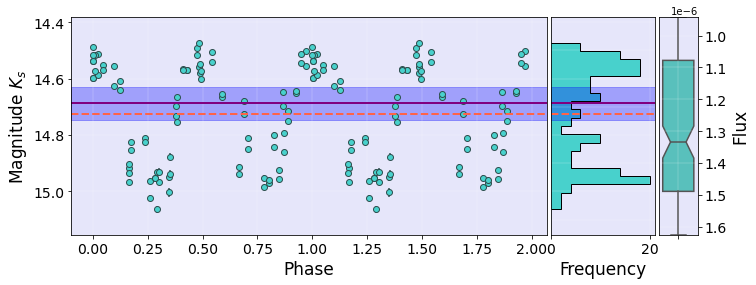

id_vvv 515882481031.0 Period_LS*2 0.8944712
0.8944712 515882481031.0


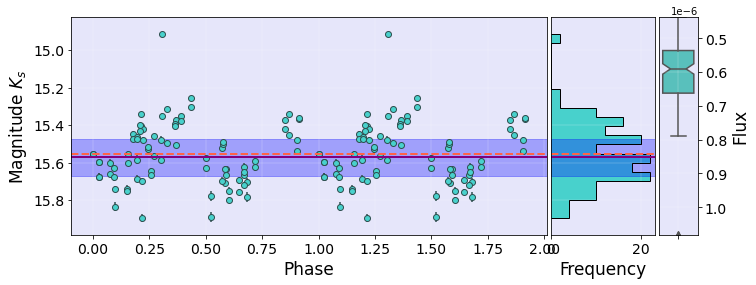

id_vvv 515882483587.0 Period_LS*2 0.7248796
0.7248796 515882483587.0


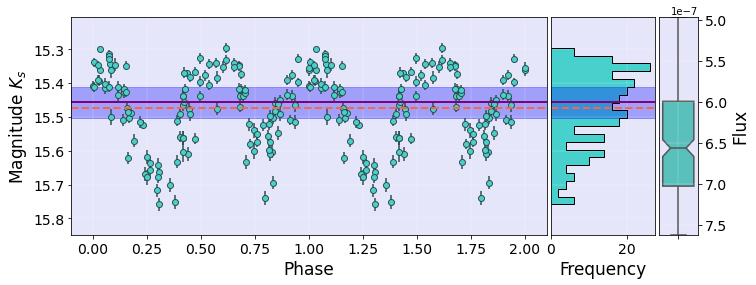

id_vvv 515882485840.0 Period_LS*2 1.9654236
1.9654236 515882485840.0


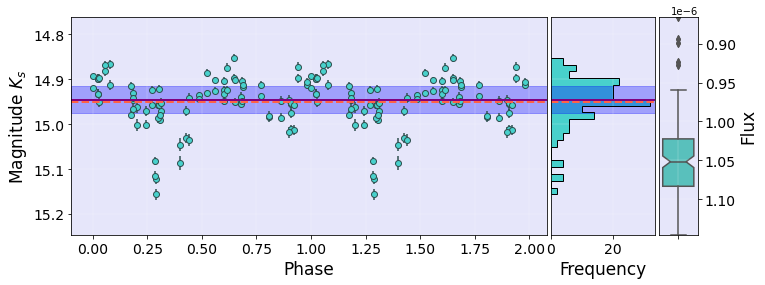

id_vvv 515882486627.0 Period_LS*2 0.56292964
0.56292964 515882486627.0


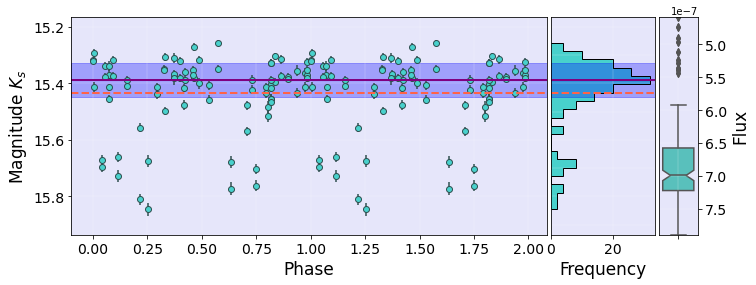

id_vvv 515882490867.0 Period_LS*2 6.2506128
6.2506128 515882490867.0


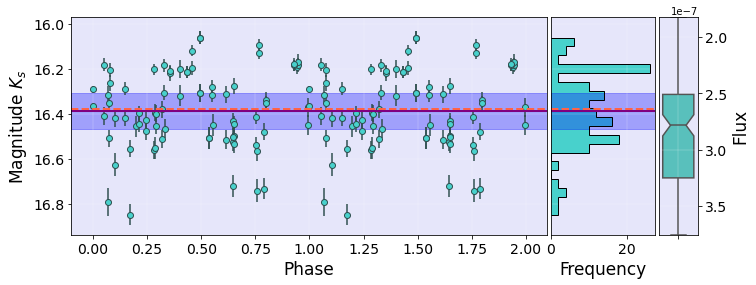

id_vvv 515882491779.0 Period_LS*2 0.4310162
0.4310162 515882491779.0


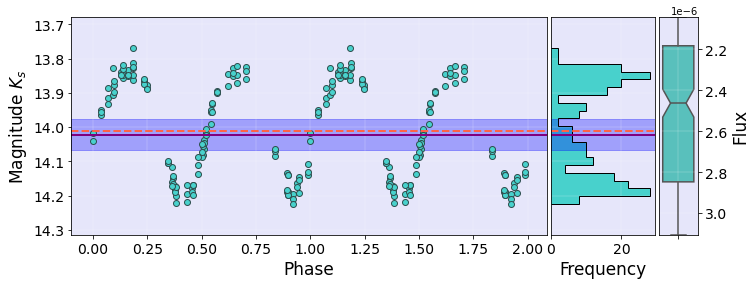

id_vvv 515882493603.0 Period_LS*2 0.74015384
0.74015384 515882493603.0


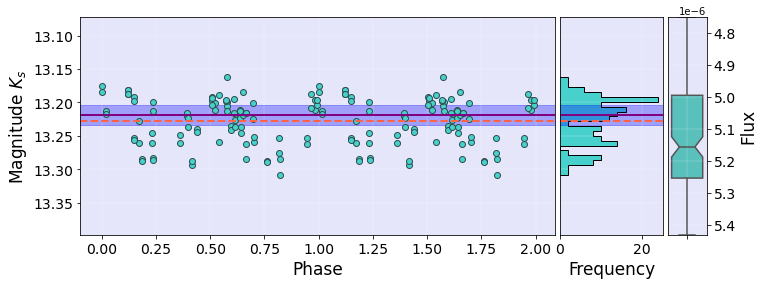

id_vvv 515882494361.0 Period_LS*2 0.62589396
0.62589396 515882494361.0


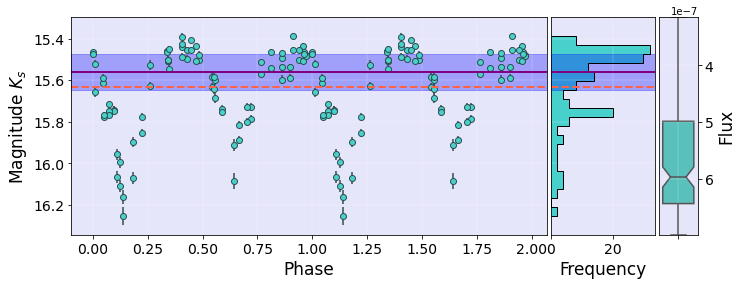

id_vvv 515882495192.0 Period_LS*2 0.56773592
0.56773592 515882495192.0


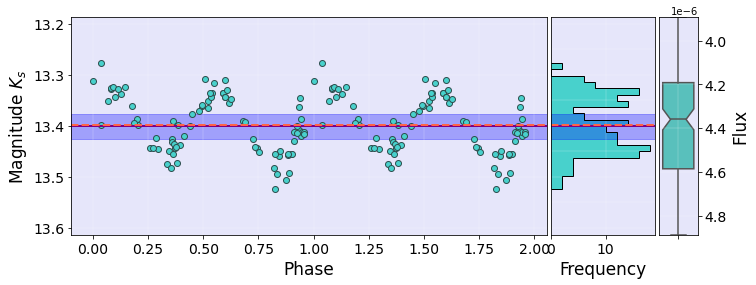

id_vvv 515882495374.0 Period_LS*2 1.45545972
1.45545972 515882495374.0


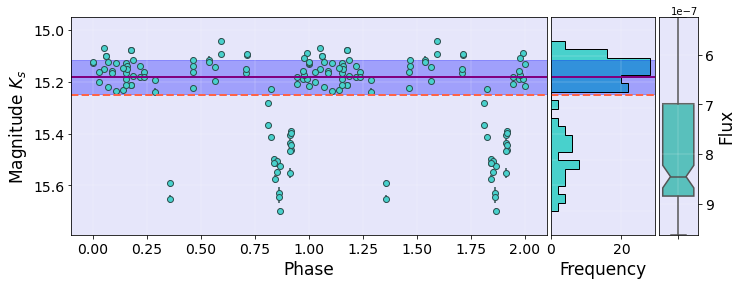

id_vvv 515882495604.0 Period_LS*2 0.68151826
0.68151826 515882495604.0


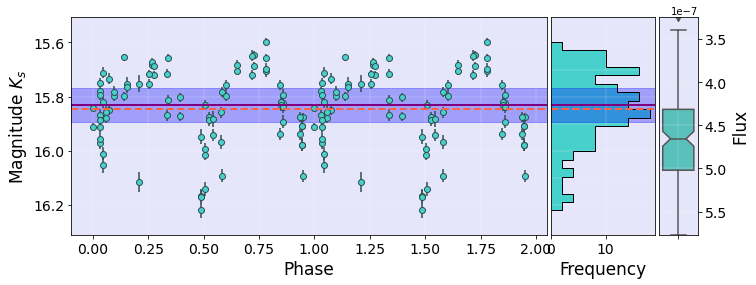

id_vvv 515882495989.0 Period_LS*2 0.71081006
0.71081006 515882495989.0


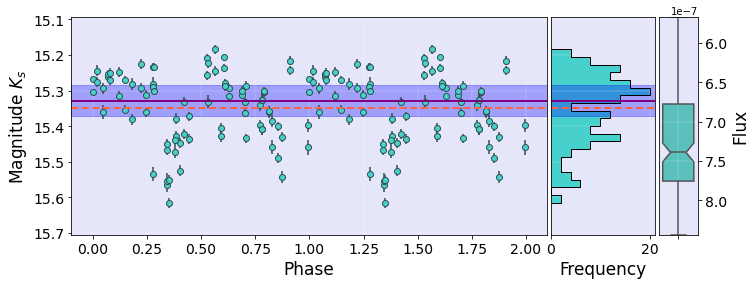

id_vvv 515882497967.0 Period_LS*2 0.6929238
0.6929238 515882497967.0


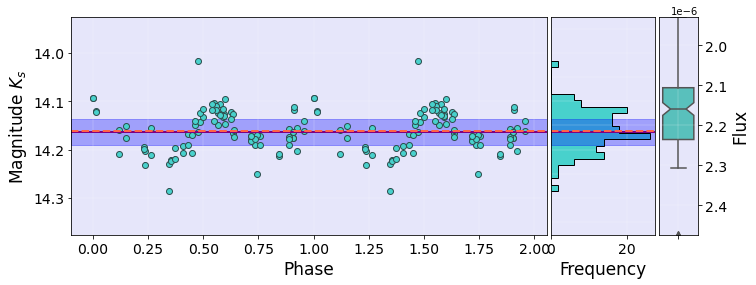

id_vvv 515882500338.0 Period_LS*2 0.5979327
0.5979327 515882500338.0


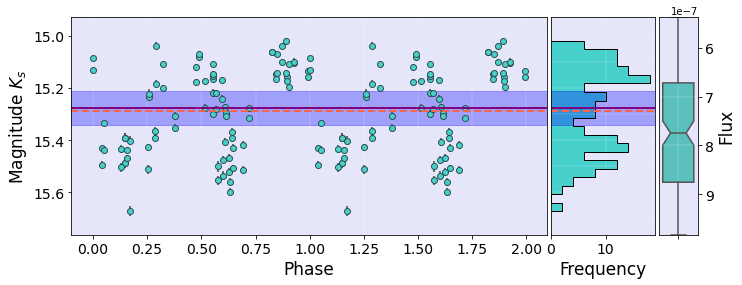

id_vvv 515882502678.0 Period_LS*2 1.0272243
1.0272243 515882502678.0


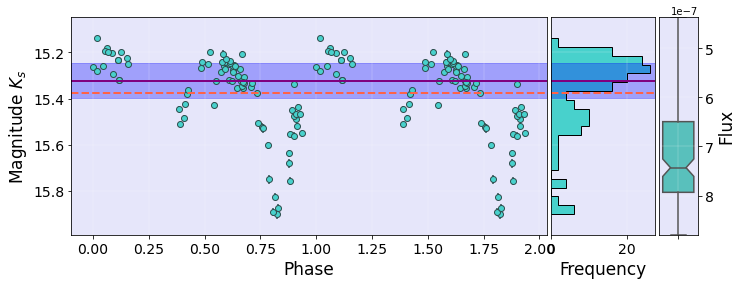

id_vvv 515882504499.0 Period_LS*2 1.0339548
1.0339548 515882504499.0


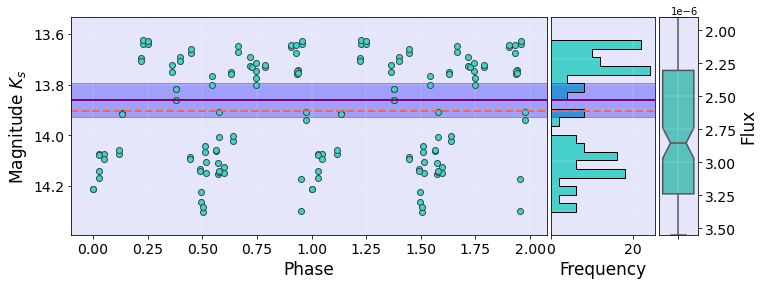

id_vvv 515882504885.0 Period_LS*2 0.78572666
0.78572666 515882504885.0


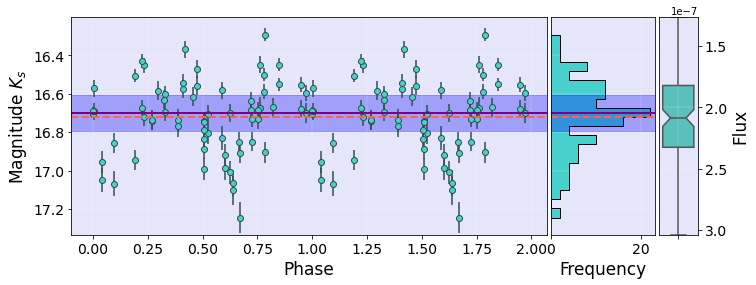

id_vvv 515882505050.0 Period_LS*2 4.035032
4.035032 515882505050.0


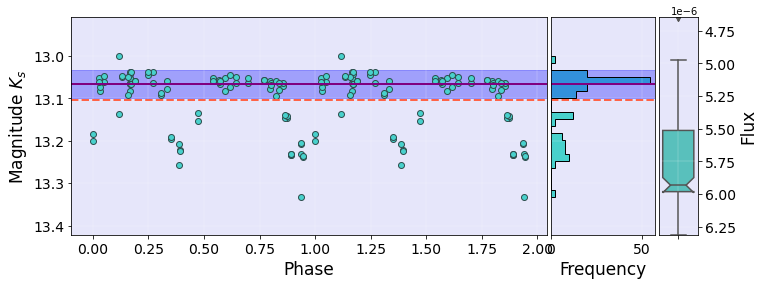

id_vvv 515882505691.0 Period_LS*2 1.26690912
1.26690912 515882505691.0


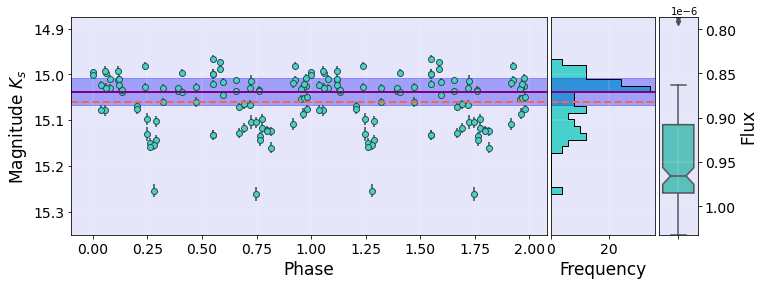

id_vvv 515882505780.0 Period_LS*2 0.8576806
0.8576806 515882505780.0


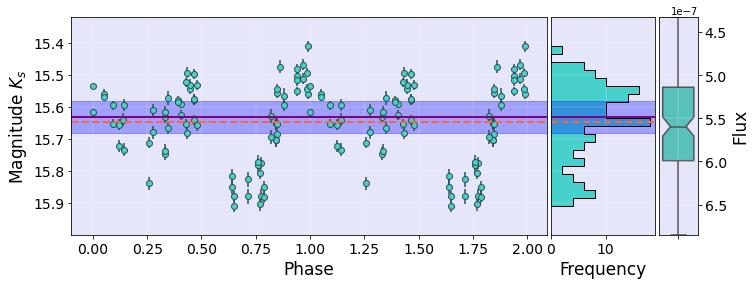

id_vvv 515882506697.0 Period_LS*2 0.56527948
0.56527948 515882506697.0


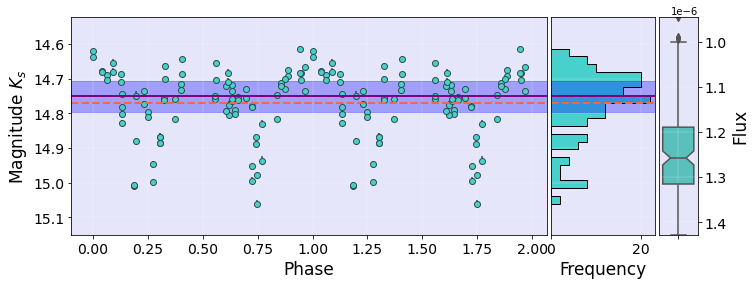

id_vvv 515882507875.0 Period_LS*2 0.99584746
0.99584746 515882507875.0


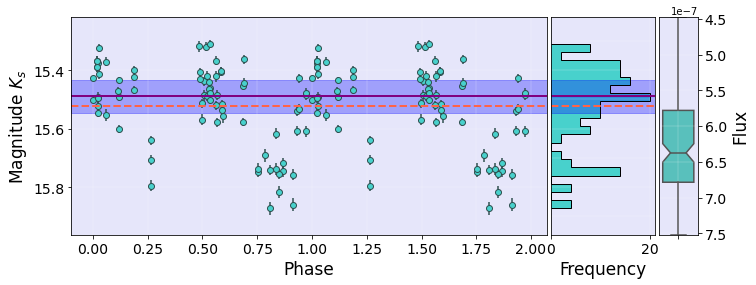

id_vvv 515882508962.0 Period_LS*2 0.87502396
0.87502396 515882508962.0


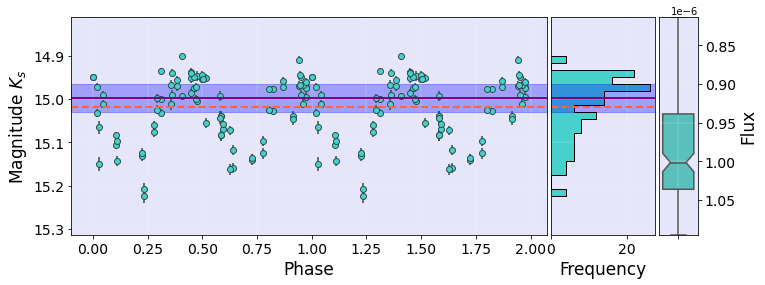

id_vvv 515882509748.0 Period_LS*2 8.0073472
8.0073472 515882509748.0


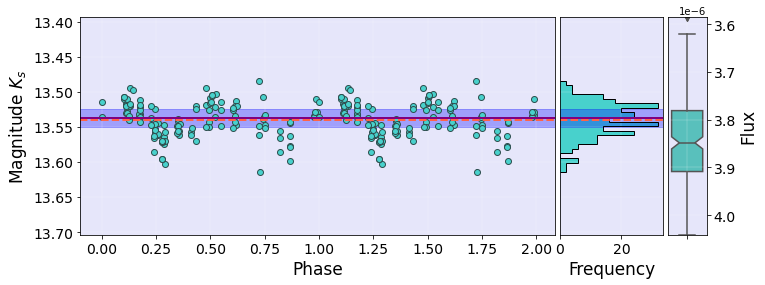

id_vvv 515882510225.0 Period_LS*2 0.68248808
0.68248808 515882510225.0


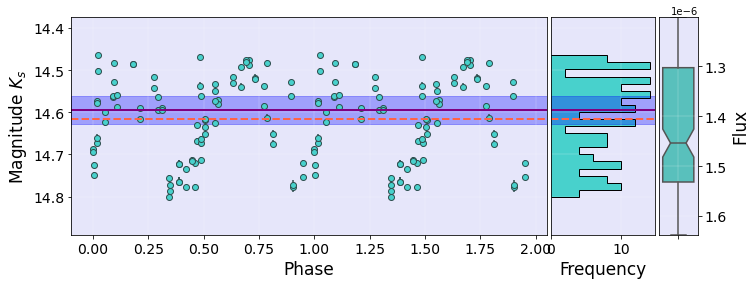

id_vvv 515882510567.0 Period_LS*2 4.3841186
4.3841186 515882510567.0


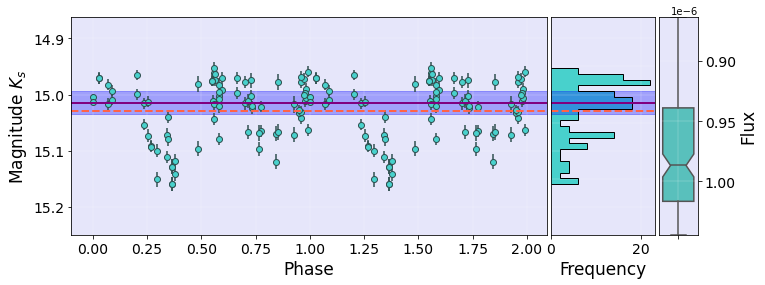

id_vvv 515882512632.0 Period_LS*2 2.834052
2.834052 515882512632.0


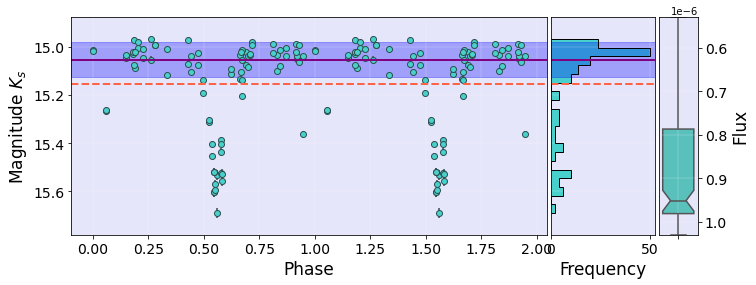

id_vvv 515882514087.0 Period_LS*2 0.97949224
0.97949224 515882514087.0


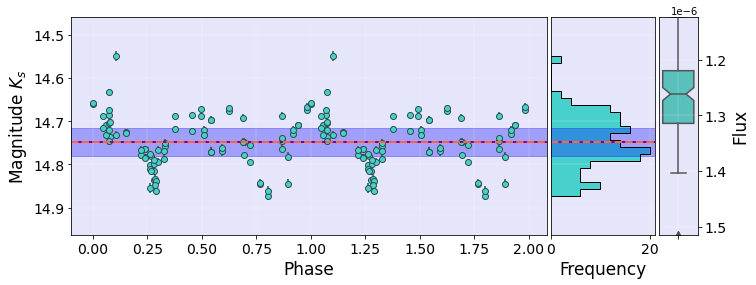

id_vvv 515882517099.0 Period_LS*2 6.792861
6.792861 515882517099.0


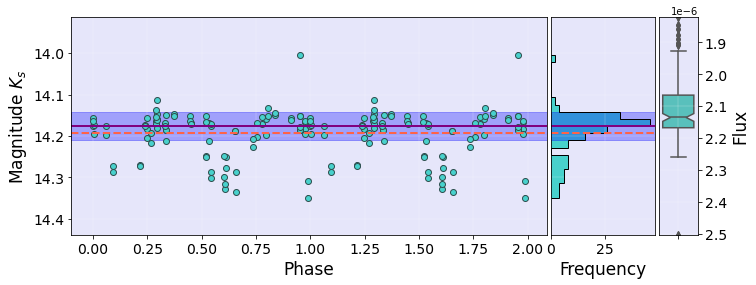

id_vvv 515882517741.0 Period_LS*2 6.8049088
6.8049088 515882517741.0


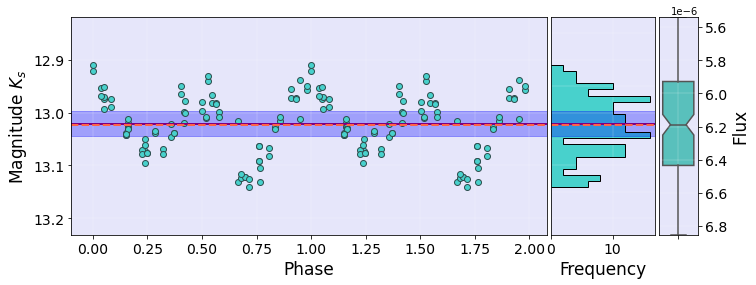

id_vvv 515882519450.0 Period_LS*2 0.7258712
0.7258712 515882519450.0


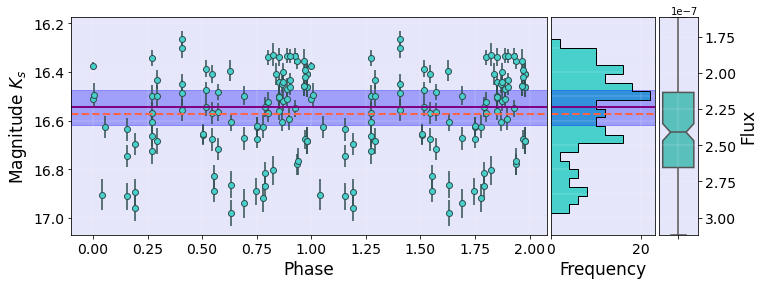

id_vvv 515882520255.0 Period_LS*2 1.7577312
1.7577312 515882520255.0


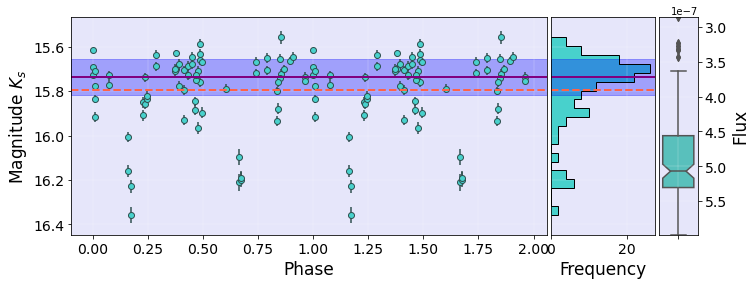

id_vvv 515882521709.0 Period_LS*2 0.34296748
0.34296748 515882521709.0


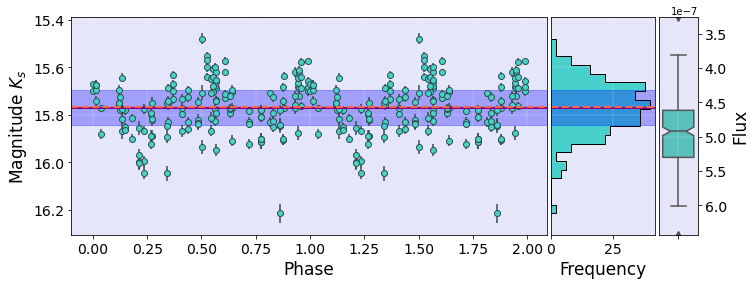

id_vvv 515882522861.0 Period_LS*2 4.7242876
4.7242876 515882522861.0


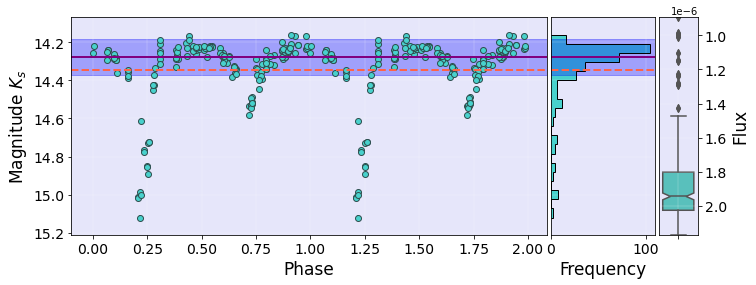

id_vvv 515882523721.0 Period_LS*2 1.525075
1.525075 515882523721.0


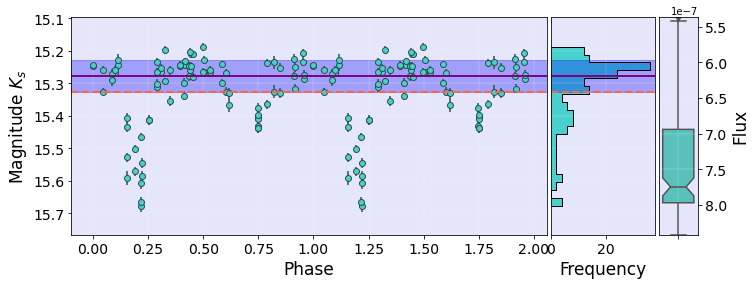

id_vvv 515882526258.0 Period_LS*2 9.0741052
9.0741052 515882526258.0


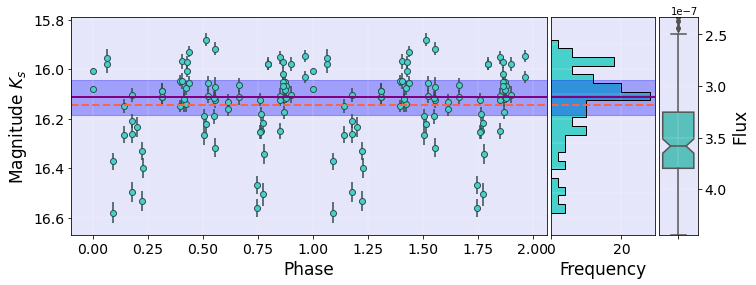

id_vvv 515882529111.0 Period_LS*2 1.72274232
1.72274232 515882529111.0


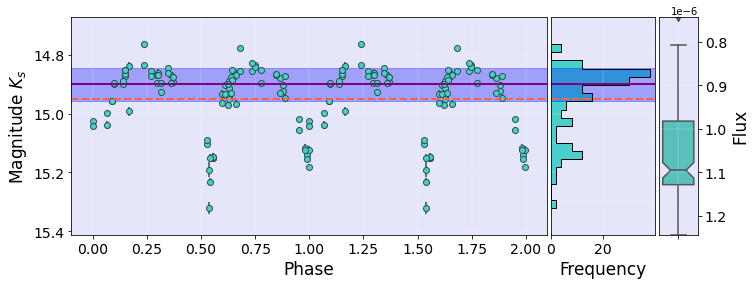

id_vvv 515882529162.0 Period_LS*2 0.47223786
0.47223786 515882529162.0


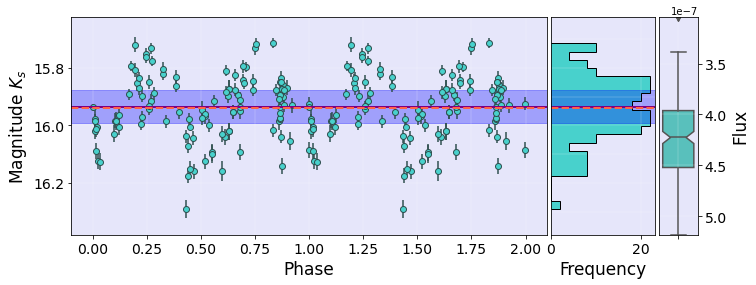

id_vvv 515882534494.0 Period_LS*2 2.8902708
2.8902708 515882534494.0


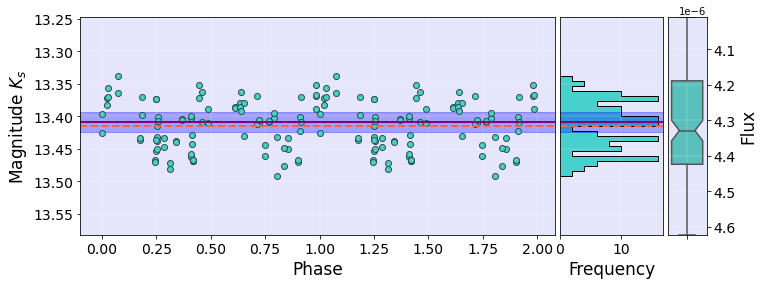

id_vvv 515882535491.0 Period_LS*2 1.0552833
1.0552833 515882535491.0


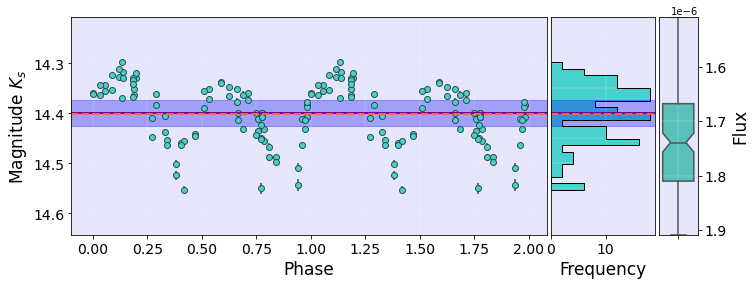

id_vvv 515882536023.0 Period_LS*2 1.26690912
1.26690912 515882536023.0


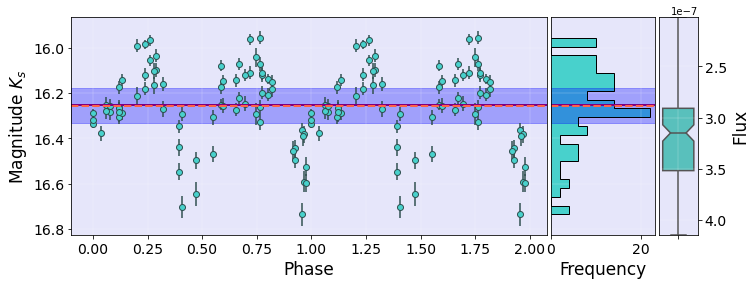

id_vvv 515882537459.0 Period_LS*2 0.5743907
0.5743907 515882537459.0


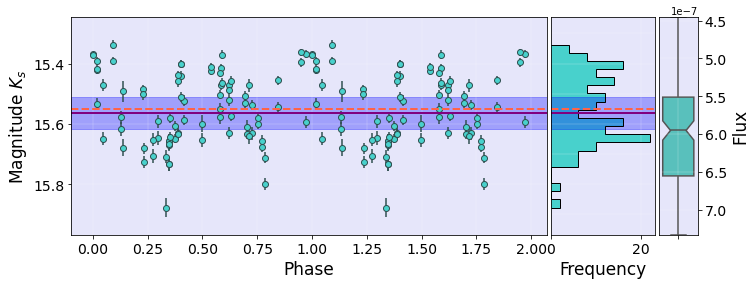

id_vvv 515882540159.0 Period_LS*2 1.22863888
1.22863888 515882540159.0


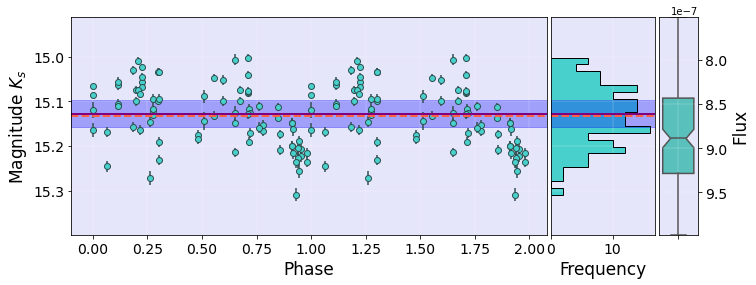

id_vvv 515882540479.0 Period_LS*2 1.6646906
1.6646906 515882540479.0


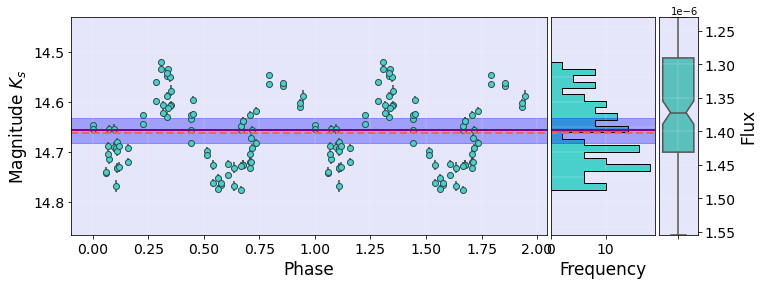

id_vvv 515882541983.0 Period_LS*2 0.636203
0.636203 515882541983.0


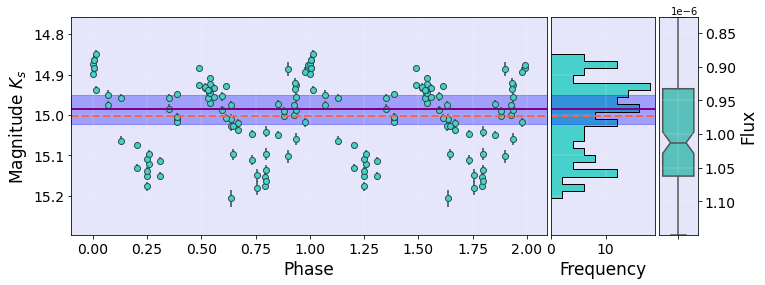

id_vvv 515882542394.0 Period_LS*2 4.971066
4.971066 515882542394.0


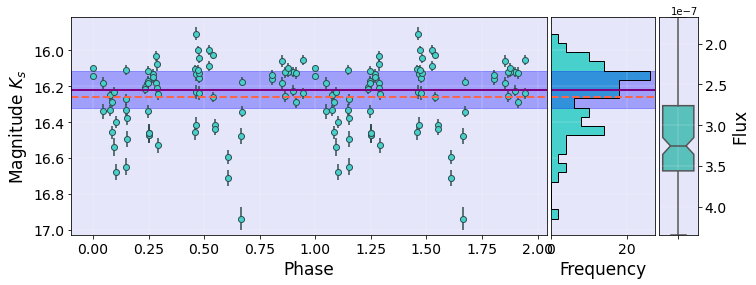

id_vvv 515882542557.0 Period_LS*2 0.8736956
0.8736956 515882542557.0


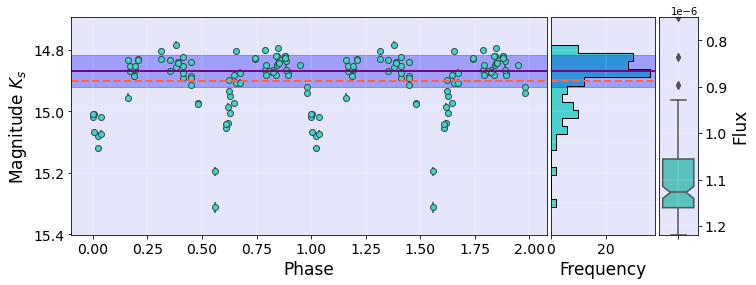

id_vvv 515882542581.0 Period_LS*2 0.7491135
0.7491135 515882542581.0


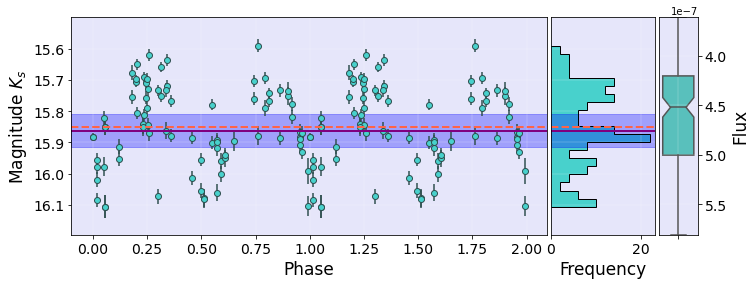

id_vvv 515882543254.0 Period_LS*2 0.79737472
0.79737472 515882543254.0


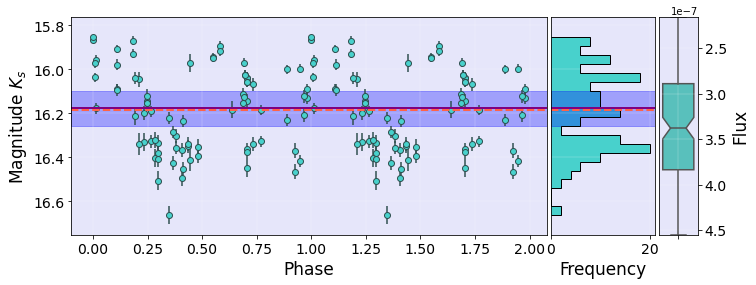

id_vvv 515882543837.0 Period_LS*2 0.9305552
0.9305552 515882543837.0


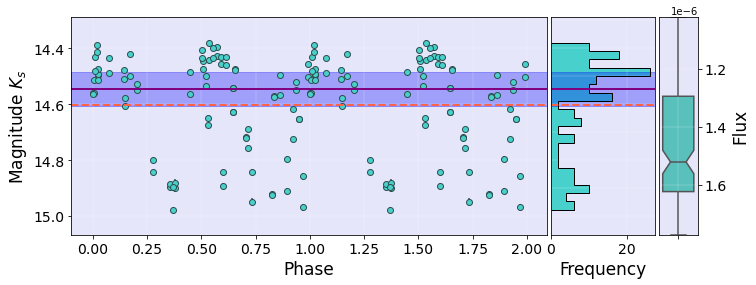

id_vvv 515882545246.0 Period_LS*2 0.6475852
0.6475852 515882545246.0


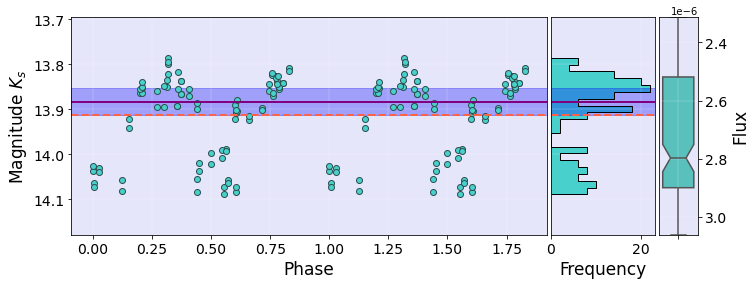

id_vvv 515882546252.0 Period_LS*2 0.60042792
0.60042792 515882546252.0


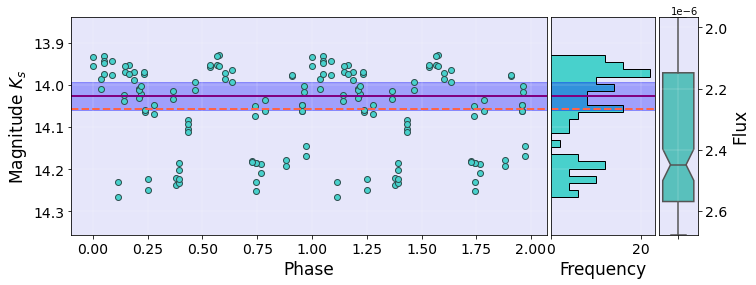

id_vvv 515882547939.0 Period_LS*2 11.50475
11.50475 515882547939.0


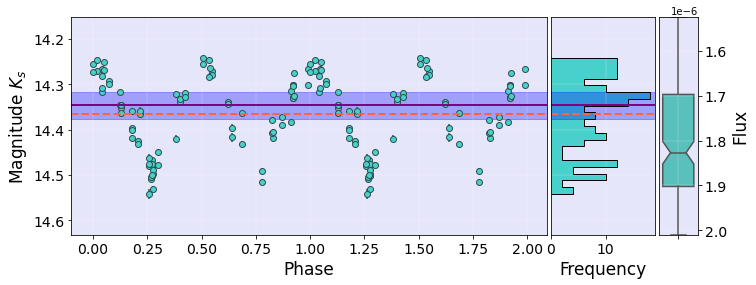

id_vvv 515882547945.0 Period_LS*2 4.554106
4.554106 515882547945.0


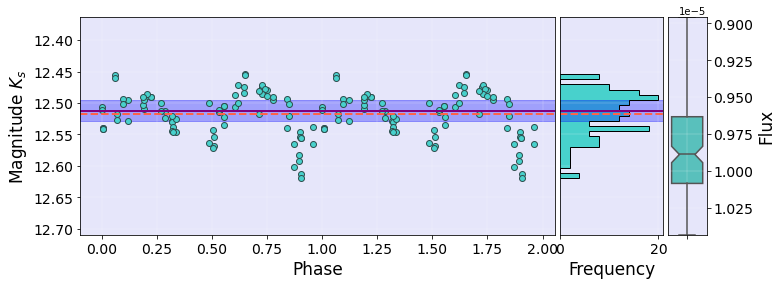

id_vvv 515882548242.0 Period_LS*2 0.7999794
0.7999794 515882548242.0


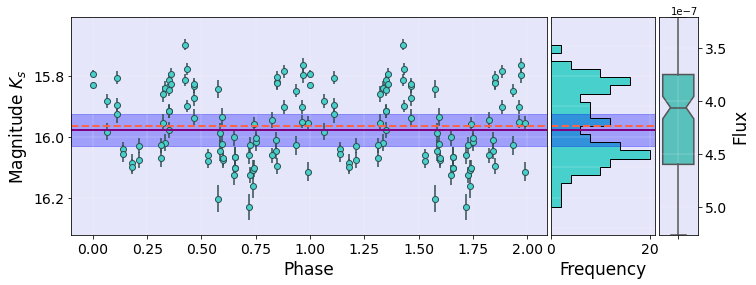

id_vvv 515882549160.0 Period_LS*2 0.68700964
0.68700964 515882549160.0


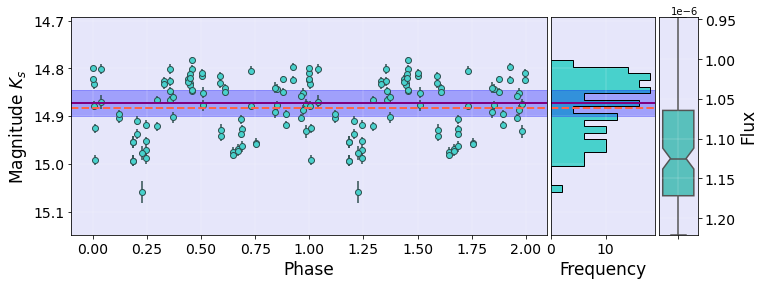

id_vvv 515882550927.0 Period_LS*2 0.6695072
0.6695072 515882550927.0


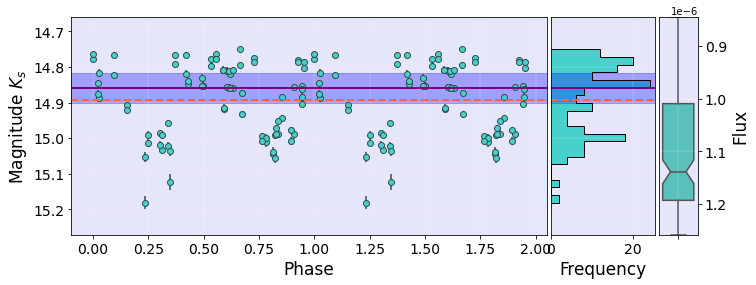

id_vvv 515882551982.0 Period_LS*2 0.7433084
0.7433084 515882551982.0


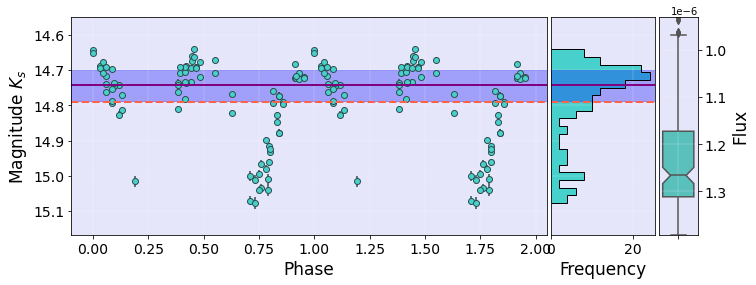

id_vvv 515882553720.0 Period_LS*2 16.597696
16.597696 515882553720.0


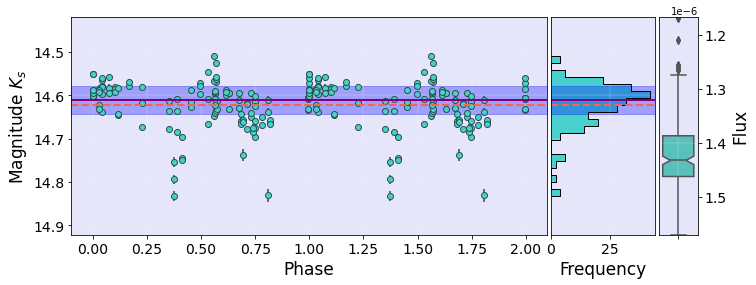

id_vvv 515882556788.0 Period_LS*2 3.938581
3.938581 515882556788.0


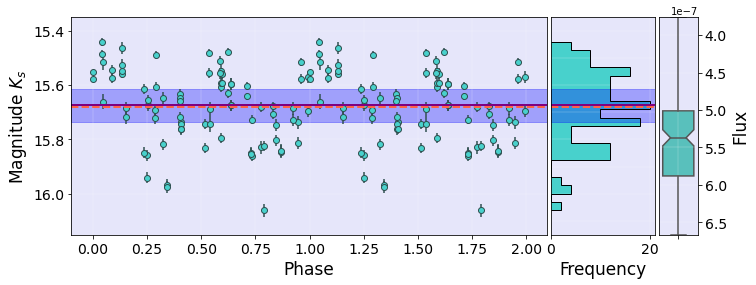

id_vvv 515882558661.0 Period_LS*2 0.6278892
0.6278892 515882558661.0


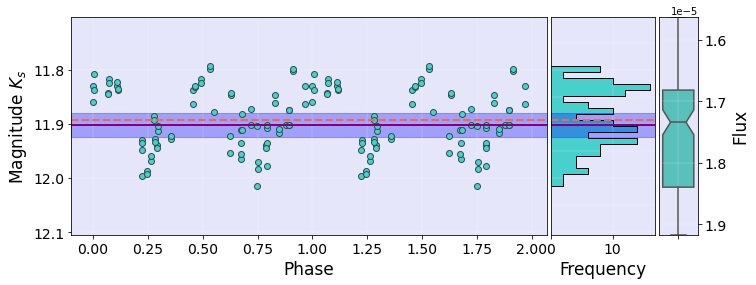

id_vvv 515882561692.0 Period_LS*2 0.66652208
0.66652208 515882561692.0


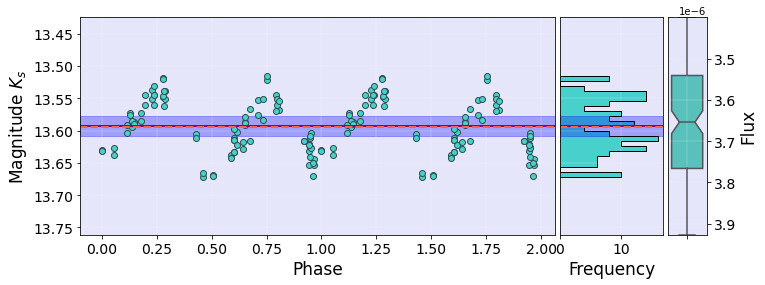

id_vvv 515882562288.0 Period_LS*2 2.3274818
2.3274818 515882562288.0


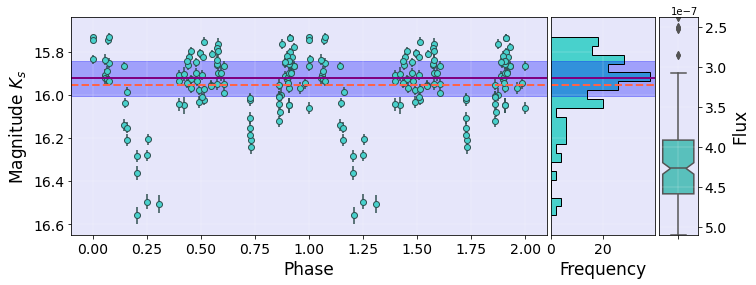

id_vvv 515882562988.0 Period_LS*2 0.61117172
0.61117172 515882562988.0


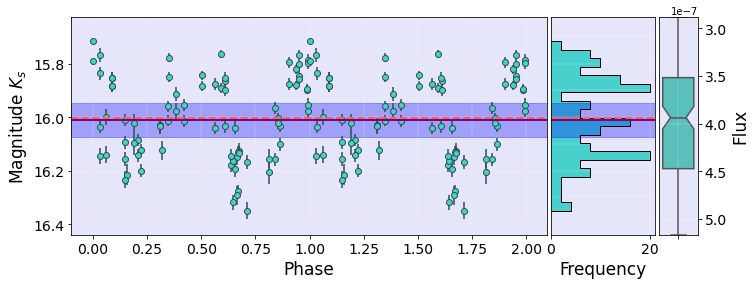

id_vvv 515882563456.0 Period_LS*2 4.0694724
4.0694724 515882563456.0


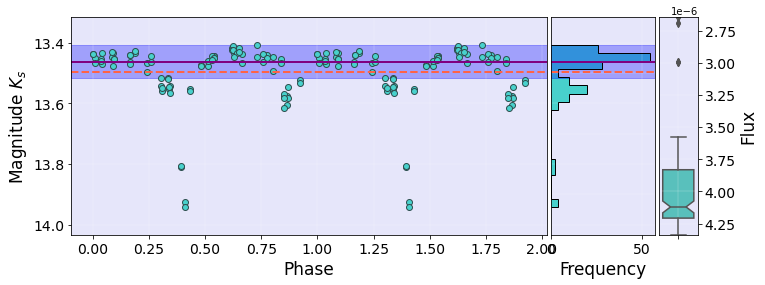

id_vvv 515882564264.0 Period_LS*2 1.3200876
1.3200876 515882564264.0


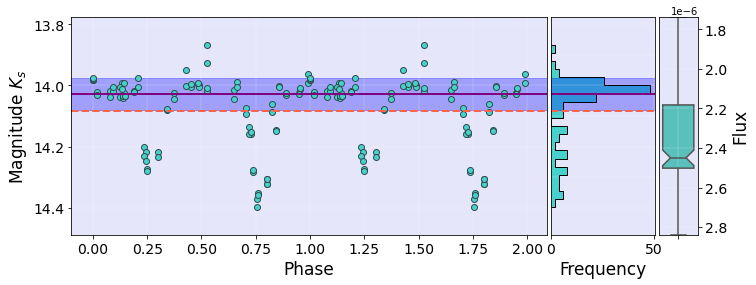

id_vvv 515882564451.0 Period_LS*2 0.8941933
0.8941933 515882564451.0


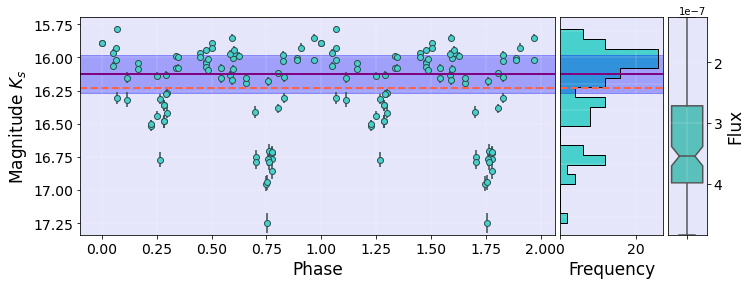

id_vvv 515882564803.0 Period_LS*2 1.0556705
1.0556705 515882564803.0


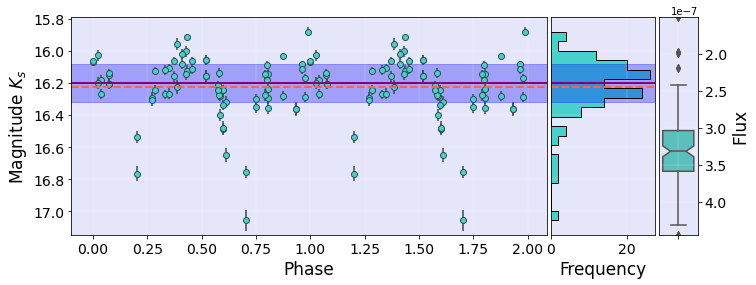

id_vvv 515882565269.0 Period_LS*2 0.6394934
0.6394934 515882565269.0


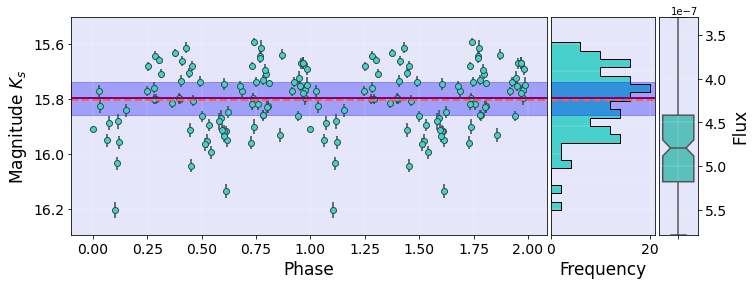

id_vvv 515882565983.0 Period_LS*2 1.808832
1.808832 515882565983.0


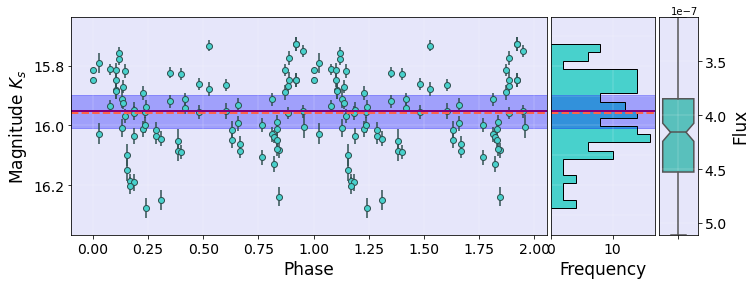

id_vvv 515882566382.0 Period_LS*2 1.21425212
1.21425212 515882566382.0


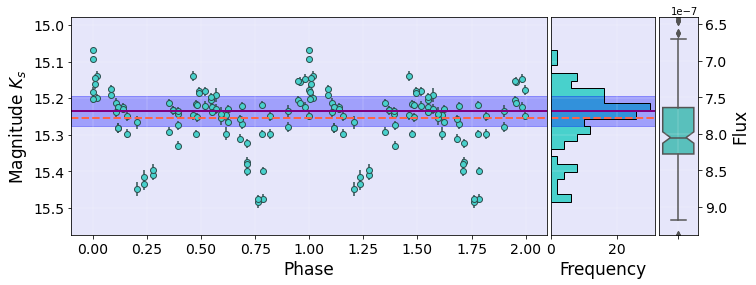

id_vvv 515882566648.0 Period_LS*2 9.0172368
9.0172368 515882566648.0


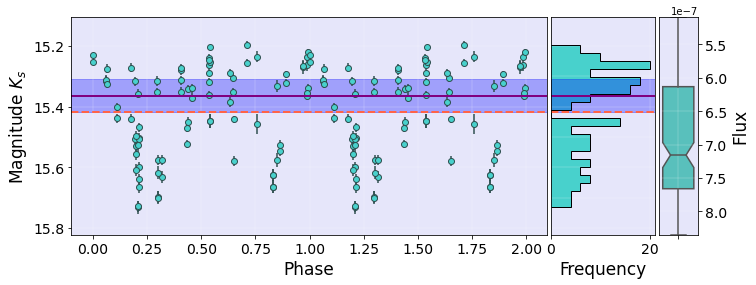

id_vvv 515882567116.0 Period_LS*2 2.2296374
2.2296374 515882567116.0


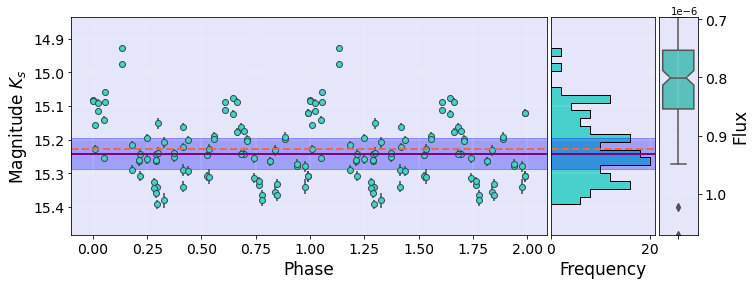

id_vvv 515882568509.0 Period_LS*2 1.607051
1.607051 515882568509.0


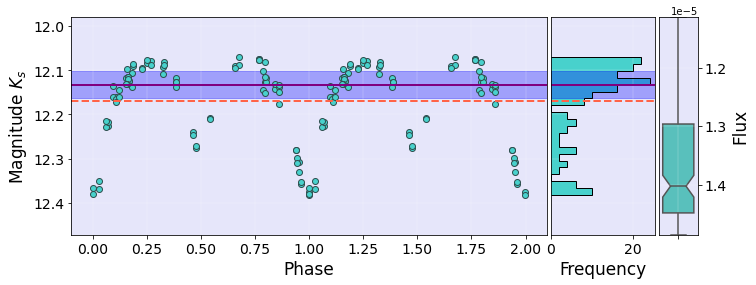

id_vvv 515882569588.0 Period_LS*2 0.58229434
0.58229434 515882569588.0


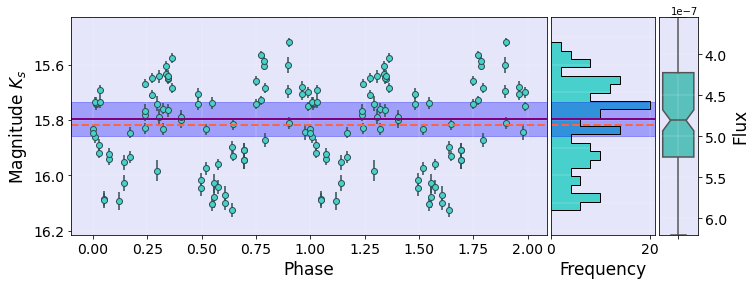

id_vvv 515882572357.0 Period_LS*2 0.7502854
0.7502854 515882572357.0


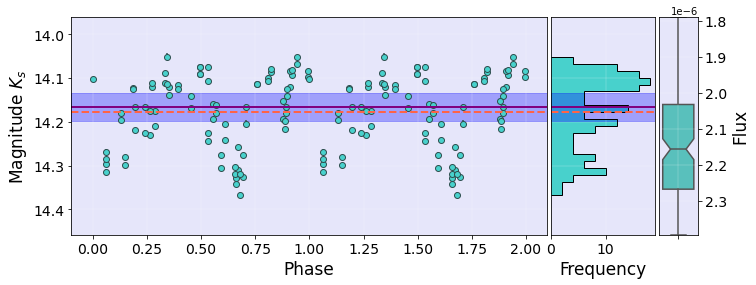

id_vvv 515882572575.0 Period_LS*2 2.1278312
2.1278312 515882572575.0


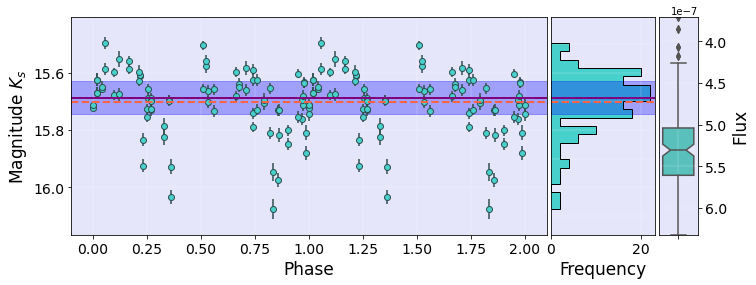

id_vvv 515882573276.0 Period_LS*2 1.224717
1.224717 515882573276.0


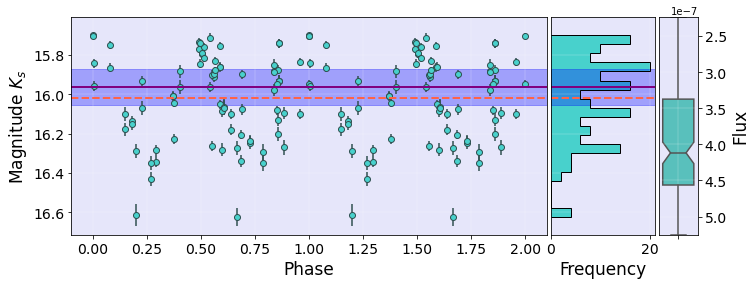

id_vvv 515882574403.0 Period_LS*2 0.73929816
0.73929816 515882574403.0


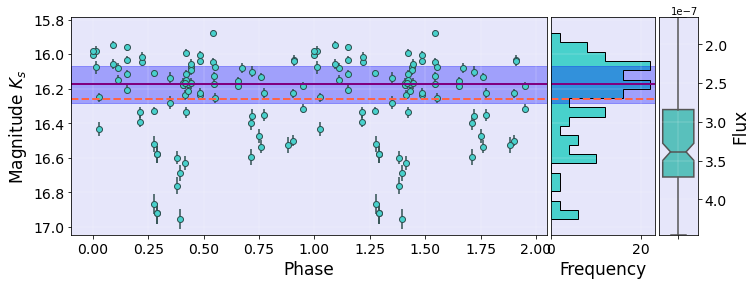

id_vvv 515882579293.0 Period_LS*2 0.5915715
0.5915715 515882579293.0


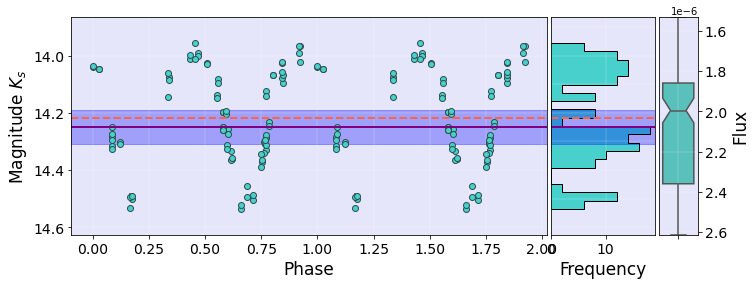

id_vvv 515882580071.0 Period_LS*2 0.68857134
0.68857134 515882580071.0


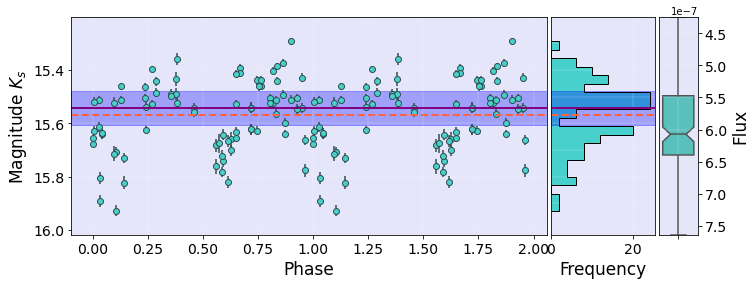

id_vvv 515882586682.0 Period_LS*2 1.09431028
1.09431028 515882586682.0


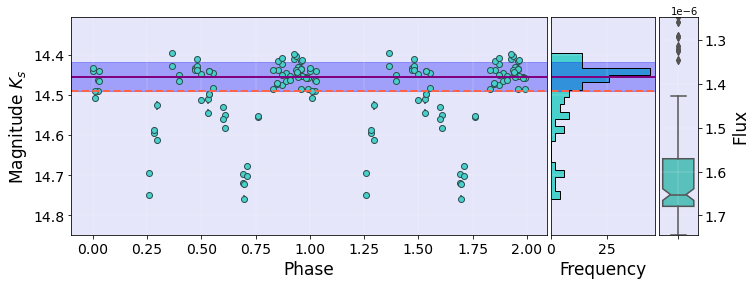

id_vvv 515882587202.0 Period_LS*2 0.65488028
0.65488028 515882587202.0


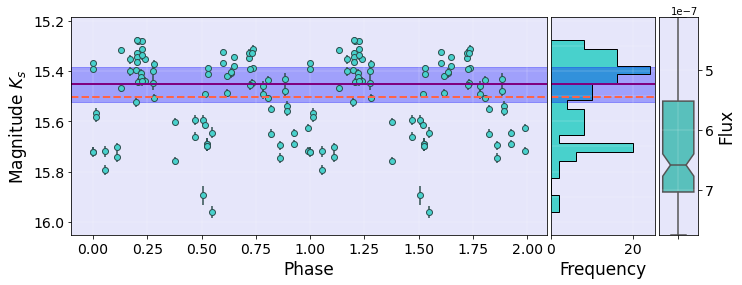

id_vvv 515882596527.0 Period_LS*2 0.6832578
0.6832578 515882596527.0


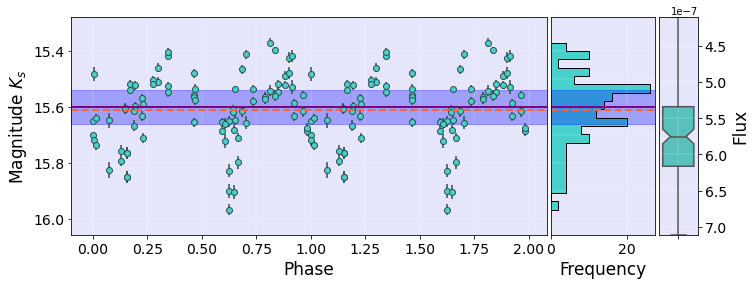

id_vvv 515882598274.0 Period_LS*2 1.69809
1.69809 515882598274.0


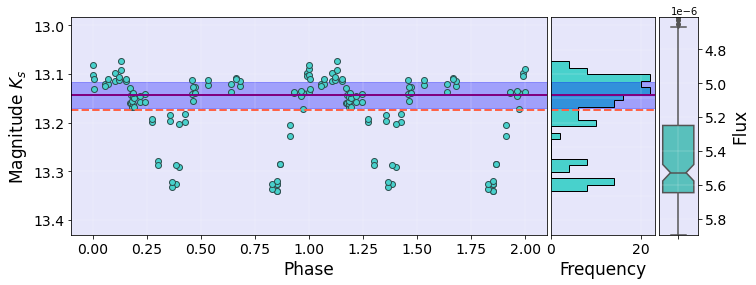

id_vvv 515882599490.0 Period_LS*2 19.361654
19.361654 515882599490.0


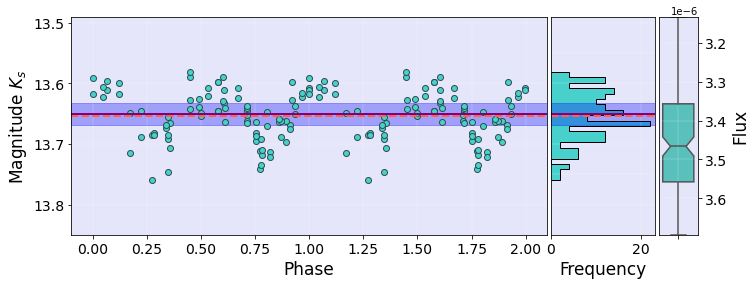

id_vvv 515882600799.0 Period_LS*2 0.9262868
0.9262868 515882600799.0


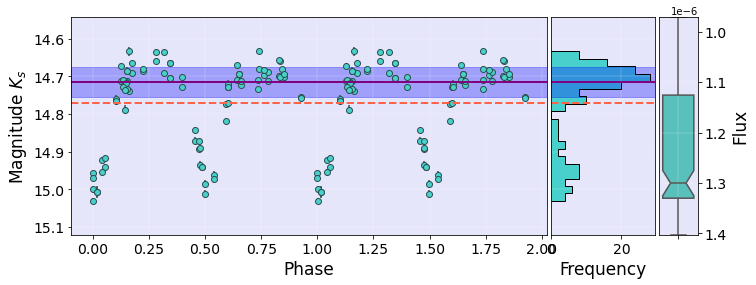

id_vvv 515882603305.0 Period_LS*2 0.77792066
0.77792066 515882603305.0


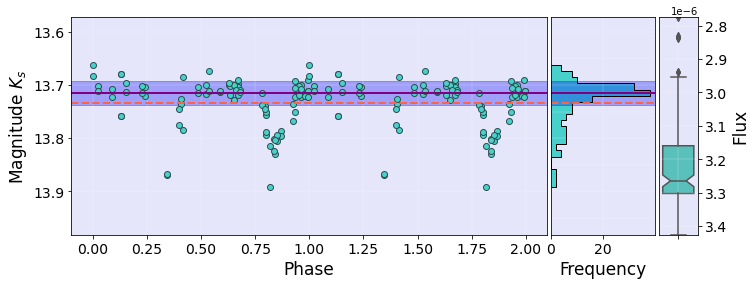

id_vvv 515882605737.0 Period_LS*2 0.79183454
0.79183454 515882605737.0


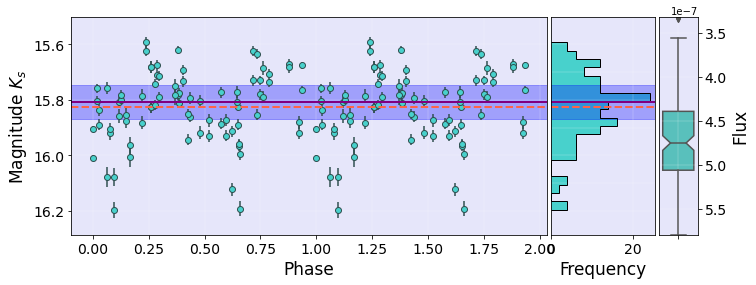

id_vvv 515882605874.0 Period_LS*2 1.02639472
1.02639472 515882605874.0


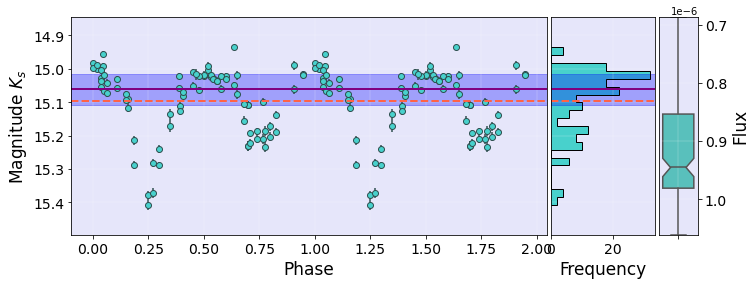

id_vvv 515882605988.0 Period_LS*2 2.9158968
2.9158968 515882605988.0


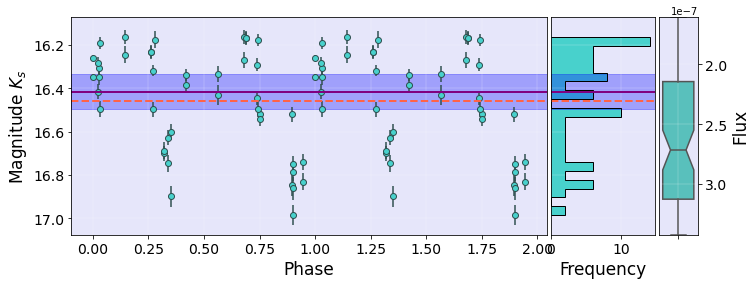

id_vvv 515882605991.0 Period_LS*2 0.75799304
0.75799304 515882605991.0


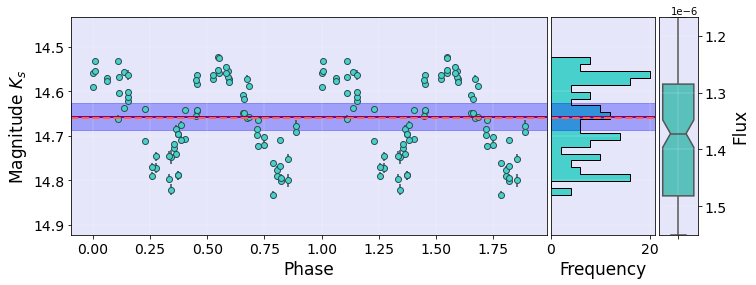

id_vvv 515882607946.0 Period_LS*2 0.71794808
0.71794808 515882607946.0


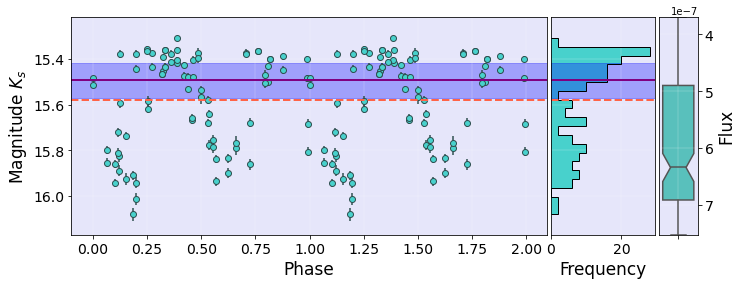

id_vvv 515882608488.0 Period_LS*2 2.829231
2.829231 515882608488.0


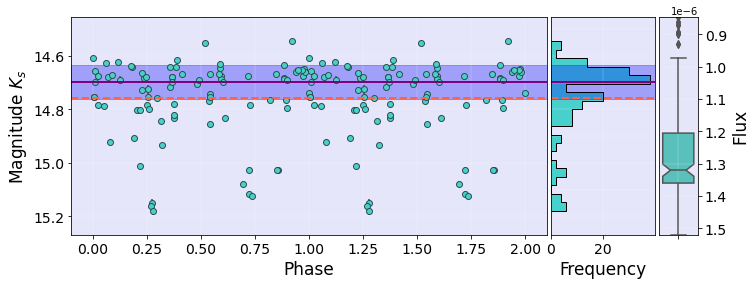

id_vvv 515882608783.0 Period_LS*2 0.72766084
0.72766084 515882608783.0


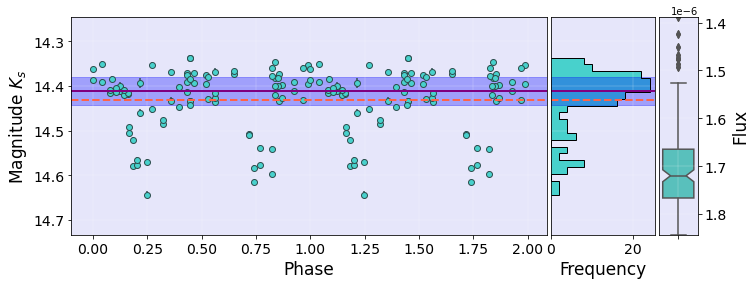

id_vvv 515882609836.0 Period_LS*2 1.40278614
1.40278614 515882609836.0


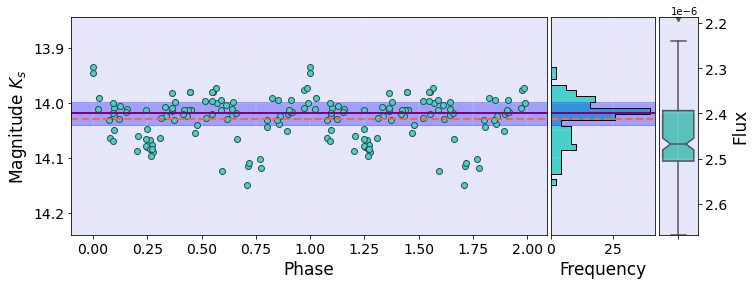

id_vvv 515882610581.0 Period_LS*2 0.7051924
0.7051924 515882610581.0


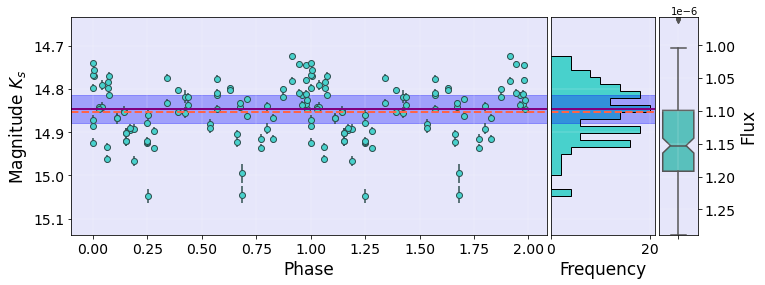

id_vvv 515882610928.0 Period_LS*2 25.437576
25.437576 515882610928.0


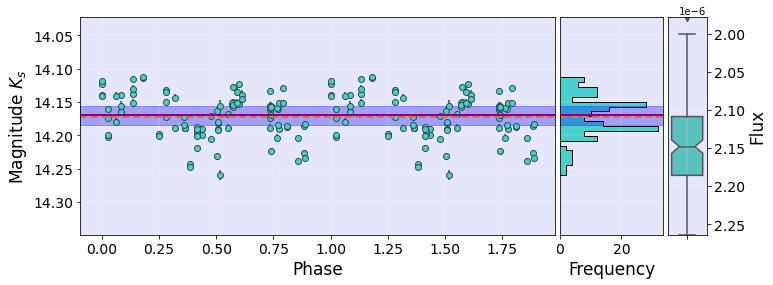

id_vvv 515882611594.0 Period_LS*2 0.73594588
0.73594588 515882611594.0


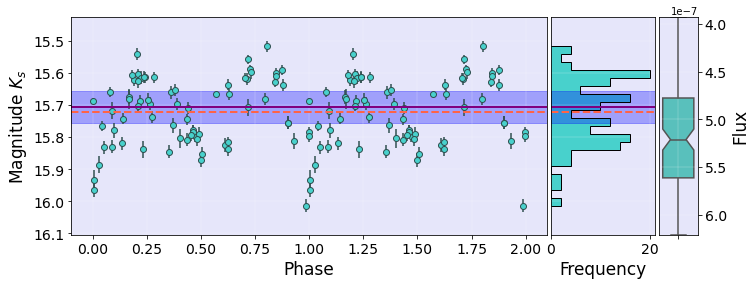

id_vvv 515882611780.0 Period_LS*2 0.63644928
0.63644928 515882611780.0


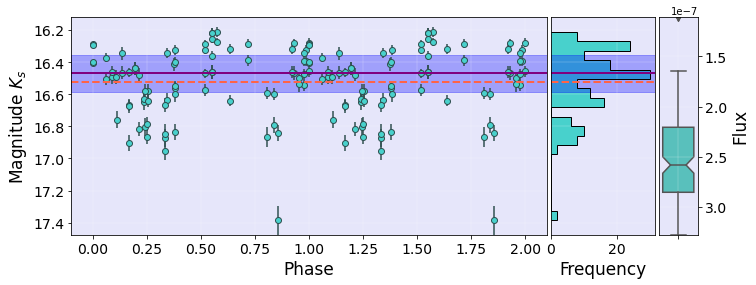

id_vvv 515882613174.0 Period_LS*2 0.43255494
0.43255494 515882613174.0


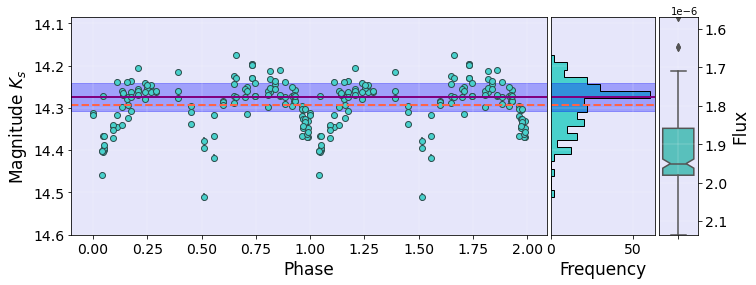

id_vvv 515882613819.0 Period_LS*2 0.546389
0.546389 515882613819.0


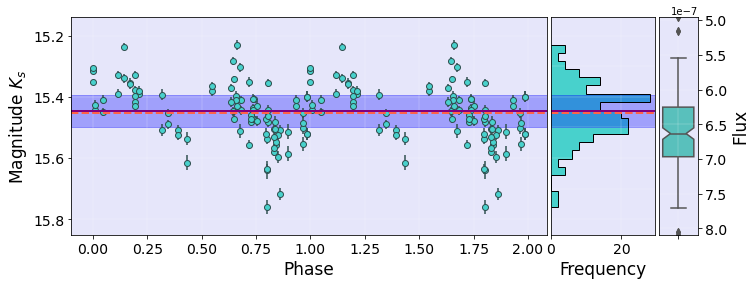

id_vvv 515882614410.0 Period_LS*2 16.645702
16.645702 515882614410.0


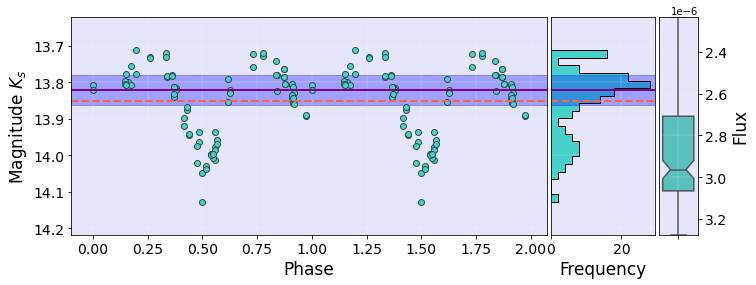

id_vvv 515882614943.0 Period_LS*2 4.457139
4.457139 515882614943.0


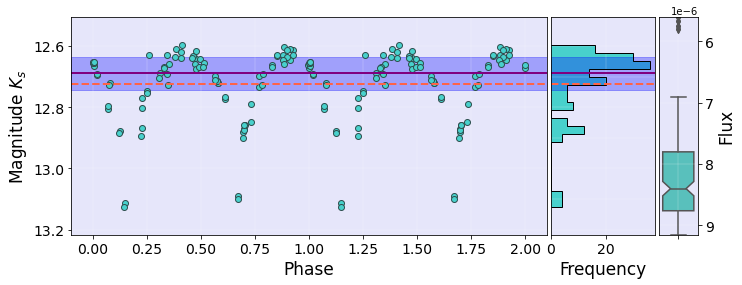

id_vvv 515882615773.0 Period_LS*2 0.64030832
0.64030832 515882615773.0


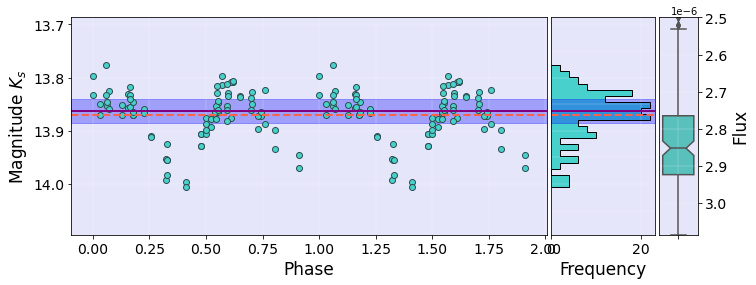

id_vvv 515882615824.0 Period_LS*2 4.3975176
4.3975176 515882615824.0


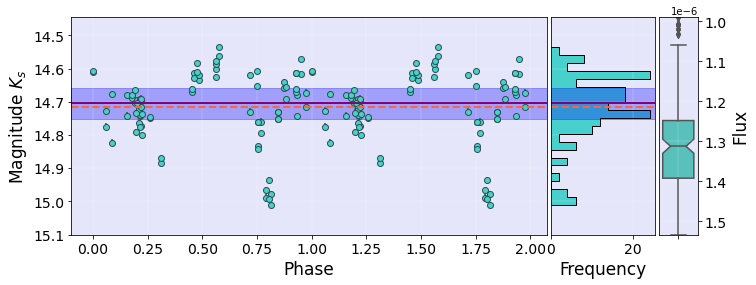

id_vvv 515882617296.0 Period_LS*2 10.8029128
10.8029128 515882617296.0


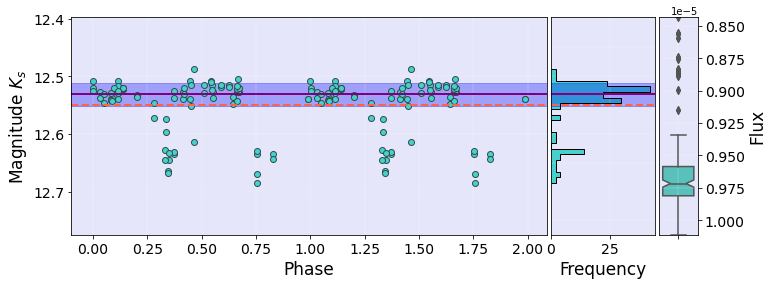

id_vvv 515882617877.0 Period_LS*2 0.75964386
0.75964386 515882617877.0


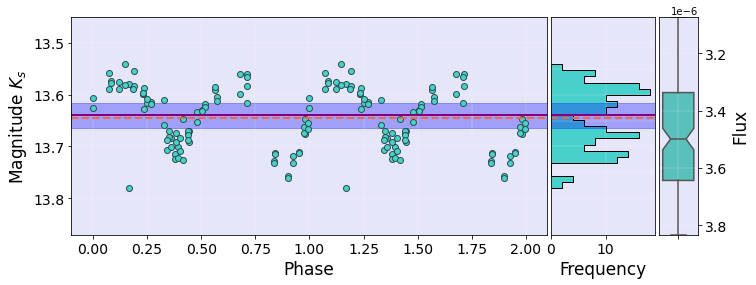

id_vvv 515882620079.0 Period_LS*2 0.95606154
0.95606154 515882620079.0


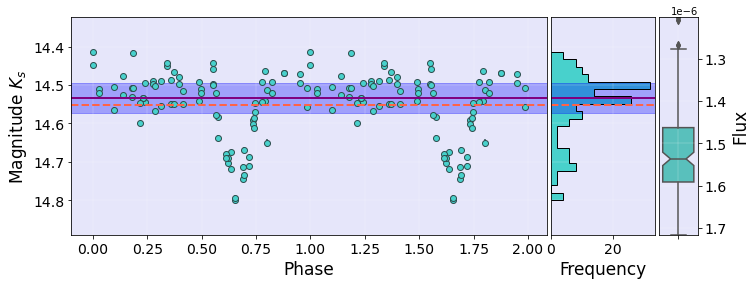

id_vvv 515882620181.0 Period_LS*2 2.5805408
2.5805408 515882620181.0


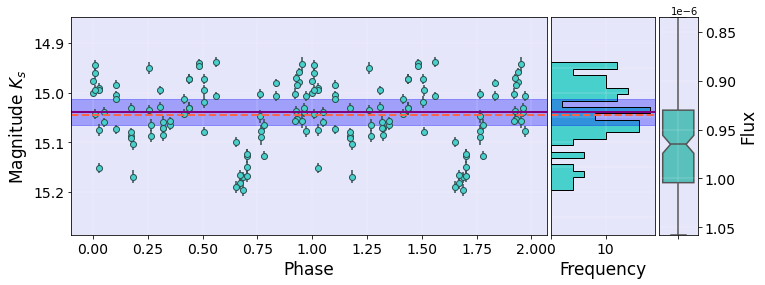

id_vvv 515882620798.0 Period_LS*2 2.2808884
2.2808884 515882620798.0


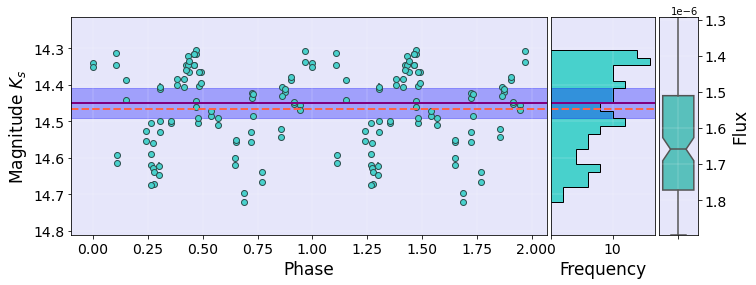

id_vvv 515882626677.0 Period_LS*2 0.5856123
0.5856123 515882626677.0


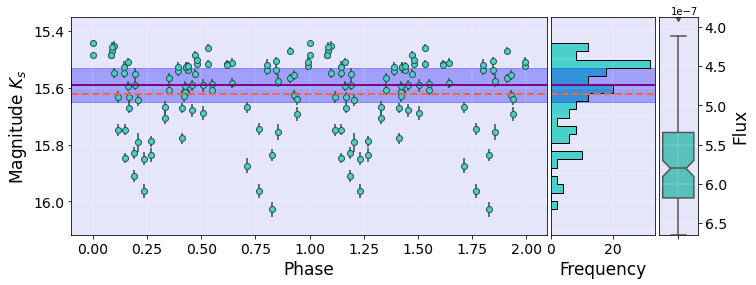

id_vvv 515882627547.0 Period_LS*2 1.3066012
1.3066012 515882627547.0


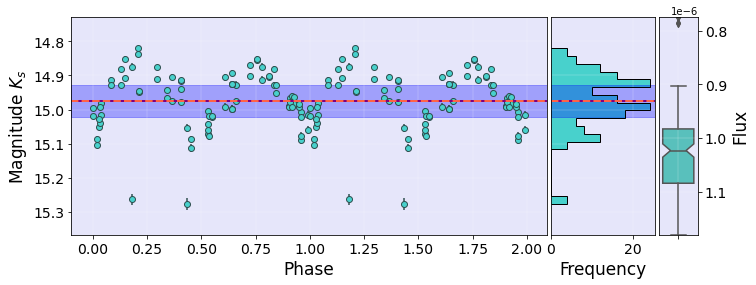

id_vvv 515882628187.0 Period_LS*2 1.5055266
1.5055266 515882628187.0


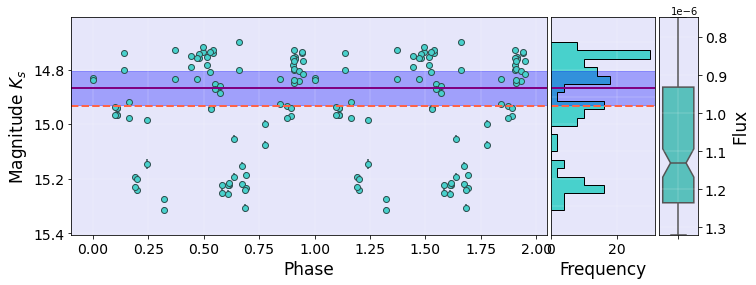

id_vvv 515882628892.0 Period_LS*2 3.5248824
3.5248824 515882628892.0


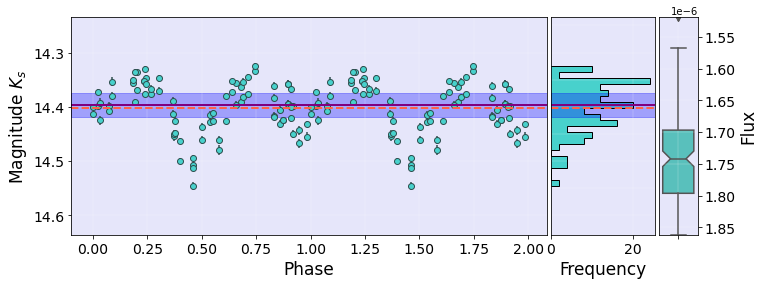

id_vvv 515882628970.0 Period_LS*2 0.8357154
0.8357154 515882628970.0


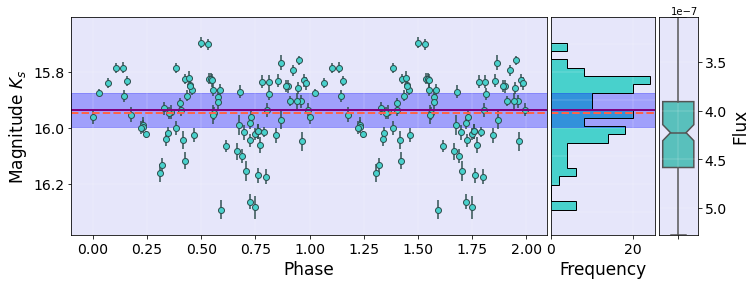

id_vvv 515882629433.0 Period_LS*2 1.40569126
1.40569126 515882629433.0


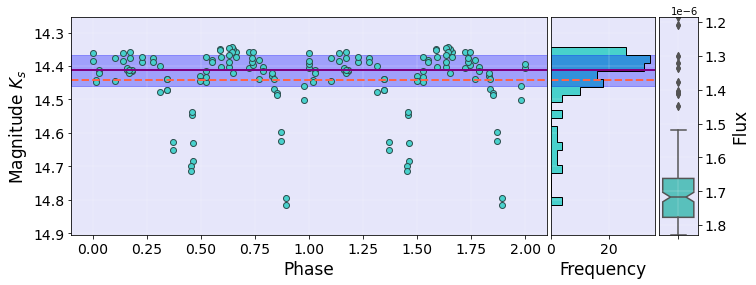

id_vvv 515882629494.0 Period_LS*2 3.2147754
3.2147754 515882629494.0


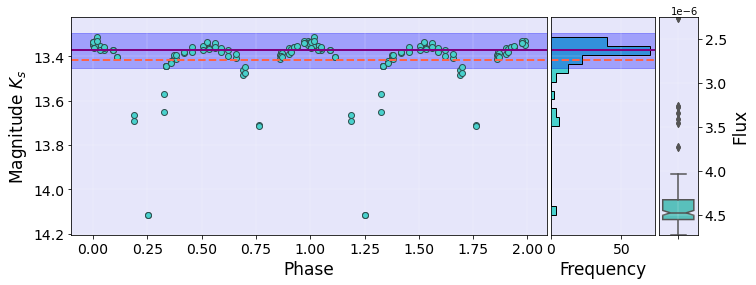

id_vvv 515882630183.0 Period_LS*2 2.3088078
2.3088078 515882630183.0


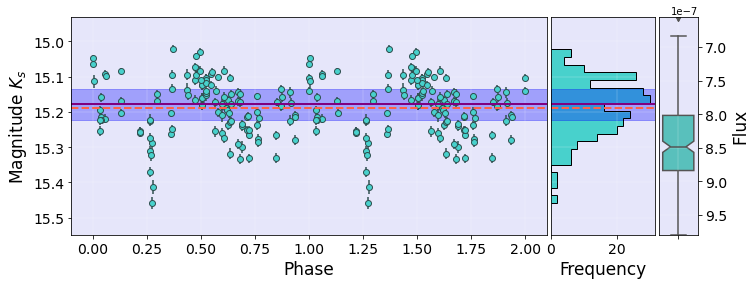

id_vvv 515882631613.0 Period_LS*2 1.9253162
1.9253162 515882631613.0


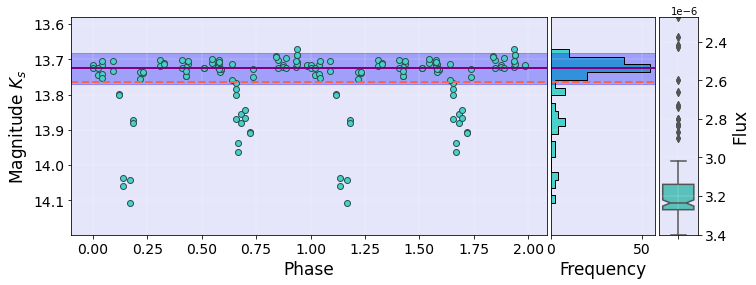

id_vvv 515882632773.0 Period_LS*2 51.271728
51.271728 515882632773.0


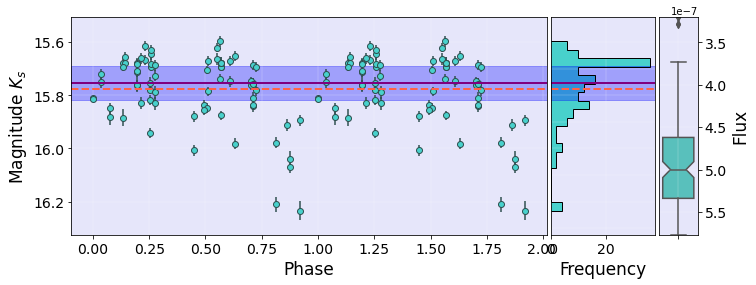

id_vvv 515882632958.0 Period_LS*2 0.82362014
0.82362014 515882632958.0


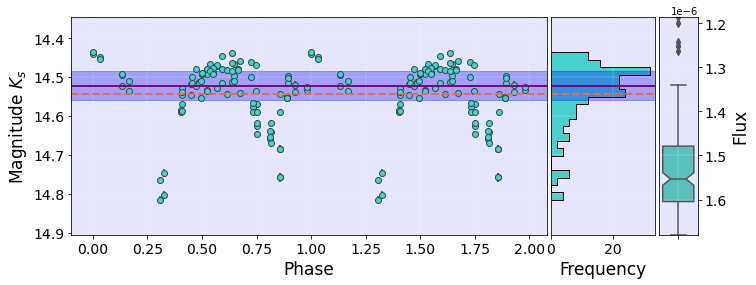

id_vvv 515882633223.0 Period_LS*2 0.5813826
0.5813826 515882633223.0


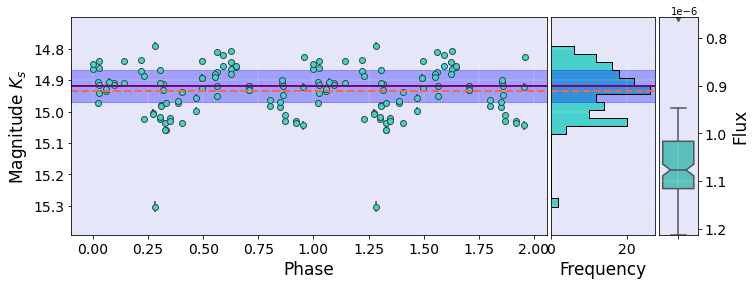

id_vvv 515882634867.0 Period_LS*2 0.66679234
0.66679234 515882634867.0


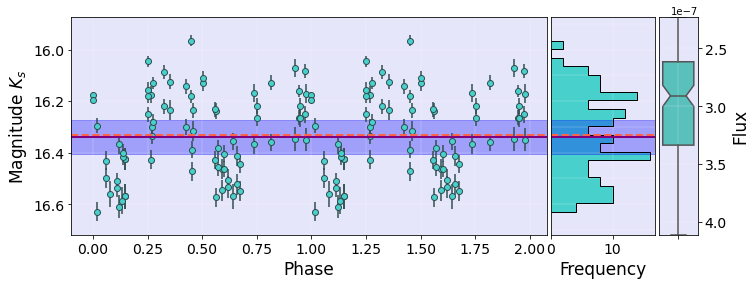

id_vvv 515882634885.0 Period_LS*2 1.6151692
1.6151692 515882634885.0


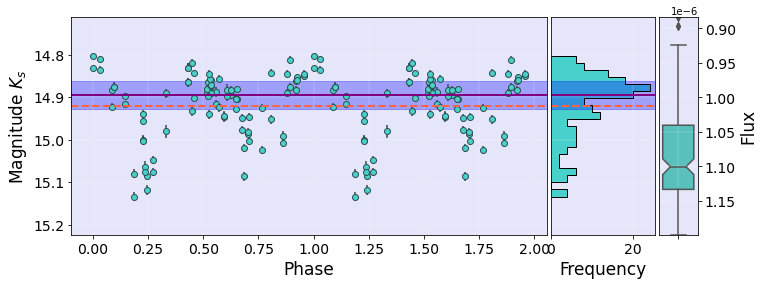

id_vvv 515882635098.0 Period_LS*2 0.65447068
0.65447068 515882635098.0


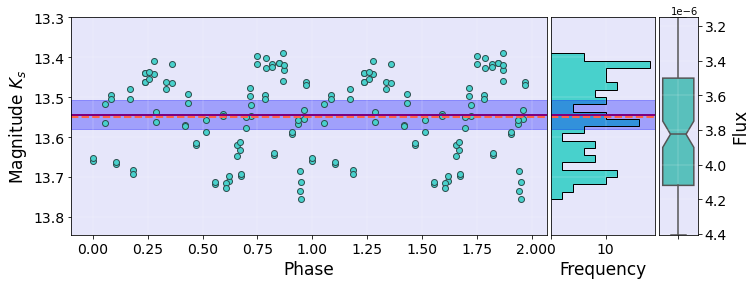

id_vvv 515882635417.0 Period_LS*2 0.6148609
0.6148609 515882635417.0


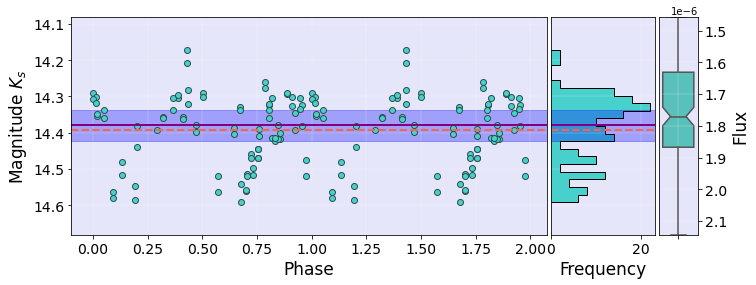

id_vvv 515882635594.0 Period_LS*2 1.5348658
1.5348658 515882635594.0


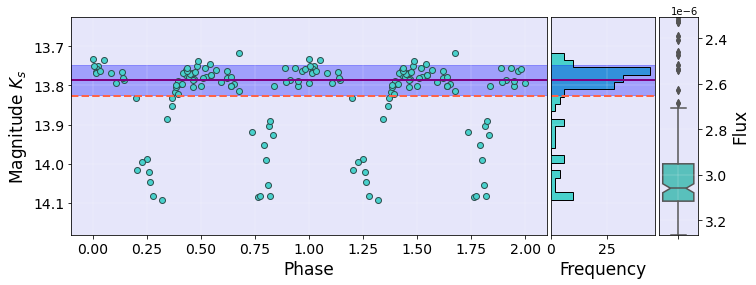

id_vvv 515882635824.0 Period_LS*2 0.74250776
0.74250776 515882635824.0


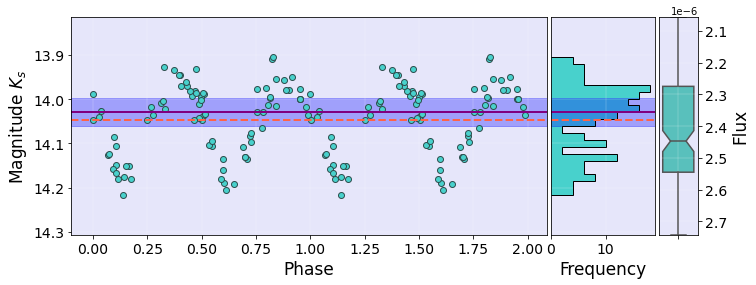

id_vvv 515882640117.0 Period_LS*2 0.85405326
0.85405326 515882640117.0


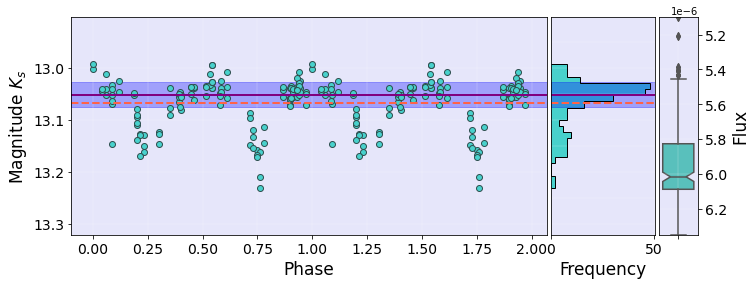

id_vvv 515882643140.0 Period_LS*2 0.7342521
0.7342521 515882643140.0


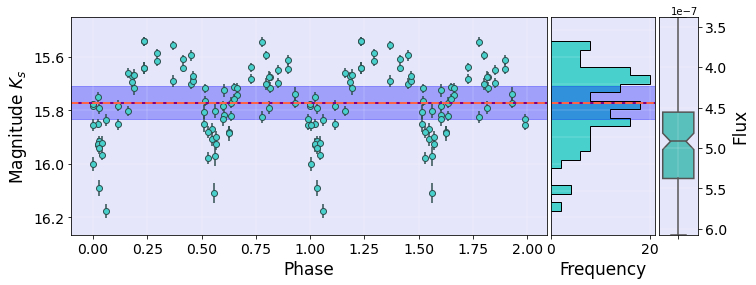

id_vvv 515882644277.0 Period_LS*2 1.0661328
1.0661328 515882644277.0


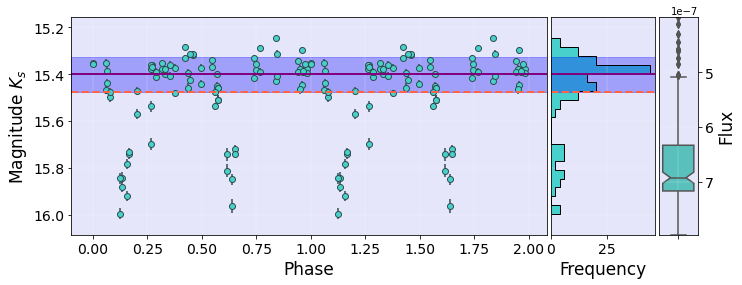

id_vvv 515882646721.0 Period_LS*2 2.0132056
2.0132056 515882646721.0


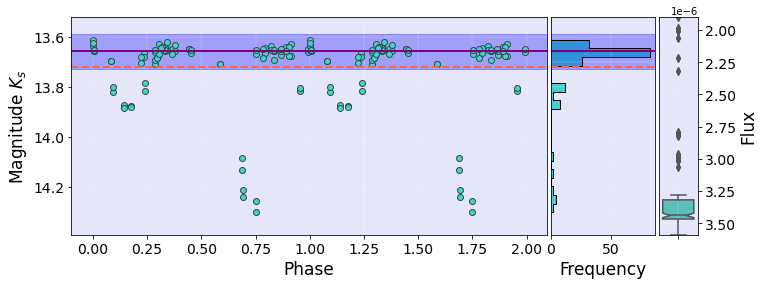

id_vvv 515882649034.0 Period_LS*2 0.64055776
0.64055776 515882649034.0


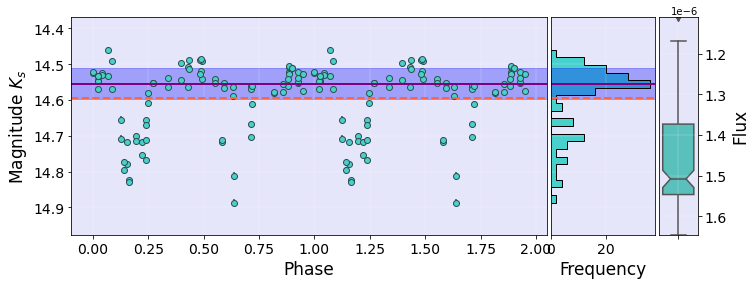

id_vvv 515882650736.0 Period_LS*2 4.068034
4.068034 515882650736.0


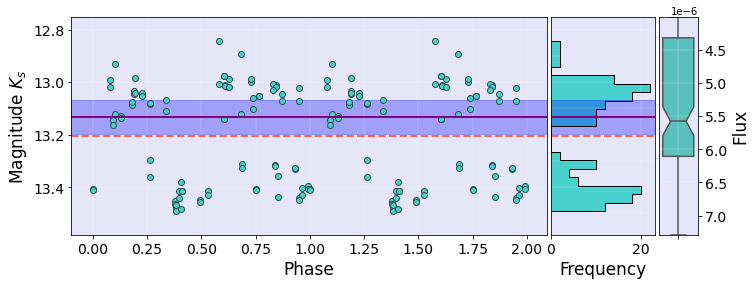

id_vvv 515882652941.0 Period_LS*2 2.7693906
2.7693906 515882652941.0


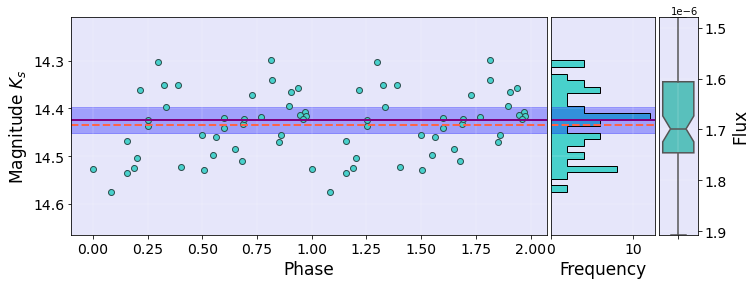

id_vvv 515882654966.0 Period_LS*2 0.7294131
0.7294131 515882654966.0


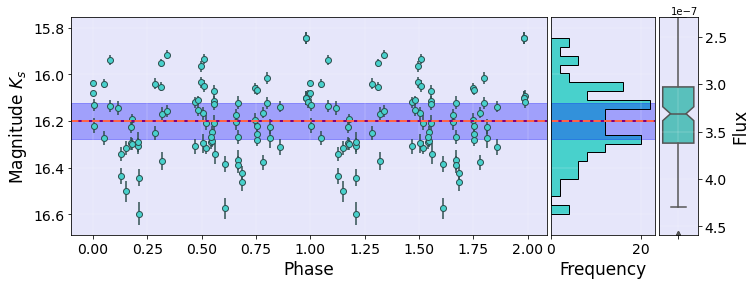

id_vvv 515882660689.0 Period_LS*2 1.0536412
1.0536412 515882660689.0


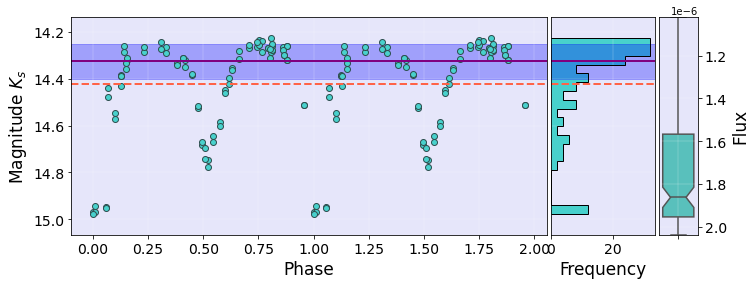

id_vvv 515882661430.0 Period_LS*2 1.12687874
1.12687874 515882661430.0


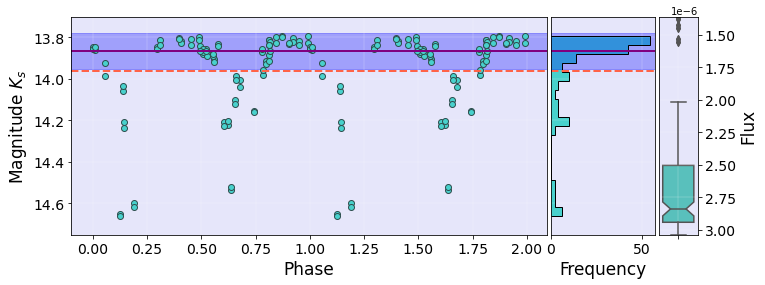

id_vvv 515882663154.0 Period_LS*2 1.0979638
1.0979638 515882663154.0


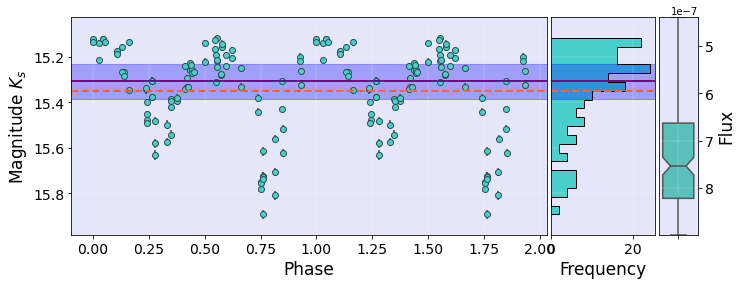

id_vvv 515882663382.0 Period_LS*2 0.910245
0.910245 515882663382.0


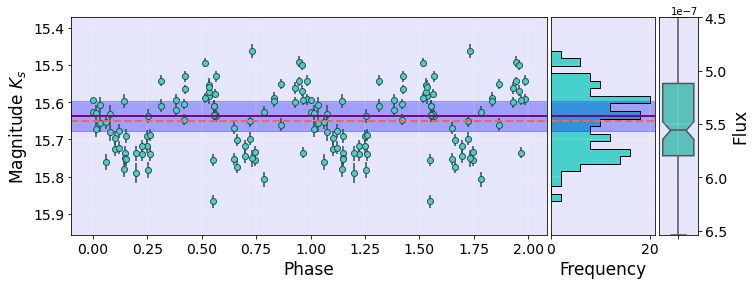

id_vvv 515882664236.0 Period_LS*2 4.120459
4.120459 515882664236.0


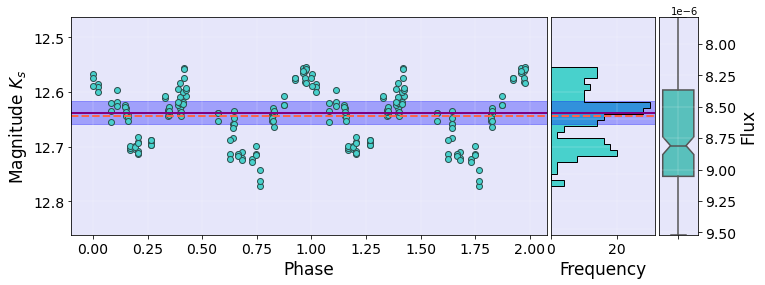

id_vvv 515882664919.0 Period_LS*2 0.78977
0.78977 515882664919.0


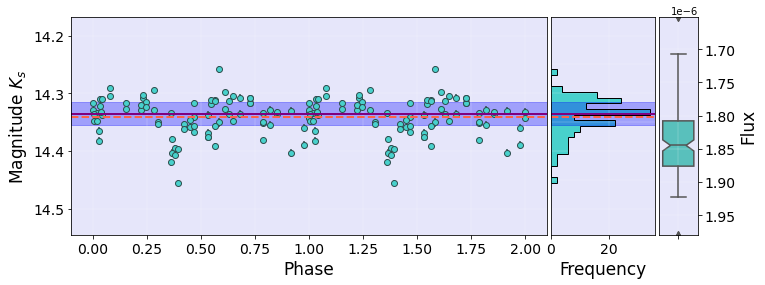

id_vvv 515882665822.0 Period_LS*2 0.7289973
0.7289973 515882665822.0


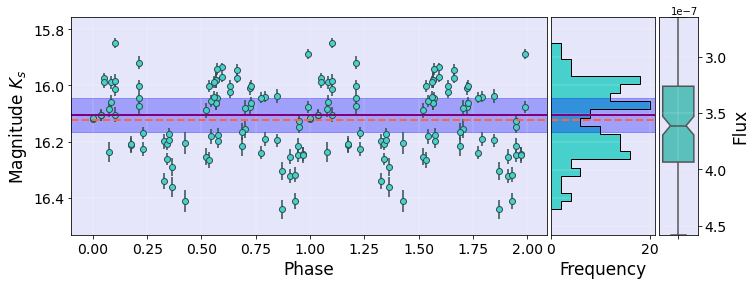

id_vvv 515882666943.0 Period_LS*2 1.324645
1.324645 515882666943.0


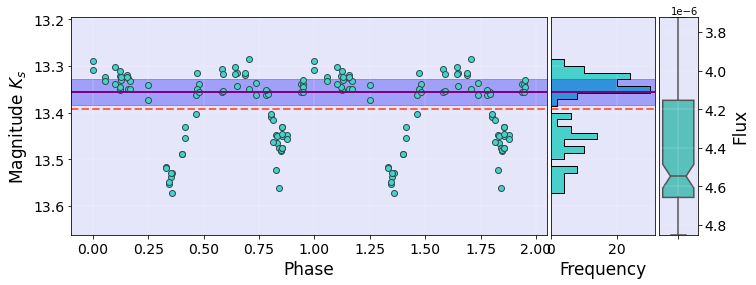

id_vvv 515882667042.0 Period_LS*2 1.48608912
1.48608912 515882667042.0


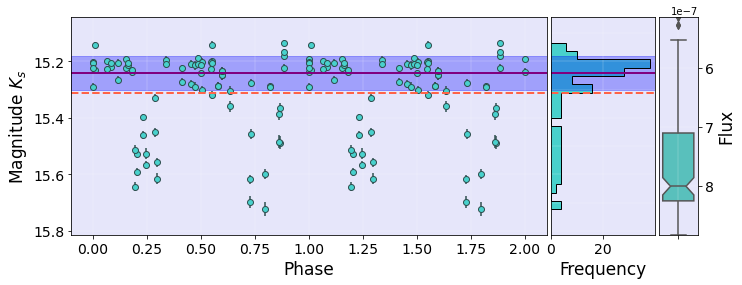

id_vvv 515882668442.0 Period_LS*2 1.7011014
1.7011014 515882668442.0


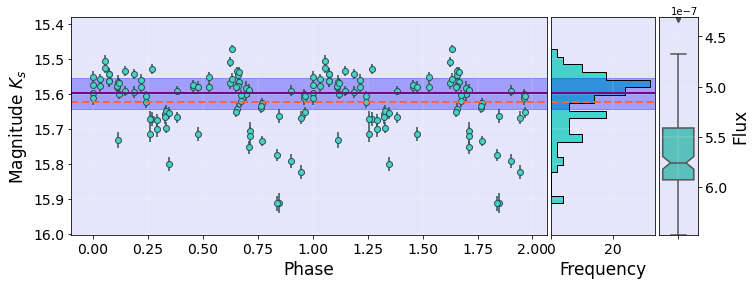

id_vvv 515882668712.0 Period_LS*2 1.233114
1.233114 515882668712.0


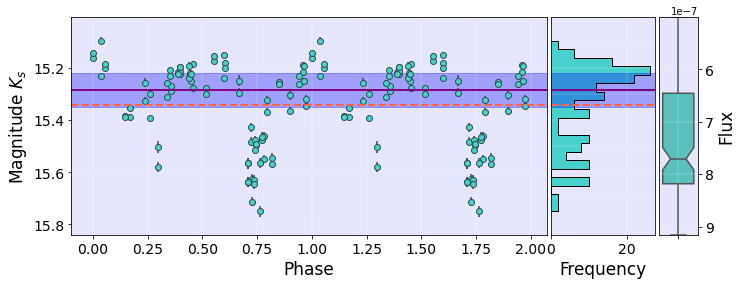

id_vvv 515882672690.0 Period_LS*2 1.091612
1.091612 515882672690.0


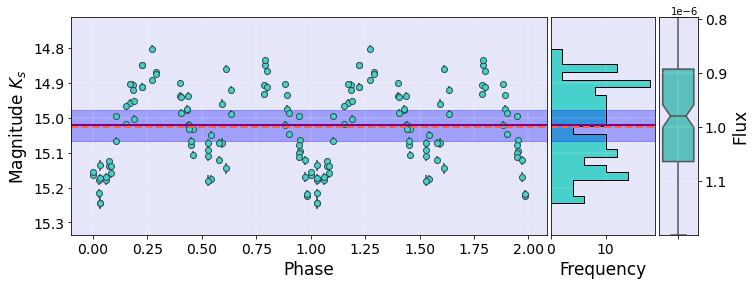

id_vvv 515882674320.0 Period_LS*2 0.9985255
0.9985255 515882674320.0


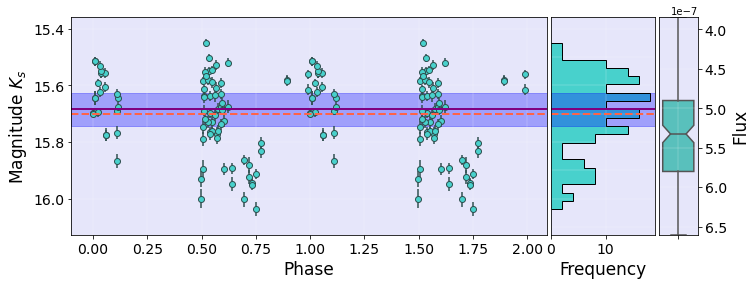

id_vvv 515882675304.0 Period_LS*2 27.05171
27.05171 515882675304.0


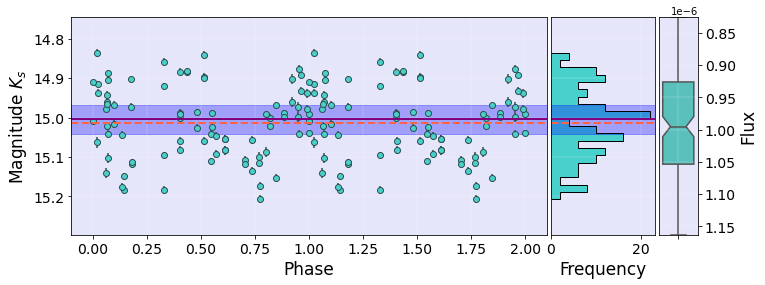

id_vvv 515882676561.0 Period_LS*2 1.0063828
1.0063828 515882676561.0


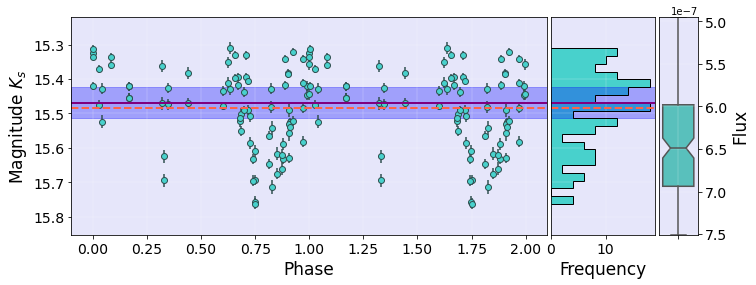

id_vvv 515882677263.0 Period_LS*2 5.987258
5.987258 515882677263.0


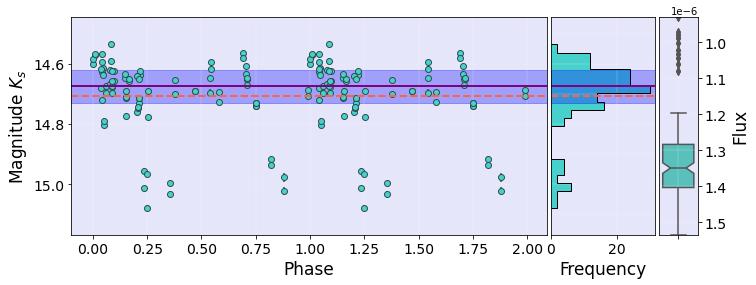

id_vvv 515882677659.0 Period_LS*2 1.3961432
1.3961432 515882677659.0


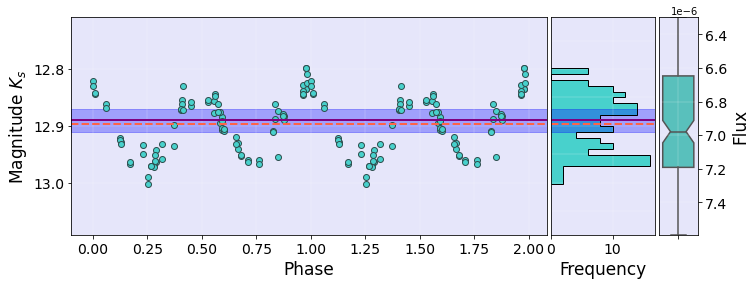

id_vvv 515882678514.0 Period_LS*2 0.9590702
0.9590702 515882678514.0


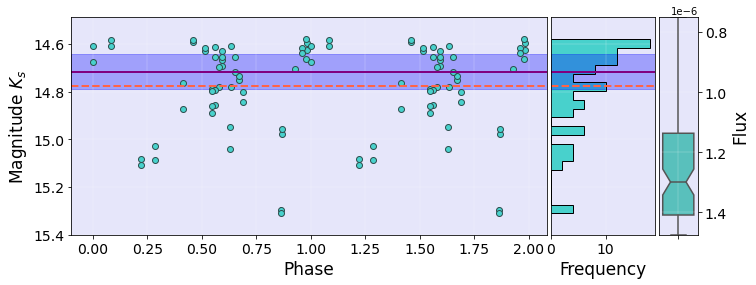

id_vvv 515882678982.0 Period_LS*2 3.071515
3.071515 515882678982.0


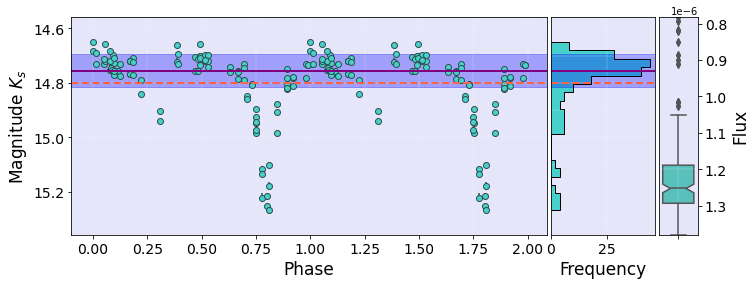

id_vvv 515882679064.0 Period_LS*2 0.99241304
0.99241304 515882679064.0


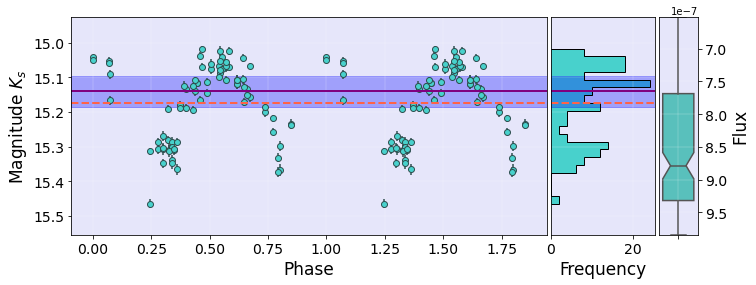

id_vvv 515882680275.0 Period_LS*2 2.802996
2.802996 515882680275.0


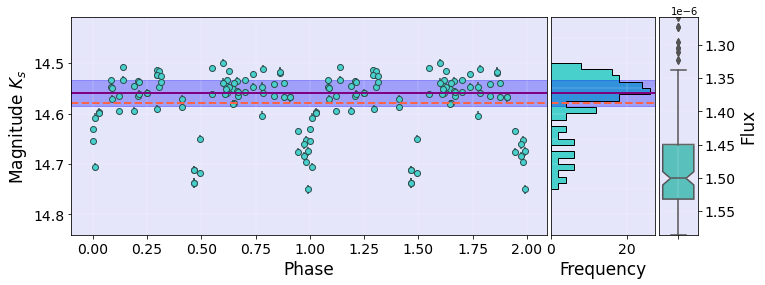

id_vvv 515882680287.0 Period_LS*2 1.0707942
1.0707942 515882680287.0


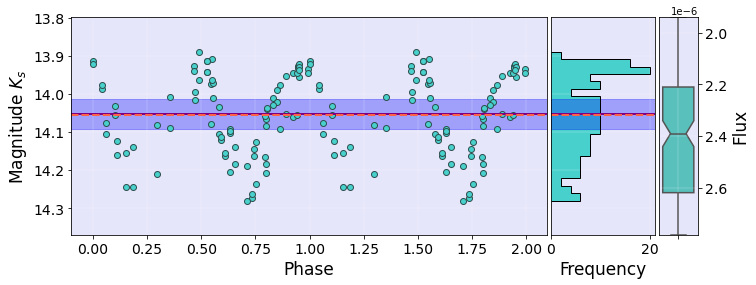

id_vvv 515882683613.0 Period_LS*2 1.07289028
1.07289028 515882683613.0


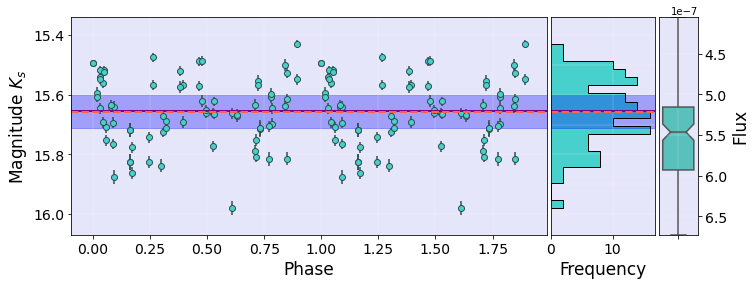

id_vvv 515882685181.0 Period_LS*2 3.6409066
3.6409066 515882685181.0


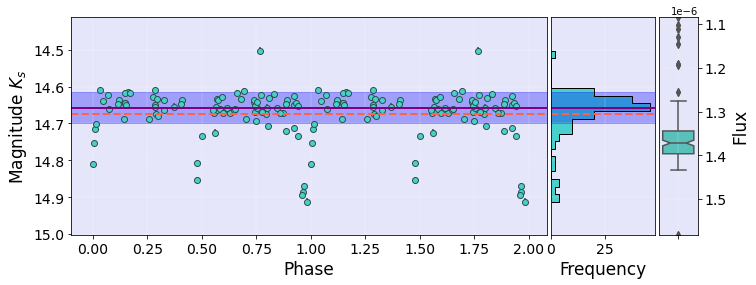

id_vvv 515882688826.0 Period_LS*2 0.95645874
0.95645874 515882688826.0


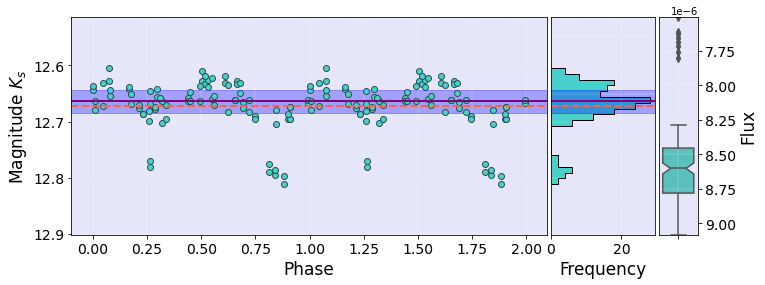

id_vvv 515882690114.0 Period_LS*2 0.86691796
0.86691796 515882690114.0


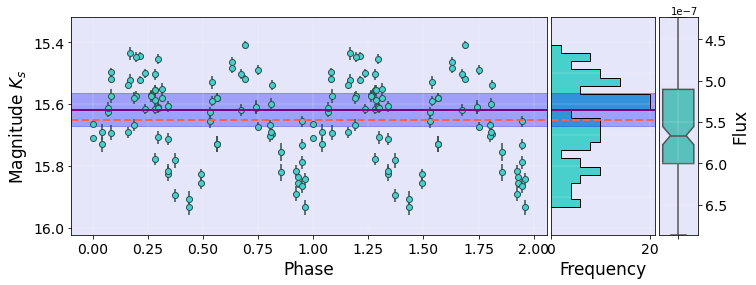

id_vvv 515882695473.0 Period_LS*2 0.6611242
0.6611242 515882695473.0


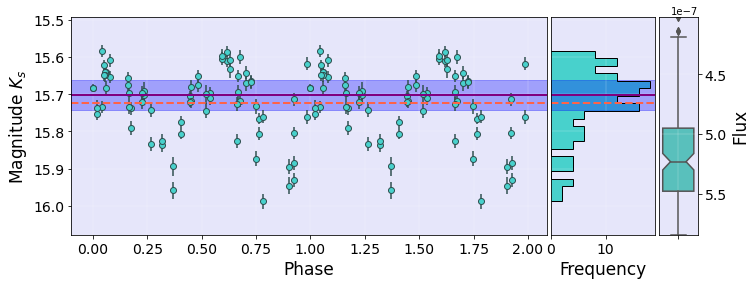

id_vvv 515882695756.0 Period_LS*2 1.496328
1.496328 515882695756.0


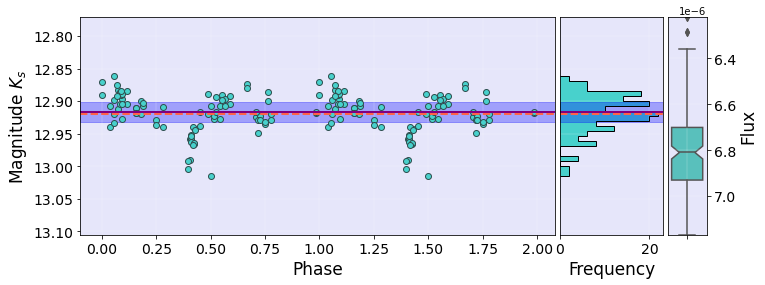

id_vvv 515882699315.0 Period_LS*2 0.67251926
0.67251926 515882699315.0


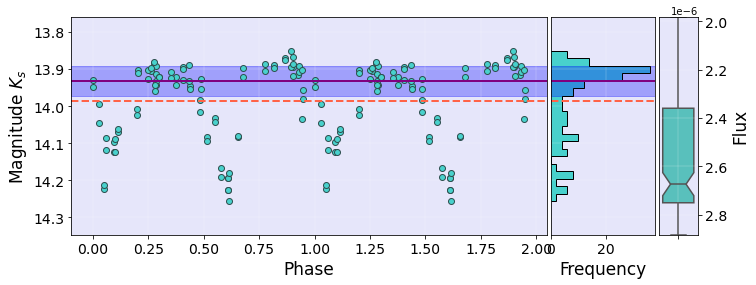

id_vvv 515882703527.0 Period_LS*2 0.3800149
0.3800149 515882703527.0


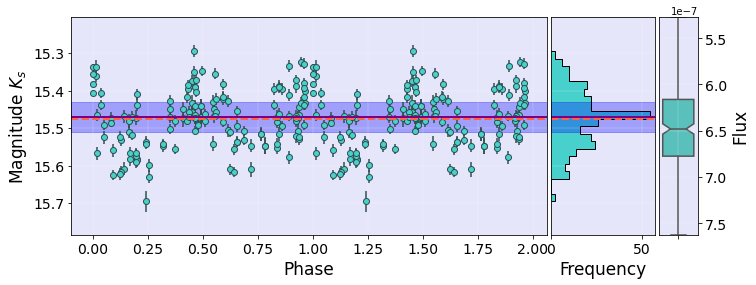

id_vvv 515882714993.0 Period_LS*2 0.5947197
0.5947197 515882714993.0


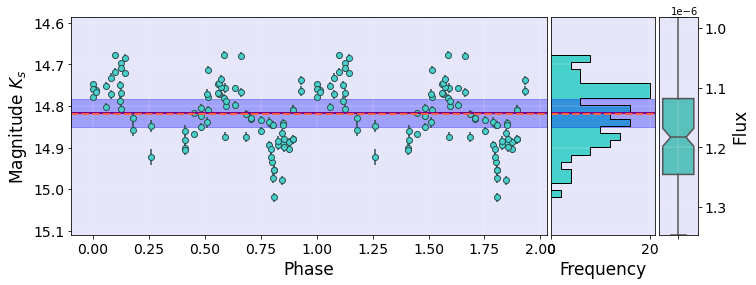

id_vvv 515882716275.0 Period_LS*2 15.29635
15.29635 515882716275.0


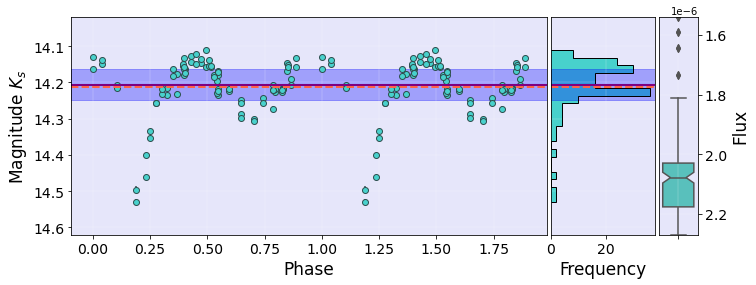

id_vvv 515882718065.0 Period_LS*2 0.6922704
0.6922704 515882718065.0


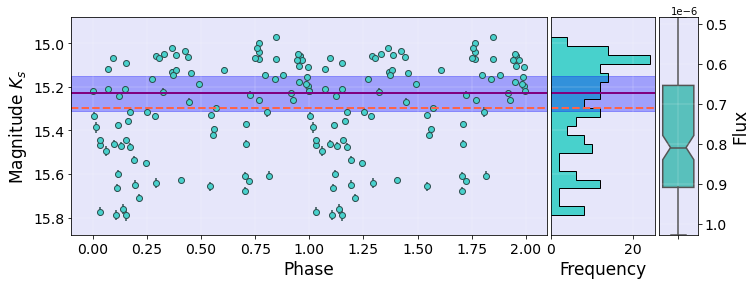

id_vvv 515882724392.0 Period_LS*2 0.77472674
0.77472674 515882724392.0


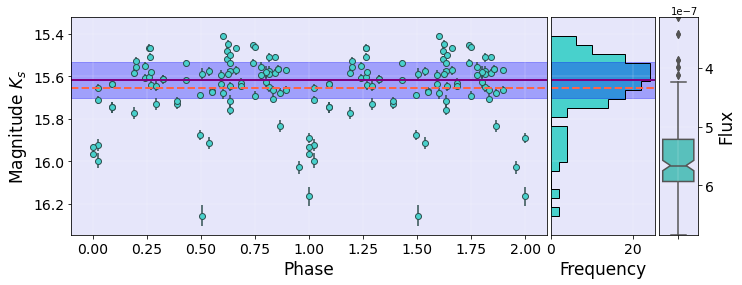

id_vvv 515882727140.0 Period_LS*2 10.128027
10.128027 515882727140.0


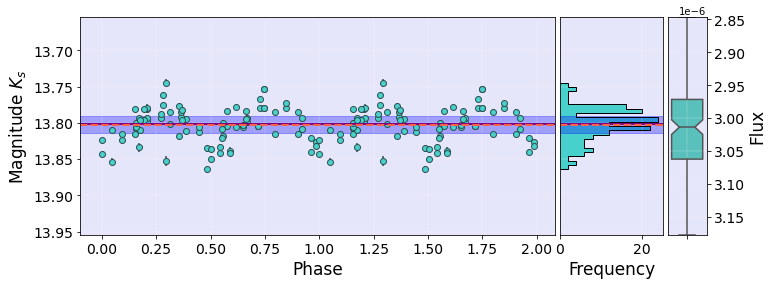

id_vvv 515882741013.0 Period_LS*2 1.0212042
1.0212042 515882741013.0


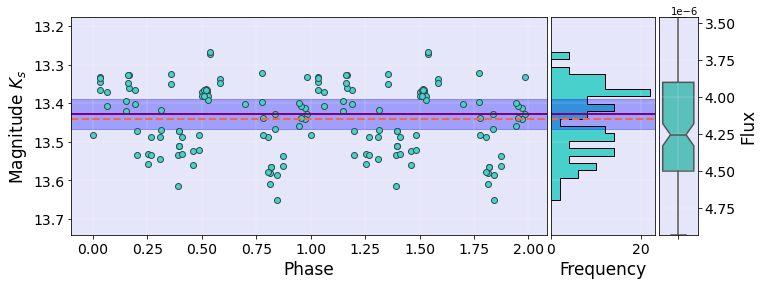

id_vvv 515882742417.0 Period_LS*2 21.77957
21.77957 515882742417.0


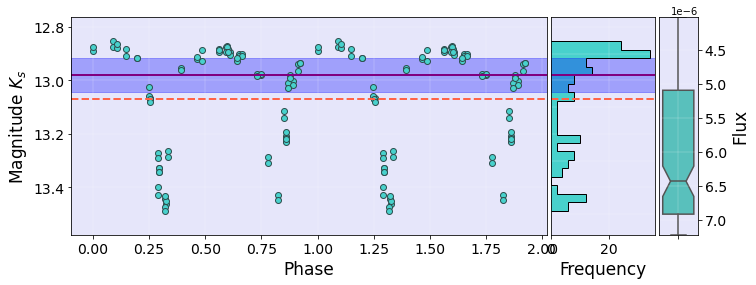

id_vvv 515882749193.0 Period_LS*2 4.209363
4.209363 515882749193.0


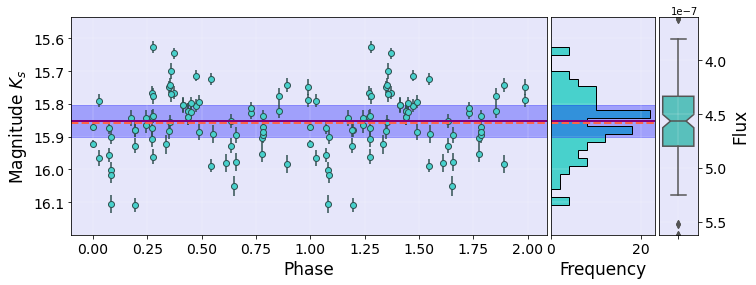

id_vvv 515882752777.0 Period_LS*2 2.9349162
2.9349162 515882752777.0


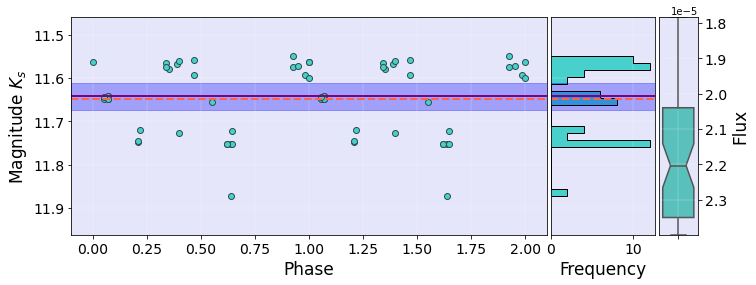

id_vvv 515882758304.0 Period_LS*2 1.369449
1.369449 515882758304.0


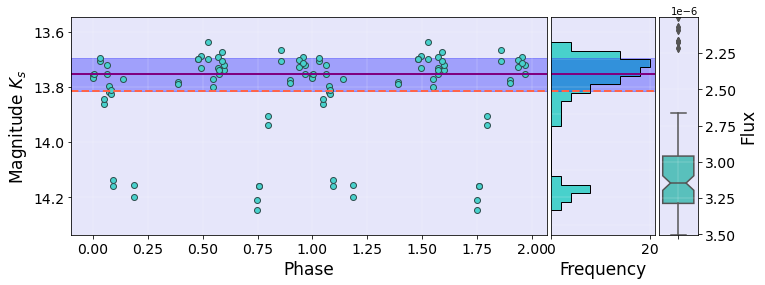

id_vvv 515882762542.0 Period_LS*2 1.5528504
1.5528504 515882762542.0


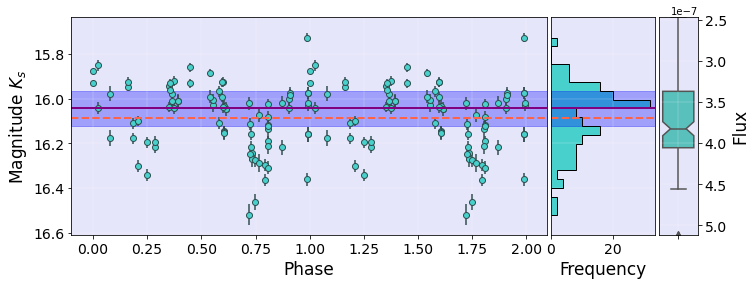

id_vvv 515882767277.0 Period_LS*2 3.9025268
3.9025268 515882767277.0


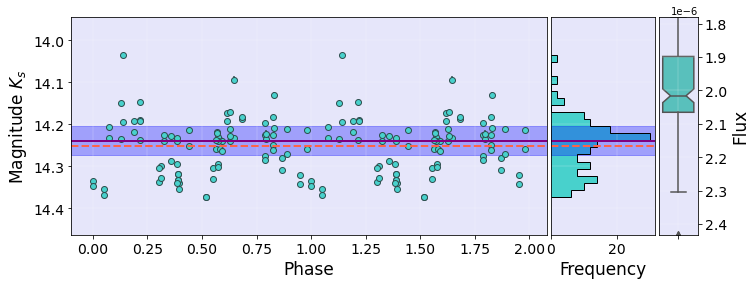

id_vvv 515882770170.0 Period_LS*2 0.8140672
0.8140672 515882770170.0


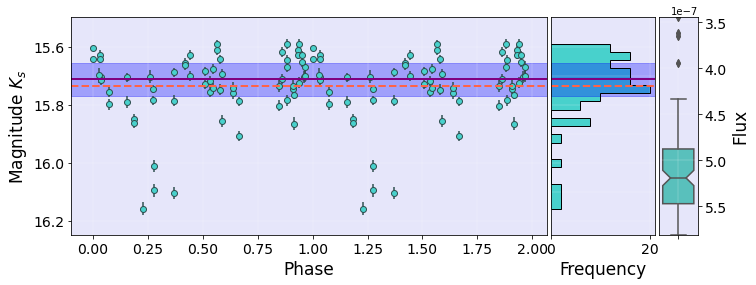

id_vvv 515882777484.0 Period_LS*2 2.6152306
2.6152306 515882777484.0


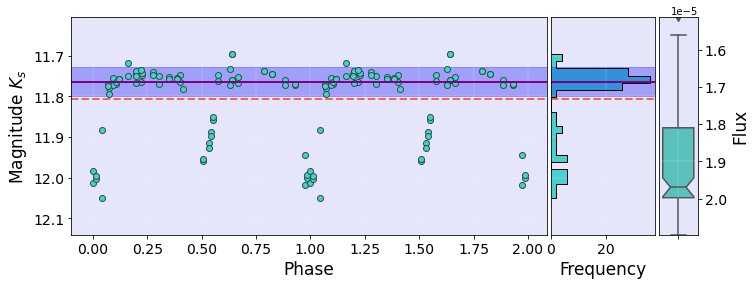

id_vvv 515882777684.0 Period_LS*2 1.3431942
1.3431942 515882777684.0


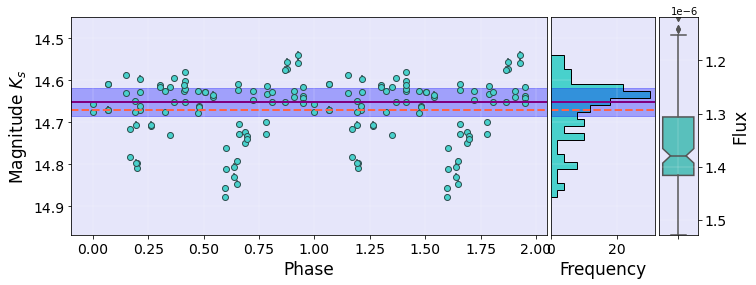

id_vvv 515882780154.0 Period_LS*2 3.9065004
3.9065004 515882780154.0


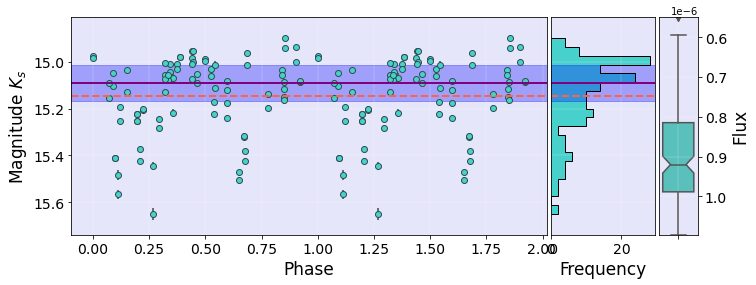

id_vvv 515882781255.0 Period_LS*2 2.192268
2.192268 515882781255.0


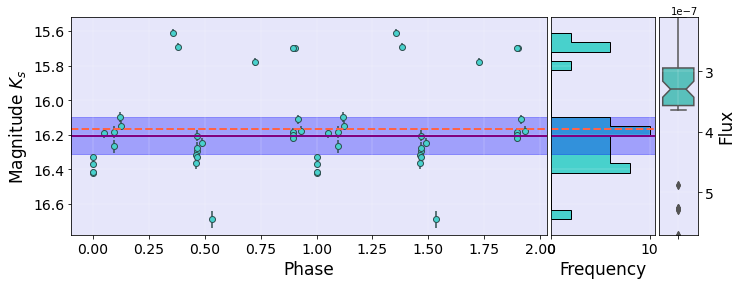

id_vvv 515882784865.0 Period_LS*2 0.79325336
0.79325336 515882784865.0


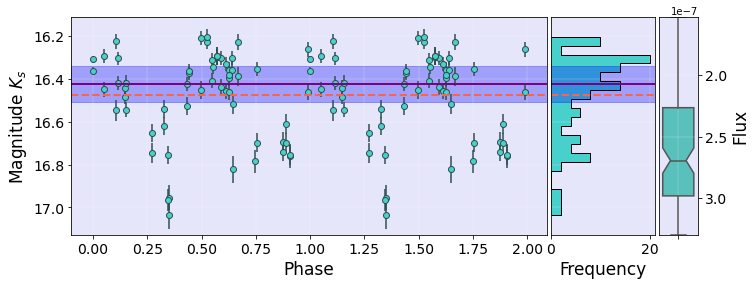

id_vvv 515882786973.0 Period_LS*2 0.8648336
0.8648336 515882786973.0


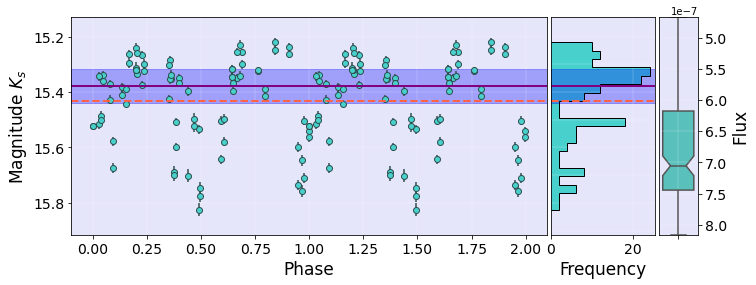

id_vvv 515882791247.0 Period_LS*2 1.9796204
1.9796204 515882791247.0


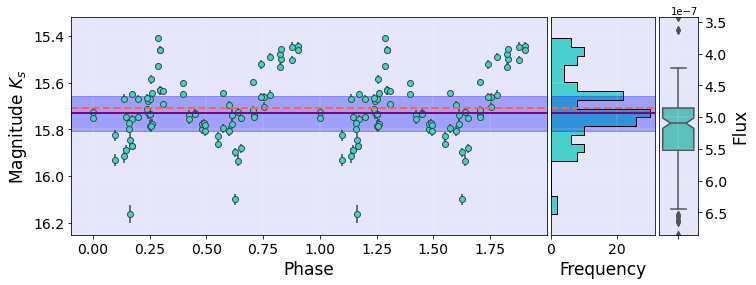

id_vvv 515882796418.0 Period_LS*2 2.0156734
2.0156734 515882796418.0


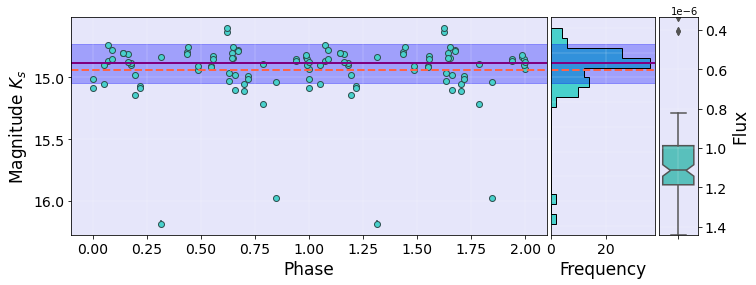

id_vvv 515882815940.0 Period_LS*2 5.4772796
5.4772796 515882815940.0


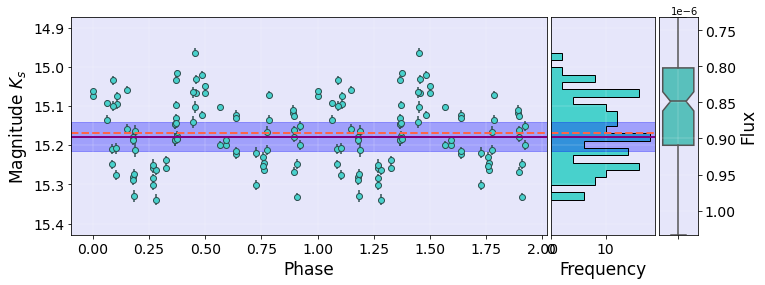

id_vvv 515882816715.0 Period_LS*2 1.3205418
1.3205418 515882816715.0


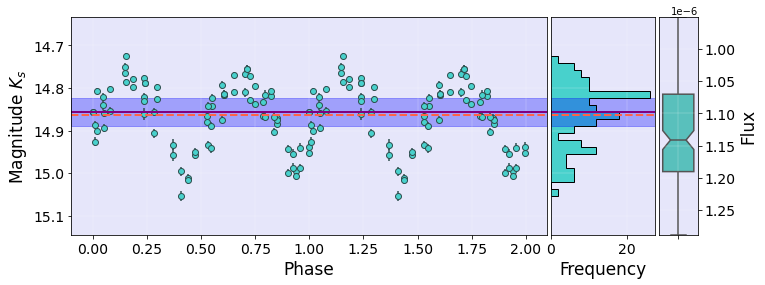

id_vvv 515882832289.0 Period_LS*2 9.088481
9.088481 515882832289.0


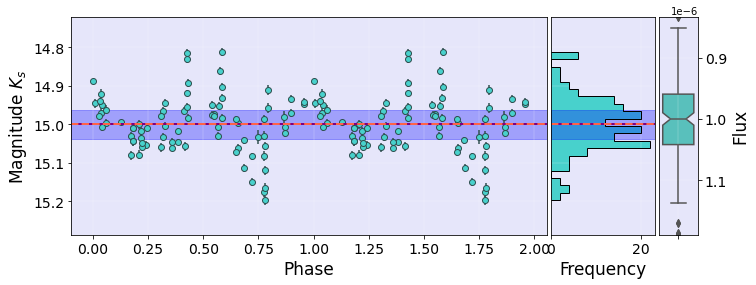

id_vvv 515882836624.0 Period_LS*2 0.5762022
0.5762022 515882836624.0


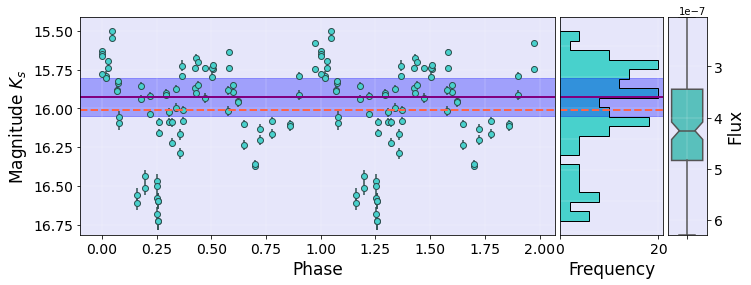

id_vvv 515882851639.0 Period_LS*2 0.83075332
0.83075332 515882851639.0


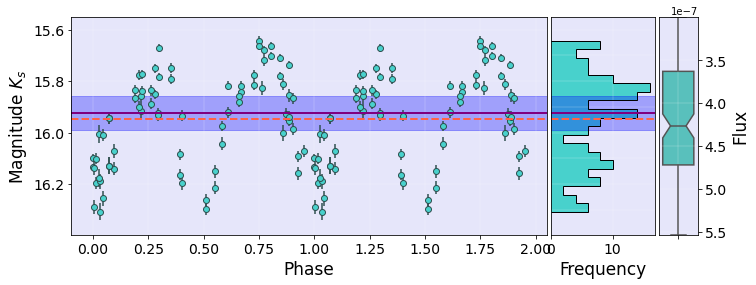

id_vvv 515882852971.0 Period_LS*2 489.80866
489.80866 515882852971.0


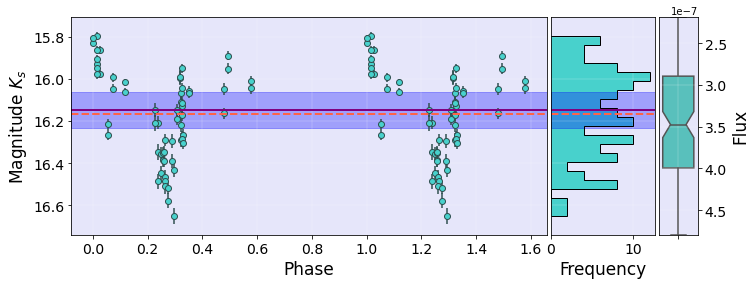

id_vvv 515882854828.0 Period_LS*2 0.5397304
0.5397304 515882854828.0


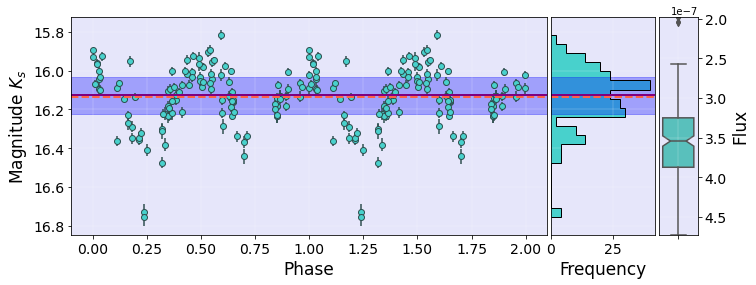

id_vvv 515882855864.0 Period_LS*2 2.154113
2.154113 515882855864.0


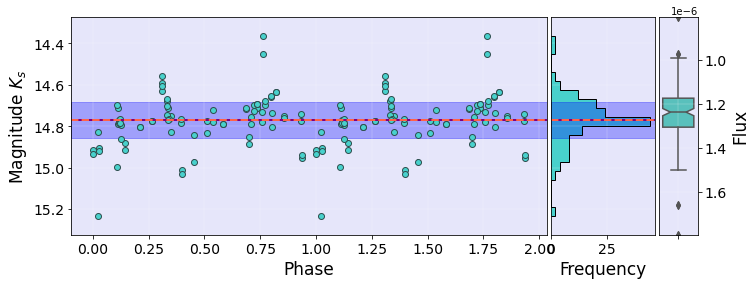

id_vvv 515882890346.0 Period_LS*2 0.76923872
0.76923872 515882890346.0


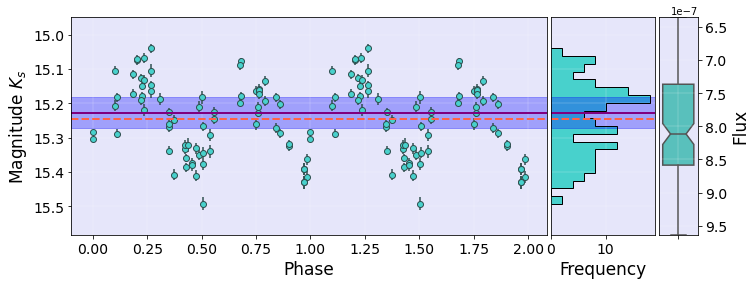

id_vvv 515882897173.0 Period_LS*2 2.796187
2.796187 515882897173.0


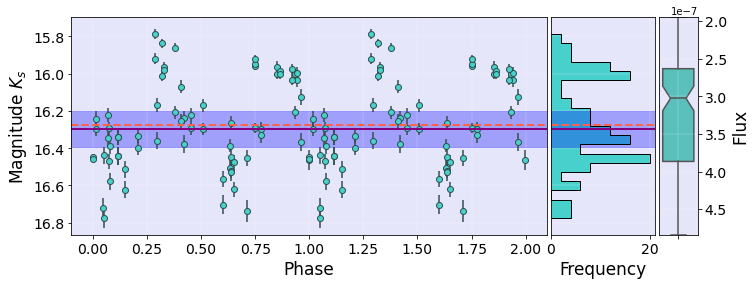

id_vvv 515882901938.0 Period_LS*2 1.0840046
1.0840046 515882901938.0


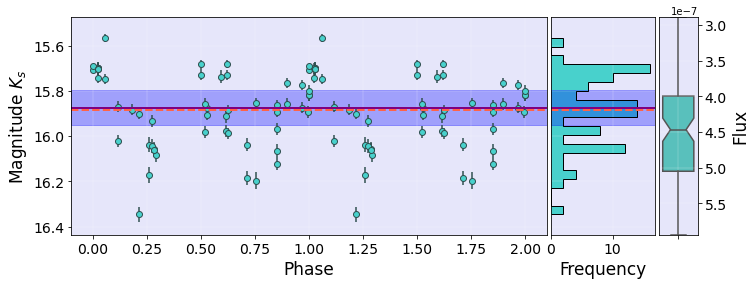

id_vvv 515882922296.0 Period_LS*2 3.3730412
3.3730412 515882922296.0


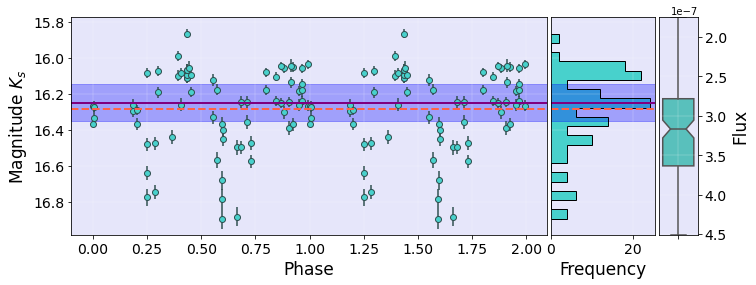

id_vvv 515882935267.0 Period_LS*2 1.9909198
1.9909198 515882935267.0


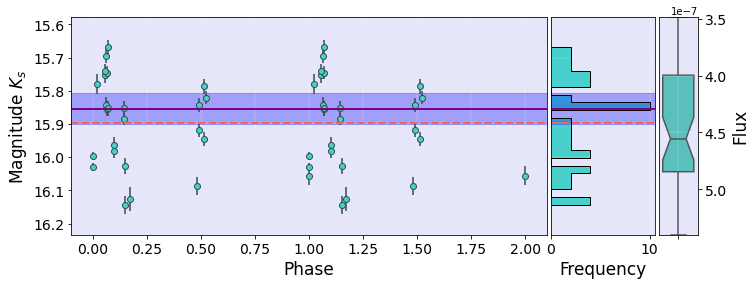

id_vvv 515882990852.0 Period_LS*2 57.124084
57.124084 515882990852.0


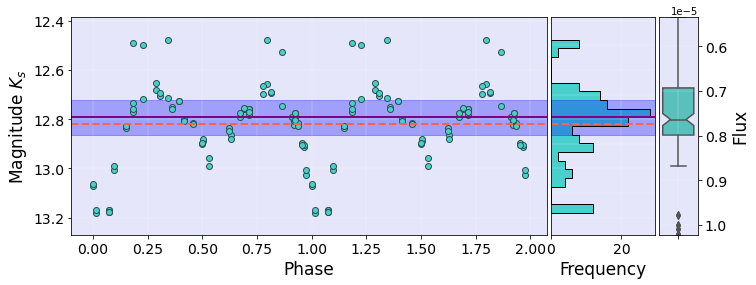

id_vvv 515883011065.0 Period_LS*2 0.745454
0.745454 515883011065.0


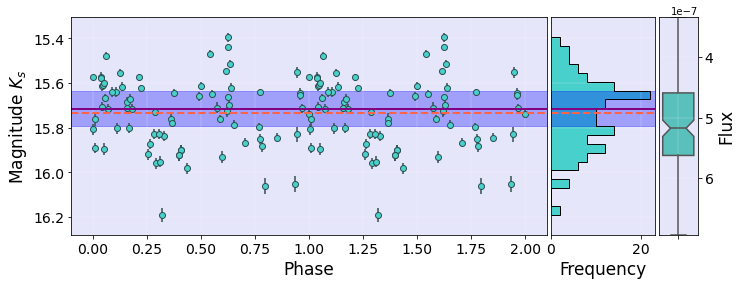

id_vvv 515883012833.0 Period_LS*2 27.76961
27.76961 515883012833.0


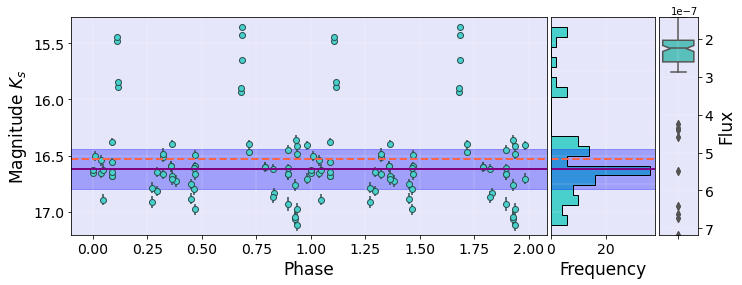

id_vvv 515883023213.0 Period_LS*2 31.734044
31.734044 515883023213.0


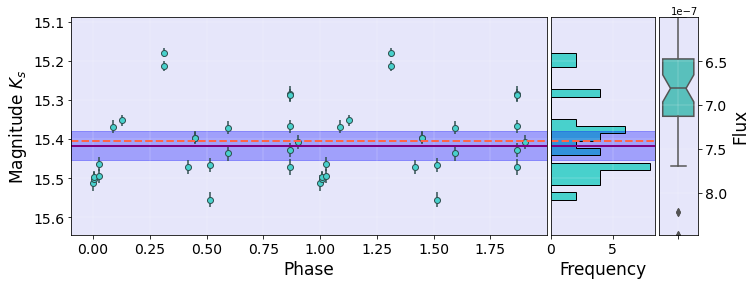

id_vvv 515883059865.0 Period_LS*2 1.994715
1.994715 515883059865.0


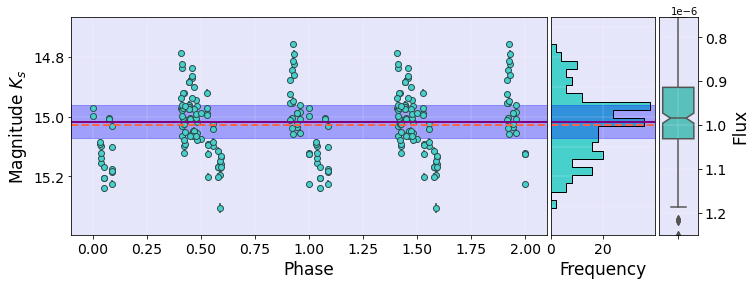

id_vvv 515883093062.0 Period_LS*2 5.6375436
5.6375436 515883093062.0


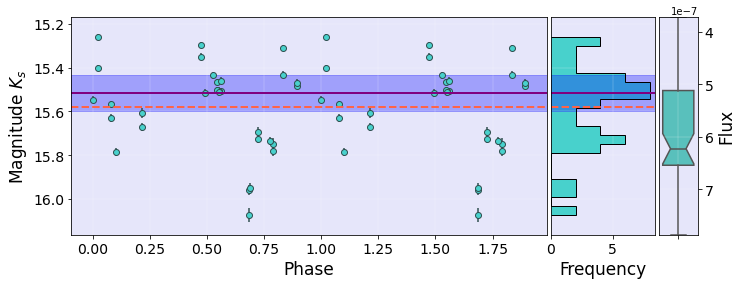

id_vvv 515883160619.0 Period_LS*2 2.1037198
2.1037198 515883160619.0


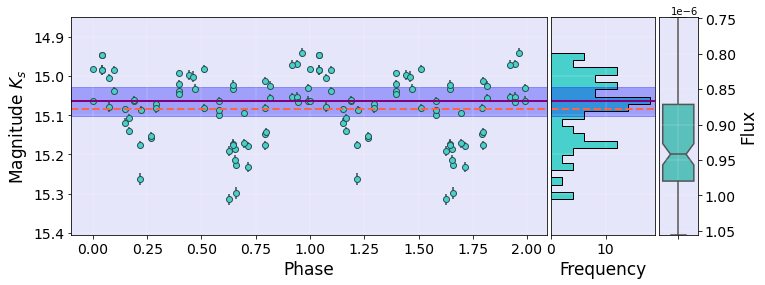

In [10]:
for i in range(df.shape[0]):
    # id del ebs
    id_vvv = df.id_vvv[i]
    df.iloc[i].to_frame().T.to_latex('reportes/tabla/'+str(int(id_vvv))+'tabla'+'.txt')
    # ruta de las series de tiempo ebs
    ruta = '../data/TimeSeries_vivace/' + str(int(id_vvv))
    # perido
    periodo = df.PeriodLS[i]*2
    print('id_vvv', id_vvv, 'Period_LS*2', periodo)
    print(periodo, id_vvv)
    
    # pha, mag, err (load of each ebs)
    d3 = fase(ruta, periodo)

    # PLOT
    #bbox_inches='tight' Configuraciones generales de las subfiguras
    #plt.close('all')
    #
    #fig , (ax3, ax4, ax5, ax6) = plt.subplots(nrows=1, ncols=4, sharey=False, gridspec_kw={'width_ratios':[50,2,1,1]})
    #fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.02, hspace=None)

    ############################################################################################
    figurita = plt.figure(constrained_layout=False)                                            #
    #figure(figsize=(8, 6), dpi=80)
                                                                                           #
    # Primer cuadrante                                                                         #
    gs1 = figurita.add_gridspec(nrows=1, ncols=1, left=0.05, right=1.15, wspace=0.2)           #
    ax1 = figurita.add_subplot(gs1[0, 0])                                                      #
                                                                                           #
    # Segundo cuadrante                                                        #
    gs2 = figurita.add_gridspec(nrows=1, ncols=1, left=1.16, right=1.4, wspace=0.6)            #
    ax2 = figurita.add_subplot(gs2[0, 0])                                                      #
    #ax3 = figurita.add_subplot(gs2[0, 1])        

    # Tercer cuadrante                                                                         #
    gs3 = figurita.add_gridspec(nrows=1, ncols=1, left=1.41, right=1.5, wspace=0.6)            #
    ax3 = figurita.add_subplot(gs3[0, 0])                                                      #
    #ax3 = figurita.add_subplot(gs2[0, 1])   
    ############################################################################################

    b = 'darkslategrey'
    c = 'mediumturquoise'
    c2 = 'azure'

    #######

    #m = list(d3[1])
    #i = m.index(max(m))
    d31 = list(map(lambda x: x + 1, d3[0]))
    x = np.concatenate((d3[0], d31))
    y = np.concatenate((d3[1], d3[1]))
    e = np.concatenate((d3[2], d3[2]))
    #x[x>1.5] = x[x>1.5] - 2
    #x = x - x[i]      
    #f = np.logical_and(x>-0.001, x<1)

    #######
    #x = np.array(d3[0])
    #y = np.array(d3[1])
    #e = np.array(d3[2])

    # curva de luz
    ax1.plot(x, y,
        linestyle='None', markersize=6,
        markerfacecolor = c,
        marker='o', color=b)
    #ax1.plot(x[f], y[f],
    #    linestyle='None', markersize=6,
    #    markerfacecolor = c,
    #    marker='o', color=b)
    
    #ax1.plot(x[~f], y[~f],
    #    linestyle='None', markersize=6,
    #    markerfacecolor = c,
    #    marker='o', color=b)
    ax1.errorbar(x, y, e*0.2, linestyle='None', markersize=6, color=b)
    #print(x[~f].min(), x[~f].max())
    #print(x[f].min(), x[f].max())
    # Median line
    median = np.median(y)
    ax1.axhline(y=median, linewidth=2, color='purple')

    # mean line
    mean = np.mean(y)
    ax1.axhline(y=mean, linewidth=2, color='tomato', linestyle='--')

    # Banda
    frac10 = abs(np.max(y)- np.min(y))/10
    median_10up = median + frac10
    median_10down = median - frac10
    ax1.axhspan(median_10up, median_10down, alpha=0.3, color='b')
    #ax1.set_ylim(15.7, 14.45)
    #maximo = x[f].max()
    #minimo = x[f].min()
    #print('min', minimo,'max',maximo)
    #diferencia_4 = abs(minimo-maximo)/4                    # Cuarta parte de la diferencia
    #ax1.set_xlim(minimo-diferencia_4, maximo-diferencia_4)
    ax1.set_ylim(np.max(y)+0.09, np.min(y)-0.09)
    ax1.set_ylim()
    ax1.set_xlabel('Phase',  fontsize=17)
    ax1.set_ylabel(r'Magnitude $K_{s}$', fontsize=17)
    ax1.grid(color='white', linewidth=0.2)
    ax1.set_facecolor('lavender')
    #ax1.text(-0.18, 14.54, 'EBD040-002 (C)', fontsize=12, color=b)
    #ax1.text(0.18, 15.65, 'Period = 0.4358 [d]', fontsize=12)
    ax1.xaxis.set_tick_params(labelsize=14) 
    ax1.yaxis.set_tick_params(labelsize=14) 
    
    # Ajuste

    #interpolacion = interp1d(x[f], y[f])
    #interpolacion2 = interp1d(x[f], y[f], kind= 'nearest')
    #interpolacion3 = interp1d(x[f], y[f], kind= 'cubic')
    #xnew = np.linspace(minimo, maximo, num=41, endpoint=True)
    #ax1.plot(xnew, interpolacion2(xnew), '-', color='orange')#,  xnew, interpolacion2(xnew), '--')

    # Histograma
    ax2.hist(y, bins=20, orientation='horizontal', color='black', linestyle='-', histtype='step')
    ax2.hist(y, bins=20, orientation='horizontal', color=c, linestyle='-')
    ax2.tick_params(axis="y", labelleft=False)                  # no labels
    ax2.set_ylim(np.max(y)+0.09, np.min(y)-0.09)
    ax2.grid(color='white', linewidth=0.2)
    ax2.set_facecolor('lavender')
    ax2.xaxis.set_tick_params(labelsize=14) 
    ax2.set_xlabel('Frequency', fontsize=17)
    #ax4.yaxis.tick_right()
    ax2.tick_params(left=False, labelbottom=True)
    # Medians lines
    ax2.axhline(y=median, linewidth=2, color='purple')
    # Banda
    ax2.axhspan(median_10up, median_10down, alpha=0.3, color='b')
    # Mean line
    ax2.axhline(y=mean, linewidth=2, color='tomato', linestyle='--')
    # Feature
    #ax2.text(40, median_10up, '}', fontsize=30, color='b', alpha=0.3)
    #ax2.text(47, median_10up, r'$Median BRP$', fontsize=9, color='b')
    ax2.set_ylim(np.max(y)+0.09, np.min(y)-0.09)

    # Flujo
    F = 10**(-0.4*y)
    boxplot_mag = sns.boxplot(y=F, notch=True, ax=ax3, color=c)
    ax3.set_ylim(np.max(F), np.min(F))

    ax3.tick_params(axis="y", labelleft=False, labelright = True)              # no labels
    ax3.grid(color='white', linewidth=0.2)
    ax3.set_facecolor('lavender')
    ax3.set_ylabel('Flux', fontsize=17)
    ax3.yaxis.set_label_position("right")
    ax3.yaxis.tick_right() 
    ax3.xaxis.set_tick_params(labelsize=14) 
    ax3.yaxis.set_tick_params(labelsize=14) 

    #save
    plt.savefig('reportes/plots/'+str(int(id_vvv))+'plot'+'.pdf', format='pdf', bbox_inches='tight')
    #plt.savefig('ejemplo'+'.pdf', format='pdf', bbox_inches='tight')
    #df.iloc[i].to_latex('reportes/tabla/'+str(int(id_vvv))+'tabla'+'.txt')
    # guardo tablas
    #df.loc[i].to_frame().T.to_latex('reportes/tabla/'+str(int(id_vvv))+'tabla'+'.txt')
    #1df[columns][0:i].to_latex('reportes/tabla/'+str(int(id_vvv))+'tabla'+'.txt')
    plt.show()

**Reporte**

In [11]:
from os import listdir
figuras = listdir('reportes/plots/')
tablas = listdir('reportes/tabla/')

In [12]:
figuras = sorted(figuras)
figuras
tablas = sorted(tablas)
tablas

['515881822600tabla.txt',
 '515881824954tabla.txt',
 '515881829441tabla.txt',
 '515881833126tabla.txt',
 '515881833225tabla.txt',
 '515881833511tabla.txt',
 '515881835868tabla.txt',
 '515881837288tabla.txt',
 '515881837772tabla.txt',
 '515881839645tabla.txt',
 '515881840259tabla.txt',
 '515881840406tabla.txt',
 '515881842329tabla.txt',
 '515881842736tabla.txt',
 '515881843411tabla.txt',
 '515881843751tabla.txt',
 '515881843930tabla.txt',
 '515881845393tabla.txt',
 '515881845843tabla.txt',
 '515881849371tabla.txt',
 '515881849640tabla.txt',
 '515881850275tabla.txt',
 '515881852495tabla.txt',
 '515881852961tabla.txt',
 '515881854173tabla.txt',
 '515881854713tabla.txt',
 '515881854744tabla.txt',
 '515881855508tabla.txt',
 '515881856149tabla.txt',
 '515881856884tabla.txt',
 '515881859349tabla.txt',
 '515881859431tabla.txt',
 '515881859950tabla.txt',
 '515881860701tabla.txt',
 '515881862225tabla.txt',
 '515881870829tabla.txt',
 '515881874127tabla.txt',
 '515881880004tabla.txt',
 '5158818812

In [14]:
from os import path, system
from os.path import join as pathjoin
import jinja2

"""
Esto es un demo para hacer un PDF a partir de un conjunto de datos

Supongamos que cada página del PDF tendrá una tabla con ciertos
datos y gráficos cuyos nombres se pueden construir a partir
de los datos.

Supongamos además que los datos estan en un pandas dataframe

Archivos que intervienen:

- data.pk: dataframe con los datos
- template.tex: template de latex

"""

# [ 1 ] Leer los datos



# [ 2 ] Configurar el template

source_dir = './'
template_file = 'template_CL.tex'


templateLoader = jinja2.FileSystemLoader(searchpath=source_dir)
 
latex_jinja_env = jinja2.Environment(
    block_start_string=r"\BLOCK{",
    block_end_string='}',
    variable_start_string=r'\VAR{',
    variable_end_string='}',
    comment_start_string=r'\#{',
    comment_end_string='}',
    line_statement_prefix='%%',
    line_comment_prefix='%#',
    trim_blocks=True,
    autoescape=False,
    loader=templateLoader
)
template_page = latex_jinja_env.get_template(template_file)


# [ 3 ] Implementar el template para los datos y guardar

output_dir = './'
fname = 'reportes/document.tex'
filename = pathjoin(output_dir, fname)

N = df.shape[0]  #número de objetos
target = open(filename, 'w')
target.write(template_page.render(Nplots=N,
                                  plts=figuras,   
                                  tables=tablas)
                                  )
target.close()

scp -r vdaza@sersic:/home/vdaza/vvv_b/Clasificacion/reportes .#

In [15]:
pwd

'/home/vdaza/VVV_EB_Classifier/report'

In [16]:

\begin{figure}[ht]
  \centering
  \includegraphics[width=1.5\textwidth]{plots/515881837317plot.pdf}
\end{figure}

\input{tabla/515881837317tabla.txt}
\end{landscape}
\newpage

% table:
%515881837443tabla.txt

SyntaxError: unexpected character after line continuation character (<ipython-input-16-5967aeee9a62>, line 1)